<img src="Images/16794938722698_Data Scientist-P7-01-banner.png">
<center><font color="#00007F" size=7><br><b>PROJET 7<br><br><font color="#3A8EBA" size=6 align="center">Implémentez un modèle de scoring</font></b></font></center>
<br><center><font color="limegreen" size=5><b>Notebook 1/3 - <font color="#00007F">part 1/3</font></b></font></center>

---

* Dernière mise à jour :  07-04-205
<a name="sommaire"></a>
### Table of Contents

* [Introduction](#intro)
* [Chapitre 1 Paramétrage techniques](#chapitre1)
    * [1.1 Import des librairies](#section_1_1)
    * [1.2 Options d'affichage](#section_1_2)
    * [1.3 Déclaration des paramètres](#section_1_3)   
    * [1.4 Déclaration des fonctions](#section_1_4)
* [Chapitre 2 Visualisation des données brutes](#chapitre2)
    * [2.1 Chargement des données](#section_2_1)
    * [2.2 Apercu des données](#section_2_2)
    * [2.3 Nettoyage des données](#section_2_3)    
* [Chapitre 3 Identification des valeurs abérrantes](#chapitre3)
    * [3.1 Valeurs absurdes](#section_3_1)
    * [3.2 Valeurs extrêmes](#section_3_2)
* [Chapitre 4 Etude des variables](#chapitre4)
    * [4.1 Analyse univariée](#section_4_1)
    * [4.2 Analyse bivariée](#section_4_2) 
* [Chapitre 5 Traitement du texte](#chapitre5)
    * [5.1 Comptage des mots et caractères](#section_5_1)
    * [5.2 Nettoyage des mots et caractères](#section_5_2)
    * [5.3 Lemmatisation des mots](#section_5_3)
    * [5.4 Stemmatisation des mots](#section_5_4)

---

###  <font color="blue" size=5>Introduction </font><a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a><a id="intro"></a><a name="intro"></a>

Vous êtes Data Scientist au sein d'une société financière, nommée <b>"Prêt à dépenser"</b>, qui propose des crédits à la consommation pour des personnes ayant peu ou pas du tout d'historique de prêt.

L’entreprise souhaite <b>mettre en œuvre un outil de “scoring crédit” pour calculer la probabilité</b> qu’un client rembourse son crédit, puis classifie la demande en crédit accordé ou refusé. Elle souhaite donc développer un <b>algorithme de classification</b> en s’appuyant sur des sources de données variées (données comportementales, données provenant d'autres institutions financières, etc.)

###  <font color="blue" size=5>Mission </font><a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a><a id="mission"></a><a name="mission"></a>

1. Construire un modèle de scoring qui donnera une prédiction sur la probabilité de faillite d'un client de façon automatique.


2. Analyser les features qui contribuent le plus au modèle, d’une manière générale (feature importance globale) et au niveau d’un client (feature importance locale), afin, dans un soucis de transparence, de permettre à un chargé d’études de mieux comprendre le score attribué par le modèle.


3. Mettre en production le modèle de scoring de prédiction à l’aide d’une API et réaliser une interface de test de cette API.


4. Mettre en œuvre une approche globale MLOps de bout en bout, du tracking des expérimentations à l’analyse en production du data drift.

###  <font color="blue" size=5>Chapitre 1 - Paramétrage techniques </font><a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a><a id="chapitre1"></a><a name="chapitre1"></a>

Ce projet a été décomposé en 3 notebooks :

| ordre | notebook   | commentaire
| :---- | :----      | :----       
| <b>1</b> | <b>pretraitement_feature_extraction_faisaibilite_part1_022025.ipynb </b>     | <b>1ère partie du projet avec une phase d'étude et de nettoyage des données et une partie sur les opérations de traitement de texte. </b>
| 2 | classification_supervisee_022025.ipynb       | 2ème partie du projet avec une segmentation supervisée des articles via leurs images.         
| 3 | api_python.ipynb     | 3ème partie du projet avec une API capable d'extraire des informations de type "champagne" sur openfoodfacts.

#### <font color="green" size=4>1.1 Import des librairies </font><a href="#chapitre1" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_1_1"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

In [13]:
import sys
import re                       #librairie pour les expressions regulières
import pandas as pd             #manipulation données
import numpy as np              #caluls/opérations sur les données
import matplotlib #visualisation des données 
import matplotlib.pyplot as plt #visualisation des données sous forme graphique
import seaborn as sns           #visualisation des données sous forme graphique amélioré
from scipy.stats import iqr     #import de la fonction IQR depuis la librairie scipy
from scipy.stats import linregress #import de la fonction linregress depuis la librairie scipy
import statistics
from sklearn.metrics      import r2_score  #import de la fonction r2_score depuis la librairie sklearn
from sklearn.linear_model import LinearRegression #import de la fonction LinearRegression depuis la librairie sklearn
from scipy.stats import levene  #test de Levene
from statsmodels.graphics.gofplots import qqplot
from scipy.stats import kruskal #test kruskal-wallis
from sklearn.impute import KNNImputer # KNN Imputer
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

from sklearn import metrics
from sklearn.cluster import KMeans
from sklearn.metrics.cluster import pair_confusion_matrix
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_score

from scipy import stats
import time
import datetime

from sklearn import preprocessing

import missingno as msno        #import librairie pour les valeurs manquantes
#pip install C:\Users\240694\missingno-0.5.2.tar.gz
#ressource :
#https://www.kaggle.com/code/selahattinsanli/visualizing-missing-data

import webbrowser              #librairie pour lire les pages html

# Analyse et modélisation texte
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report,confusion_matrix

import string
import re

In [14]:
print("Version de Python")
print(sys.version)

Version de Python
3.12.4 | packaged by Anaconda, Inc. | (main, Jun 18 2024, 15:03:56) [MSC v.1929 64 bit (AMD64)]


In [15]:
pip show numpy pandas matplotlib seaborn scipy scikit-learn missingno  

Name: numpy
Version: 1.26.4
Summary: Fundamental package for array computing in Python
Home-page: https://numpy.org
Author: Travis E. Oliphant et al.
Author-email: 
License: Copyright (c) 2005-2023, NumPy Developers.
All rights reserved.

Redistribution and use in source and binary forms, with or without
modification, are permitted provided that the following conditions are
met:

    * Redistributions of source code must retain the above copyright
       notice, this list of conditions and the following disclaimer.

    * Redistributions in binary form must reproduce the above
       copyright notice, this list of conditions and the following
       disclaimer in the documentation and/or other materials provided
       with the distribution.

    * Neither the name of the NumPy Developers nor the names of any
       contributors may be used to endorse or promote products derived
       from this software without specific prior written permission.

THIS SOFTWARE IS PROVIDED BY THE COPYR

| Module   | N° version
| :---        | :----       
| Python      | 3.12.4          
| numpy       | 1.26.4          
| pandas      | 2.2.2
| matplotlib  | 3.8.4       
| seaborn	  | 0.13.2     
| scipy	      | 1.13.1
| scikit-learn	      | 1.4.2
| Notebook Jupyter |6.3.0
| missingno | 0.4.2

#### <font color="green" size=4>1.2 Options d'affichage </font><a href="#chapitre1" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_1_2"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

In [18]:
pd.set_option("display.max_columns", None)
pd.set_option('display.max_colwidth', None)

#### <font color="green" size=4>1.3 Déclarations des paramètres </font><a href="#chapitre1" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_1_2"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

repertoire de la source de données :

In [23]:
source_repertory = 'Sources/'

nom des fichiers sources :

In [25]:
source_app_test='application_test.csv'
source_app_train='application_train.csv'
source_bureau='bureau.csv'
source_bureau_balance='bureau_balance.csv'
source_credit_card_balance='credit_card_balance.csv'
source_HomeCredit_columns_description='HomeCredit_columns_description.csv'
source_installments_payments='installments_payments.csv'
source_POS_CASH_balance='POS_CASH_balance.csv'
source_previous_application='previous_application.csv'
source_sample_submission='sample_submission.csv'


separateur défini dans le fichier source :

In [27]:
delimiter_file = ','

#### <font color="green" size=4>1.4 Déclaration des fonctions </font><a href="#chapitre1" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_1_4"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

In [23]:
###################################################################################################
#fonction retournant l'ensemble des colonnes d'un dataframe avec le type de colonne et le % valeurs NaN
#df : un dataframe
###################################################################################################
def desc_col (df):
    infos = pd.DataFrame(df.dtypes).T.rename(index={0:'Type'}) 
    infos = infos.append(pd.DataFrame(round((df.isna().sum()*100/df.shape[0]),1)).T.rename(index={0:'%_null'}))
    infos = infos.append(pd.DataFrame(round(100-(df.isna().sum()*100/df.shape[0]),1)).T.rename(index={0:'%_fill'}))
    return infos

###################################################################################################
#fonction retournant le taux de remplissage des colonnes dans l'ordre du dataframe
#dataframe : un dataframe
#flag      : 0 pour un affichage des colonnes dans l'ordre du dataframe
#          : 1 pour un affichage des colonnes par ordre decroissant
###################################################################################################
def taux_remplissage(dataframe, flag):
    nan_values = dataframe.isna().sum()
    if flag == 1:
        values = round(100 - (nan_values.sort_values(ascending=True)*100/dataframe.shape[0]),1)
    else:
        values = round(100 - (nan_values*100/dataframe.shape[0]),1)
    return values

###################################################################################################
#fonction dessinant un graphique de type BOXPLOT
#df         : un dataframe
#title_name : titre du graphe
#kpi_name   : nom du KPI
#figsize_x  : taille x du graphe
#figsize_y  : taille y du graphe
#ylabel_name: nom de l'axe y
###################################################################################################
def search_outlier(df, title_name, kpi_name, figsize_x,figsize_y,ylabel_name):
    flierprops = dict(marker='o', markerfacecolor='red', markersize=3, markeredgecolor='none')
    medianprops = dict(linestyle='--', linewidth=1.5, color='black')
    plt.figure(figsize = (figsize_x, figsize_y))
    sns.boxplot(x=kpi_name, data=df, palette='Set3', linewidth=1.5,fliersize=3,flierprops=flierprops,medianprops=medianprops)
    plt.title(title_name, pad=20, fontweight='bold')
    plt.ylabel(ylabel_name, fontweight='bold')
    plt.show() 
    
#fonction z_score
def calculate_z_score(data):
  # Mean of the dataset 
    mean = np.mean(data)
   # Standard Deviation of tha dataset 
    std_dev = np.std(data)
   # Z-score of tha data points 
    z_scores = (data - mean) / std_dev
    return z_scores

#fonction KNN imputer
def fct_knn_imputer(df, param_neighbors, cols_num):
    DataC = df.copy()
    X1 = DataC[DataC.isnull().any(axis=1)]
    X1 = X1.replace(' ', np.nan)

    #methode KNN : L’imputation KNN remplace la valeur manquante par la moyenne pondérée des k plus proches voisins, basée sur une mesure de distance
    Impute_knn = KNNImputer(n_neighbors=param_neighbors)
    scaler = StandardScaler()
    scaler.fit(X1[cols_num])

    # Mise à l'échelle
    scaled_numerics = scaler.transform(X1[cols_num])

    # Imputation des valeurs manquantes
    scaled_numerics_imputed = Impute_knn.fit_transform(scaled_numerics)

    # inverse_transform pour revenir à l'échelle de depart
    X1[cols_num] = scaler.inverse_transform(scaled_numerics_imputed)
    
    return X1

#fonction d'affichage d'histogramme qqplots
def plot_hist_qqplot(data, name, save=False):
    fig, axs = plt.subplots(1,2)
    # histogram
    axs[0].hist(data, histtype='stepfilled',ec='k', color='lightgrey', bins =25);
    # using statsmodels qqplot's module
    qqplot(data, line='r', **{'markersize': 5, 'mec': 'k','color': 'lightgrey'}, ax=axs[1])

    plt.gcf().set_size_inches(10,4.5)
    fig.suptitle(name, fontweight='bold', size=14)
    plt.tight_layout(rect=[0, 0.05, 1, 0.92])
    
#fonction d'affichage de mes projections d'individus par 2 composantes ACP
def display_factorial_planes(X_proj, n_comp, pca, axis_ranks, labels=None,
                             width=9, alpha=1, n_cols=1, illus_var=None,
                             lab_on=True, size=10):
    #n_rows = (n_comp+1)//n_cols
    n_rows = 4
    fig = plt.figure(figsize=(width,n_rows*width/n_cols))
    #fig = plt.figure(figsize=(10,40))
    # boucle sur chaque plan factoriel
    for i, (d1,d2) in (enumerate(axis_ranks)):
        if d2 < n_comp:
            ax = fig.add_subplot(n_rows, n_cols, i+1)
            # points
            if illus_var is None:
                ax.scatter(X_proj[:, d1], X_proj[:, d2], alpha=alpha, s=size)
            else:
                illus_var = np.array(illus_var)
                for value in np.unique(illus_var):
                    sel = np.where(illus_var == value)
                    ax.scatter(X_proj[sel, d1], X_proj[sel, d2], 
                                alpha=alpha, label=value,s=size)
                ax.legend(fontsize = 11, markerscale = 2, bbox_to_anchor=(1.0, 1.0), loc="upper left")
            # labels points
            if labels is not None and lab_on:
                for i,(x,y) in enumerate(X_proj[:,[d1,d2]]):
                    ax.text(x, y, labels[i],
                              fontsize='14', ha='center',va='center')   
            # limites
            bound = np.max(np.abs(X_proj[:, [d1,d2]])) * 0.5
            ax.set(xlim=(-bound,bound), ylim=(-bound,bound))
            # lignes horizontales et verticales
            ax.plot([-100, 100], [0, 0], color='grey', ls='--')
            ax.plot([0, 0], [-100, 100], color='grey', ls='--')
            # nom des axes, avec le pourcentage d'inertie expliqué
            ax.set_xlabel('CP{} ({}%)'.format(d1+1, round(100*pca.explained_variance_ratio_[d1],1)))
            ax.set_ylabel('CP{} ({}%)'.format(d2+1, round(100*pca.explained_variance_ratio_[d2],1)))
            ax.set_title("Projection des individus (sur CP{} et CP{})".format(d1+1, d2+1))
    plt.tight_layout()

#fonction cercle de corrélation pour ACP
def display_circles(pcs, n_comp, pca, axis_ranks, labels=None, label_rotation=0, lims=None):
    for d1, d2 in axis_ranks: # On affiche les 4 premiers plans factoriels, donc les 8 premières composantes
        if d2 < n_comp:

            # initialisation de la figure
            fig, ax = plt.subplots(figsize=(7,6))

            # détermination des limites du graphique
            if lims is not None :
                xmin, xmax, ymin, ymax = lims
            elif pcs.shape[1] < 30 :
                xmin, xmax, ymin, ymax = -1, 1, -1, 1
            else :
                xmin, xmax, ymin, ymax = min(pcs[d1,:]), max(pcs[d1,:]), min(pcs[d2,:]), max(pcs[d2,:])

            # affichage des flèches
            # s'il y a plus de 30 flèches, on n'affiche pas le triangle à leur extrémité
            if pcs.shape[1] < 30 :
                plt.quiver(np.zeros(pcs.shape[1]), np.zeros(pcs.shape[1]),
                   pcs[d1,:], pcs[d2,:], 
                   angles='xy', scale_units='xy', scale=1, color="grey")
            else:
                lines = [[[0,0],[x,y]] for x,y in pcs[[d1,d2]].T]
                ax.add_collection(LineCollection(lines, axes=ax, alpha=.1, color='black'))
            
            # affichage des noms des variables  
            if labels is not None:  
                for i,(x, y) in enumerate(pcs[[d1,d2]].T):
                    if x >= xmin and x <= xmax and y >= ymin and y <= ymax :
                        plt.text(x, y, labels[i], fontsize='14', ha='center', va='center', rotation=label_rotation, color="blue", alpha=0.5)
            
            # affichage du cercle
            circle = plt.Circle((0,0), 1, facecolor='none', edgecolor='b')
            plt.gca().add_artist(circle)

            # définition des limites du graphique
            plt.xlim(xmin, xmax)
            plt.ylim(ymin, ymax)
        
            # affichage des lignes horizontales et verticales
            plt.plot([-1, 1], [0, 0], color='grey', ls='--')
            plt.plot([0, 0], [-1, 1], color='grey', ls='--')

            # nom des axes, avec le pourcentage d'inertie expliqué
            plt.xlabel('CP{} ({}%)'.format(d1+1, round(100*pca.explained_variance_ratio_[d1],1)))
            plt.ylabel('CP{} ({}%)'.format(d2+1, round(100*pca.explained_variance_ratio_[d2],1)))

            plt.title("Cercle de corrélation (CP{} et CP{})".format(d1+1, d2+1))
 
            plt.show(block=False)

# Plotting heatmap (3 options available, rectangle,
# triangle of table of contingency)
def plot_heatmap(corr, title, figsize=(8,4), vmin=-1, vmax=1, center=0,
                 palette = sns.color_palette("coolwarm", 20), shape='rect',
                 fmt='.2f', robust=False):
    
    fig, ax = plt.subplots(figsize=figsize)
    if shape == 'rect':
        mask=None
    elif shape == 'tri':
        mask = np.zeros_like(corr, dtype=np.bool)
        mask[np.triu_indices_from(mask)] = True
    else:
        print('ERROR : this type of heatmap does not exist')

    palette = palette
    ax = sns.heatmap(corr, mask=mask, cmap=palette, vmin=vmin, vmax=vmax,
                     center=center, annot=True, annot_kws={"size": 10},fmt=fmt,
                     square=False, linewidths=.5, linecolor = 'white',
                     cbar_kws={"shrink": .9, 'label': None}, robust = robust,
                     xticklabels= corr.columns, yticklabels = corr.index)
    ax.tick_params(labelsize=10,top=False, bottom=True,
                labeltop=False, labelbottom=True)
    ax.collections[0].colorbar.ax.tick_params(labelsize=10)
    plt.setp(ax.get_xticklabels(), rotation=25, ha="right",rotation_mode="anchor")
    ax.set_title(title, fontweight='bold', fontsize=12)   

    
def func(pct, allvals):
    absolute = int(np.round(pct/100.*np.sum(allvals)))
    return f"{pct:.1f}%\n({absolute:d})"

def NumPyRMSLE(y_true: list, y_pred: list):
    """
    The Root Mean Squared Log Error (RMSLE) metric using only NumPy
    
    :param y_true: The ground truth labels given in the dataset
    :param y_pred: Our predictions
    :return: The RMSLE score
    """
    n = len(y_true)
    msle = np.sqrt(np.mean(np.square(np.log1p(y_pred) - np.log1p(y_true))))
    return msle

def RMSLE(y_true: np.array, y_pred: np.array):
    """
    The Root Mean Squared Log Error (RMSLE) metric 
        
    :param y_true: The ground truth labels given in the dataset
    :param y_pred: Our predictions
    :return: The RMSLE score
    """
    return mean_squared_log_error(y_true, y_pred, squared=False)


###  <font color="blue" size=5>Chapitre 2 - Visualisation des données brutes </font><a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a><a id="chapitre2"></a><a name="chapitre2"></a>

#### <font color="green" size=4>2.1 Chargement des données </font><a href="#chapitre2" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_2_1"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

In [52]:
source_app_test='application_test.csv'
source_app_train='application_train.csv'
source_bureau='bureau.csv'
source_bureau_balance='bureau_balance.csv'
source_credit_card_balance='credit_card_balance.csv'
source_HomeCredit_columns_description='HomeCredit_columns_description.csv'
source_installments_payments='installments_payments.csv'
source_POS_CASH_balance='POS_CASH_balance.csv'
source_previous_application='previous_application.csv'
source_sample_submission='sample_submission.csv'

DataAppTest              = pd.read_csv(open(source_repertory + source_app_test,'r'), sep = delimiter_file)
DataAppTrain             = pd.read_csv(open(source_repertory + source_app_train,'r'), sep = delimiter_file)
DataBureau               = pd.read_csv(open(source_repertory + source_bureau,'r'), sep = delimiter_file)
DataBureauBalance        = pd.read_csv(open(source_repertory + source_bureau_balance,'r'), sep = delimiter_file)
DataCreditCardBalance    = pd.read_csv(open(source_repertory + source_credit_card_balance,'r'), sep = delimiter_file)
DataColumnsDescription   = pd.read_csv(open(source_repertory + source_HomeCredit_columns_description,'r'), sep = delimiter_file)
DataInstallmentsPayments = pd.read_csv(open(source_repertory + source_installments_payments,'r'), sep = delimiter_file)
DataPosCashBalance       = pd.read_csv(open(source_repertory + source_POS_CASH_balance,'r'), sep = delimiter_file)
DataPreviousApplication  = pd.read_csv(open(source_repertory + source_previous_application,'r'), sep = delimiter_file)
DataSampleSubmission     = pd.read_csv(open(source_repertory + source_sample_submission,'r'), sep = delimiter_file)


#### <font color="green" size=4>2.2 Aperçu des données </font><a href="#chapitre2" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_2_2"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

<b><u>Application</u></b> :

La table Application contient toutes les demandes actuelles des prêts. Une ligne représente un prêt et toutes les autres tables sont liées avec cette table avec l'ID unique du client 'SK_ID_CURR'. La table application est divisée en deux fichiers : un fichier pour l'entrainement (application_train) qui contient la variable cible a prédire (TARGET) et un deuxieme fichier pour le test (application_test sans TARGET).

In [57]:
DataAppTest

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.018850,-19241,-2329,-5170.0,-812,NaN,1,1,0,1,0,1,NaN,2.0,2,2,TUESDAY,18,0,0,0,0,0,0,Kindergarten,0.752614,0.789654,0.159520,0.0660,0.0590,0.9732,NaN,NaN,NaN,0.1379,0.1250,NaN,NaN,NaN,0.0505,NaN,NaN,0.0672,0.0612,0.9732,NaN,NaN,NaN,0.1379,0.1250,NaN,NaN,NaN,0.0526,NaN,NaN,0.0666,0.0590,0.9732,NaN,NaN,NaN,0.1379,0.1250,NaN,NaN,NaN,0.0514,NaN,NaN,NaN,block of flats,0.0392,"Stone, brick",No,0.0,0.0,0.0,0.0,-1740.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.035792,-18064,-4469,-9118.0,-1623,NaN,1,1,0,1,0,0,Low-skill Laborers,2.0,2,2,FRIDAY,9,0,0,0,0,0,0,Self-employed,0.564990,0.291656,0.432962,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,NaN,Working,Higher education,Married,House / apartment,0.019101,-20038,-4458,-2175.0,-3503,5.0,1,1,0,1,0,0,Drivers,2.0,2,2,MONDAY,14,0,0,0,0,0,0,Transport: type 3,NaN,0.699787,0.610991,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-856.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,Unaccompanied,Working,Secondary / secondary special,Marr

In [58]:
DataAppTest.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 121 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(40), object(16)
memory usage: 45.0+ MB


<span style="color:DarkOrange"><u><b>DataAppTest</b></u> : <br></span>
    105 indicateurs quantitatif<br>
    16 indicateurs qualitatifs

In [62]:
#nb lignes et colonnes
print('nb lignes   =',DataAppTest.shape[0])
print('nb colonnes =',DataAppTest.shape[1])

nb lignes   = 48744
nb colonnes = 121


|Nb colonnes | dont quantitatifs | dont qualitatifs | Nb lignes | Taille (Mo)
| :----       | :---              | :---              | :---       | :---      
| 121          | 105                | 16                 | 48 744 |  45

In [65]:
DataAppTrain.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB


In [67]:
DataAppTrain

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.0220,0.0198,0.0,0.0000,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.0000,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.0790,0.0554,0.0,0.0000,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.0100,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [68]:
#nb lignes et colonnes
print('nb lignes   =',DataAppTrain.shape[0])
print('nb colonnes =',DataAppTrain.shape[1])

nb lignes   = 307511
nb colonnes = 122


|Nb colonnes | dont quantitatifs | dont qualitatifs | Nb lignes | Taille (Mo)
| :----       | :---              | :---              | :---       | :---      
| 122          | 106               | 16                 | 307 511 |  286

1 colonne quantitatif supplémentaire p/r à DataAppTest : c'est la variable TARGET qui permet de dire si le client a eu une défaillance ou pas pour rembourser son crédit.

In [72]:
#description complète de la table avec le %valeurs nulles, le nb de lignes renseignés, valeurs uniques, etc
info_Data = desc_col(DataAppTrain).append(DataAppTrain.describe(include='all'))
info_Data.head(4)

AttributeError: 'DataFrame' object has no attribute 'append'

<u>Variable Target</u><br>
- 0 : client non-defaillant
- 1 : client défaillant (ayant rencontré des problèmes de remboursement)

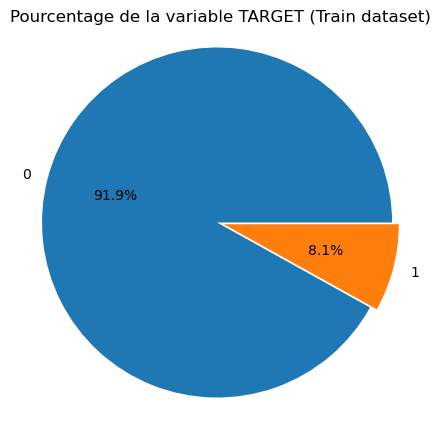

Nb modalités distinctes : 2


In [75]:
#représentation graphique en cercle
plt.figure(figsize=(5,5))

proportion_pattern = DataAppTrain['TARGET'].value_counts()
labels = proportion_pattern.index
explode = (0.02, 0) 

#ax.pie(proportion_pattern, labels=labels, explode=explode, 
#       autopct='%1.1f%%', shadow=True, startangle=90)
plt.pie(proportion_pattern, labels=labels, autopct='%.1f%%',
       textprops={'size': 'medium'}, radius=0.5,explode=explode)

plt.axis('equal')
plt.title('Pourcentage de la variable TARGET (Train dataset)', fontsize=12)
plt.show()
print('Nb modalités distinctes :',len(DataAppTrain.groupby('TARGET')))

In [77]:
DataTrain = DataAppTrain.copy()
DataTest = DataAppTest.copy()

<b>Visulation des taux de valeurs renseignées sur le dataframe DataAppTrain</b> :

<i>Sous format graphique</i> :

ValueError: The number of FixedLocator locations (0), usually from a call to set_ticks, does not match the number of labels (122).

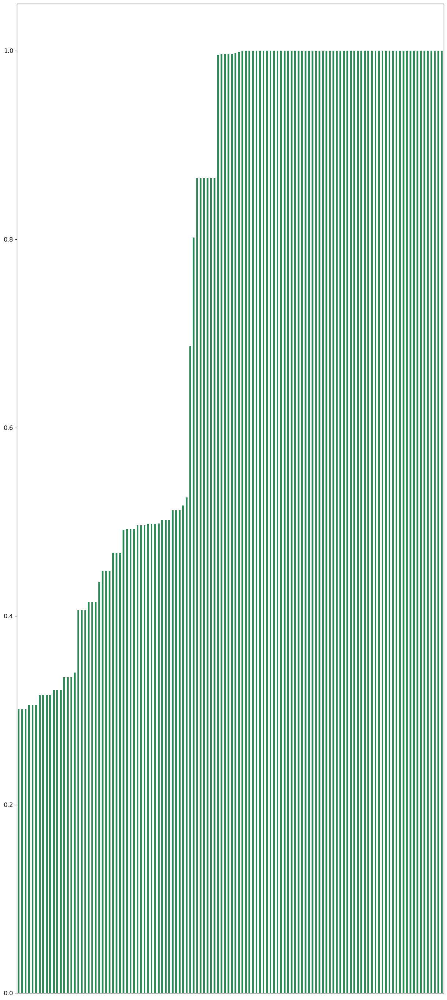

In [81]:
msno.bar(DataTrain,figsize=(15,35), fontsize=12, color="seagreen", log=False, sort="ascending")

<i>Sous format chiffres</i> :

In [92]:
shape = DataTrain.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataTrain.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
with pd.option_context('display.max_rows', None,):
    print(taux_completion.sort_values(ascending=False))

SK_ID_CURR                      100.000000
FLAG_DOCUMENT_15                100.000000
HOUR_APPR_PROCESS_START         100.000000
REG_REGION_NOT_LIVE_REGION      100.000000
LIVE_REGION_NOT_WORK_REGION     100.000000
REG_CITY_NOT_LIVE_CITY          100.000000
REG_CITY_NOT_WORK_CITY          100.000000
LIVE_CITY_NOT_WORK_CITY         100.000000
ORGANIZATION_TYPE               100.000000
FLAG_DOCUMENT_21                100.000000
FLAG_DOCUMENT_20                100.000000
FLAG_DOCUMENT_19                100.000000
FLAG_DOCUMENT_18                100.000000
FLAG_DOCUMENT_17                100.000000
FLAG_DOCUMENT_16                100.000000
FLAG_DOCUMENT_14                100.000000
REGION_RATING_CLIENT_W_CITY     100.000000
FLAG_DOCUMENT_13                100.000000
FLAG_DOCUMENT_12                100.000000
FLAG_DOCUMENT_11                100.000000
FLAG_DOCUMENT_10                100.000000
FLAG_DOCUMENT_9                 100.000000
FLAG_DOCUMENT_8                 100.000000
FLAG_DOCUME

Synthèse Tableau de remplissage des colonnes : 

|[ 0 - 50% ] | ] 50 - 99% ] | ] 99 - 100% ] | Total
| :----          | :---        | :---        | :---             
| 41 | 16 | 65| 122

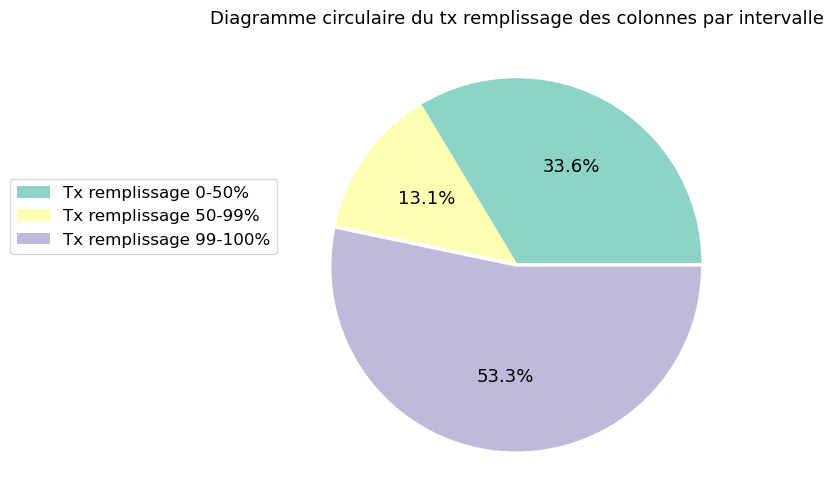

In [96]:
labels = 'Tx remplissage 0-50%','Tx remplissage 50-99%','Tx remplissage 99-100%'
datatmp = [41,16,65]

fig, ax = plt.subplots(figsize=(10, 6), subplot_kw=dict(aspect="equal"))
wedges, texts, autotexts = ax.pie(datatmp, autopct='%1.1f%%',
                                  textprops=dict(color="black"),colors=sns.color_palette('Set3'),explode=[0,0, 0.02])
#autopct=lambda pct: func(pct, datatmp)
#dict(color="black")
ax.legend(wedges, labels,
           fontsize="12",
          bbox_to_anchor=(1, -0.3, -1, 1))

plt.setp(autotexts, size=13)
ax.set_title("Diagramme circulaire du tx remplissage des colonnes par intervalle", size=13)
plt.show()


In [98]:
moy = round(
    taux_completion.mean(), 1
)  # calcul la moyenne du taux de completion au global au dizième près
print(f"La moyenne du tx remplissage dans le jeu de données (Train) est de {moy}%")

La moyenne du tx remplissage dans le jeu de données (Train) est de 75.6%


In [100]:
TAB_DATA = pd.DataFrame()
row_index = 0
TAB_DATA.loc[row_index, 'Dataset'] = 'application_train'
TAB_DATA.loc[row_index, 'Nb lignes'] = DataAppTrain.shape[0]
TAB_DATA.loc[row_index, 'Nb colonnes'] = DataAppTrain.shape[1]
TAB_DATA.loc[row_index, 'Nb quantitatifs'] = 106
TAB_DATA.loc[row_index, 'Nb qualitatifs'] = 16
TAB_DATA.loc[row_index, 'Moy tx remplissage'] = moy
row_index = row_index + 1

<b>Visulation des taux de valeurs renseignées sur le dataframe DataAppTest</b> :

<i>Sous format graphique</i> :

<AxesSubplot:>

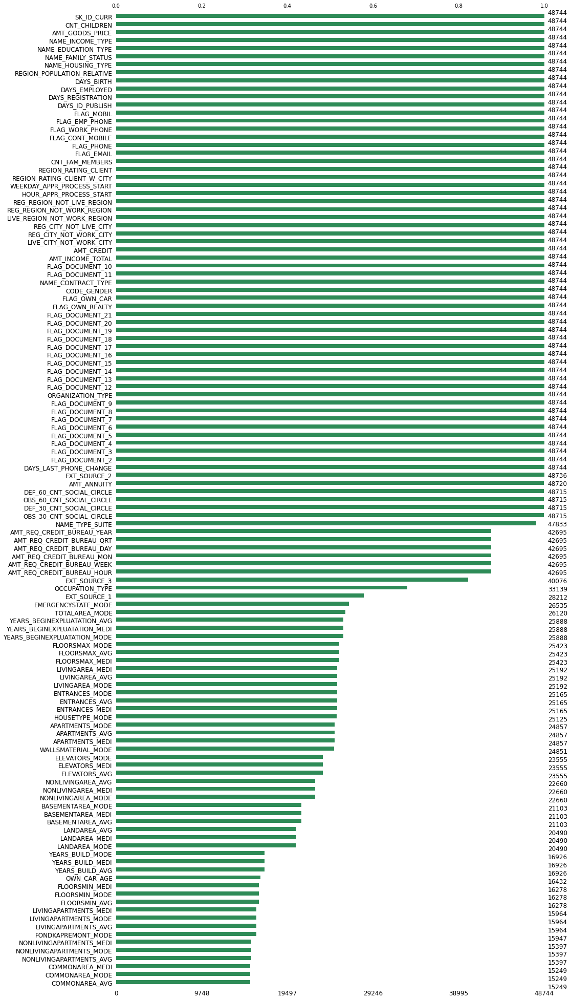

In [24]:
msno.bar(DataTest,figsize=(15,35), fontsize=12, color="seagreen", log=False, sort="ascending")

<i>Sous format chiffres</i> :

In [102]:
shape = DataTest.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataTest.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
with pd.option_context('display.max_rows', None,):
    print(taux_completion.sort_values(ascending=False))

SK_ID_CURR                      100.000000
FLAG_DOCUMENT_14                100.000000
REG_REGION_NOT_LIVE_REGION      100.000000
LIVE_REGION_NOT_WORK_REGION     100.000000
REG_CITY_NOT_LIVE_CITY          100.000000
REG_CITY_NOT_WORK_CITY          100.000000
LIVE_CITY_NOT_WORK_CITY         100.000000
ORGANIZATION_TYPE               100.000000
FLAG_DOCUMENT_21                100.000000
FLAG_DOCUMENT_20                100.000000
FLAG_DOCUMENT_19                100.000000
FLAG_DOCUMENT_18                100.000000
FLAG_DOCUMENT_17                100.000000
FLAG_DOCUMENT_16                100.000000
FLAG_DOCUMENT_15                100.000000
FLAG_DOCUMENT_13                100.000000
WEEKDAY_APPR_PROCESS_START      100.000000
FLAG_DOCUMENT_12                100.000000
FLAG_DOCUMENT_11                100.000000
FLAG_DOCUMENT_10                100.000000
FLAG_DOCUMENT_9                 100.000000
FLAG_DOCUMENT_8                 100.000000
FLAG_DOCUMENT_7                 100.000000
FLAG_DOCUME

In [104]:
moy = round(
    taux_completion.mean(), 1
)  # calcul la moyenne du taux de completion au global au dizième près
print(f"La moyenne du tx remplissage dans le jeu de données (Test) est de {moy}%")

La moyenne du tx remplissage dans le jeu de données (Test) est de 76.2%


In [106]:
TAB_DATA.loc[row_index, 'Dataset'] = 'application_test'
TAB_DATA.loc[row_index, 'Nb lignes'] = DataAppTest.shape[0]
TAB_DATA.loc[row_index, 'Nb colonnes'] = DataAppTest.shape[1]
TAB_DATA.loc[row_index, 'Nb quantitatifs'] = 105
TAB_DATA.loc[row_index, 'Nb qualitatifs'] = 16
TAB_DATA.loc[row_index, 'Moy tx remplissage'] = moy
row_index = row_index + 1

In [108]:
DataBureau

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.00,0.0,NaN,0.0,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.00,171342.0,NaN,0.0,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.50,NaN,NaN,0.0,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.00,NaN,NaN,0.0,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.00,NaN,NaN,0.0,Consumer credit,-21,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1716423,259355,5057750,Active,currency 1,-44,0,-30.0,NaN,0.0,0,11250.00,11250.0,0.0,0.0,Microloan,-19,NaN
1716424,100044,5057754,Closed,currency 1,-2648,0,-2433.0,-2493.0,5476.5,0,38130.84,0.0,0.0,0.0,Consumer credit,-2493,NaN
1716425,100044,5057762,Closed,currency 1,-1809,0,-1628.0,-970.0,NaN,0,15570.00,NaN,NaN,0.0,Consumer credit,-967,NaN
1716426,246829,5057770,Closed,currency 1,-1878,0,-1513.0,-1513.0,NaN,0,36000.00,0.0,0.0,0.0,Consumer credit,-1508,NaN


<b><u>Bureau</u></b> :

In [29]:
DataBureau.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1716428 entries, 0 to 1716427
Data columns (total 17 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   SK_ID_CURR              int64  
 1   SK_ID_BUREAU            int64  
 2   CREDIT_ACTIVE           object 
 3   CREDIT_CURRENCY         object 
 4   DAYS_CREDIT             int64  
 5   CREDIT_DAY_OVERDUE      int64  
 6   DAYS_CREDIT_ENDDATE     float64
 7   DAYS_ENDDATE_FACT       float64
 8   AMT_CREDIT_MAX_OVERDUE  float64
 9   CNT_CREDIT_PROLONG      int64  
 10  AMT_CREDIT_SUM          float64
 11  AMT_CREDIT_SUM_DEBT     float64
 12  AMT_CREDIT_SUM_LIMIT    float64
 13  AMT_CREDIT_SUM_OVERDUE  float64
 14  CREDIT_TYPE             object 
 15  DAYS_CREDIT_UPDATE      int64  
 16  AMT_ANNUITY             float64
dtypes: float64(8), int64(6), object(3)
memory usage: 222.6+ MB


In [30]:
DataBureau.head(5)

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.0,0.0,NaN,0.0,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.0,171342.0,NaN,0.0,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.5,NaN,NaN,0.0,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.0,NaN,NaN,0.0,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.0,NaN,NaN,0.0,Consumer credit,-21,NaN


Tous les crédits du client fournis par d'autres institutions financières qui ont été rapportés a 'Home credit'.<br> 
Il y a autant de lignes que le nombre de crédits du meme client présent dans "application" avec l'unique id "SK_ID_CURR"

In [31]:
shape = DataBureau.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataBureau.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
with pd.option_context('display.max_rows', None,):
    print(taux_completion.sort_values(ascending=False))

SK_ID_CURR                100.000000
DAYS_CREDIT_UPDATE        100.000000
CREDIT_ACTIVE             100.000000
CREDIT_CURRENCY           100.000000
DAYS_CREDIT               100.000000
CREDIT_DAY_OVERDUE        100.000000
SK_ID_BUREAU              100.000000
CNT_CREDIT_PROLONG        100.000000
AMT_CREDIT_SUM_OVERDUE    100.000000
CREDIT_TYPE               100.000000
AMT_CREDIT_SUM             99.999243
DAYS_CREDIT_ENDDATE        93.850427
AMT_CREDIT_SUM_DEBT        84.988068
AMT_CREDIT_SUM_LIMIT       65.522585
DAYS_ENDDATE_FACT          63.083042
AMT_CREDIT_MAX_OVERDUE     34.486736
AMT_ANNUITY                28.526510
dtype: float64


In [32]:
moy = round(
    taux_completion.mean(), 1
)  # calcul la moyenne du taux de completion au global au dizième près
print(f"La moyenne du tx remplissage dans le jeu de données (DataBureau) est de {moy}%")

La moyenne du tx remplissage dans le jeu de données (DataBureau) est de 86.5%


In [33]:
TAB_DATA.loc[row_index, 'Dataset'] = 'bureau'
TAB_DATA.loc[row_index, 'Nb lignes'] = DataBureau.shape[0]
TAB_DATA.loc[row_index, 'Nb colonnes'] = DataBureau.shape[1]
TAB_DATA.loc[row_index, 'Nb quantitatifs'] = 14
TAB_DATA.loc[row_index, 'Nb qualitatifs'] = 3
TAB_DATA.loc[row_index, 'Moy tx remplissage'] = moy
row_index = row_index + 1

<b><u>Bureau Balance</u></b> :

In [34]:
DataBureauBalance.info()    

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27299925 entries, 0 to 27299924
Data columns (total 3 columns):
 #   Column          Dtype 
---  ------          ----- 
 0   SK_ID_BUREAU    int64 
 1   MONTHS_BALANCE  int64 
 2   STATUS          object
dtypes: int64(2), object(1)
memory usage: 624.8+ MB


In [35]:
shape = DataBureauBalance.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataBureauBalance.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
with pd.option_context('display.max_rows', None,):
    print(taux_completion.sort_values(ascending=False))

SK_ID_BUREAU      100.0
MONTHS_BALANCE    100.0
STATUS            100.0
dtype: float64


In [36]:
DataBureauBalance.head(5)

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C


In [37]:
DataBureauBalance['STATUS'].unique()

array(['C', '0', 'X', '1', '2', '3', '5', '4'], dtype=object)

In [38]:
moy = round(
    taux_completion.mean(), 1
)  # calcul la moyenne du taux de completion au global au dizième près
print(f"La moyenne du tx remplissage dans le jeu de données (DataBureauBalance) est de {moy}%")

La moyenne du tx remplissage dans le jeu de données (DataBureauBalance) est de 100.0%


Soldes mensuels des crédits précédents du table bureau. Ce tableau a une ligne pour chaque mois d'historique de chaque crédit précédent rapporté a 'Home Credit'

In [39]:
TAB_DATA.loc[row_index, 'Dataset'] = 'bureau_balance'
TAB_DATA.loc[row_index, 'Nb lignes'] = DataBureauBalance.shape[0]
TAB_DATA.loc[row_index, 'Nb colonnes'] = DataBureauBalance.shape[1]
TAB_DATA.loc[row_index, 'Nb quantitatifs'] = 2
TAB_DATA.loc[row_index, 'Nb qualitatifs'] = 1
TAB_DATA.loc[row_index, 'Moy tx remplissage'] = moy
row_index = row_index + 1

<b><u>Credit Card Balance</u></b> :

In [40]:
DataCreditCardBalance.info()   

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3840312 entries, 0 to 3840311
Data columns (total 23 columns):
 #   Column                      Dtype  
---  ------                      -----  
 0   SK_ID_PREV                  int64  
 1   SK_ID_CURR                  int64  
 2   MONTHS_BALANCE              int64  
 3   AMT_BALANCE                 float64
 4   AMT_CREDIT_LIMIT_ACTUAL     int64  
 5   AMT_DRAWINGS_ATM_CURRENT    float64
 6   AMT_DRAWINGS_CURRENT        float64
 7   AMT_DRAWINGS_OTHER_CURRENT  float64
 8   AMT_DRAWINGS_POS_CURRENT    float64
 9   AMT_INST_MIN_REGULARITY     float64
 10  AMT_PAYMENT_CURRENT         float64
 11  AMT_PAYMENT_TOTAL_CURRENT   float64
 12  AMT_RECEIVABLE_PRINCIPAL    float64
 13  AMT_RECIVABLE               float64
 14  AMT_TOTAL_RECEIVABLE        float64
 15  CNT_DRAWINGS_ATM_CURRENT    float64
 16  CNT_DRAWINGS_CURRENT        int64  
 17  CNT_DRAWINGS_OTHER_CURRENT  float64
 18  CNT_DRAWINGS_POS_CURRENT    float64
 19  CNT_INSTALMENT_MATURE

In [41]:
shape = DataCreditCardBalance.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataCreditCardBalance.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
with pd.option_context('display.max_rows', None,):
    print(taux_completion.sort_values(ascending=False))

SK_ID_PREV                    100.000000
SK_ID_CURR                    100.000000
SK_DPD                        100.000000
NAME_CONTRACT_STATUS          100.000000
CNT_DRAWINGS_CURRENT          100.000000
AMT_TOTAL_RECEIVABLE          100.000000
AMT_RECIVABLE                 100.000000
AMT_RECEIVABLE_PRINCIPAL      100.000000
AMT_PAYMENT_TOTAL_CURRENT     100.000000
AMT_DRAWINGS_CURRENT          100.000000
AMT_CREDIT_LIMIT_ACTUAL       100.000000
AMT_BALANCE                   100.000000
MONTHS_BALANCE                100.000000
SK_DPD_DEF                    100.000000
AMT_INST_MIN_REGULARITY        92.051792
CNT_INSTALMENT_MATURE_CUM      92.051792
AMT_DRAWINGS_POS_CURRENT       80.475128
AMT_DRAWINGS_OTHER_CURRENT     80.475128
AMT_DRAWINGS_ATM_CURRENT       80.475128
CNT_DRAWINGS_ATM_CURRENT       80.475128
CNT_DRAWINGS_OTHER_CURRENT     80.475128
CNT_DRAWINGS_POS_CURRENT       80.475128
AMT_PAYMENT_CURRENT            80.001937
dtype: float64


In [42]:
DataCreditCardBalance.head(5)

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.970,135000,0.0,877.5,0.0,877.5,1700.325,1800.0,1800.0,0.000,0.000,0.000,0.0,1,0.0,1.0,35.0,Active,0,0
1,2582071,363914,-1,63975.555,45000,2250.0,2250.0,0.0,0.0,2250.000,2250.0,2250.0,60175.080,64875.555,64875.555,1.0,1,0.0,0.0,69.0,Active,0,0
2,1740877,371185,-7,31815.225,450000,0.0,0.0,0.0,0.0,2250.000,2250.0,2250.0,26926.425,31460.085,31460.085,0.0,0,0.0,0.0,30.0,Active,0,0
3,1389973,337855,-4,236572.110,225000,2250.0,2250.0,0.0,0.0,11795.760,11925.0,11925.0,224949.285,233048.970,233048.970,1.0,1,0.0,0.0,10.0,Active,0,0
4,1891521,126868,-1,453919.455,450000,0.0,11547.0,0.0,11547.0,22924.890,27000.0,27000.0,443044.395,453919.455,453919.455,0.0,1,0.0,1.0,101.0,Active,0,0


Soldes mensuels des cartes de crédits précédents 'SK_ID_PREV' que le demandeur actuel 'SK_ID_CURR' possède chez Home Credit. Ce tableau comporte une ligne pour chaque mois de l'historique de chaque carte de crédit et son solde.

In [43]:
moy = round(
    taux_completion.mean(), 1
)  # calcul la moyenne du taux de completion au global au dizième près
print(f"La moyenne du tx remplissage dans le jeu de données (DataCreditCardBalance) est de {moy}%")

La moyenne du tx remplissage dans le jeu de données (DataCreditCardBalance) est de 93.3%


In [44]:
TAB_DATA.loc[row_index, 'Dataset'] = 'credit_card_balance'
TAB_DATA.loc[row_index, 'Nb lignes'] = DataCreditCardBalance.shape[0]
TAB_DATA.loc[row_index, 'Nb colonnes'] = DataCreditCardBalance.shape[1]
TAB_DATA.loc[row_index, 'Nb quantitatifs'] = 22
TAB_DATA.loc[row_index, 'Nb qualitatifs'] = 1
TAB_DATA.loc[row_index, 'Moy tx remplissage'] = moy
row_index = row_index + 1

<b><u>Columns Description</u></b> :

In [45]:
DataColumnsDescription.info()   

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 219 entries, 0 to 218
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Unnamed: 0   219 non-null    int64 
 1   Table        219 non-null    object
 2   Row          219 non-null    object
 3   Description  219 non-null    object
 4   Special      86 non-null     object
dtypes: int64(1), object(4)
memory usage: 8.7+ KB


In [46]:
shape = DataColumnsDescription.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataColumnsDescription.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
with pd.option_context('display.max_rows', None,):
    print(taux_completion.sort_values(ascending=False))

Unnamed: 0     100.000000
Table          100.000000
Row            100.000000
Description    100.000000
Special         39.269406
dtype: float64


In [47]:
DataColumnsDescription.head(5)

,Unnamed: 0,Table,Row,Description,Special
0,1,application_{train|test}.csv,SK_ID_CURR,ID of loan in our sample,NaN
1,2,application_{train|test}.csv,TARGET,"Target variable (1 - client with payment difficulties: he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample, 0 - all other cases)",NaN
2,5,application_{train|test}.csv,NAME_CONTRACT_TYPE,Identification if loan is cash or revolving,NaN
3,6,application_{train|test}.csv,CODE_GENDER,Gender of the client,NaN
4,7,application_{train|test}.csv,FLAG_OWN_CAR,Flag if the client owns a car,NaN


Définition des colonnes dans chaque table

In [48]:
moy = round(
    taux_completion.mean(), 1
)  # calcul la moyenne du taux de completion au global au dizième près
print(f"La moyenne du tx remplissage dans le jeu de données (DataColumnsDescription) est de {moy}%")

La moyenne du tx remplissage dans le jeu de données (DataColumnsDescription) est de 87.9%


In [49]:
TAB_DATA.loc[row_index, 'Dataset'] = 'HomeCredit_columns_description'
TAB_DATA.loc[row_index, 'Nb lignes'] = DataColumnsDescription.shape[0]
TAB_DATA.loc[row_index, 'Nb colonnes'] = DataColumnsDescription.shape[1]
TAB_DATA.loc[row_index, 'Nb quantitatifs'] = 1
TAB_DATA.loc[row_index, 'Nb qualitatifs'] = 4
TAB_DATA.loc[row_index, 'Moy tx remplissage'] = moy
row_index = row_index + 1

<b><u>Installments Payments</u></b> :

In [50]:
DataInstallmentsPayments.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13605401 entries, 0 to 13605400
Data columns (total 8 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   SK_ID_PREV              int64  
 1   SK_ID_CURR              int64  
 2   NUM_INSTALMENT_VERSION  float64
 3   NUM_INSTALMENT_NUMBER   int64  
 4   DAYS_INSTALMENT         float64
 5   DAYS_ENTRY_PAYMENT      float64
 6   AMT_INSTALMENT          float64
 7   AMT_PAYMENT             float64
dtypes: float64(5), int64(3)
memory usage: 830.4 MB


In [51]:
shape = DataInstallmentsPayments.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataInstallmentsPayments.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
with pd.option_context('display.max_rows', None,):
    print(taux_completion.sort_values(ascending=False))

SK_ID_PREV                100.000000
SK_ID_CURR                100.000000
NUM_INSTALMENT_VERSION    100.000000
NUM_INSTALMENT_NUMBER     100.000000
DAYS_INSTALMENT           100.000000
AMT_INSTALMENT            100.000000
DAYS_ENTRY_PAYMENT         99.978648
AMT_PAYMENT                99.978648
dtype: float64


In [52]:
DataInstallmentsPayments.head(5)

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.0,6,-1180.0,-1187.0,6948.360,6948.360
1,1330831,151639,0.0,34,-2156.0,-2156.0,1716.525,1716.525
2,2085231,193053,2.0,1,-63.0,-63.0,25425.000,25425.000
3,2452527,199697,1.0,3,-2418.0,-2426.0,24350.130,24350.130
4,2714724,167756,1.0,2,-1383.0,-1366.0,2165.040,2160.585


Historique des remboursements pour les crédits précédent 'SK_ID_PREV' dans Home Credit liés aux demandes actuelles 'SK_ID_CURR'. Il y a une ligne pour chaque paiement effectué Et une ligne pour chaque paiement manqué.

In [53]:
moy = round(
    taux_completion.mean(), 1
)  # calcul la moyenne du taux de completion au global au dizième près
print(f"La moyenne du tx remplissage dans le jeu de données (DataInstallmentsPayments) est de {moy}%")

La moyenne du tx remplissage dans le jeu de données (DataInstallmentsPayments) est de 100.0%


In [54]:
TAB_DATA.loc[row_index, 'Dataset'] = 'installments_payments'
TAB_DATA.loc[row_index, 'Nb lignes'] = DataInstallmentsPayments.shape[0]
TAB_DATA.loc[row_index, 'Nb colonnes'] = DataInstallmentsPayments.shape[1]
TAB_DATA.loc[row_index, 'Nb quantitatifs'] = 8
TAB_DATA.loc[row_index, 'Nb qualitatifs'] = 0
TAB_DATA.loc[row_index, 'Moy tx remplissage'] = moy
row_index = row_index + 1

<b><u>Pos Cash Balance</u></b> :

In [55]:
DataPosCashBalance.info()   

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10001358 entries, 0 to 10001357
Data columns (total 8 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   SK_ID_PREV             int64  
 1   SK_ID_CURR             int64  
 2   MONTHS_BALANCE         int64  
 3   CNT_INSTALMENT         float64
 4   CNT_INSTALMENT_FUTURE  float64
 5   NAME_CONTRACT_STATUS   object 
 6   SK_DPD                 int64  
 7   SK_DPD_DEF             int64  
dtypes: float64(2), int64(5), object(1)
memory usage: 610.4+ MB


In [56]:
shape = DataPosCashBalance.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataPosCashBalance.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
with pd.option_context('display.max_rows', None,):
    print(taux_completion.sort_values(ascending=False))

SK_ID_PREV               100.000000
SK_ID_CURR               100.000000
MONTHS_BALANCE           100.000000
NAME_CONTRACT_STATUS     100.000000
SK_DPD                   100.000000
SK_DPD_DEF               100.000000
CNT_INSTALMENT            99.739325
CNT_INSTALMENT_FUTURE     99.739165
dtype: float64


In [57]:
DataPosCashBalance.head(5)

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,1803195,182943,-31,48.0,45.0,Active,0,0
1,1715348,367990,-33,36.0,35.0,Active,0,0
2,1784872,397406,-32,12.0,9.0,Active,0,0
3,1903291,269225,-35,48.0,42.0,Active,0,0
4,2341044,334279,-35,36.0,35.0,Active,0,0


Soldes mensuels des prêts (POS : point of sales) ou des prêts cash précédents que le demandeur a eu avec Home Credit. Ce tableau comporte une ligne pour chaque mois de l'historique de chaque crédit précédent à 'Home Credit' lié à la demande actuelle 'SK_ID_CURR'.

In [58]:
moy = round(
    taux_completion.mean(), 1
)  # calcul la moyenne du taux de completion au global au dizième près
print(f"La moyenne du tx remplissage dans le jeu de données (DataPosCashBalance) est de {moy}%")

La moyenne du tx remplissage dans le jeu de données (DataPosCashBalance) est de 99.9%


In [59]:
TAB_DATA.loc[row_index, 'Dataset'] = 'POS_CASH_balance'
TAB_DATA.loc[row_index, 'Nb lignes'] = DataPosCashBalance.shape[0]
TAB_DATA.loc[row_index, 'Nb colonnes'] = DataPosCashBalance.shape[1]
TAB_DATA.loc[row_index, 'Nb quantitatifs'] = 7
TAB_DATA.loc[row_index, 'Nb qualitatifs'] = 1
TAB_DATA.loc[row_index, 'Moy tx remplissage'] = moy
row_index = row_index + 1

<b><u>Previous Application</u></b> :

In [60]:
DataPreviousApplication.info()  

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 12  RATE_DOWN_PAYMENT            774370 non-nu

In [61]:
shape = DataPreviousApplication.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataPreviousApplication.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
with pd.option_context('display.max_rows', None,):
    print(taux_completion.sort_values(ascending=False))

SK_ID_PREV                     100.000000
NAME_CASH_LOAN_PURPOSE         100.000000
NAME_YIELD_GROUP               100.000000
NAME_SELLER_INDUSTRY           100.000000
SELLERPLACE_AREA               100.000000
CHANNEL_TYPE                   100.000000
NAME_PRODUCT_TYPE              100.000000
NAME_PORTFOLIO                 100.000000
NAME_GOODS_CATEGORY            100.000000
NAME_CLIENT_TYPE               100.000000
CODE_REJECT_REASON             100.000000
SK_ID_CURR                     100.000000
DAYS_DECISION                  100.000000
NAME_CONTRACT_STATUS           100.000000
NAME_PAYMENT_TYPE              100.000000
AMT_APPLICATION                100.000000
NFLAG_LAST_APPL_IN_DAY         100.000000
FLAG_LAST_APPL_PER_CONTRACT    100.000000
HOUR_APPR_PROCESS_START        100.000000
WEEKDAY_APPR_PROCESS_START     100.000000
NAME_CONTRACT_TYPE             100.000000
AMT_CREDIT                      99.999940
PRODUCT_COMBINATION             99.979284
CNT_PAYMENT                     77

In [62]:
DataPreviousApplication.head(5)

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,Y,1,0.0,0.182832,0.867336,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


Cette table contient toutes les demandes précédentes de prêts chez 'Home Credit' et qui ont une demande actuelle 'SK_ID_CURR'. Il y a une ligne pour chaque demande antérieure identifiée par 'SK_ID_PREV'.

In [63]:
moy = round(
    taux_completion.mean(), 1
)  # calcul la moyenne du taux de completion au global au dizième près
print(f"La moyenne du tx remplissage dans le jeu de données (DataPreviousApplication) est de {moy}%")

La moyenne du tx remplissage dans le jeu de données (DataPreviousApplication) est de 82.0%


In [64]:
TAB_DATA.loc[row_index, 'Dataset'] = 'previous_application'
TAB_DATA.loc[row_index, 'Nb lignes'] = DataPreviousApplication.shape[0]
TAB_DATA.loc[row_index, 'Nb colonnes'] = DataPreviousApplication.shape[1]
TAB_DATA.loc[row_index, 'Nb quantitatifs'] = 21
TAB_DATA.loc[row_index, 'Nb qualitatifs'] = 16
TAB_DATA.loc[row_index, 'Moy tx remplissage'] = moy
row_index = row_index + 1

<b><u>Sample Submission</u></b> :

In [65]:
DataSampleSubmission.info()    

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   SK_ID_CURR  48744 non-null  int64  
 1   TARGET      48744 non-null  float64
dtypes: float64(1), int64(1)
memory usage: 761.8 KB


In [66]:
shape = DataSampleSubmission.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataSampleSubmission.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
with pd.option_context('display.max_rows', None,):
    print(taux_completion.sort_values(ascending=False))

SK_ID_CURR    100.0
TARGET        100.0
dtype: float64


In [67]:
moy = round(
    taux_completion.mean(), 1
)  # calcul la moyenne du taux de completion au global au dizième près
print(f"La moyenne du tx remplissage dans le jeu de données (DataSampleSubmission) est de {moy}%")

La moyenne du tx remplissage dans le jeu de données (DataSampleSubmission) est de 100.0%


In [68]:
#nb valeurs distincts TARGET
print('Nb valeurs distincts pour TARGET :',len(DataSampleSubmission.groupby('TARGET')))
resultat = DataSampleSubmission.groupby(['TARGET'], dropna=False).size().reset_index()
resultat.columns = ['TARGET','nb']
resultat['Percentage'] = 100 * resultat['nb']  / resultat['nb'].sum()
resultat.sort_values('Percentage',ascending=False,inplace=True)
resultat.head(10)

Nb valeurs distincts pour TARGET : 1


,TARGET,nb,Percentage
0,0.5,48744,100.0


In [69]:
TAB_DATA.loc[row_index, 'Dataset'] = 'sample_submission'
TAB_DATA.loc[row_index, 'Nb lignes'] = DataSampleSubmission.shape[0]
TAB_DATA.loc[row_index, 'Nb colonnes'] = DataSampleSubmission.shape[1]
TAB_DATA.loc[row_index, 'Nb quantitatifs'] = 2
TAB_DATA.loc[row_index, 'Nb qualitatifs'] = 0
TAB_DATA.loc[row_index, 'Moy tx remplissage'] = moy
row_index = row_index + 1

In [70]:
TAB_DATA

,Dataset,Nb lignes,Nb colonnes,Nb quantitatifs,Nb qualitatifs,Moy tx remplissage
0,application_train,307511.0,122.0,106.0,16.0,75.6
1,application_test,48744.0,121.0,105.0,16.0,76.2
2,bureau,1716428.0,17.0,14.0,3.0,86.5
3,bureau_balance,27299925.0,3.0,2.0,1.0,100.0
4,credit_card_balance,3840312.0,23.0,22.0,1.0,93.3
5,HomeCredit_columns_description,219.0,5.0,1.0,4.0,87.9
6,installments_payments,13605401.0,8.0,8.0,0.0,100.0
7,POS_CASH_balance,10001358.0,8.0,7.0,1.0,99.9
8,previous_application,1670214.0,37.0,21.0,16.0,82.0
9,sample_submission,48744.0,2.0,2.0,0.0,100.0


<u>NB</u> :
- <b>Application_Test</b> n'ayant pas la variable TARGET, ce dataset ne sera pas exploité car impossible de comparer la prédiction du score avec la réalité.
- Seul <b>Application_Train</b> sera exploité ici car contient la variable TARGET

3 jeux de données seront à créer dans Application_Train pour l'apprentissage du modèle de machine learning :
- 80% train dont 80% pour l'entrainement et 20% pour la validation
- 20% test


Dans la suite, nous nous interessons au dataset <b>Application_Train</b>

<b><u>Valeurs manquantes et doublons</u></b> :

<b>Liste de nos features qualitatives :</b>

In [110]:
#variables avec uniquement les colonnes de type object et bool  = colonnes qualitatives
i = 0
ColonnesQuali = list(DataTrain.select_dtypes(include=['object', 'bool']).columns)
print("Les variables qualitatives sont les suivantes : \n")
for categ in ColonnesQuali :
    print(categ, ":", DataTrain[categ].nunique())
    i = i + 1
print("\nNb variables qualitatives = ",i)

Les variables qualitatives sont les suivantes : 

NAME_CONTRACT_TYPE : 2
CODE_GENDER : 3
FLAG_OWN_CAR : 2
FLAG_OWN_REALTY : 2
NAME_TYPE_SUITE : 7
NAME_INCOME_TYPE : 8
NAME_EDUCATION_TYPE : 5
NAME_FAMILY_STATUS : 6
NAME_HOUSING_TYPE : 6
OCCUPATION_TYPE : 18
WEEKDAY_APPR_PROCESS_START : 7
ORGANIZATION_TYPE : 58
FONDKAPREMONT_MODE : 4
HOUSETYPE_MODE : 3
WALLSMATERIAL_MODE : 7
EMERGENCYSTATE_MODE : 2

Nb variables qualitatives =  16


<b>Liste de nos features quantitatives :</b>

In [113]:
#variables avec uniquement les colonnes de type float64 et int64  = colonnes quantitatives
i = 0
ColonnesQuanti = list(DataTrain.select_dtypes(include=['float64', 'int64']).columns)
print("Les variables quantitatives sont les suivantes : \n")
for num in ColonnesQuanti :
    print(num)
    i = i + 1
print("\nNb variables quantitatives = ",i)

Les variables quantitatives sont les suivantes : 

SK_ID_CURR
TARGET
CNT_CHILDREN
AMT_INCOME_TOTAL
AMT_CREDIT
AMT_ANNUITY
AMT_GOODS_PRICE
REGION_POPULATION_RELATIVE
DAYS_BIRTH
DAYS_EMPLOYED
DAYS_REGISTRATION
DAYS_ID_PUBLISH
OWN_CAR_AGE
FLAG_MOBIL
FLAG_EMP_PHONE
FLAG_WORK_PHONE
FLAG_CONT_MOBILE
FLAG_PHONE
FLAG_EMAIL
CNT_FAM_MEMBERS
REGION_RATING_CLIENT
REGION_RATING_CLIENT_W_CITY
HOUR_APPR_PROCESS_START
REG_REGION_NOT_LIVE_REGION
REG_REGION_NOT_WORK_REGION
LIVE_REGION_NOT_WORK_REGION
REG_CITY_NOT_LIVE_CITY
REG_CITY_NOT_WORK_CITY
LIVE_CITY_NOT_WORK_CITY
EXT_SOURCE_1
EXT_SOURCE_2
EXT_SOURCE_3
APARTMENTS_AVG
BASEMENTAREA_AVG
YEARS_BEGINEXPLUATATION_AVG
YEARS_BUILD_AVG
COMMONAREA_AVG
ELEVATORS_AVG
ENTRANCES_AVG
FLOORSMAX_AVG
FLOORSMIN_AVG
LANDAREA_AVG
LIVINGAPARTMENTS_AVG
LIVINGAREA_AVG
NONLIVINGAPARTMENTS_AVG
NONLIVINGAREA_AVG
APARTMENTS_MODE
BASEMENTAREA_MODE
YEARS_BEGINEXPLUATATION_MODE
YEARS_BUILD_MODE
COMMONAREA_MODE
ELEVATORS_MODE
ENTRANCES_MODE
FLOORSMAX_MODE
FLOORSMIN_MODE
LANDAREA_

<u>Variables avec valeurs manquantes</u> :

In [115]:
shape = DataTrain.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataTrain.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
#with pd.option_context('display.max_rows', None,):
#    print(taux_completion.sort_values(ascending=False))
df1 = pd.DataFrame(taux_completion , columns=['tx completion'])
df1[df1['tx completion'] < 100]

,tx completion
AMT_ANNUITY,99.996098
AMT_GOODS_PRICE,99.909597
NAME_TYPE_SUITE,99.579852
OWN_CAR_AGE,34.009190
OCCUPATION_TYPE,68.654455
...,...
AMT_REQ_CREDIT_BUREAU_DAY,86.498369
AMT_REQ_CREDIT_BUREAU_WEEK,86.498369
AMT_REQ_CREDIT_BUREAU_MON,86.498369
AMT_REQ_CREDIT_BUREAU_QRT,86.498369


<div class="alert alert-block alert-info"><b>67 variables sur 122 ont des valeurs manquantes</b></div>

<b>Supression des doublons</b> :

In [119]:
print('Nb lignes en doublon (toutes features confondus) :', DataTrain.duplicated().sum())
print('Nb lignes en doublon sur la colonne SK_ID_CURR :', DataTrain.duplicated(['SK_ID_CURR']).sum())

Nb lignes en doublon (toutes features confondus) : 0
Nb lignes en doublon sur la colonne SK_ID_CURR : 0


<div class="alert alert-block alert-info"><b>Il n'y a aucun doublons</b></div>

###  <font color="blue" size=5>Chapitre 4 - Etude des variables </font><a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a><a id="chapitre4"></a><a name="chapitre4"></a>

#### <font color="green" size=4>4.1 Analyse univariée</font> <a href="#chapitre4" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_4_1"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

<b>Variables quantitatives</b> :

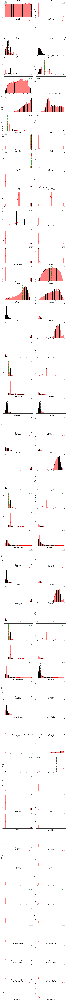

In [75]:
fig = plt.figure(figsize=(20,300))

for i, c in enumerate(ColonnesQuanti,1):
    ax = fig.add_subplot(53,2,i)
    #ax.hist(Data[c],  bins=30, color='grey')
    sns.histplot(DataTrain[c], color="red", label="100% Equities", kde=True, stat="density", linewidth=1)
    ax.set_title(c)
    ax.vlines(DataTrain[c].mean(), *ax.get_ylim(), color='black', ls='-.', lw=1.5)
    ax.vlines(DataTrain[c].median(), *ax.get_ylim(), color='green', ls='-.', lw=1.5)
     #ax.vlines(df[c].mode(), *ax.get_ylim(), color='blue', ls='-.', lw=1.5)
    ax.legend(['density', 'mean','median'])
    ax.title.set_fontweight('bold')
    
plt.tight_layout(w_pad=2, h_pad=0.65)

plt.show()

<u>Les variables quantitatives avec valeurs négatives </u> :
- <b>DAYS_BIRTH</b> (Client's age in days at the time of application) : <font color=blue>âge du client en nbre de jours au moment de la demande</font>
- <b>DAYS_EMPLOYED</b> (How many days before the application the person started current employment) : <font color=blue>nbre de jours avant la demande où le client a commencé à occuper son emploi actuel</font>
- <b>DAYS_REGISTRATION</b> (How many days before the application did client change his registration) : <font color=blue>nbre de jours avant la demande  où le client a modifié son inscription</font>
- <b>DAYS_ID_PUBLISH</b> (How many days before the application did client change the identity document with which he applied for the loan) : <font color=blue>nbre de jours avant la demande où le client a changé la pièce d’identité avec laquelle il a demandé le prêt</font>
- <b>DAYS_LAST_PHONE_CHANGE</b> (How many days before application did client change phone) : <font color=blue>nbre de jours avant la demande où le client a changé son téléphone</font>

<b>Variables qualitatives</b> :

In [76]:
#affichage des modalités des variables qualitatives (y compris avec valeurs nulles)
for column in ColonnesQuali:
    df = DataTrain.groupby(column, dropna = False)['SK_ID_CURR'].count().reset_index()
    df = df.rename(columns={'SK_ID_CURR': 'count'})
    df['Percentage'] = round(100 * df['count']  / df['count'].sum(),3)
    df.sort_values('Percentage',ascending=False,inplace=True)
    print("\n",df)



   NAME_CONTRACT_TYPE   count  Percentage
0         Cash loans  278232      90.479
1    Revolving loans   29279       9.521

   CODE_GENDER   count  Percentage
0           F  202448      65.834
1           M  105059      34.164
2         XNA       4       0.001

   FLAG_OWN_CAR   count  Percentage
0            N  202924      65.989
1            Y  104587      34.011

   FLAG_OWN_REALTY   count  Percentage
1               Y  213312      69.367
0               N   94199      30.633

    NAME_TYPE_SUITE   count  Percentage
6    Unaccompanied  248526      80.819
1           Family   40149      13.056
5  Spouse, partner   11370       3.697
0         Children    3267       1.062
4          Other_B    1770       0.576
7              NaN    1292       0.420
3          Other_A     866       0.282
2  Group of people     271       0.088

        NAME_INCOME_TYPE   count  Percentage
7               Working  158774      51.632
1  Commercial associate   71617      23.289
3             Pensioner   5

<u>Variables qualitatives présentant des valeurs nulles</u> :

- EMERGENCYSTATE_MODE (51,845%)<br>
- WALLSMATERIAL_MODE  (50.841%)<br>
- HOUSETYPE_MODE (50.176%)<br>
- FONDKAPREMONT_MODE (68.386%)  <br>
- OCCUPATION_TYPE (31.346%)<br>
- NAME_TYPE_SUITE (0.420%)<br>

<u>Variables qualitatives présentant des modalités non définies</u>:
- CODE_GENDER : XNA (0.001%)<br>


#### <font color="green" size=4>4.2 Analyse bivariée</font> <a href="#chapitre4" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_4_2"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

<b>Analyse de la TARGET en fonction des variables qualitatives</b> :

- NAME_CONTRACT_TYPE

In [77]:
pd.crosstab(DataTrain.TARGET, DataTrain.NAME_CONTRACT_TYPE, dropna=False, normalize='all')

NAME_CONTRACT_TYPE,Cash loans,Revolving loans
TARGET,,
0,0.829274,0.089997
1,0.075513,0.005216


- <b>90,5%</b> des demandes de crédits sont réservés à des prêts personnels (Cash loans) dont :<br>
 > 83% présentent aucune défaillances de remboursements<br>
 7,5% présentent des défaillances
<br><br>

- <b>9,5%</b> des demandes de crédits sont réservés à des crédits révolvings (Revolving loans) dont :<br>
 > 9% présentent aucune défaillances de remboursements<br>
 0,5% présentent des défaillances

- CODE_GENDER

In [78]:
pd.crosstab(DataTrain.TARGET, DataTrain.CODE_GENDER, dropna=False,normalize='all')

CODE_GENDER,F,M,XNA
TARGET,,,
0,0.612264,0.306994,0.000013
1,0.046080,0.034649,0.000000


- <b>65,8%</b> des demandes de crédits sont réservés à des femmes dont :
 > 61,2% présentent aucune défaillances de remboursements<br>
4,6% présentent des défaillances
<br><br>

- <b>34,2%</b> des demandes de crédits sont réservés à des hommes dont :
 > 30,7% présentent aucune défaillances de remboursements<br>
 3,5% présentent des défaillances
<br><br>

- <b>0,001%</b> des demandes de crédits sont réservés à un genre non défini dont :
 > 0,001% présentent aucune défaillances de remboursements<br>
 0,0% présentent des défaillances

- FLAG_OWN_CAR

In [79]:
pd.crosstab(DataTrain.TARGET, DataTrain.FLAG_OWN_CAR, dropna=False,normalize='all')

FLAG_OWN_CAR,N,Y
TARGET,,
0,0.603800,0.315472
1,0.056092,0.024637


- <b>66,0%</b> des demandes de crédits sont réservés à clients sans voiture dont :<br>
 > 60,4% présentent aucune défaillances de remboursements<br>
5,6% présentent des défaillances
<br><br>

- <b>34,0%</b> des demandes de crédits sont réservés à des clients possédant une voiture dont :<br>
 > 31,5% présentent aucune défaillances de remboursements<br>
2,5% présentent des défaillances

- FLAG_OWN_REALTY

In [80]:
pd.crosstab(DataTrain.TARGET, DataTrain.FLAG_OWN_REALTY, dropna=False,normalize='all')

FLAG_OWN_REALTY,N,Y
TARGET,,
0,0.280826,0.638445
1,0.025502,0.055227


- <b>30,6%</b> des demandes de crédits sont réservés à des clients non propriétaires dont :<br>
 > 28,1% présentent aucune défaillances de remboursements<br>
2,5% présentent des défaillances
<br><br>

- <b>69,4%</b> des demandes de crédits sont réservés à des clients propriétaires dont :<br>
 > 63,8% présentent aucune défaillances de remboursements<br>
5,6% présentent des défaillances

- NAME_INCOME_TYPE

In [81]:
pd.crosstab(DataTrain.TARGET, DataTrain.NAME_INCOME_TYPE, dropna=False,normalize='all')

NAME_INCOME_TYPE,Businessman,Commercial associate,Maternity leave,Pensioner,State servant,Student,Unemployed,Working
TARGET,,,,,,,,
0,0.000033,0.215462,0.000010,0.170335,0.066515,0.000059,0.000046,0.466813
1,0.000000,0.017430,0.000007,0.009697,0.004062,0.000000,0.000026,0.049507


Les 3 principales catégories de type de revenu sont :
1. Les Actifs (Working) = 51,6% dont 46,7% présentent aucune défaillances de remboursements<br>
2. Les Associés Commerciaux (Commercial associate) = 23,3% dont 21,5%  présentent aucune défaillances de remboursements<br>
3. Les Retraités (Pensioner) = 18% dont 17% présentent aucune défaillances de remboursements<br>

- NAME_EDUCATION_TYPE   

In [82]:
pd.crosstab(DataTrain.TARGET, DataTrain.NAME_EDUCATION_TYPE, dropna=False,normalize='all')

NAME_EDUCATION_TYPE,Academic degree,Higher education,Incomplete higher,Lower secondary,Secondary / secondary special
TARGET,,,,,
0,0.000524,0.230411,0.030584,0.011053,0.646699
1,0.000010,0.013037,0.002836,0.001356,0.063490


- <b>71,0%</b> des demandes de crédits sont réservés à des clients ayant effectués des études secondaires dont :<br>
 > 64,7% présentent aucune défaillances de remboursements<br>
6,3% présentent des défaillances
<br><br>

- <b>24,3%</b> des demandes de crédits sont réservés à des clients ayant effectués des études dans l'enseignement supérieur dont :<br>
 > 23,0% présentent aucune défaillances de remboursements<br>
1,3% présentent des défaillances

- NAME_FAMILY_STATUS

In [83]:
pd.crosstab(DataTrain.TARGET, DataTrain.NAME_FAMILY_STATUS, dropna=False,normalize='all')

NAME_FAMILY_STATUS,Civil marriage,Married,Separated,Single / not married,Unknown,Widow
TARGET,,,,,,
0,0.087197,0.590489,0.059022,0.133286,0.000007,0.049270
1,0.009629,0.048291,0.005268,0.014494,0.000000,0.003047


- <b>63,9%</b> des demandes de crédits sont réservés à des clients mariés dont :<br>
 > 59,0% présentent aucune défaillances de remboursements<br>
4,9% présentent des défaillances
<br><br>

- <b>14,8%</b> des demandes de crédits sont réservés à des clients célibataires dont :<br>
 > 13,3% présentent aucune défaillances de remboursements<br>
1,5% présentent des défaillances

-  WEEKDAY_APPR_PROCESS_START

In [84]:
pd.crosstab(DataTrain.TARGET, DataTrain.WEEKDAY_APPR_PROCESS_START, dropna=False,normalize='all')

WEEKDAY_APPR_PROCESS_START,FRIDAY,MONDAY,SATURDAY,SUNDAY,THURSDAY,TUESDAY,WEDNESDAY
TARGET,,,,,,,
0,0.150359,0.152125,0.101401,0.048447,0.151191,0.160645,0.155103
1,0.013336,0.012793,0.008683,0.004172,0.013326,0.014637,0.013782


- Le Mardi est le jour où les clients demandent le plus souvent des crédits (17,5% dont 16% présentent aucune défaillances)
- Le Lundi, Mercredi, Jeudi et Vendredi sont assez homogènes (16,5% dont 15% présentent aucune défaillances)
- Le Dimanche est la journée où il y a le moins de demandes (5,3% dont 4,8% présentent aucune défaillances)

<b>Analyse de la TARGET en fonction des variables quantitatives</b> :

<u>Matrice des corrélations de Pearson</u> :

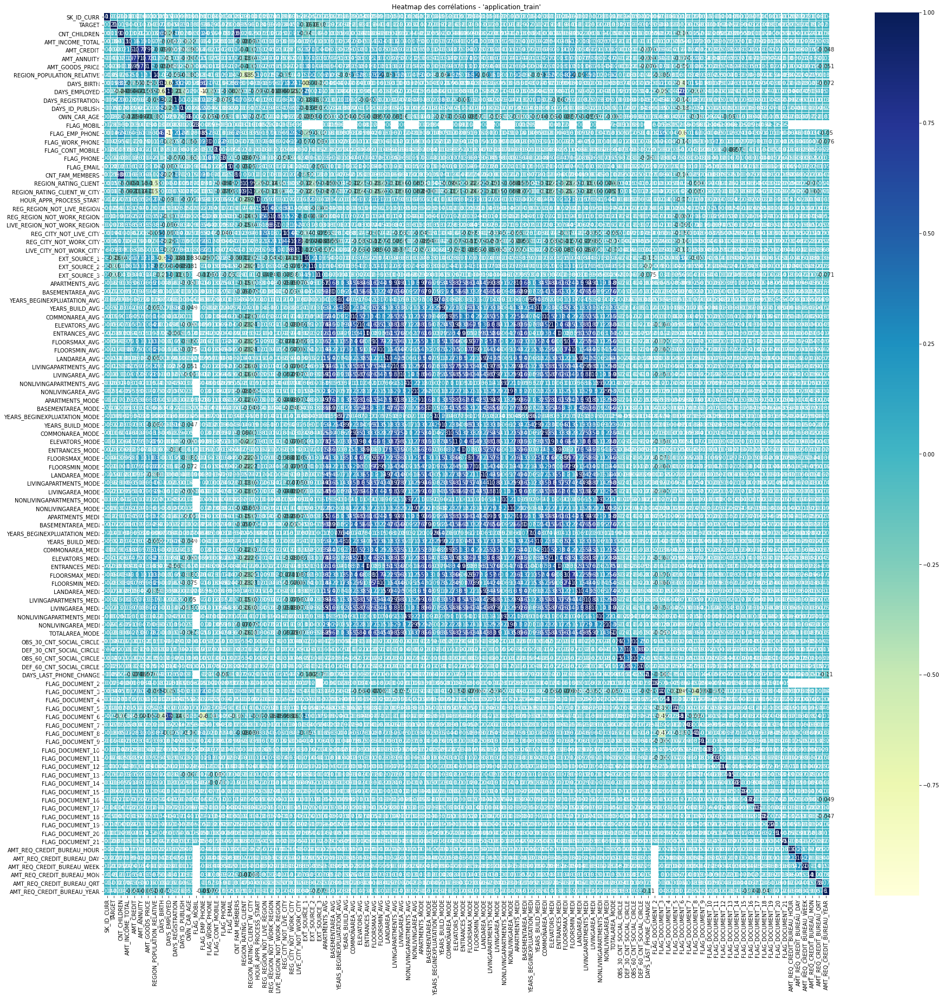

In [85]:
Data_num = DataTrain[ColonnesQuanti]

# Affichage de la heatmap des corrélations
plt.figure(figsize=(30,30))
sns.heatmap(Data_num.corr() , annot=True, linewidths=.2, cmap="YlGnBu")
plt.title("Heatmap des corrélations - 'application_train'");

In [86]:
#corrélation des features numériques avec TARGET
correlations = Data_num.corr()['TARGET'].sort_values(ascending=False)

In [87]:
#Top 20 corrélations positives
correlations.head(20)

TARGET                         1.000000
DAYS_BIRTH                     0.078239
REGION_RATING_CLIENT_W_CITY    0.060893
REGION_RATING_CLIENT           0.058899
DAYS_LAST_PHONE_CHANGE         0.055218
DAYS_ID_PUBLISH                0.051457
REG_CITY_NOT_WORK_CITY         0.050994
FLAG_EMP_PHONE                 0.045982
REG_CITY_NOT_LIVE_CITY         0.044395
FLAG_DOCUMENT_3                0.044346
DAYS_REGISTRATION              0.041975
OWN_CAR_AGE                    0.037612
LIVE_CITY_NOT_WORK_CITY        0.032518
DEF_30_CNT_SOCIAL_CIRCLE       0.032248
DEF_60_CNT_SOCIAL_CIRCLE       0.031276
FLAG_WORK_PHONE                0.028524
AMT_REQ_CREDIT_BUREAU_YEAR     0.019930
CNT_CHILDREN                   0.019187
CNT_FAM_MEMBERS                0.009308
OBS_30_CNT_SOCIAL_CIRCLE       0.009131
Name: TARGET, dtype: float64

Les 3 features numériques les + corrélées positivement à TARGET sont :
- DAYS_BIRTH (date d'anniversaire)
- REGION_RATING_CLIENT_W_CITY (classement de la région où vit le client avec prise en compte de la ville 1, 2 ou 3)
- REGION_RATING_CLIENT (classement de la région où vit le client 1, 2 ou 3)

In [88]:
#Top 20 corrélations négatives
correlations.tail(20)

AMT_CREDIT                   -0.030369
LIVINGAREA_MODE              -0.030685
ELEVATORS_MODE               -0.032131
TOTALAREA_MODE               -0.032596
FLOORSMIN_MODE               -0.032698
LIVINGAREA_MEDI              -0.032739
LIVINGAREA_AVG               -0.032997
FLOORSMIN_MEDI               -0.033394
FLOORSMIN_AVG                -0.033614
ELEVATORS_MEDI               -0.033863
ELEVATORS_AVG                -0.034199
REGION_POPULATION_RELATIVE   -0.037227
AMT_GOODS_PRICE              -0.039645
FLOORSMAX_MODE               -0.043226
FLOORSMAX_MEDI               -0.043768
FLOORSMAX_AVG                -0.044003
DAYS_EMPLOYED                -0.044932
EXT_SOURCE_1                 -0.155317
EXT_SOURCE_2                 -0.160472
EXT_SOURCE_3                 -0.178919
Name: TARGET, dtype: float64

Les 3 features numériques les + corrélées négativement à TARGET sont :
- EXT_SOURCE_3 (score normalisé d'une source externe)
- EXT_SOURCE_2 (score normalisé d'une source externe)
- EXT_SOURCE_1 (score normalisé d'une source externe)

In [89]:
# Correlations des 3 variables les plus corrélées positivement et négativement à la TARGET.
# Extraction des variables  EXT_SOURCE et calcul des correlations.
DataTrain_EXTRACT = DataTrain[['TARGET', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH','REGION_RATING_CLIENT_W_CITY','REGION_RATING_CLIENT']]

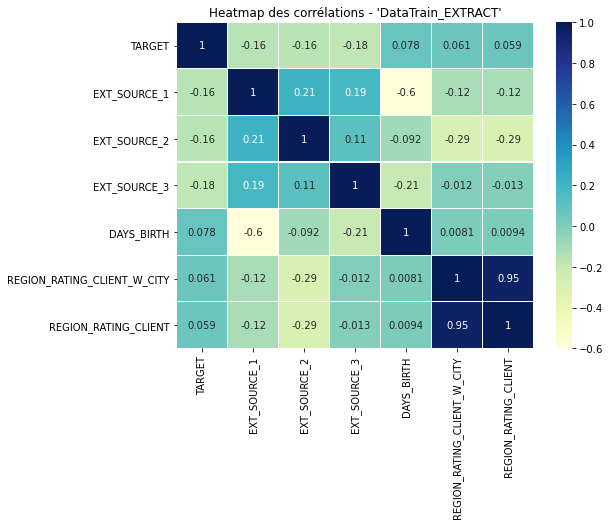

In [90]:
# Affichage de la heatmap des corrélations
plt.figure(figsize=(8,6))
sns.heatmap(DataTrain_EXTRACT.corr() , annot=True, linewidths=.2, cmap="YlGnBu")
plt.title("Heatmap des corrélations - 'DataTrain_EXTRACT'");

- REGION_RATING_CLIENT_W_CITY et REGION_RATING_CLIENT sont fortement corrélés (0,95)
- DAYS_BIRTH et EXT_SOURCE_1 sont corrélés négativement (-0,6)



#### <font color="green" size=4>4.3 Imputation des valeurs nulles</font> <a href="#chapitre4" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_4_3"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

- <i>Sur les variables quantitatives</i> :    

In [132]:
DataTrain_num = DataTrain[ColonnesQuanti]

In [134]:
ColonnesQuanti_NaN = DataTrain_num.columns[DataTrain_num.isnull().sum() > 0]
print("Nb de variables quantitatives avec valeurs manquantes :",len(ColonnesQuanti_NaN))

Nb de variables quantitatives avec valeurs manquantes : 61


In [136]:
print(ColonnesQuanti_NaN)

Index(['AMT_ANNUITY', 'AMT_GOODS_PRICE', 'OWN_CAR_AGE', 'CNT_FAM_MEMBERS',
       'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'APARTMENTS_AVG',
       'BASEMENTAREA_AVG', 'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG',
       'COMMONAREA_AVG', 'ELEVATORS_AVG', 'ENTRANCES_AVG', 'FLOORSMAX_AVG',
       'FLOORSMIN_AVG', 'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG',
       'LIVINGAREA_AVG', 'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG',
       'APARTMENTS_MODE', 'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE',
       'YEARS_BUILD_MODE', 'COMMONAREA_MODE', 'ELEVATORS_MODE',
       'ENTRANCES_MODE', 'FLOORSMAX_MODE', 'FLOORSMIN_MODE', 'LANDAREA_MODE',
       'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_MODE', 'NONLIVINGAPARTMENTS_MODE',
       'NONLIVINGAREA_MODE', 'APARTMENTS_MEDI', 'BASEMENTAREA_MEDI',
       'YEARS_BEGINEXPLUATATION_MEDI', 'YEARS_BUILD_MEDI', 'COMMONAREA_MEDI',
       'ELEVATORS_MEDI', 'ENTRANCES_MEDI', 'FLOORSMAX_MEDI', 'FLOORSMIN_MEDI',
       'LANDAREA_MEDI', 'LIVINGAPART

In [138]:
list_ColonnesQuanti_NaN = ['AMT_ANNUITY', 'AMT_GOODS_PRICE', 'OWN_CAR_AGE', 'CNT_FAM_MEMBERS',
       'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'APARTMENTS_AVG',
       'BASEMENTAREA_AVG', 'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG',
       'COMMONAREA_AVG', 'ELEVATORS_AVG', 'ENTRANCES_AVG', 'FLOORSMAX_AVG',
       'FLOORSMIN_AVG', 'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG',
       'LIVINGAREA_AVG', 'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG',
       'APARTMENTS_MODE', 'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE',
       'YEARS_BUILD_MODE', 'COMMONAREA_MODE', 'ELEVATORS_MODE',
       'ENTRANCES_MODE', 'FLOORSMAX_MODE', 'FLOORSMIN_MODE', 'LANDAREA_MODE',
       'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_MODE', 'NONLIVINGAPARTMENTS_MODE',
       'NONLIVINGAREA_MODE', 'APARTMENTS_MEDI', 'BASEMENTAREA_MEDI',
       'YEARS_BEGINEXPLUATATION_MEDI', 'YEARS_BUILD_MEDI', 'COMMONAREA_MEDI',
       'ELEVATORS_MEDI', 'ENTRANCES_MEDI', 'FLOORSMAX_MEDI', 'FLOORSMIN_MEDI',
       'LANDAREA_MEDI', 'LIVINGAPARTMENTS_MEDI', 'LIVINGAREA_MEDI',
       'NONLIVINGAPARTMENTS_MEDI', 'NONLIVINGAREA_MEDI', 'TOTALAREA_MODE',
       'OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE',
       'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE',
       'DAYS_LAST_PHONE_CHANGE', 'AMT_REQ_CREDIT_BUREAU_HOUR',
       'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_WEEK',
       'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT',
       'AMT_REQ_CREDIT_BUREAU_YEAR']

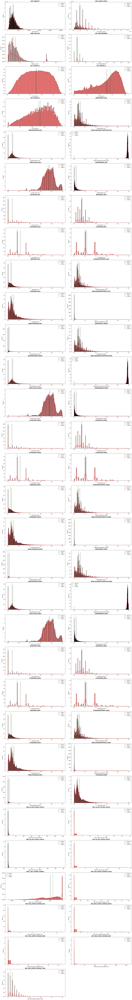

In [98]:
fig = plt.figure(figsize=(20,150))

for i, c in enumerate(list_ColonnesQuanti_NaN,1):
    ax = fig.add_subplot(31,2,i)
    #ax.hist(Data[c],  bins=30, color='grey')
    sns.histplot(DataTrain[c], color="red", label="100% Equities", kde=True, stat="density", linewidth=1)
    ax.set_title(c)
    ax.vlines(DataTrain[c].mean(), *ax.get_ylim(), color='black', ls='-.', lw=1.5)
    ax.vlines(DataTrain[c].median(), *ax.get_ylim(), color='green', ls='-.', lw=1.5)
     #ax.vlines(df[c].mode(), *ax.get_ylim(), color='blue', ls='-.', lw=1.5)
    ax.legend(['density', 'mean','median'])
    ax.title.set_fontweight('bold')
    
plt.tight_layout(w_pad=2, h_pad=0.65)

plt.show()

D'après La distribution des données sur les valeurs manquantes, la plupart de ces données présentent une forte asymétrie<br>

i) Nous testons <u>la médiane</u> pour compléter les valeurs manquantes.

In [99]:
DataTrain_impute_median = DataTrain.copy()
for i in list_ColonnesQuanti_NaN:
    DataTrain_impute_median[i].fillna(DataTrain_impute_median[i].median(), inplace=True)

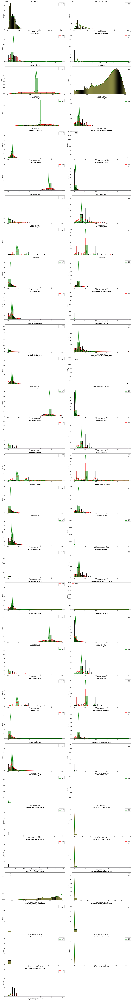

In [100]:
fig = plt.figure(figsize=(20,150))

for i, c in enumerate(list_ColonnesQuanti_NaN,1):
    ax = fig.add_subplot(31,2,i)
    sns.histplot(DataTrain[c], color="red", label="100% Equities", kde=True, stat="density", linewidth=1)
    sns.histplot(DataTrain_impute_median[c], color="green", label="100% Equities", kde=True, stat="density", linewidth=1)
    ax.set_title(c)
    ax.legend(["avant", "apres"])
    ax.title.set_fontweight('bold')
    
plt.tight_layout(w_pad=2, h_pad=0.65)

plt.show()

Visuellement après imputation par la médiane :
- 33 variables numériques sur 61 (soit +54%) ont une répartition de leurs données assez différentes des données d'origine
- 28 variables numériques sur 61 (soit +46%) ont une répartition de leurs données semblables à celles d'origine


ii) Nous testons <u>la moyenne</u> pour compléter les valeurs manquantes.

In [101]:
DataTrain_impute_mean = DataTrain.copy()
for i in list_ColonnesQuanti_NaN:
    DataTrain_impute_mean[i].fillna(DataTrain_impute_mean[i].mean(), inplace=True)

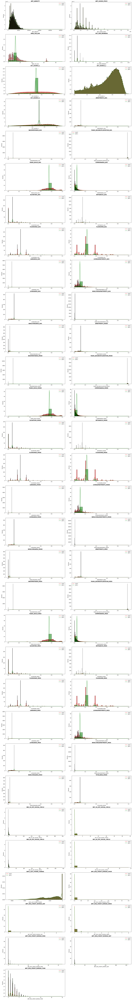

In [102]:
fig = plt.figure(figsize=(20,150))

for i, c in enumerate(list_ColonnesQuanti_NaN,1):
    ax = fig.add_subplot(31,2,i)
    sns.histplot(DataTrain[c], color="red", label="100% Equities", kde=True, stat="density", linewidth=1)
    sns.histplot(DataTrain_impute_mean[c], color="green", label="100% Equities", kde=True, stat="density", linewidth=1)
    ax.set_title(c)
    ax.legend(["avant", "apres"])
    ax.title.set_fontweight('bold')
    
plt.tight_layout(w_pad=2, h_pad=0.65)

plt.show()

Visuellement après imputation par la moyenne :
- 20 variables numériques sur 61 (soit +33%) ont une répartition de leurs données assez différentes des données d'origine
- 41 variables numériques sur 61 (soit +67%) ont une répartition de leurs données semblables à celles d'origine

iii) Nous testons <u>la valeur 0</u> pour compléter les valeurs manquantes.

In [98]:
DataTrain_impute_zero = DataTrain.copy()
for i in list_ColonnesQuanti_NaN:
    DataTrain_impute_zero[i].fillna(0, inplace=True)

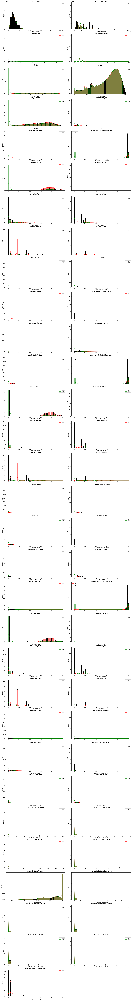

In [100]:
fig = plt.figure(figsize=(20,150))

for i, c in enumerate(list_ColonnesQuanti_NaN,1):
    ax = fig.add_subplot(31,2,i)
    sns.histplot(DataTrain[c], color="red", label="100% Equities", kde=True, stat="density", linewidth=1)
    sns.histplot(DataTrain_impute_zero[c], color="green", label="100% Equities", kde=True, stat="density", linewidth=1)
    ax.set_title(c)
    ax.legend(["avant", "apres"])
    ax.title.set_fontweight('bold')
    
plt.tight_layout(w_pad=2, h_pad=0.65)

plt.show()

Visuellement après imputation par la valeur 0 :
- 10 variables numériques sur 61 (soit +16%) ont une répartition de leurs données assez différentes des données d'origine
- 51 variables numériques sur 61 (soit +84%) ont une répartition de leurs données semblables à celles d'origine

<div class="alert alert-block alert-info"><b>On conservera donc la valeur 0 pour remplacer les valeurs NaN pour les variables quantitatives</b></div>

In [140]:
DataTrain_impute = DataTrain.copy()
for i in list_ColonnesQuanti_NaN:
    DataTrain_impute[i].fillna(0, inplace=True)

C:\Users\MOI\AppData\Local\Temp\ipykernel_21860\1072061630.py:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  DataTrain_impute[i].fillna(0, inplace=True)


- <i>Sur les variables qualitatives</i> :

In [143]:
DataTrain_cat = DataTrain[ColonnesQuali]

In [145]:
ColonnesQuali_NaN = DataTrain_cat.columns[DataTrain_cat.isnull().sum() > 0]
print("Nb de variables qualitatives avec valeurs manquantes :",len(ColonnesQuali_NaN))

Nb de variables qualitatives avec valeurs manquantes : 6


In [147]:
print(ColonnesQuali_NaN)

Index(['NAME_TYPE_SUITE', 'OCCUPATION_TYPE', 'FONDKAPREMONT_MODE',
       'HOUSETYPE_MODE', 'WALLSMATERIAL_MODE', 'EMERGENCYSTATE_MODE'],
      dtype='object')


In [149]:
list_ColonnesQuali_NaN = ['NAME_TYPE_SUITE', 'OCCUPATION_TYPE', 'FONDKAPREMONT_MODE',
       'HOUSETYPE_MODE', 'WALLSMATERIAL_MODE', 'EMERGENCYSTATE_MODE']

In [151]:
list_ColonnesQuali_NaN

['NAME_TYPE_SUITE',
 'OCCUPATION_TYPE',
 'FONDKAPREMONT_MODE',
 'HOUSETYPE_MODE',
 'WALLSMATERIAL_MODE',
 'EMERGENCYSTATE_MODE']

Remplissage des valeurs manquntes par la modalité la plus fréquente :


In [154]:
from sklearn.impute import SimpleImputer

# Imputation par le mode
imputer_mode = SimpleImputer(strategy='most_frequent')

for i in list_ColonnesQuali_NaN:
    DataTrain_impute[i] = imputer_mode.fit_transform(DataTrain_impute[[i]])
    

ValueError: 2

In [ ]:
#affichage des modalités des variables qualitatives (y compris avec valeurs nulles)
for column in list_ColonnesQuali_NaN:
    df = DataTrain_impute.groupby(column, dropna = False)['SK_ID_CURR'].count().reset_index()
    df = df.rename(columns={'SK_ID_CURR': 'count'})
    df['Percentage'] = round(100 * df['count']  / df['count'].sum(),3)
    df.sort_values('Percentage',ascending=False,inplace=True)
    print("\n",df)


<AxesSubplot:>

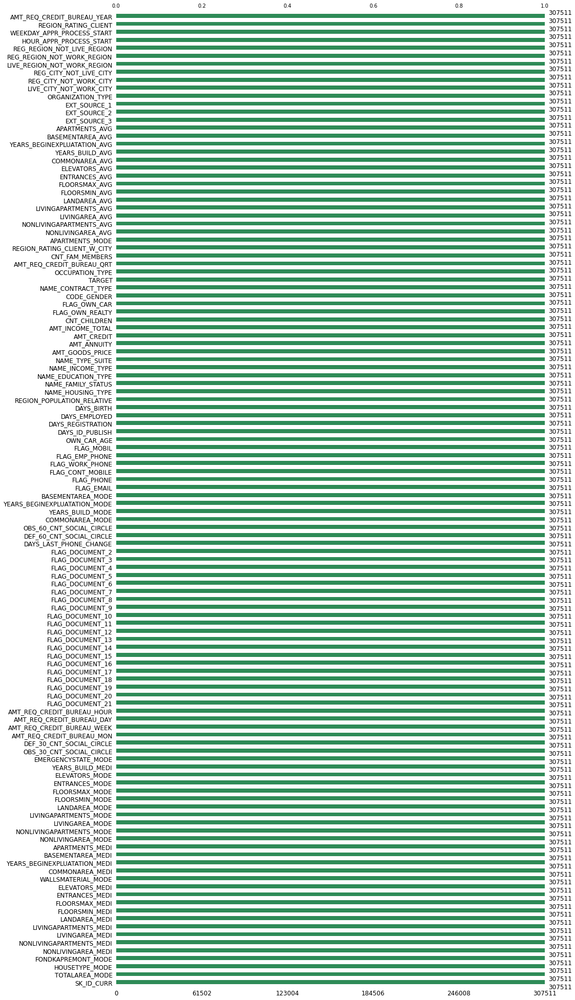

In [103]:
#verification de la complétion des valeurs
msno.bar(DataTrain_impute,figsize=(15,35), fontsize=12, color="seagreen", log=False, sort="ascending")

#### <font color="green" size=4>4.4 Recherche des outliers</font> <a href="#chapitre4" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_4_4"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

<b><u>i) Valeurs abérrantes absurdes</u></b>


<b>Pour les variables quantitatives à valeurs négatives</b> :

- Remplacement en valeur absolue

In [157]:
list_colonnes_quanti_neg = ['DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'DAYS_LAST_PHONE_CHANGE']

DataTrain_impute[ list_colonnes_quanti_neg ] = DataTrain_impute[ list_colonnes_quanti_neg ].abs()

<b>Pour les variables qualitatives </b> :
- Seule la variable CODE_GENDER définissant le genre du client HOMME / FEMME présente une modalité hors norme "XNA"
- On va donc supprimer cette valeur

In [160]:
DataTrain_impute.drop( DataTrain_impute[ DataTrain_impute['CODE_GENDER'] == 'XNA' ].index, inplace=True)

In [162]:
#affichage des modalités de la variable CODE_GENDER apres traitement
df = DataTrain_impute.groupby('CODE_GENDER', dropna = False)['SK_ID_CURR'].count().reset_index()
df = df.rename(columns={'SK_ID_CURR': 'count'})
df['Percentage'] = round(100 * df['count']  / df['count'].sum(),3)
df.sort_values('Percentage',ascending=False,inplace=True)
print("\n",df)



   CODE_GENDER   count  Percentage
0           F  202448      65.835
1           M  105059      34.165


<b><u>ii) Valeurs abérrantes extremes</u></b>


<u>Méthode InterQuartile</u> :

In [166]:
Data_num = DataTrain_impute[ColonnesQuanti]

In [168]:
fig = plt.figure(figsize=(20,300))

for i, c in enumerate(ColonnesQuanti,1):
    ax = fig.add_subplot(53,2,i)
    #ax.hist(Data_num[c],  bins=30, color='grey')
    ax = sns.boxplot(data=Data_num, x=c, orient="h", palette="Set2", medianprops=dict(linestyle='--', linewidth=1.5, color='white'))
    ax.set_title(c)
    ax.title.set_fontweight('bold')
    
plt.tight_layout(w_pad=2, h_pad=0.65)

plt.show()

C:\Users\MOI\AppData\Local\Temp\ipykernel_21860\1360735775.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(data=Data_num, x=c, orient="h", palette="Set2", medianprops=dict(linestyle='--', linewidth=1.5, color='white'))
C:\Users\MOI\AppData\Local\Temp\ipykernel_21860\1360735775.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(data=Data_num, x=c, orient="h", palette="Set2", medianprops=dict(linestyle='--', linewidth=1.5, color='white'))
C:\Users\MOI\AppData\Local\Temp\ipykernel_21860\1360735775.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same eff

Nous allons nous interessé à 2 variables avec valeurs extremes ;
- AMT_INCOME_TOTAL > 10000000
- DAYS_EMPLOYED > 350000

<u>AMT_INCOME_TOTAL</u>

In [170]:
DataTrain_impute.loc[DataTrain_impute['AMT_INCOME_TOTAL'] >= 100000000,('SK_ID_CURR','AMT_INCOME_TOTAL')]

,SK_ID_CURR,AMT_INCOME_TOTAL
12840,114967,117000000.0


In [172]:
DataTrain_impute.loc[DataTrain_impute['SK_ID_CURR'] == 114967,('OCCUPATION_TYPE')]

12840    Laborers
Name: OCCUPATION_TYPE, dtype: object

On va supprimer cette ligne car la valeur du salaire est la plus extreme et en contradiction avec le type de poste de travail (ici Ouvrier)

In [175]:
#drop de l'index concerné
DataTrain_impute.drop( DataTrain_impute[ DataTrain_impute['SK_ID_CURR'] == 114967 ].index, inplace=True)

In [177]:
#verification du drop
DataTrain_impute.loc[DataTrain_impute['AMT_INCOME_TOTAL'] >=  100000000,('SK_ID_CURR','AMT_INCOME_TOTAL')]

,SK_ID_CURR,AMT_INCOME_TOTAL


<u>DAYS_EMPLOYED</u> :

In [180]:
DataTrain_impute.loc[DataTrain_impute['DAYS_EMPLOYED'] >=  350000,('SK_ID_CURR','DAYS_EMPLOYED')]

,SK_ID_CURR,DAYS_EMPLOYED
8,100011,365243
11,100015,365243
23,100027,365243
38,100045,365243
43,100050,365243
...,...,...
307469,456209,365243
307483,456227,365243
307487,456231,365243
307505,456249,365243


Un nombre de jours travaillé égale à 365243 jours = 1000 ans ! est une valeur extreme abérante.<br>
On va la remplacer par NaN

In [183]:
# Remplace la valeur abérrante par NaN
DataTrain_impute['DAYS_EMPLOYED'].replace(365243, np.nan, inplace = True)

C:\Users\MOI\AppData\Local\Temp\ipykernel_21860\2108500928.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  DataTrain_impute['DAYS_EMPLOYED'].replace(365243, np.nan, inplace = True)


In [185]:
#verification 
DataTrain_impute.loc[DataTrain_impute['DAYS_EMPLOYED'] >=  350000,('SK_ID_CURR','DAYS_EMPLOYED')]

,SK_ID_CURR,DAYS_EMPLOYED


On va déterminer quelle valeur choisir pour les valeurs = NaN

- par la valeur 0 :

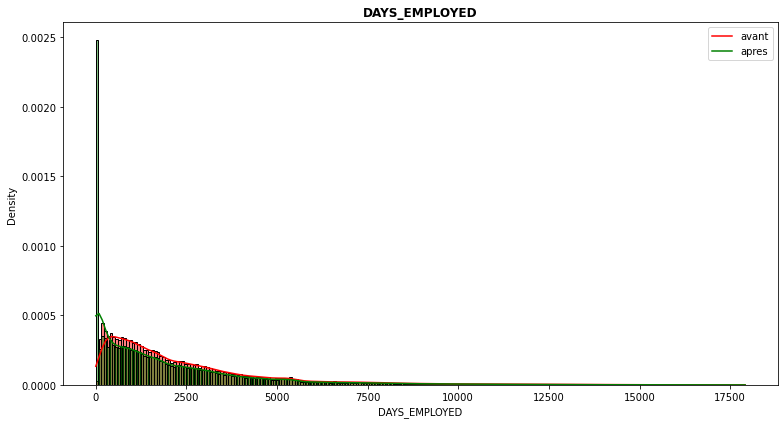

In [141]:
#par la valeur 0
DataTrain_impute_DAYS_EMP = DataTrain_impute.copy()
DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].fillna(0, inplace=True)
    
fig = plt.figure(figsize=(11,6))

ax = fig.add_subplot(1,1,1)
sns.histplot(DataTrain_impute['DAYS_EMPLOYED'], color="red", label="100% Equities", kde=True, stat="density", linewidth=1)
sns.histplot(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'], color="green", label="100% Equities", kde=True, stat="density", linewidth=1)
ax.set_title('DAYS_EMPLOYED')
ax.legend(["avant", "apres"])
ax.title.set_fontweight('bold')
    
plt.tight_layout(w_pad=2, h_pad=0.65)

plt.show()

In [142]:
print('Avant : écart type =',round(DataTrain_impute['DAYS_EMPLOYED'].std(),3))
print('Après : écart type =',round(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].std(),3))
print('Ecart (Après - Avant) =',round(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].std()-DataTrain_impute['DAYS_EMPLOYED'].std(),2))
print('')

Avant : écart type = 2338.33
Après : écart type = 2307.04
Ecart (Après - Avant) = -31.29



- par la médiane :

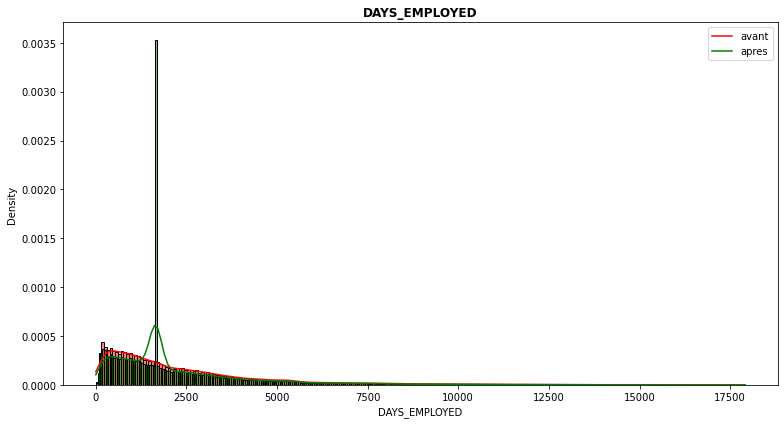

In [143]:
#par la médiane
DataTrain_impute_DAYS_EMP = DataTrain_impute.copy()
DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].fillna(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].median(), inplace=True)
    
fig = plt.figure(figsize=(11,6))

ax = fig.add_subplot(1,1,1)
sns.histplot(DataTrain_impute['DAYS_EMPLOYED'], color="red", label="100% Equities", kde=True, stat="density", linewidth=1)
sns.histplot(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'], color="green", label="100% Equities", kde=True, stat="density", linewidth=1)
ax.set_title('DAYS_EMPLOYED')
ax.legend(["avant", "apres"])
ax.title.set_fontweight('bold')
    
plt.tight_layout(w_pad=2, h_pad=0.65)

plt.show()

In [144]:
print('Avant : écart type =',round(DataTrain_impute['DAYS_EMPLOYED'].std(),3))
print('Après : écart type =',round(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].std(),3))
print('Ecart (Après - Avant) =',round(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].std()-DataTrain_impute['DAYS_EMPLOYED'].std(),2))
print('')

Avant : écart type = 2338.33
Après : écart type = 2136.162
Ecart (Après - Avant) = -202.17



- par la moyenne :

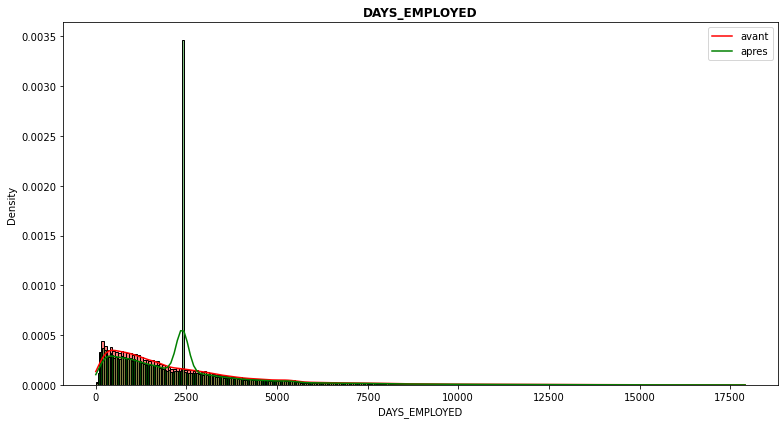

In [145]:
#par la moyenne
DataTrain_impute_DAYS_EMP = DataTrain_impute.copy()
DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].fillna(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].mean(), inplace=True)
    
fig = plt.figure(figsize=(11,6))

ax = fig.add_subplot(1,1,1)
sns.histplot(DataTrain_impute['DAYS_EMPLOYED'], color="red", label="100% Equities", kde=True, stat="density", linewidth=1)
sns.histplot(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'], color="green", label="100% Equities", kde=True, stat="density", linewidth=1)
ax.set_title('DAYS_EMPLOYED')
ax.legend(["avant", "apres"])
ax.title.set_fontweight('bold')
    
plt.tight_layout(w_pad=2, h_pad=0.65)

plt.show()

In [146]:
print('Avant : écart type =',round(DataTrain_impute['DAYS_EMPLOYED'].std(),3))
print('Après : écart type =',round(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].std(),3))
print('Ecart (Après - Avant) =',round(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].std()-DataTrain_impute['DAYS_EMPLOYED'].std(),2))
print('')

Avant : écart type = 2338.33
Après : écart type = 2117.351
Ecart (Après - Avant) = -220.98



<div class="alert alert-block alert-info"><b>Le choix de la valeur 0 est le plus pertinent car elle réduit au minimum la distribution de DAYS_EMPLOYED.<br>
De plus son écart-type après imputation par 0 est la plus proche des données d'origine.
</b></div>


In [187]:
# Remplace la valeur NaN par 0
DataTrain_impute['DAYS_EMPLOYED'].replace(np.nan, 0, inplace = True)

In [189]:
DataTrain_impute.loc[DataTrain_impute['DAYS_EMPLOYED'] == 0,('SK_ID_CURR','DAYS_EMPLOYED')]

,SK_ID_CURR,DAYS_EMPLOYED
8,100011,0.0
11,100015,0.0
23,100027,0.0
38,100045,0.0
43,100050,0.0
...,...,...
307469,456209,0.0
307483,456227,0.0
307487,456231,0.0
307505,456249,0.0


<div class="alert alert-block alert-info"><b>Notre dataset [DataTrain_impute] contient donc à présent toutes les données quantitaves et qualitatives nettoyées avec 100% de valeurs renseignées.
</b></div>


###  <font color="blue" size=5>Chapitre 5 - Feature enginnering </font><a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a><a id="chapitre5"></a><a name="chapitre5"></a>

#### <font color="green" size=4>5.1 Kernel Kaggle</font> <a href="#chapitre5" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_5_1"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

Le travail de feature engineering s'appuie sur le kernel Kaggle donné dans les ressources du projet :<br> https://www.kaggle.com/code/jsaguiar/lightgbm-with-simple-features/script

In [27]:
# HOME CREDIT DEFAULT RISK COMPETITION
# Most features are created by applying min, max, mean, sum and var functions to grouped tables. 
# Little feature selection is done and overfitting might be a problem since many features are related.
# The following key ideas were used:
# - Divide or subtract important features to get rates (like annuity and income)
# - In Bureau Data: create specific features for Active credits and Closed credits
# - In Previous Applications: create specific features for Approved and Refused applications
# - Modularity: one function for each table (except bureau_balance and application_test)
# - One-hot encoding for categorical features
# All tables are joined with the application DF using the SK_ID_CURR key (except bureau_balance).

import numpy as np
import pandas as pd
import gc
import time
from contextlib import contextmanager
from lightgbm import LGBMClassifier
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.model_selection import KFold, StratifiedKFold
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

@contextmanager
def timer(title):
    t0 = time.time()
    yield
    print("{} - done in {:.0f}s".format(title, time.time() - t0))

# One-hot encoding for categorical columns with get_dummies + Converting NaN Values into a Dummy Variable
def one_hot_encoder(df, nan_as_category = True):
    original_columns = list(df.columns)
    categorical_columns = [col for col in df.columns if df[col].dtype == 'object']
    df = pd.get_dummies(df, columns= categorical_columns, dummy_na= nan_as_category)
    new_columns = [c for c in df.columns if c not in original_columns]
    return df, new_columns

# Preprocess application_train.csv
def application_train(num_rows = None, nan_as_category = False):
    df = DataTrain_impute
    print("Train samples: {}".format(len(df)))
    # Optional: Remove 4 applications with XNA CODE_GENDER (train set)
    #df = df[df['CODE_GENDER'] != 'XNA']
    
    # Categorical features with Binary encode (0 or 1; two categories)
    for bin_feature in ['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY']:
        df[bin_feature], uniques = pd.factorize(df[bin_feature])
    # Categorical features with One-Hot encode
    df, cat_cols = one_hot_encoder(df, nan_as_category)
    
    # NaN values for DAYS_EMPLOYED: 365.243 -> nan
    #df['DAYS_EMPLOYED'].replace(365243, np.nan, inplace= True)
    # Some simple new features (percentages)
    
    # the percentage of the days employed relative to the client's age
    df['DAYS_EMPLOYED_PERC'] = df['DAYS_EMPLOYED'] / df['DAYS_BIRTH']
    # the percentage of the credit amount relative to a client's income
    df['CREDIT_INCOME_PERC'] = df['AMT_CREDIT'] / df['AMT_INCOME_TOTAL']
    #  the percentage of the client's income to one person in familly 
    df['INCOME_PER_PERSON'] = df['AMT_INCOME_TOTAL'] / df['CNT_FAM_MEMBERS']
    # the percentage of the loan annuity relative to a client's income
    df['ANNUITY_INCOME_PERC'] = df['AMT_ANNUITY'] / df['AMT_INCOME_TOTAL']
    # the length of the payment in months (since the annuity is the monthly amount due
    df['PAYMENT_RATE'] = df['AMT_ANNUITY'] / df['AMT_CREDIT']
    
    gc.collect()
    return df

# Preprocess bureau.csv and bureau_balance.csv
def bureau_and_balance(num_rows = None, nan_as_category = True):
    bureau = DataBureau
    bb = DataBureauBalance
    bb, bb_cat = one_hot_encoder(bb, nan_as_category)
    bureau, bureau_cat = one_hot_encoder(bureau, nan_as_category)
    
    # Bureau balance: Perform aggregations and merge with bureau.csv
    bb_aggregations = {'MONTHS_BALANCE': ['min', 'max', 'size']}
    for col in bb_cat:
        bb_aggregations[col] = ['mean']
    bb_agg = bb.groupby('SK_ID_BUREAU').agg(bb_aggregations)
    bb_agg.columns = pd.Index([e[0] + "_" + e[1].upper() for e in bb_agg.columns.tolist()])
    bureau = bureau.join(bb_agg, how='left', on='SK_ID_BUREAU')
    bureau.drop(['SK_ID_BUREAU'], axis=1, inplace= True)
    del bb, bb_agg
    gc.collect()
    
    # Bureau and bureau_balance numeric features
    num_aggregations = {
        'DAYS_CREDIT': ['min', 'max', 'mean', 'var'],
        'DAYS_CREDIT_ENDDATE': ['min', 'max', 'mean'],
        'DAYS_CREDIT_UPDATE': ['mean'],
        'CREDIT_DAY_OVERDUE': ['max', 'mean'],
        'AMT_CREDIT_MAX_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_DEBT': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM_LIMIT': ['mean', 'sum'],
        'AMT_ANNUITY': ['max', 'mean'],
        'CNT_CREDIT_PROLONG': ['sum'],
        'MONTHS_BALANCE_MIN': ['min'],
        'MONTHS_BALANCE_MAX': ['max'],
        'MONTHS_BALANCE_SIZE': ['mean', 'sum']
    }
    # Bureau and bureau_balance categorical features
    cat_aggregations = {}
    for cat in bureau_cat: cat_aggregations[cat] = ['mean']
    for cat in bb_cat: cat_aggregations[cat + "_MEAN"] = ['mean']
    
    bureau_agg = bureau.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    bureau_agg.columns = pd.Index(['BURO_' + e[0] + "_" + e[1].upper() for e in bureau_agg.columns.tolist()])
    # Bureau: Active credits - using only numerical aggregations
    active = bureau[bureau['CREDIT_ACTIVE_Active'] == 1]
    active_agg = active.groupby('SK_ID_CURR').agg(num_aggregations)
    active_agg.columns = pd.Index(['ACTIVE_' + e[0] + "_" + e[1].upper() for e in active_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(active_agg, how='left', on='SK_ID_CURR')
    del active, active_agg
    gc.collect()
    # Bureau: Closed credits - using only numerical aggregations
    closed = bureau[bureau['CREDIT_ACTIVE_Closed'] == 1]
    closed_agg = closed.groupby('SK_ID_CURR').agg(num_aggregations)
    closed_agg.columns = pd.Index(['CLOSED_' + e[0] + "_" + e[1].upper() for e in closed_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(closed_agg, how='left', on='SK_ID_CURR')
    del closed, closed_agg, bureau
    gc.collect()
    return bureau_agg

# Preprocess previous_applications.csv
def previous_applications(num_rows = None, nan_as_category = True):
    prev = DataPreviousApplication
    prev, cat_cols = one_hot_encoder(prev, nan_as_category= True)
    # Days 365.243 values -> nan
    prev['DAYS_FIRST_DRAWING'].replace(365243, np.nan, inplace= True)
    prev['DAYS_FIRST_DUE'].replace(365243, np.nan, inplace= True)
    prev['DAYS_LAST_DUE_1ST_VERSION'].replace(365243, np.nan, inplace= True)
    prev['DAYS_LAST_DUE'].replace(365243, np.nan, inplace= True)
    prev['DAYS_TERMINATION'].replace(365243, np.nan, inplace= True)
    # Add feature: value ask / value received percentage
    prev['APP_CREDIT_PERC'] = prev['AMT_APPLICATION'] / prev['AMT_CREDIT']
    # Previous applications numeric features
    num_aggregations = {
        'AMT_ANNUITY': ['min', 'max', 'mean'],
        'AMT_APPLICATION': ['min', 'max', 'mean'],
        'AMT_CREDIT': ['min', 'max', 'mean'],
        'APP_CREDIT_PERC': ['min', 'max', 'mean', 'var'],
        'AMT_DOWN_PAYMENT': ['min', 'max', 'mean'],
        'AMT_GOODS_PRICE': ['min', 'max', 'mean'],
        'HOUR_APPR_PROCESS_START': ['min', 'max', 'mean'],
        'RATE_DOWN_PAYMENT': ['min', 'max', 'mean'],
        'DAYS_DECISION': ['min', 'max', 'mean'],
        'CNT_PAYMENT': ['mean', 'sum'],
    }
    # Previous applications categorical features
    cat_aggregations = {}
    for cat in cat_cols:
        cat_aggregations[cat] = ['mean']
    
    prev_agg = prev.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    prev_agg.columns = pd.Index(['PREV_' + e[0] + "_" + e[1].upper() for e in prev_agg.columns.tolist()])
    # Previous Applications: Approved Applications - only numerical features
    approved = prev[prev['NAME_CONTRACT_STATUS_Approved'] == 1]
    approved_agg = approved.groupby('SK_ID_CURR').agg(num_aggregations)
    approved_agg.columns = pd.Index(['APPROVED_' + e[0] + "_" + e[1].upper() for e in approved_agg.columns.tolist()])
    prev_agg = prev_agg.join(approved_agg, how='left', on='SK_ID_CURR')
    # Previous Applications: Refused Applications - only numerical features
    refused = prev[prev['NAME_CONTRACT_STATUS_Refused'] == 1]
    refused_agg = refused.groupby('SK_ID_CURR').agg(num_aggregations)
    refused_agg.columns = pd.Index(['REFUSED_' + e[0] + "_" + e[1].upper() for e in refused_agg.columns.tolist()])
    prev_agg = prev_agg.join(refused_agg, how='left', on='SK_ID_CURR')
    del refused, refused_agg, approved, approved_agg, prev
    gc.collect()
    return prev_agg

# Preprocess POS_CASH_balance.csv
def pos_cash(num_rows = None, nan_as_category = True):
    pos = DataPosCashBalance
    pos, cat_cols = one_hot_encoder(pos, nan_as_category= True)
    # Features
    aggregations = {
        'MONTHS_BALANCE': ['max', 'mean', 'size'],
        'SK_DPD': ['max', 'mean'],
        'SK_DPD_DEF': ['max', 'mean']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']
    
    pos_agg = pos.groupby('SK_ID_CURR').agg(aggregations)
    pos_agg.columns = pd.Index(['POS_' + e[0] + "_" + e[1].upper() for e in pos_agg.columns.tolist()])
    # Count pos cash accounts
    pos_agg['POS_COUNT'] = pos.groupby('SK_ID_CURR').size()
    del pos
    gc.collect()
    return pos_agg
    
# Preprocess installments_payments.csv
def installments_payments(num_rows = None, nan_as_category = True):
    ins = DataInstallmentsPayments
    ins, cat_cols = one_hot_encoder(ins, nan_as_category= True)
    # Percentage and difference paid in each installment (amount paid and installment value)
    ins['PAYMENT_PERC'] = ins['AMT_PAYMENT'] / ins['AMT_INSTALMENT']
    ins['PAYMENT_DIFF'] = ins['AMT_INSTALMENT'] - ins['AMT_PAYMENT']
    # Days past due and days before due (no negative values)
    ins['DPD'] = ins['DAYS_ENTRY_PAYMENT'] - ins['DAYS_INSTALMENT']
    ins['DBD'] = ins['DAYS_INSTALMENT'] - ins['DAYS_ENTRY_PAYMENT']
    ins['DPD'] = ins['DPD'].apply(lambda x: x if x > 0 else 0)
    ins['DBD'] = ins['DBD'].apply(lambda x: x if x > 0 else 0)
    # Features: Perform aggregations
    aggregations = {
        'NUM_INSTALMENT_VERSION': ['nunique'],
        'DPD': ['max', 'mean', 'sum'],
        'DBD': ['max', 'mean', 'sum'],
        'PAYMENT_PERC': ['max', 'mean', 'sum', 'var'],
        'PAYMENT_DIFF': ['max', 'mean', 'sum', 'var'],
        'AMT_INSTALMENT': ['max', 'mean', 'sum'],
        'AMT_PAYMENT': ['min', 'max', 'mean', 'sum'],
        'DAYS_ENTRY_PAYMENT': ['max', 'mean', 'sum']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']
    ins_agg = ins.groupby('SK_ID_CURR').agg(aggregations)
    ins_agg.columns = pd.Index(['INSTAL_' + e[0] + "_" + e[1].upper() for e in ins_agg.columns.tolist()])
    # Count installments accounts
    ins_agg['INSTAL_COUNT'] = ins.groupby('SK_ID_CURR').size()
    del ins
    gc.collect()
    return ins_agg

# Preprocess credit_card_balance.csv
def credit_card_balance(num_rows = None, nan_as_category = True):
    cc = DataCreditCardBalance
    cc, cat_cols = one_hot_encoder(cc, nan_as_category= True)
    # General aggregations
    cc.drop(['SK_ID_PREV'], axis= 1, inplace = True)
    cc_agg = cc.groupby('SK_ID_CURR').agg(['min', 'max', 'mean', 'sum', 'var'])
    cc_agg.columns = pd.Index(['CC_' + e[0] + "_" + e[1].upper() for e in cc_agg.columns.tolist()])
    # Count credit card lines
    cc_agg['CC_COUNT'] = cc.groupby('SK_ID_CURR').size()
    del cc
    gc.collect()
    return cc_agg

# calul des features engineering avec jointure des différents datasets sur le dataset TRAIN
def feature_engineering(num_rows=None):

    df = application_train(num_rows)
    with timer("Process bureau and bureau_balance"):
        bureau = bureau_and_balance(num_rows)
        print("Bureau df shape:", bureau.shape)
        df = df.join(bureau, how='left', on='SK_ID_CURR')
        del bureau
        gc.collect()
    with timer("Process previous_applications"):
        prev = previous_applications(num_rows)
        print("Previous applications df shape:", prev.shape)
        df = df.join(prev, how='left', on='SK_ID_CURR')
        del prev
        gc.collect()
    with timer("Process POS-CASH balance"):
        pos = pos_cash(num_rows)
        print("Pos-cash balance df shape:", pos.shape)
        df = df.join(pos, how='left', on='SK_ID_CURR')
        del pos
        gc.collect()
    with timer("Process installments payments"):
        ins = installments_payments(num_rows)
        print("Installments payments df shape:", ins.shape)
        df = df.join(ins, how='left', on='SK_ID_CURR')
        del ins
        gc.collect()
    with timer("Process credit card balance"):
        cc = credit_card_balance(num_rows)
        print("Credit card balance df shape:", cc.shape)
        df = df.join(cc, how='left', on='SK_ID_CURR')
        del cc
        gc.collect()
    
    df.to_csv('Sources/my_data_feature_engineering.csv', index=False)
    
    return df

In [193]:
df = feature_engineering()

Train samples: 307506
Bureau df shape: (305811, 116)
Process bureau and bureau_balance - done in 15s
Previous applications df shape: (338857, 249)
Process previous_applications - done in 23s
Pos-cash balance df shape: (337252, 18)
Process POS-CASH balance - done in 10s
Installments payments df shape: (339587, 26)
Process installments payments - done in 18s
Credit card balance df shape: (103558, 141)
Process credit card balance - done in 10s


#### <font color="green" size=4>5.2 Dataset finalisé</font> <a href="#chapitre5" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_5_2"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

In [180]:
source_repertory = 'Sources/'
delimiter_file = ','
source_data='my_data_feature_engineering.csv'

#DataFeatureEngennering = pd.read_csv(open(source_repertory + source_data,'r'), sep = delimiter_file)
DataFeatureEngennering = pd.read_csv(source_repertory + source_data, sep = delimiter_file)

In [182]:
DataFeatureEngennering.shape

(307506, 797)

In [184]:
DataFeatureEngennering.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307506 entries, 0 to 307505
Columns: 797 entries, SK_ID_CURR to CC_COUNT
dtypes: bool(133), float64(605), int64(43), object(16)
memory usage: 1.6+ GB


Le dataset obtenu après feature engineering du kernel Kaggle est entièrement composé de variables numériques :
- 621 variables de type float64
- 177 variables de type int64

In [152]:
DataFeatureEngennering

,SK_ID_CURR,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Revolving loans,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_

In [186]:
#variables avec uniquement les colonnes de type object  = colonnes qualitatives
i = 0
ColonnesObject= list(DataFeatureEngennering.select_dtypes(include=['object']).columns)
print("Les variables qualitatives de type Object sont les suivantes : \n")
for categ in ColonnesObject :
    print(categ, ":", DataFeatureEngennering[categ].nunique())
    i = i + 1
print("\nNb variables qualitatives de type Object = ",i)

Les variables qualitatives de type Object sont les suivantes : 

CC_NAME_CONTRACT_STATUS_Active_MIN : 2
CC_NAME_CONTRACT_STATUS_Active_MAX : 2
CC_NAME_CONTRACT_STATUS_Approved_MIN : 1
CC_NAME_CONTRACT_STATUS_Approved_MAX : 2
CC_NAME_CONTRACT_STATUS_Completed_MIN : 2
CC_NAME_CONTRACT_STATUS_Completed_MAX : 2
CC_NAME_CONTRACT_STATUS_Demand_MIN : 1
CC_NAME_CONTRACT_STATUS_Demand_MAX : 2
CC_NAME_CONTRACT_STATUS_Refused_MIN : 1
CC_NAME_CONTRACT_STATUS_Refused_MAX : 2
CC_NAME_CONTRACT_STATUS_Sent proposal_MIN : 1
CC_NAME_CONTRACT_STATUS_Sent proposal_MAX : 2
CC_NAME_CONTRACT_STATUS_Signed_MIN : 2
CC_NAME_CONTRACT_STATUS_Signed_MAX : 2
CC_NAME_CONTRACT_STATUS_nan_MIN : 1
CC_NAME_CONTRACT_STATUS_nan_MAX : 1

Nb variables qualitatives de type Object =  16


In [188]:
for categ in ColonnesObject :
    DataFeatureEngennering[categ] = DataFeatureEngennering[categ].astype(object).astype(bool)

In [190]:
DataFeatureEngennering['CC_NAME_CONTRACT_STATUS_Signed_MAX'].value_counts()

CC_NAME_CONTRACT_STATUS_Signed_MAX
True     224892
False     82614
Name: count, dtype: int64

In [192]:
DataFeatureEngennering.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307506 entries, 0 to 307505
Columns: 797 entries, SK_ID_CURR to CC_COUNT
dtypes: bool(149), float64(605), int64(43)
memory usage: 1.5 GB


In [194]:
#variables avec uniquement les colonnes de type bool  = colonnes qualitatives
i = 0
ColonnesBool= list(DataFeatureEngennering.select_dtypes(include=['bool']).columns)
print("Les variables qualitatives de type booleen sont les suivantes : \n")
for categ in ColonnesBool :
    print(categ, ":", DataFeatureEngennering[categ].nunique())
    i = i + 1
print("\nNb variables qualitatives de type booleen = ",i)

Les variables qualitatives de type booleen sont les suivantes : 

NAME_CONTRACT_TYPE_Cash loans : 2
NAME_CONTRACT_TYPE_Revolving loans : 2
NAME_TYPE_SUITE_Children : 2
NAME_TYPE_SUITE_Family : 2
NAME_TYPE_SUITE_Group of people : 2
NAME_TYPE_SUITE_Other_A : 2
NAME_TYPE_SUITE_Other_B : 2
NAME_TYPE_SUITE_Spouse, partner : 2
NAME_TYPE_SUITE_Unaccompanied : 2
NAME_INCOME_TYPE_Businessman : 2
NAME_INCOME_TYPE_Commercial associate : 2
NAME_INCOME_TYPE_Maternity leave : 2
NAME_INCOME_TYPE_Pensioner : 2
NAME_INCOME_TYPE_State servant : 2
NAME_INCOME_TYPE_Student : 2
NAME_INCOME_TYPE_Unemployed : 2
NAME_INCOME_TYPE_Working : 2
NAME_EDUCATION_TYPE_Academic degree : 2
NAME_EDUCATION_TYPE_Higher education : 2
NAME_EDUCATION_TYPE_Incomplete higher : 2
NAME_EDUCATION_TYPE_Lower secondary : 2
NAME_EDUCATION_TYPE_Secondary / secondary special : 2
NAME_FAMILY_STATUS_Civil marriage : 2
NAME_FAMILY_STATUS_Married : 2
NAME_FAMILY_STATUS_Separated : 2
NAME_FAMILY_STATUS_Single / not married : 2
NAME_FAMILY_

In [196]:
for categ in ColonnesBool :
    DataFeatureEngennering[categ] = DataFeatureEngennering[categ].astype(bool).astype(int)

In [198]:
DataFeatureEngennering.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307506 entries, 0 to 307505
Columns: 797 entries, SK_ID_CURR to CC_COUNT
dtypes: float64(605), int32(149), int64(43)
memory usage: 1.7 GB


In [202]:
DataFeatureEngennering['CC_NAME_CONTRACT_STATUS_Demand_MIN'].value_counts()

CC_NAME_CONTRACT_STATUS_Demand_MIN
1    220601
0     86905
Name: count, dtype: int64

In [204]:
# Check for infinity values
is_infinite = DataFeatureEngennering.isin([np.inf, -np.inf])

res = is_infinite.any().any()
print(res)

True


In [38]:
# colonnes avec des valeurs infinis 
def get_columns_with_infinite_values(df):
    res = pd.DataFrame()
    inf_cols = df.columns[np.isinf(df).any()]
    for col in inf_cols:
        inf_rows = np.isinf(df[col]).sum()
        res = res.append(
            {'colonne': col, 'inf_count': inf_rows}, ignore_index=True)
    return res

get_columns_with_infinite_values(DataFeatureEngennering)

NameError: name 'DataFeatureEngennering' is not defined

In [206]:
#visualisation des valeurs infinies
DataFeatureEngennering.loc[DataFeatureEngennering['INCOME_PER_PERSON'].isin([np.inf, -np.inf]),('SK_ID_CURR','INCOME_PER_PERSON')]

,SK_ID_CURR,INCOME_PER_PERSON
41979,148605,inf
187344,317181,inf


In [208]:
# on remplace les valeurs infinies avec np.nan
def replace_infinite_values_with_nan(df: pd.DataFrame):
    print(f'les valeurs infinite ont bien remplacé')
    return df.replace([np.inf, -np.inf], np.nan)

DataFeatureEngennering = replace_infinite_values_with_nan(DataFeatureEngennering)

les valeurs infinite ont bien remplacé


In [209]:
# colonnes avec une seule modalité 
def get_single_value_cols(df: pd.DataFrame):
    unique_vals = df.nunique()
    return unique_vals[unique_vals == 1].index.to_list()

get_single_value_cols(DataFeatureEngennering)
#df_data = drop_single_value_cols(df_data)
#df_data.shape

['BURO_CREDIT_ACTIVE_nan_MEAN',
 'BURO_CREDIT_CURRENCY_nan_MEAN',
 'BURO_CREDIT_TYPE_nan_MEAN',
 'BURO_STATUS_nan_MEAN_MEAN',
 'PREV_NAME_CONTRACT_TYPE_nan_MEAN',
 'PREV_WEEKDAY_APPR_PROCESS_START_nan_MEAN',
 'PREV_FLAG_LAST_APPL_PER_CONTRACT_nan_MEAN',
 'PREV_NAME_CASH_LOAN_PURPOSE_nan_MEAN',
 'PREV_NAME_CONTRACT_STATUS_nan_MEAN',
 'PREV_NAME_PAYMENT_TYPE_nan_MEAN',
 'PREV_CODE_REJECT_REASON_nan_MEAN',
 'PREV_NAME_CLIENT_TYPE_nan_MEAN',
 'PREV_NAME_GOODS_CATEGORY_House Construction_MEAN',
 'PREV_NAME_GOODS_CATEGORY_nan_MEAN',
 'PREV_NAME_PORTFOLIO_nan_MEAN',
 'PREV_NAME_PRODUCT_TYPE_nan_MEAN',
 'PREV_CHANNEL_TYPE_nan_MEAN',
 'PREV_NAME_SELLER_INDUSTRY_nan_MEAN',
 'PREV_NAME_YIELD_GROUP_nan_MEAN',
 'POS_NAME_CONTRACT_STATUS_nan_MEAN',
 'CC_SK_DPD_MIN',
 'CC_SK_DPD_DEF_MIN',
 'CC_NAME_CONTRACT_STATUS_nan_MEAN',
 'CC_NAME_CONTRACT_STATUS_nan_SUM',
 'CC_NAME_CONTRACT_STATUS_nan_VAR']

In [212]:
#visualisation d'une colonne avec 1 modalité
print('Nb valeurs distincts pour BURO_CREDIT_ACTIVE_nan_MEAN proposal_MIN :',len(DataFeatureEngennering.groupby('BURO_CREDIT_ACTIVE_nan_MEAN')))
resultat = DataFeatureEngennering.groupby(['BURO_CREDIT_ACTIVE_nan_MEAN'], dropna=True).size().reset_index()
resultat.columns = ['BURO_CREDIT_ACTIVE_nan_MEAN','nb']
resultat['Percentage'] = 100 * resultat['nb']  / resultat['nb'].sum()
resultat.sort_values('Percentage',ascending=False,inplace=True)
resultat.head(10)

Nb valeurs distincts pour BURO_CREDIT_ACTIVE_nan_MEAN proposal_MIN : 1


,BURO_CREDIT_ACTIVE_nan_MEAN,nb,Percentage
0,0.0,263486,100.0


In [214]:
#suppression des colonnes avec 1 seule modalité
def drop_single_value_cols(df: pd.DataFrame, cols_to_drop=None):
    if cols_to_drop is None:
        cols_to_drop = get_single_value_cols(df)
    if len(cols_to_drop) > 0:
        print(f'supprimer les colonnes avec seulement une valeur, nb.cols = {len(cols_to_drop)}')
        return df.drop(columns=cols_to_drop)
    return df

DataFeatureEngennering = drop_single_value_cols(DataFeatureEngennering)
DataFeatureEngennering.shape

supprimer les colonnes avec seulement une valeur, nb.cols = 25


(307506, 772)

Variables avec valeurs manquantes :

In [217]:
ColonnesQuanti_NaN = DataFeatureEngennering.columns[DataFeatureEngennering.isnull().sum() > 0]
print("Nb de variables quantitatives avec valeurs manquantes :",len(ColonnesQuanti_NaN))


Nb de variables quantitatives avec valeurs manquantes : 510


In [219]:
print(ColonnesQuanti_NaN)

Index(['INCOME_PER_PERSON', 'BURO_DAYS_CREDIT_MIN', 'BURO_DAYS_CREDIT_MAX',
       'BURO_DAYS_CREDIT_MEAN', 'BURO_DAYS_CREDIT_VAR',
       'BURO_DAYS_CREDIT_ENDDATE_MIN', 'BURO_DAYS_CREDIT_ENDDATE_MAX',
       'BURO_DAYS_CREDIT_ENDDATE_MEAN', 'BURO_DAYS_CREDIT_UPDATE_MEAN',
       'BURO_CREDIT_DAY_OVERDUE_MAX',
       ...
       'CC_NAME_CONTRACT_STATUS_Refused_MEAN',
       'CC_NAME_CONTRACT_STATUS_Refused_SUM',
       'CC_NAME_CONTRACT_STATUS_Refused_VAR',
       'CC_NAME_CONTRACT_STATUS_Sent proposal_MEAN',
       'CC_NAME_CONTRACT_STATUS_Sent proposal_SUM',
       'CC_NAME_CONTRACT_STATUS_Sent proposal_VAR',
       'CC_NAME_CONTRACT_STATUS_Signed_MEAN',
       'CC_NAME_CONTRACT_STATUS_Signed_SUM',
       'CC_NAME_CONTRACT_STATUS_Signed_VAR', 'CC_COUNT'],
      dtype='object', length=510)


In [221]:
for i in ColonnesQuanti_NaN:  
    DataFeatureEngennering[i].replace(np.nan, 0, inplace= True)

In [223]:
#controle des variables avec valeur manquante apres imputation
print("Nb de variables quantitatives avec valeurs manquantes :",len(DataFeatureEngennering.columns[DataFeatureEngennering.isnull().sum() > 0]))

Nb de variables quantitatives avec valeurs manquantes : 0


In [225]:
DataFeatureEngennering

,SK_ID_CURR,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Revolving loans,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_

Suppression des variables corrélées >= 90%

In [228]:
# Threshold for removing correlated variables fixed at 90%
threshold = 0.9

# Absolute value correlation matrix
corr_matrix = DataFeatureEngennering.corr().abs()
corr_matrix.head()

,SK_ID_CURR,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Revolving loans,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_

In [230]:
# Upper triangle of correlations
#upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
upper.head()

,SK_ID_CURR,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Revolving loans,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_

In [232]:
# Select columns with correlations above threshold
to_drop = [column for column in upper.columns if any(upper[column] > threshold)]

print('There are %d columns to remove.' % (len(to_drop)))

There are 181 columns to remove.


In [234]:
to_drop

['AMT_GOODS_PRICE',
 'REGION_RATING_CLIENT_W_CITY',
 'LIVINGAREA_AVG',
 'APARTMENTS_MODE',
 'BASEMENTAREA_MODE',
 'YEARS_BEGINEXPLUATATION_MODE',
 'YEARS_BUILD_MODE',
 'COMMONAREA_MODE',
 'ELEVATORS_MODE',
 'ENTRANCES_MODE',
 'FLOORSMAX_MODE',
 'FLOORSMIN_MODE',
 'LANDAREA_MODE',
 'LIVINGAPARTMENTS_MODE',
 'LIVINGAREA_MODE',
 'NONLIVINGAPARTMENTS_MODE',
 'NONLIVINGAREA_MODE',
 'APARTMENTS_MEDI',
 'BASEMENTAREA_MEDI',
 'YEARS_BEGINEXPLUATATION_MEDI',
 'YEARS_BUILD_MEDI',
 'COMMONAREA_MEDI',
 'ELEVATORS_MEDI',
 'ENTRANCES_MEDI',
 'FLOORSMAX_MEDI',
 'FLOORSMIN_MEDI',
 'LANDAREA_MEDI',
 'LIVINGAPARTMENTS_MEDI',
 'LIVINGAREA_MEDI',
 'NONLIVINGAPARTMENTS_MEDI',
 'NONLIVINGAREA_MEDI',
 'TOTALAREA_MODE',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'NAME_CONTRACT_TYPE_Revolving loans',
 'NAME_INCOME_TYPE_Pensioner',
 'ORGANIZATION_TYPE_XNA',
 'HOUSETYPE_MODE_block of flats',
 'EMERGENCYSTATE_MODE_No',
 'DAYS_EMPLOYED_PERC',
 'BURO_AMT_CREDIT_SUM_DEBT_SUM',
 'ACTIVE_DAYS_CREDIT_MEAN',
 'ACTIVE_DAYS_CREDIT_END

In [236]:
# Drop Correlated Variables
DataFeatureEngennering = DataFeatureEngennering.drop(columns = to_drop)

In [238]:
# built new dataset clean feature engennering 
DataFeatureEngennering.to_csv('Sources/my_data_feature_engineering_clean.csv', index=False)

In [240]:
#controle des variables avec valeur manquante apres imputation
print("Nb de variables quantitatives avec valeurs manquantes :",len(DataFeatureEngennering.columns[DataFeatureEngennering.isnull().sum() > 0]))

Nb de variables quantitatives avec valeurs manquantes : 0


In [242]:
DataFeatureEngennering.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307506 entries, 0 to 307505
Columns: 591 entries, SK_ID_CURR to CC_NAME_CONTRACT_STATUS_Signed_VAR
dtypes: float64(419), int32(130), int64(42)
memory usage: 1.2 GB


#### <font color="green" size=4>5.3 Création Score Métier</font> <a href="#chapitre5" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_5_3"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

Nous allons créer un score métier qui permet de minimiser le cout d’erreur de prédiction des Faux Négatif (FN) et Faux Positif (FP) pour comparer les modèles avec :
- FN : mauvais client et prédiction comme bon client : donc crédit accordé et perte en capital pour la banque
- FP : bon client et prédiction comme mauvais client : donc refus crédit et manque à gagner pour la banque

On va prendre comme hypothèse que le coût d’un FN est dix fois supérieur au coût d’un FP équivaut à dire que perdre un capital pour la banque est plus importante qu'un manque à gagner

On utilise le F-Beta Score avec beta = 2 afin de donner une importance plus grande au rappel.

En parallèle, on maintient, pour comparaison et contrôle, des mesures plus techniques, telles que l’AUC et l’accuracy.

<b><u>Rappels des mesures pour  évaluer la performance d'un modèle de classification binaire</u></b> :<br>

Source : <br>
https://machinelearningmastery.com/fbeta-measure-for-machine-learning/<br>
https://www.studysmarter.fr/resumes/informatique/fintech/courbes-roc/

<font color="green">Accuracy, Precision, Rappel, F1-score, AUC</font>

| Result Class   | Positive Prediction | Negative Prediction
| :---    | :----               | :----     
| Positive       | True Positive (TP)  | False Negative (FN)
| Negative  | False Positive (FP) | True Negative (TN)         

L'Accuracy est une mesure de probabilité du bon résultat autrement dit c'est le nombre de prédiction correcte divisé par le nombre total de prédiction<br>

Accuracy = (True Positive + True Negative) / (True Positive + False Negative + False Negative + True Negative)

La <u>précision</u> est une mesure qui quantifie le nombre de prédictions positives correctes effectuées.

Precision = True Positives / (True Positives + False Positives)

Les valeurs varient de 0 (flop precision) à 1 (top precision)

Le <u>rappel</u> est une mesure qui quantifie le nombre de prédictions positives correctes faites à partir de toutes les prédictions positives qui auraient pu être faites.

Recall = True Positives / (True Positives + False Negatives)

Les valeurs varient de 0 (flop rappel) à 1 (top rappel)

<img src="Images/Précision_et_rappel.svg.png">
<center><font size=1>Illustration de la Précision et du Rappel dans le cadre d'une classification binaire (réf. wikipédia)</font></center>

La Précision et le Rappel mesurent donc les deux types d’erreurs qui pourraient être commises pour la classe positive. <br>
L’optimisation de la Précision minimise les faux positifs et l’optimisation du Rappel minimise les faux négatifs.<br>

Le <u>F1-score</u> permet de combiner à la fois la Précision et le Rappel en une seule mesure qui capture les deux propriétés.

F1-score = (2 * Precision * Recall) / (Precision + Recall)

Les valeurs varient de 0 (flop F1-score) à 1 (top F1-score)

La mesure F1-score est principalement utilisée lorsque les deux mesures ont une importance identique : on accorde autant d'importance à la Précision qu'au Rappel.


<font color="green">F-Beta-score</font>

La mesure F-Beta-score permet de donner une importance à la Précision et au Rappel.

Par exemple dans certains problèmes, nous pourrions être intéressés par une mesure F-score avec plus d'importance portée à la Précision, par exemple lorsque les faux positifs sont plus importants à minimiser, mais les faux négatifs sont toujours importants.

Sur d'autres problèmes, nous pourrions être intéressés par une mesure F-score avec plus d'importance portée sur le Rappel, par exemple lorsque les faux négatifs sont plus importants à minimiser, mais les faux positifs sont toujours importants.

La mesure F-Beta-score est une abstraction de la mesure F1-score où l'équilibre entre la Précision et le Rappel dans le calcul de la moyenne harmonique est contrôlé par un coefficient appelé bêta :

<b>F-Beta-score = ((1 + Beta^2) * Precision * Recall) / (Beta^2 * Precision + Recall)</b>

Trois valeurs courantes sont données pour le paramètre Beta :

| Beta parameter   | F-score | Importance
| :---    | :----               | :----     
| 0.5       | F0.5-score  |  + d'importance sur la Précision, - d'importance sur le Rappel
| 1  |  F1-score | La Précision et le Rappel sont autant important (importance =)
| <b><font color="green">2</font></b>  |  <b><font color="green">F2-score</font></b> | <b><font color="green">- d'importance sur la Précision, + d'importance sur le Rappel</font></b>


- F0.5-score = (1.25 * Precision * Recall) / (0.25 * Precision + Recall)<br>
La mesure F0.5-score a pour effet d'accroître l'importance de la précision et de réduire l'importance du rappel autrement dit elle accorde plus d'attention à minimiser les faux positifs que les faux négatifs.


- F2-score = (5 * Precision * Recall) / (4 * Precision + Recall)<br>
La mesure F2-score a pour effet de réduire l'importance de la précision et d'augmenter l'importance du rappel autrement dit elle accorde plus d'attention à minimiser les faux négatifs que les faux positifs. <<-- <b>C'est exactement ce que l'on souhaite dans ce projet et donc c'est bien cette mesure à privilégier</b>


La métrique métier consiste à calculer le gain obtenu pour l'ensemble des individus du jeu de données pour limiter les pertes financières autant que possible. Du point de vue d’une banque, on cherche donc à éviter de mal catégoriser un client avec un fort risque de défaut (pertes financières importantes) càd on cherche à minimiser le pourcentage de faux négatifs (FN).

Dans ce contexte, on va fixer un poids arbitraire pour chacune des prédictions relativement à leurs valeurs réelles comme suivant - 

fn_valu =  - -10
tp_value-  = 0
tn_va0
- e = 1
fp_v1

De ce fait, les prêts accordés aux clients qui sont non-solvables (défaillants) sont pénalisés de 10x, alors que les prêts accordés aux clients solvables rapportent x1lue = 0

<font color="green">AUC (Area Under the Curve)</font>

Définition : <br>
Le Score AUC  est une mesure de performance utilisée pour évaluer la qualité globale d'un modèle de classification.<br>
Son calcul fournit une indication quantitative de la capacité du modèle à classer correctement les exemples positifs et négatifs.<br>
Mathématiquement, il représente la probabilité qu'un échantillon aléatoire positif se classe plus haut qu'un échantillon aléatoire négatif.


L'AUC est donc une métrique précieuse pour comparer différents modèles de classification indépendamment des seuils de classification choisis. <br>
En outre, l'AUC est particulièrement utile dans des contextes où les classes sont déséquilibrées, car elle reste une mesure impartiale par rapport à la taille des classes.<br>

- Un AUC de 0,5 implique une performance similaire à un choix aléatoire.
- Un AUC de 1,0 signifie une performance parfaite.
- Un score AUC supérieur à 0,7 indique généralement une bonne performance.

###  <font color="blue" size=5>Chapitre 6 - Modélisation </font><a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a><a id="chapitre6"></a><a name="chapitre6"></a>


In [29]:
from sklearn.dummy import DummyClassifier

# Modèles linéaires
from sklearn.linear_model import LogisticRegression

# Modèles arbre de décision
from sklearn.tree import DecisionTreeClassifier 

# Modèles ensemblistes 
from sklearn.ensemble import RandomForestClassifier 
from sklearn.ensemble import GradientBoostingClassifier 
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier

from sklearn.metrics import roc_auc_score, auc, roc_curve, accuracy_score, precision_score, recall_score, fbeta_score, make_scorer, confusion_matrix

- Nous allons comparer 5 modèles : LogisticRegression (baseline), DecisionTree, RandomForest, XGBoost, LightGBM.
- Nous utilisons une grille de recherche avec validation croisée (GridSearchCV) pour l’optimisation des hyperparamètres et comparer les performances de nos modèles.
- Pour la cross validation, l’utilisation de StratifiedKFold permet de prendre en compte la distribution de la target et de construire des folds avec une distribution de classe représentative de la distribution dans le jeu de données d’entraînement complet.
- Pour l’évaluation, nous utilisons le score métier vu prédécemment afin de choisir le meilleur modèle et les meilleurs hyperparamètres associés. En parallèle nous maintenons également pour comparaison et contrôle des métriques techniques telles que l’AUC, la précision et le rappel.

Un point important pour l'entrainement de nos modèles est le traitement du déséquilibre de la cible (TARGET) :
- environ 92% pour la TARGET=0 et environ 8% pour la TARGET=1.
- Pour gérer l’entraînement du modèle avec déséquilibre de classes, il existe différentes techniques telles que le sur-échantillonnage de la classe minoritaire (oversampling) ou le sous-échantillonnage de classe majoritaire (undersampling)
- La méthode d’Oversampling fonctionnent en augmentant le nombre d’observations de la (des) classe(s) minoritaire(s) afin d’arriver à un ratio classe minoritaire/ classe majoritaire satisfaisant  (souvent utilisé lorsqu'il n'y a pas beaucoup de données < 10 000 lignes par exemple)

- La méthode d’Undersampling fonctionnent en diminuant le nombre d’observations de la  (des) classe(s) majoritaire(s) afin d’arriver à un ratio classe minoritaire/ classe majoritaire satisfaisan (souvent utilisé lorsqu'il y a beaucoup de données >= 10 000 par exemple) 
- Il existe également la méthode SMOTE (Synthetic Minority Oversampling Technique) permettant de génèrer des données synthétiques pour la classe minoritaire (équivalent à du sur-échantillonage). SMOTE fonctionne en choisissant au hasard un point de la classe minoritaire et en calculant les k plus proches voisins pour ce point. Les points synthétiques sont ajoutés entre le point choisi et ses voisins.
- autre méthode Class_weight='balanced' : contribue à améliorer le Rappel pour la classe minoritaire.

Nous testerons les 4 méthodes pour voir laquelle est la plus efficace.

source : https://datascientest.com/comment-gerer-les-problemes-de-classification-desequilibree-partie-ii


In [31]:
source_repertory = 'Sources/'
delimiter_file = ','
source_data='my_data_feature_engineering_clean.csv'

DataFeatureEngennering = pd.read_csv(source_repertory + source_data, sep = delimiter_file)

In [32]:
#controle des variables avec valeur manquante apres imputation
print("Nb de variables quantitatives avec valeurs manquantes :",len(DataFeatureEngennering.columns[DataFeatureEngennering.isnull().sum() > 0]))

Nb de variables quantitatives avec valeurs manquantes : 0


In [33]:
DataFeatureEngennering.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307506 entries, 0 to 307505
Columns: 591 entries, SK_ID_CURR to CC_NAME_CONTRACT_STATUS_Signed_VAR
dtypes: float64(419), int64(172)
memory usage: 1.4 GB


<u>Strategie des tests</u> :<br>

1. Oversampling (On rajoute des individus dans la classe minoritaire)
- Normalisation des variables numériques (standarscaler, minmaxscaler)
- Tests des modèles (LogisticRegression, DecisionTree, RandomForest, XGBoost, LightGBM)
- Recherche rapide des hyperparametres (randomSearchCV) avec validation croisée
- Evaluation des metrics  
2. Undersampling (On enlève des individus de la classe majoritaire)
- Normalisation des variables numériques (standarscaler, minmaxscaler)
- Tests des modèles (LogisticRegression, DecisionTree, RandomForest, XGBoost, LightGBM)
- Recherche rapide des hyperparametres (randomSearchCV) avec validation croisée
- Evaluation des metrics  
3. Smote
- Normalisation des variables numériques (standarscaler, minmaxscaler)
- Tests des modèles (LogisticRegression, DecisionTree, RandomForest, XGBoost, LightGBM)
- Recherche rapide des hyperparametres (randomSearchCV) avec validation croisée
- Evaluation des metrics  
4. Class_weight='balanced'
- Normalisation des variables numériques (standarscaler, minmaxscaler)
- Tests des modèles (LogisticRegression, DecisionTree, RandomForest, XGBoost, LightGBM)
- Recherche rapide des hyperparametres (randomSearchCV) avec validation croisée
- Evaluation des metrics  

5. Choix de la méthode avec déséquilibre de classes + modèle


6. Recherche détaillée des hyperparametres (gridSearchCV) sur le meilleur modèle retenu

#### <font color="green" size=4>6.1 Tests sur un echantillon </font><a href="#chapitre6" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_6_1"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

In [39]:
from sklearn import model_selection
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import KFold, StratifiedKFold
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay 
import datetime
from sklearn.pipeline import Pipeline

In [41]:
X = DataFeatureEngennering.drop(columns=['SK_ID_CURR','TARGET'], axis=1)
y = DataFeatureEngennering['TARGET']

On va tester différents modèles avec optimisation d’hyperparamètres et cross validation. Pour réduire le temps de calcul, on va utiliser un échantillon de 10% observations du jeu de données recupéré après le feature engineering soit un volume de lignes = 30750

In [49]:
#Obtenir un échantillon de X et y pour des statistiques pour eviter d'alourdir la traitement
def sample_data(df_x: pd.DataFrame, y_: pd.Series, nb=10000):
    nb = min(nb, len(df_x))
    target = y_.name
    df_x = df_x.join(y_)
    df_sample = df_x.sample(n=nb, random_state=42)
    y_sample = df_sample[target]
    x_sample = df_sample.drop(columns=target)
    return x_sample, y_sample

In [51]:
#define total sample size desired 10%
SAMPLE_SIZE = 30750

X_sample, y_sample = sample_data(X, y, nb=SAMPLE_SIZE)

In [52]:
#verification de l'echantillonnage de la TARGET à 10% en nombre
y_sample.value_counts()

TARGET
0    28218
1     2532
Name: count, dtype: int64

In [53]:
#verification de l'echantillonnage de la TARGET à 10% en poids
y_sample.value_counts(normalize=True)

TARGET
0    0.917659
1    0.082341
Name: proportion, dtype: float64

In [54]:
##### Sépration en jeu d'entrainement / jeu de validation, 80% des données pour l'entraînement
#X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.8, random_state=42)
X_train, X_test, y_train, y_test = train_test_split(X_sample, y_sample, train_size=0.8, random_state=42)

# vérification de la taille des matrices :
print('taille X_train:', X_train.shape)
print('taille X_test:', X_test.shape)
print('taille y_train:', y_train.shape)
print('taille y_test:', y_test.shape)

taille X_train: (24600, 589)
taille X_test: (6150, 589)
taille y_train: (24600,)
taille y_test: (6150,)


In [59]:
y_train.value_counts()   

TARGET
0    22560
1     2040
Name: count, dtype: int64

### <u>1er test</u> : équilibrage de la TARGET avec Oversampling

In [61]:
from imblearn.over_sampling import SMOTE, RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline as imbpipeline

# Traitement du déséquilibre de classe de la target avec les differentes methodes d'equilibrage
def umbalanced_data(x, y, method_df) :
    #y_train
    #y_train=df['TARGET']
    #y_train 
    
    y_train=y
    
    #X_train
    #feats = [f for f in df.columns if f not in ['TARGET','SK_ID_CURR','SK_ID_BUREAU','SK_ID_PREV']]
    #X_train=df.filter(feats)
    X_train = x
    # Représentation déséquilibre de la target
    #proportion_pattern = df['TARGET'].value_counts()
    #labels = proportion_pattern.index
    #explode = (0.02, 0) 

    #ax.pie(proportion_pattern, labels=labels, explode=explode, 
    #       autopct='%1.1f%%', shadow=True, startangle=90)
    #plt.pie(proportion_pattern, labels=labels, autopct='%.1f%%',
    #       textprops={'size': 'medium'}, radius=0.5,explode=explode)

    #plt.axis('equal')
    #plt.title('Pourcentage de la variable TARGET', fontsize=8)
    #plt.show()
    
        
    # Traitement des classes déséquilibrées avec la méthode passé en parametre 
    method_equilibrage = method_df
    
    with timer("Traitement de la target déséquilibrée"):
        # fit predictor and target variable
        X_equilibre, y_equilibre = method_equilibrage.fit_resample(X_train, y_train)
        print('Original dataset shape', y_train.shape)
        print('Resample dataset shape',y_equilibre.shape) 
        print(method_df, ' a crée des données pour que la classe minoritaire ( target = 1 ) ait la même taille que la classe majoritaire.\n', y_equilibre.value_counts())
    y_equilibre.value_counts()   
    X_equilibre.shape
    return X_equilibre, y_equilibre


In [63]:
X_oversample, y_oversample = umbalanced_data(X_train, y_train, RandomOverSampler())

Original dataset shape (24600,)
Resample dataset shape (45120,)
RandomOverSampler()  a crée des données pour que la classe minoritaire ( target = 1 ) ait la même taille que la classe majoritaire.
 TARGET
0    22560
1    22560
Name: count, dtype: int64
Traitement de la target déséquilibrée - done in 0s


In [64]:
X_undersample, y_undersample = umbalanced_data(X_train, y_train, RandomUnderSampler())

Original dataset shape (24600,)
Resample dataset shape (4080,)
RandomUnderSampler()  a crée des données pour que la classe minoritaire ( target = 1 ) ait la même taille que la classe majoritaire.
 TARGET
0    2040
1    2040
Name: count, dtype: int64
Traitement de la target déséquilibrée - done in 0s


In [65]:
X_smote, y_smote = umbalanced_data(X_train, y_train, SMOTE())

Original dataset shape (24600,)
Resample dataset shape (45120,)
SMOTE()  a crée des données pour que la classe minoritaire ( target = 1 ) ait la même taille que la classe majoritaire.
 TARGET
0    22560
1    22560
Name: count, dtype: int64
Traitement de la target déséquilibrée - done in 1s


Visualisation du rééquilibrage de TARGET :

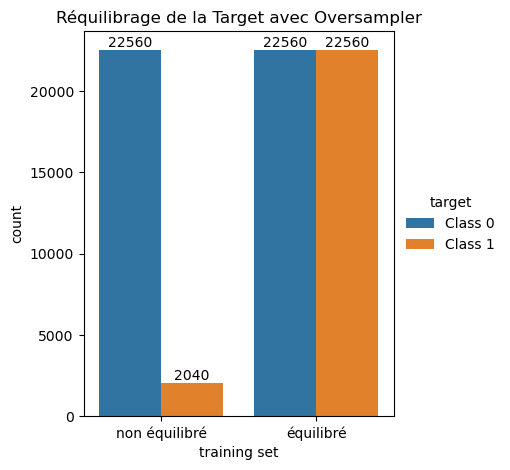

In [69]:
from collections import Counter

y_train_counter = Counter(y_train)
# Display barplot of distribution
class_distr_df = pd.DataFrame({'training set': ['non équilibré', 'non équilibré', 'équilibré', 'équilibré'],
                               'target': ['Class 0', 'Class 1', 'Class 0', 'Class 1'],
                               'count': [y_train_counter[0], y_train_counter[1], Counter(y_oversample)[0], Counter(y_oversample)[1]]})

# Display barplot
fig = plt.figure(figsize=(4,5))
ax = sns.barplot(class_distr_df, x='training set', y='count', hue='target')
plt.title("Réquilibrage de la Target avec Oversampler")
sns.move_legend(ax, bbox_to_anchor=(1, 0.5), loc='center left', frameon=False)
# Adding annotations
for container in ax.containers:
    ax.bar_label(container)
plt.show()

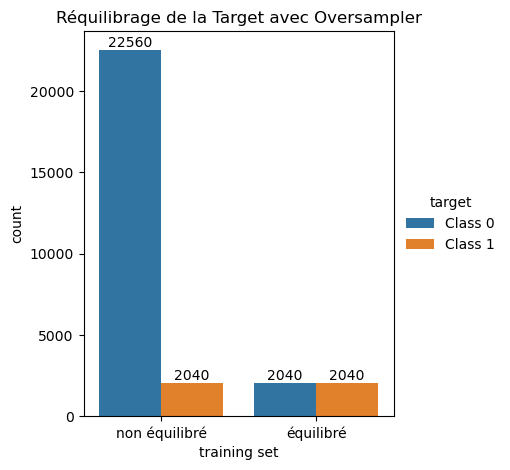

In [70]:
from collections import Counter

y_train_counter = Counter(y_train)
# Display barplot of distribution
class_distr_df = pd.DataFrame({'training set': ['non équilibré', 'non équilibré', 'équilibré', 'équilibré'],
                               'target': ['Class 0', 'Class 1', 'Class 0', 'Class 1'],
                               'count': [y_train_counter[0], y_train_counter[1], Counter(y_undersample)[0], Counter(y_undersample)[1]]})

# Display barplot
fig = plt.figure(figsize=(4,5))
ax = sns.barplot(class_distr_df, x='training set', y='count', hue='target')
plt.title("Réquilibrage de la Target avec Oversampler")
sns.move_legend(ax, bbox_to_anchor=(1, 0.5), loc='center left', frameon=False)
# Adding annotations
for container in ax.containers:
    ax.bar_label(container)
plt.show()

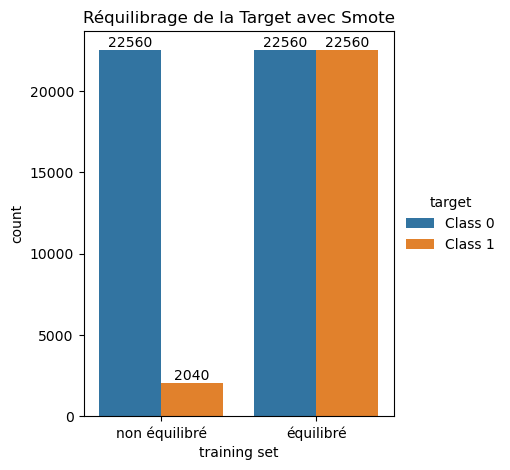

In [71]:
from collections import Counter

y_train_counter = Counter(y_train)
# Display barplot of distribution
class_distr_df = pd.DataFrame({'training set': ['non équilibré', 'non équilibré', 'équilibré', 'équilibré'],
                               'target': ['Class 0', 'Class 1', 'Class 0', 'Class 1'],
                               'count': [y_train_counter[0], y_train_counter[1], Counter(y_smote)[0], Counter(y_smote)[1]]})

# Display barplot
fig = plt.figure(figsize=(4,5))
ax = sns.barplot(class_distr_df, x='training set', y='count', hue='target')
plt.title("Réquilibrage de la Target avec Smote")
sns.move_legend(ax, bbox_to_anchor=(1, 0.5), loc='center left', frameon=False)
# Adding annotations
for container in ax.containers:
    ax.bar_label(container)
plt.show()

<b>Réquilibrage de la Target avec Class_weight</b> :

In [77]:
# Calcul des poids des classes avec class_weight
from sklearn.utils.class_weight import compute_class_weight
class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(y_train), y=y_train)
class_weight_dict = dict(zip(np.unique(y_train), class_weights))
print(class_weight_dict)

{0: 0.5452127659574468, 1: 6.029411764705882}


- Poids de la target 0 = (22560 + 2040) /(2 x 22560) = 24600 / 45120 = 0.5452127659574468
- Poids de la target 1 = (22560 + 2040) /(2 x 2040) = 24600 / 4080 = 6.029411764705882

In [80]:
#selection des variables numériques
NUMERIC_FEATURES = X.select_dtypes(exclude = "object").columns.values

- roc_auc_score() calcule l’AUC directement à partir des étiquettes vraies et des scores ou probabilités prédits.

- auc() calcule l’AUC à partir des taux de faux positifs (FPR) et des taux de vrais positifs (TPR) qui sont dérivés des scores prédits et des vraies étiquettes à l’aide de la fonction roc_curve().

In [83]:
#fonction d'evaluation du model
def model_eval2(model, label_model, typ_norm, Xtrain, ytrain, Xval, yval, perf_tableaux, f_equilibre=None):

    start_time = datetime.datetime.now()
    if (f_equilibre == 'class_weight'):
        class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(ytrain), y=ytrain)
        class_weight_dict = dict(zip(np.unique(ytrain), class_weights))
        sample_weights = np.array([class_weight_dict[i] for i in ytrain])
        model.fit(Xtrain, ytrain, sample_weight=sample_weights)
    else:
        model.fit(Xtrain, ytrain)
    end_time = datetime.datetime.now()
    time2train = end_time - start_time

    # Prédictions
    y_pred_proba = model.predict_proba(Xval)[:, 1]

    # Minimisation du score métier
    cout_fp = 1  # coût d'un faux positif
    cout_fn = 10  # coût d'un faux négatif

    thresholds = np.linspace(0.01, 0.99, 99)
    scores = [score_metier(yval, y_pred_proba, threshold, cout_fp, cout_fn) for threshold in thresholds]
    optimal_threshold = thresholds[np.argmax(scores)]
    optimal_score_metier = max(scores)

    # Affichage de la courbe du score métier
    plot_courbe_metier(thresholds, scores, optimal_threshold)
    print("Seuil de probalité optimal :", round(optimal_threshold,2))
    print("Score métier optimal :", round(optimal_score_metier,3))
    
    y_pred_defaut = (y_pred_proba >= 0.5).astype(int)
    y_pred_opti = (y_pred_proba >= optimal_threshold).astype(int)

    # Affichage de la matrice de confusion par defaut et avec seuil optimisé
    accuracy_score_opti, precision_score_opti, recall_score_opti = plot_matrice_confusion(y_pred_defaut, y_pred_opti, yval)

    # Affichage de la courbe ROC par defaut et avec seuil optimisé
    roc_auc_opti = plot_courbe_roc(y_pred_defaut, y_pred_opti, yval)

    row_index = perf_tableaux.shape[0]
    perf_tableaux.loc[row_index, 'Model'] = label_model
    perf_tableaux.loc[row_index, 'Normalisation'] = typ_norm
    perf_tableaux.loc[row_index, 'Target Balanced'] = f_equilibre
    perf_tableaux.loc[row_index, 'Recherche Hyperparametres'] = None
    perf_tableaux.loc[row_index, 'Best Hyperparametres'] = None
    perf_tableaux.loc[row_index, 'Best Seuil'] =  optimal_threshold
    perf_tableaux.loc[row_index, 'Score Metier'] = round(optimal_score_metier,3)
    perf_tableaux.loc[row_index, 'ROC_AUC'] = round(roc_auc_opti,3)
    perf_tableaux.loc[row_index, 'Accuracy'] = round(accuracy_score_opti,3)
    perf_tableaux.loc[row_index, 'Precision'] = round(precision_score_opti,3)
    perf_tableaux.loc[row_index, 'Recall'] = round(recall_score_opti,3)
    perf_tableaux.loc[row_index, 'Time Fit (hh:mm:ss)'] = time2train
    row_index+=1

# Définition du score métier
def score_metier(y_test, y_pred_proba, threshold, cout_fp, cout_fn):
    y_pred = (y_pred_proba >= threshold).astype(int)
    tn, fp, fn, tp = confusion_matrix(y_test, y_pred).ravel()

    #fonction cout à minimiser
    score = (cout_fp * fp) + (cout_fn * fn)

    # perte maximale = prets à tous les mauvais clients, refuser tous les bon clients
    max_loss = ((tp + fn) * cout_fn + (tn + fp) * cout_fp)
    
    #score normalisé entre 0 et 1 [0 = très mauvais score ; 1 = meilleur score)
    #plus la fonction cout est petit (= perte minimale) et plus mon score normalisé va tendre vers 1
    #a l'inverse, plus la fonction cout est grand (= perte maximal ) et plus mon score normalisé va tendre vers 0
    score_normalized = (max_loss - score) / max_loss
    
    return score_normalized

# Création d'un scorer pour le score métier
def custom_scorer(estimator, X, y):
    y_pred_proba = estimator.predict_proba(X)[:, 1]
    threshold = 0.5  # seuil de probabilité par défaut
    return score_metier(y, y_pred_proba, threshold, 1, 10)

    
def plot_courbe_metier(model, thresholds, scores, optimal_threshold):
    fig = plt.figure(figsize=(6, 4))
    plt.plot(thresholds, scores, color='darkorange', lw=2)
    plt.axvline(x=optimal_threshold, color='gray', linestyle='--')
    plt.xlabel('Seuil de probabilité')
    plt.ylabel('Score métier')
    plt.title('Courbe du score métier')
    name = "threshold_"+model+".png"
    fig.savefig(name)
    plt.show()

    return name

def plot_matrice_confusion(model, y_pred_defaut, y_pred_opti, yval):
    
    # matrice de confusion par defaut (seuil de proba = 0,5)
    fig, axes = plt.subplots(1, 2, sharex=True, figsize=(8,4))
    fig.suptitle('Matrice de confusion')
    cm = confusion_matrix(yval, y_pred_defaut)
    group_names = ['TN','FP','FN','TP']
    group_counts = ["{0:0.0f}".format(value) for value in
                    cm.flatten()]
    group_percentages = ["{0:.1%}".format(value) for value in
                         cm.flatten()/np.sum(cm)]
    labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
              zip(group_names,group_counts,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)
    sns.heatmap(cm, annot=labels, fmt='', cmap='Blues', ax=axes[0])
    axes[0].set_title('Avec seuil par defaut', fontsize=9)
    axes[0].set_xlabel('Prédictions', fontsize=7)
    axes[0].set_ylabel('Vraies valeurs', fontsize=7)
    
    # matrice de confusion avec le seuil optimisé pour le score métier
    cm = confusion_matrix(yval, y_pred_opti)
    group_names = ['TN','FP','FN','TP']
    group_counts = ["{0:0.0f}".format(value) for value in
                    cm.flatten()]
    group_percentages = ["{0:.1%}".format(value) for value in
                         cm.flatten()/np.sum(cm)]
    labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
              zip(group_names,group_counts,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)
    cfm_plot = sns.heatmap(cm, annot=labels, fmt='', cmap='Blues', ax=axes[1])
    axes[1].set_title('Avec seuil optimisé', fontsize=9)
    axes[1].set_xlabel('Prédictions', fontsize=7)
    axes[1].set_ylabel('Vraies valeurs', fontsize=7)
    plt.tight_layout()
    name_png = "confusion_"+model+".png"
    cfm_plot.figure.savefig(name_png)
    plt.show()

    accuracy_score_opti  = accuracy_score(yval, y_pred_opti)
    precision_score_opti = precision_score(yval, y_pred_opti)
    recall_score_opti    = recall_score(yval, y_pred_opti)

    return accuracy_score_opti, precision_score_opti, recall_score_opti, name_png

def plot_courbe_roc(model, y_pred_defaut, y_pred_opti, yval):
    
    # courbe roc par defaut (seuil de proba = 0,5)
    fig, axs = plt.subplots(1, 2, figsize=(8, 4))
    fig.suptitle('Courbe ROC')
    fpr, tpr, thresholds = roc_curve(yval, y_pred_defaut)
    roc_auc = auc(fpr, tpr)
    axs[0].plot(fpr, tpr, color='darkorange', lw=2, label='Courbe ROC (AUC = %0.3f)' % roc_auc)
    axs[0].plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    axs[0].set_xlim([0.0, 1.0])
    axs[0].set_ylim([0.0, 1.05])
    axs[0].set_xlabel('Taux de faux positifs', fontsize=7)
    axs[0].set_ylabel('Taux de vrais positifs', fontsize=7)
    axs[0].set_title('Avec seuil par defaut', fontsize=9)
    axs[0].legend(loc="lower right", fontsize=9)
    
    # courbe roc avec seuil optimisé
    fpr_opti, tpr_opti, thresholds_opti = roc_curve(yval, y_pred_opti)
    roc_auc_opti = auc(fpr_opti, tpr_opti)
    axs[1].plot(fpr_opti, tpr_opti, color='darkorange', lw=2, label='Courbe ROC (AUC = %0.3f)' % roc_auc_opti)
    axs[1].plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    axs[1].set_xlim([0.0, 1.0])
    axs[1].set_ylim([0.0, 1.05])
    axs[1].set_xlabel('Taux de faux positifs', fontsize=7)
    axs[1].set_ylabel('Taux de vrais positifs', fontsize=7)
    axs[1].set_title('Avec seuil optimisé', fontsize=9)
    axs[1].legend(loc="lower right", fontsize=9)
    plt.tight_layout()
    name_png = "roc_auc_"+model+".png"
    fig.savefig(name_png)
    plt.show()

    return roc_auc_opti, name_png


In [92]:
perf_tableaux = pd.DataFrame()

In [94]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

<u>1ère simulation avec les paramétres ci-dessous = notre baseline</u> :

- modèle dummy classifier
- normalisation StandardScaler
- hyperparamétres par défaut
- sans equilibrage / oversampler / undersampler / smote 

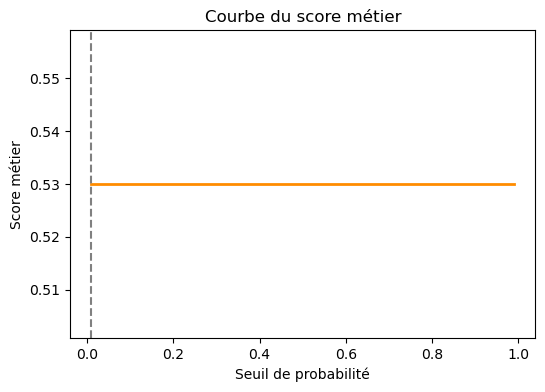

Seuil de probalité optimal : 0.01
Score métier optimal : 0.53


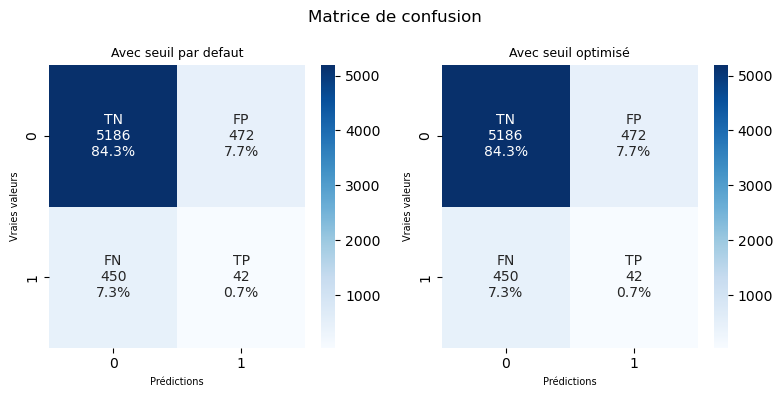

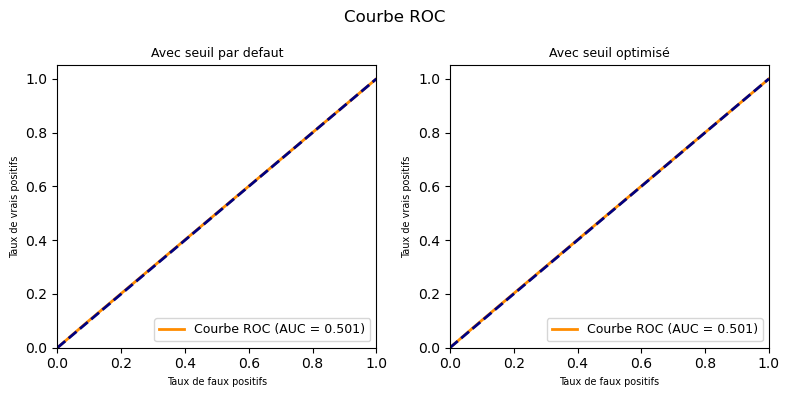

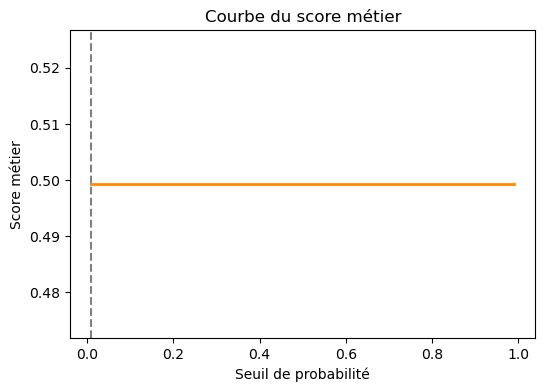

Seuil de probalité optimal : 0.01
Score métier optimal : 0.499


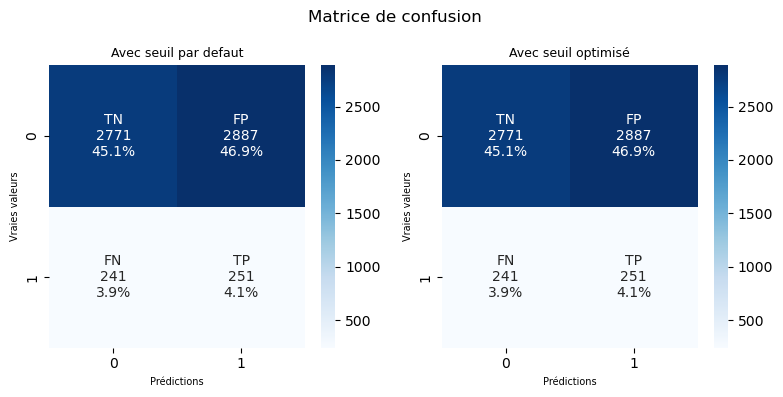

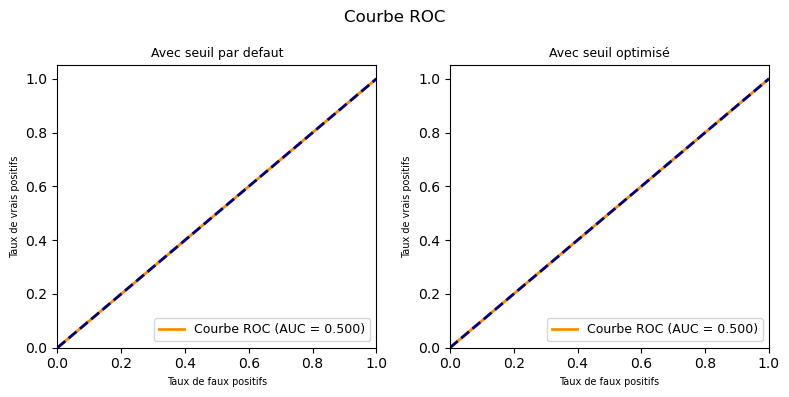

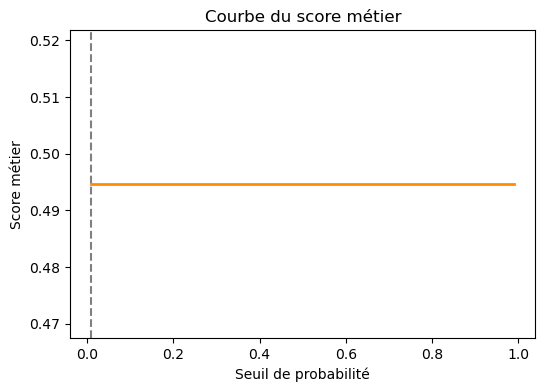

Seuil de probalité optimal : 0.01
Score métier optimal : 0.495


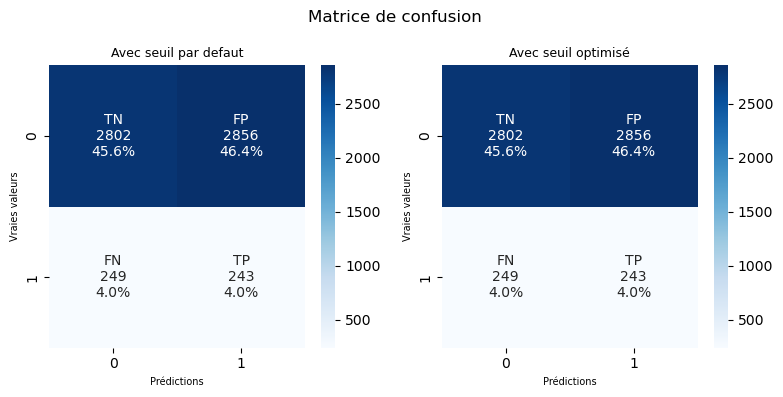

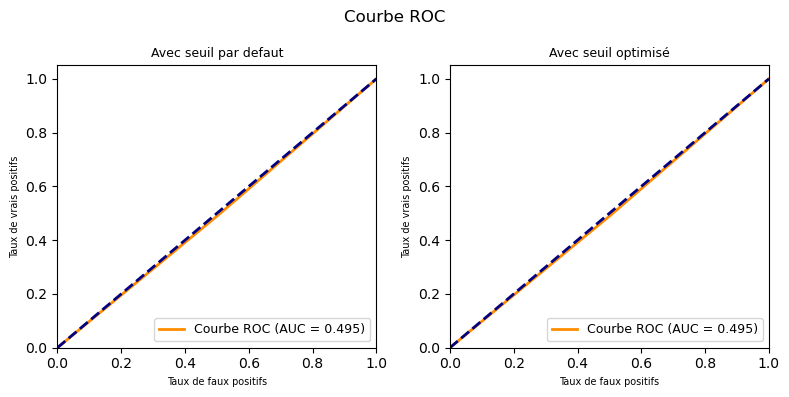

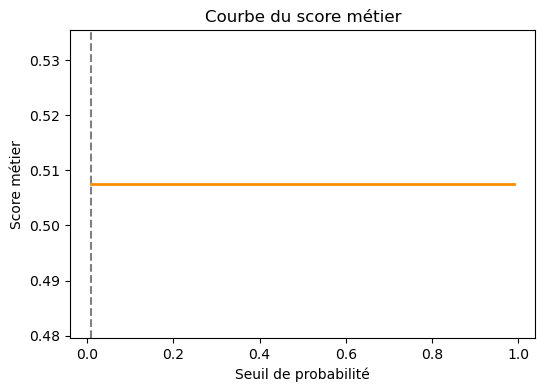

Seuil de probalité optimal : 0.01
Score métier optimal : 0.507


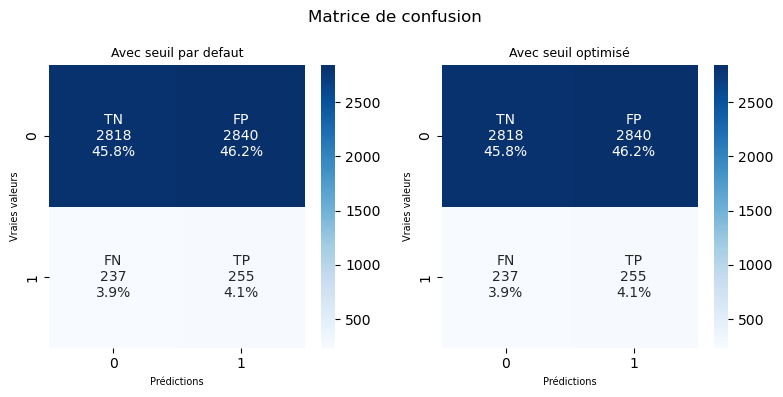

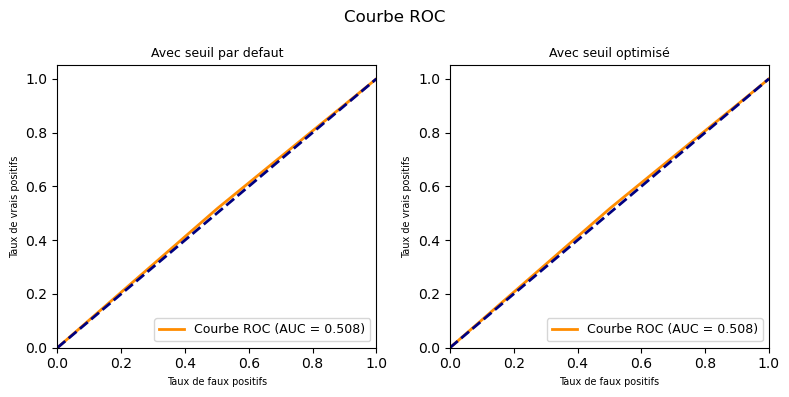

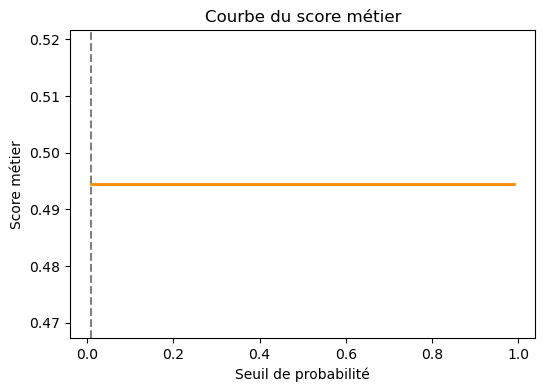

Seuil de probalité optimal : 0.01
Score métier optimal : 0.494


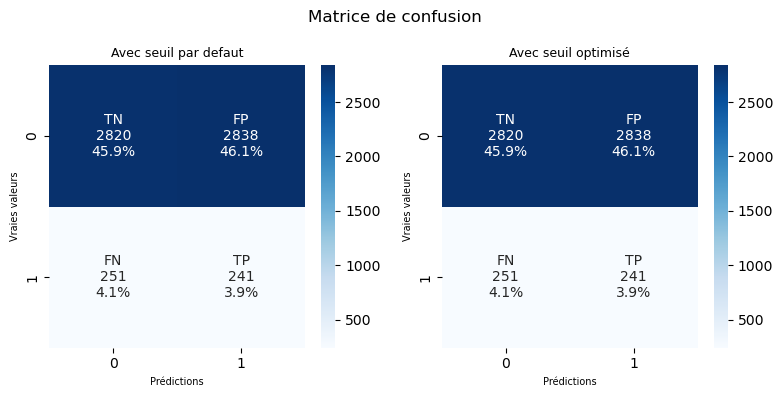

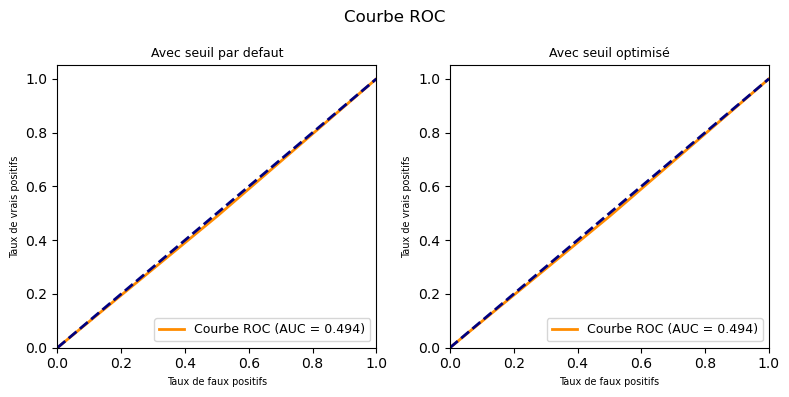

In [87]:
# Définition du pipeline pour enchainer les étapes de prétraiement et de classification
dummyCls = Pipeline([
    ('scale', StandardScaler()),
    ('model', DummyClassifier(strategy='stratified')) #generates predictions by respecting the training set’s class distribution.
])

# Définition du pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes
dummyCls_oversampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', DummyClassifier(strategy='stratified'))
])

dummyCls_undersampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', DummyClassifier(strategy='stratified'))
])

dummyCls_smote = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', SMOTE(random_state=42)),
    ('model', DummyClassifier(strategy='stratified'))
])


#sans réquilibrage
model_eval2(dummyCls, 'DummyClassifier', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux)
#avec réquilibrage oversampler
model_eval2(dummyCls_oversampler, 'DummyClassifier', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'oversampler')
#avec réquilibrage undersampler
model_eval2(dummyCls_undersampler, 'DummyClassifier', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'undersampler')
#avec réquilibrage smote
model_eval2(dummyCls_smote, 'DummyClassifier', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'smote')
#avec réquilibrage class_weight
dummyCls_classweight = DummyClassifier(strategy='stratified')
model_eval2(dummyCls_classweight, 'DummyClassifier', 'StandardScaler', X_train_scaled, y_train, X_test_scaled, y_test,  perf_tableaux,'class_weight')


In [205]:
perf_tableaux

,Model,Normalisation,Target Balanced,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
0,DummyClassifier,StandardScaler,None,None,None,0.01,0.539,0.511,0.850,0.099,0.108,0 days 00:00:00.331145
1,DummyClassifier,StandardScaler,oversampler,None,None,0.01,0.487,0.487,0.482,0.076,0.494,0 days 00:00:00.683871
2,DummyClassifier,StandardScaler,undersampler,None,None,0.01,0.490,0.488,0.507,0.076,0.465,0 days 00:00:00.381938
3,DummyClassifier,StandardScaler,smote,None,None,0.01,0.489,0.488,0.503,0.076,0.470,0 days 00:00:00.801290
4,DummyClassifier,StandardScaler,class_weight,None,None,0.01,0.498,0.497,0.505,0.079,0.488,0 days 00:00:00.012053


<u>2ème simulation </u> :
- modèle type regression linéaire
- normalisation StandardScaler
- hyperparamétres par défaut
- sans equilibrage / oversampler / undersampler / smote / class_weight

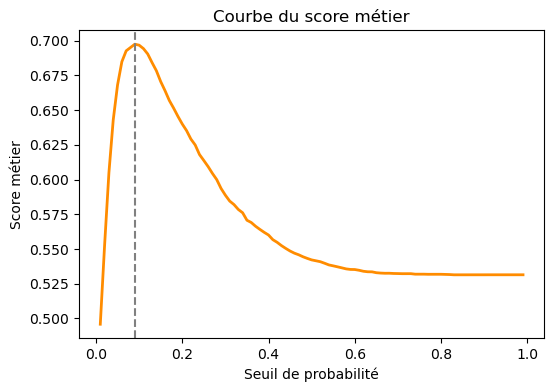

Seuil de probalité optimal : 0.09
Score métier optimal : 0.697


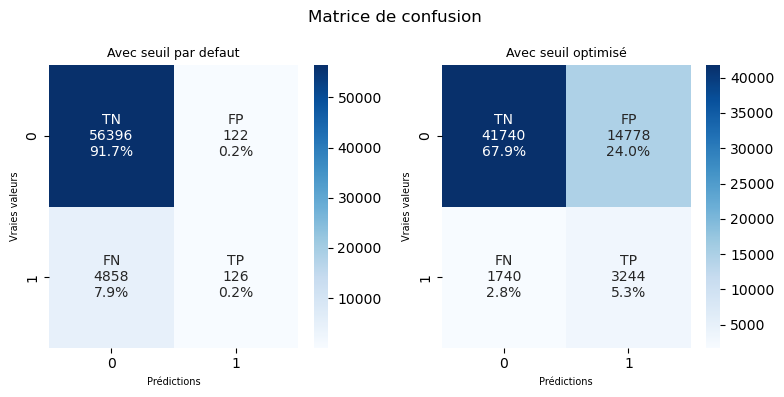

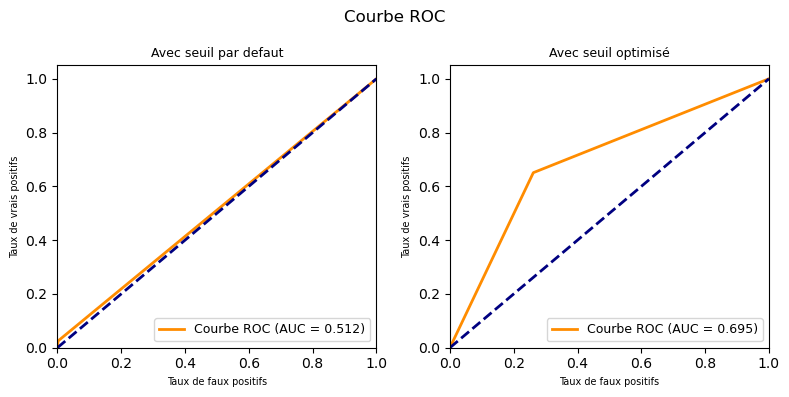

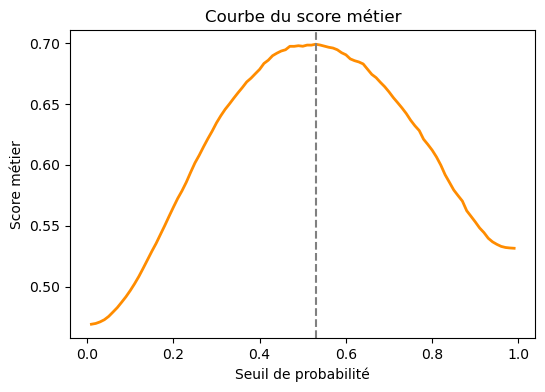

Seuil de probalité optimal : 0.53
Score métier optimal : 0.699


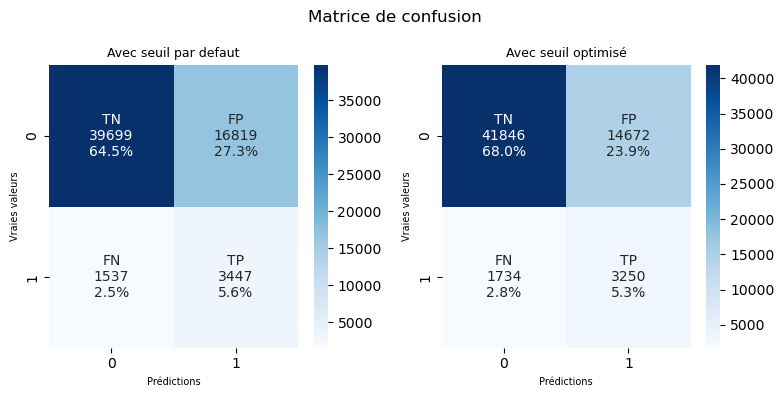

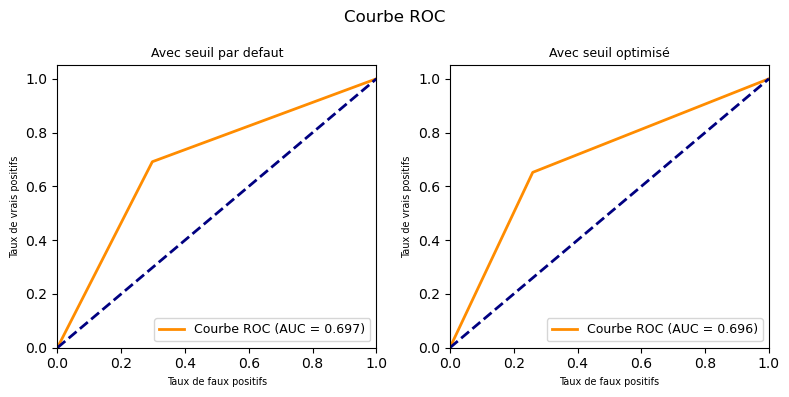

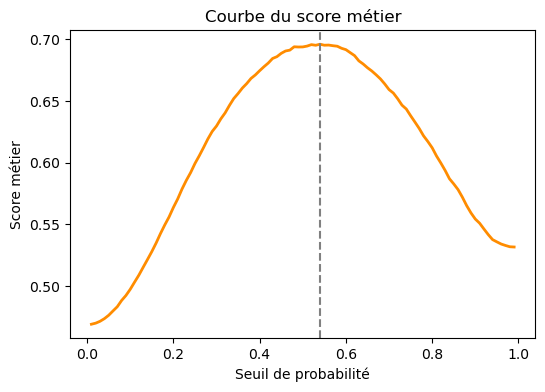

Seuil de probalité optimal : 0.54
Score métier optimal : 0.696


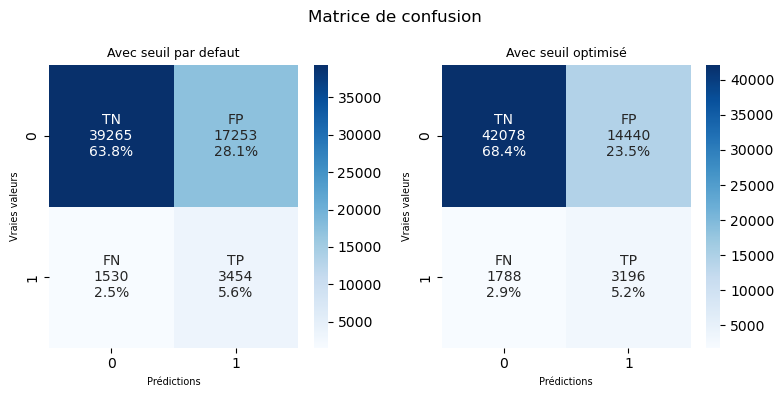

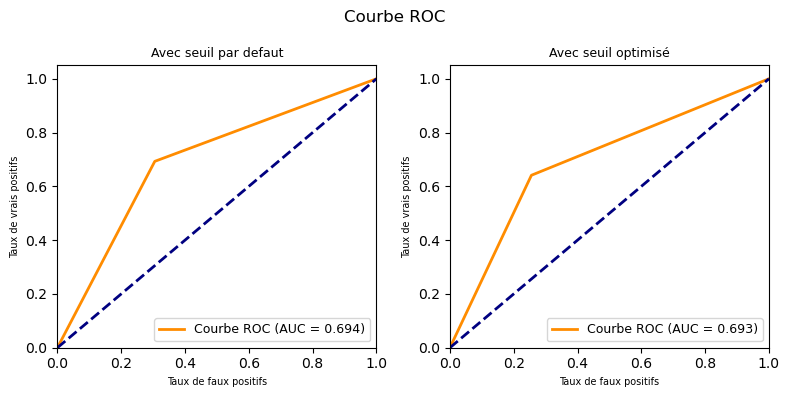

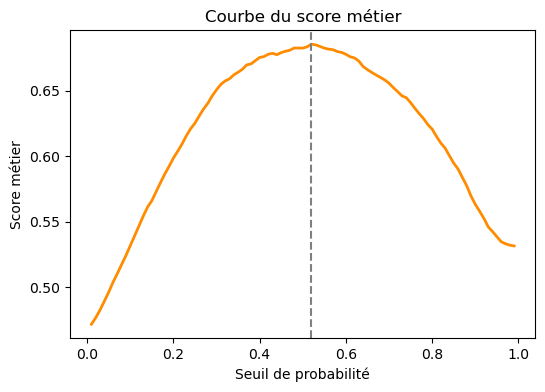

Seuil de probalité optimal : 0.52
Score métier optimal : 0.685


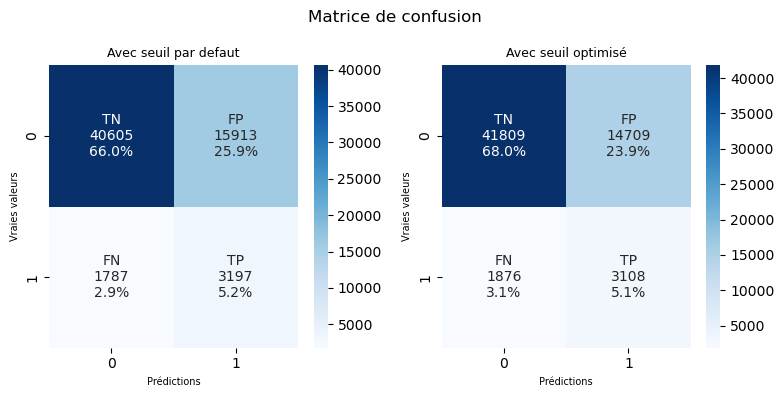

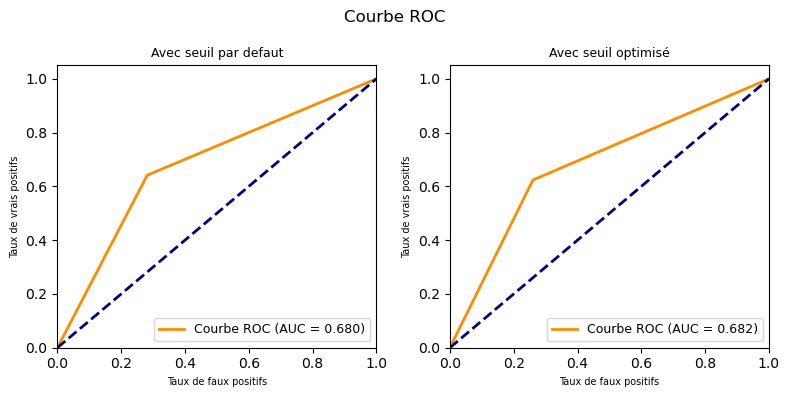

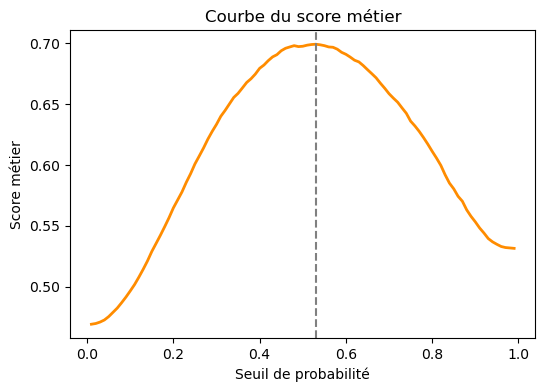

Seuil de probalité optimal : 0.53
Score métier optimal : 0.699


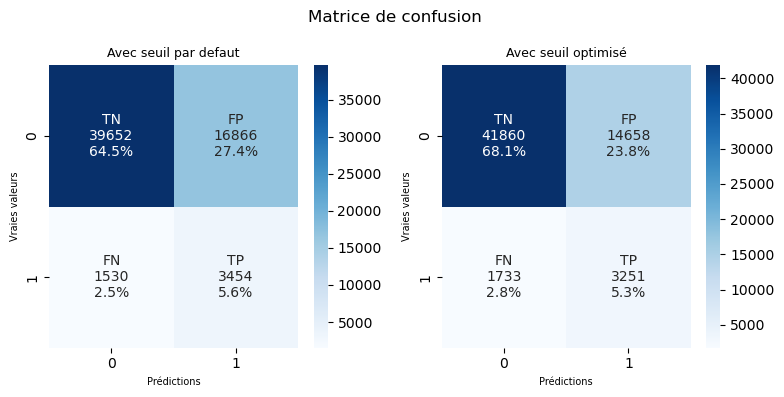

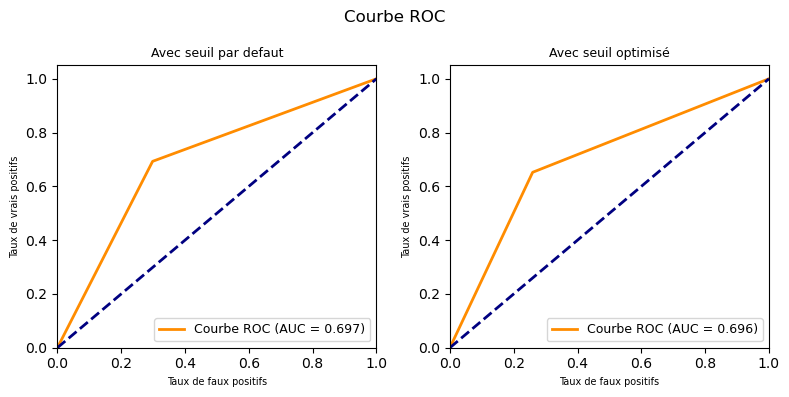

In [436]:
LRCls = Pipeline([
    ('scale', StandardScaler()),
     ('model', LogisticRegression())
])

# Définition du pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes
LRCls_oversampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', LogisticRegression())
])

LRCls_undersampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', LogisticRegression())
])

LRCls_smote = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', SMOTE(random_state=42)),
    ('model', LogisticRegression())
])

model_eval2(LRCls, 'LogisticRegression', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux)
model_eval2(LRCls_oversampler, 'LogisticRegression', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'oversampler')
model_eval2(LRCls_undersampler, 'LogisticRegression', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'undersampler')
model_eval2(LRCls_smote, 'LogisticRegression', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'smote')
#avec réquilibrage class_weight
LRCls_classweight = LogisticRegression()
model_eval2(LRCls_classweight, 'LogisticRegression', 'StandardScaler', X_train_scaled, y_train, X_test_scaled, y_test,  perf_tableaux,'class_weight')


In [89]:
perf_tableaux

,Model,Normalisation,Target Balanced,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
0,DummyClassifier,StandardScaler,None,None,None,0.01,0.530,0.501,0.850,0.082,0.085,0 days 00:00:00.352013
1,DummyClassifier,StandardScaler,oversampler,None,None,0.01,0.499,0.500,0.491,0.080,0.510,0 days 00:00:00.714163
2,DummyClassifier,StandardScaler,undersampler,None,None,0.01,0.495,0.495,0.495,0.078,0.494,0 days 00:00:00.484992
3,DummyClassifier,StandardScaler,smote,None,None,0.01,0.507,0.508,0.500,0.082,0.518,0 days 00:00:01.080622
4,DummyClassifier,StandardScaler,class_weight,None,None,0.01,0.494,0.494,0.498,0.078,0.490,0 days 00:00:00.017843


<u>3ème simulation </u> :
- modèle type DecisionTreeClassifier
- normalisation StandardScaler
- hyperparamétres par défaut
- sans equilibrage / oversampler / undersampler / smote / class_weight

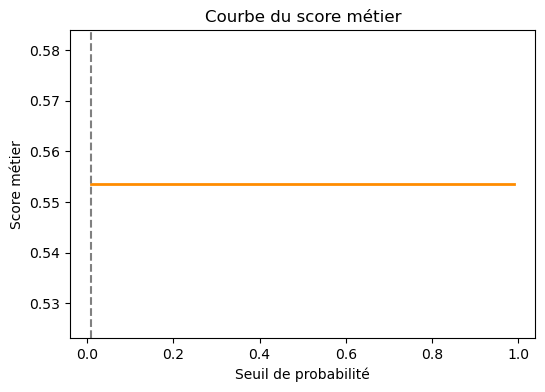

Seuil de probalité optimal : 0.01
Score métier optimal : 0.554


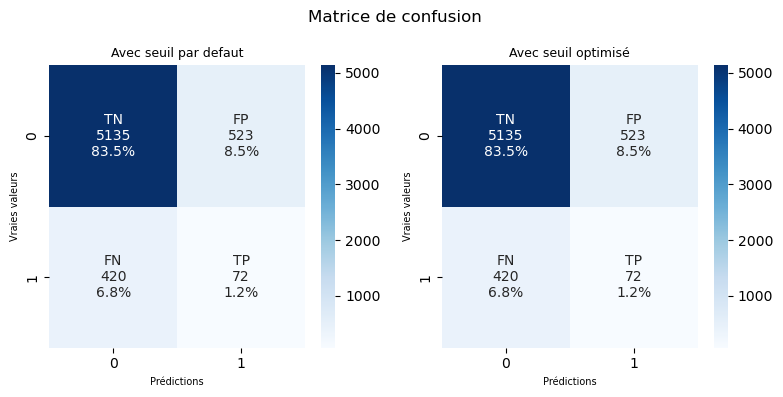

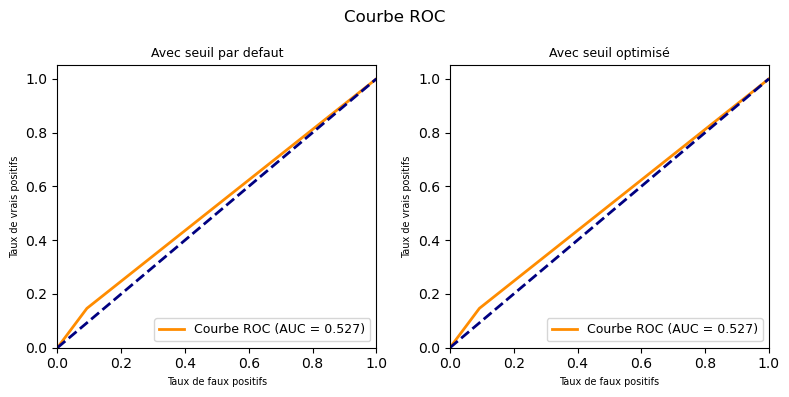

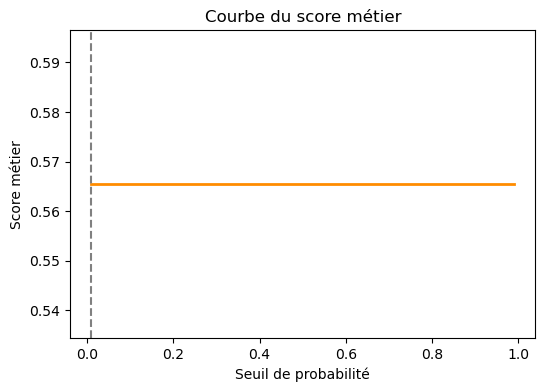

Seuil de probalité optimal : 0.01
Score métier optimal : 0.565


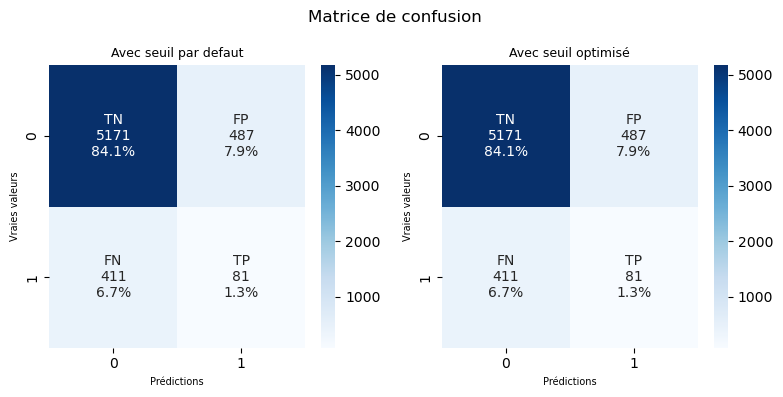

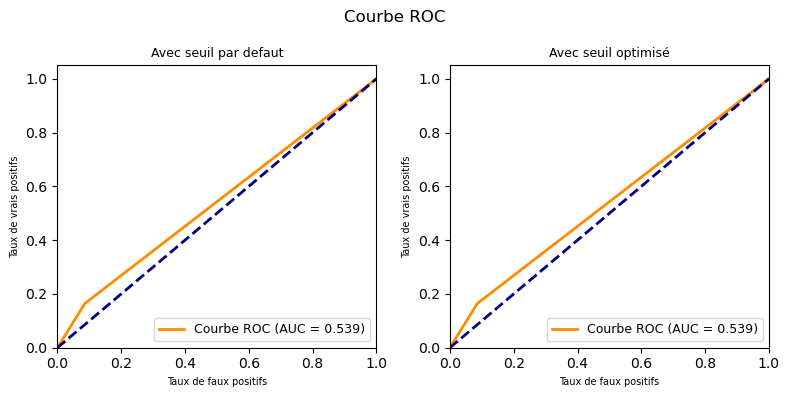

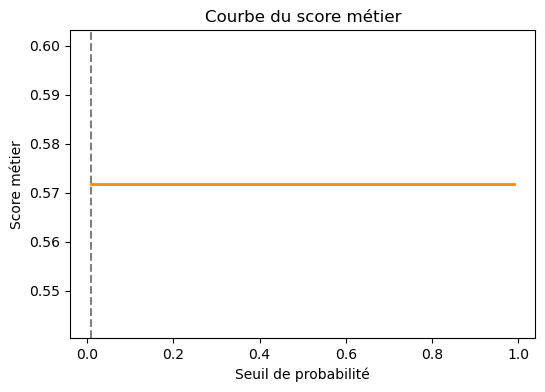

Seuil de probalité optimal : 0.01
Score métier optimal : 0.572


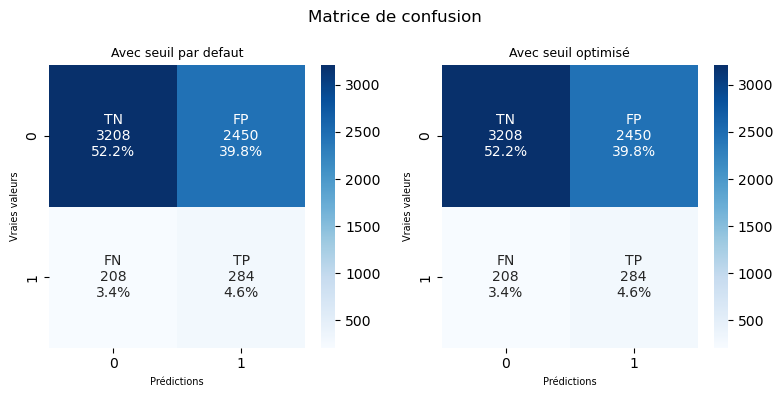

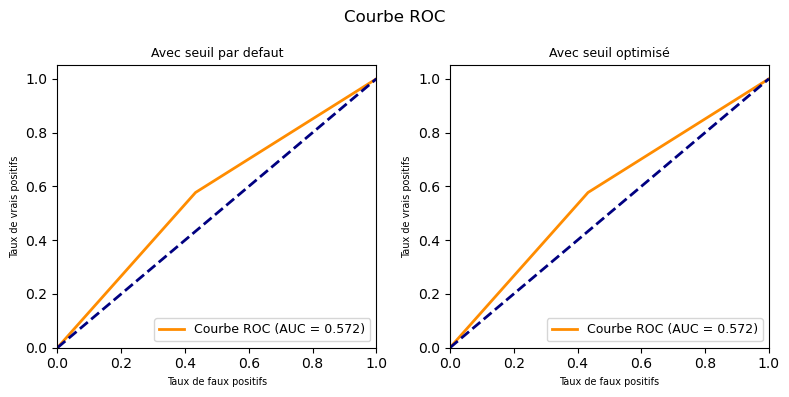

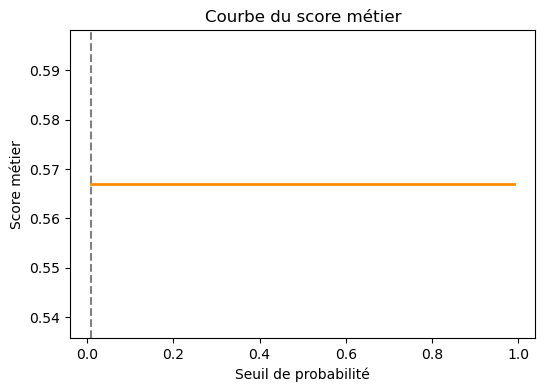

Seuil de probalité optimal : 0.01
Score métier optimal : 0.567


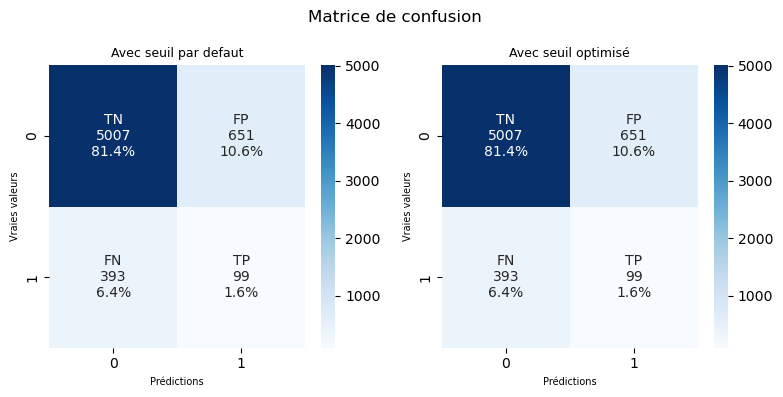

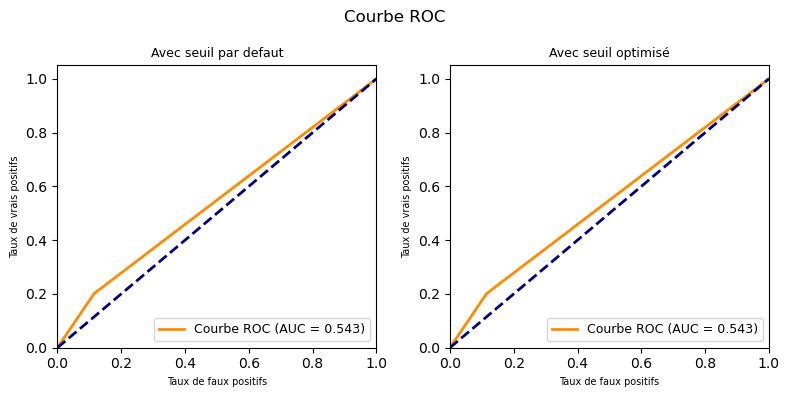

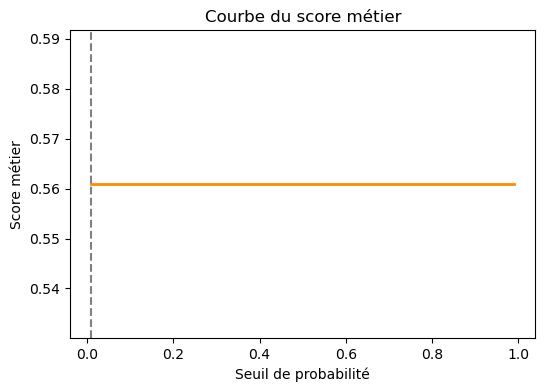

Seuil de probalité optimal : 0.01
Score métier optimal : 0.561


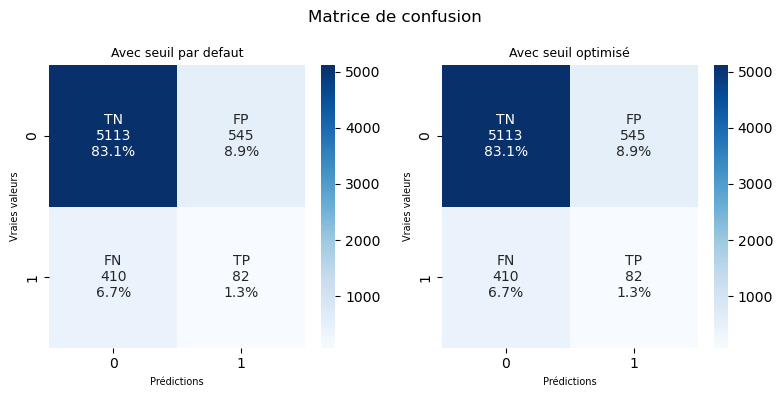

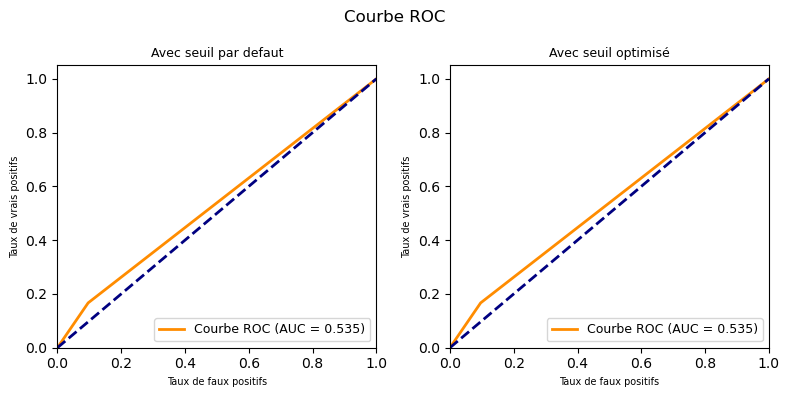

In [92]:
# Définition du pipeline pour enchainer les étapes de prétraiement et de classification
DTreeCls = Pipeline([
    ('scale', StandardScaler()),
    ('model', DecisionTreeClassifier())
])

# Définition du pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes
DTreeCls_oversampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', DecisionTreeClassifier())
])

DTreeCls_undersampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', DecisionTreeClassifier())
])

DTreeCls_smote = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', SMOTE(random_state=42)),
    ('model', DecisionTreeClassifier())
])

model_eval2(DTreeCls, 'DecisionTreeClassifier', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux)
model_eval2(DTreeCls_oversampler, 'DecisionTreeClassifier', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'oversampler')
model_eval2(DTreeCls_undersampler, 'DecisionTreeClassifier', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'undersampler')
model_eval2(DTreeCls_smote, 'DecisionTreeClassifier', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'smote')
#avec réquilibrage class_weight
DTreeCls_classweight = DecisionTreeClassifier()
model_eval2(DTreeCls_classweight, 'DecisionTreeClassifier', 'StandardScaler', X_train_scaled, y_train, X_test_scaled, y_test,  perf_tableaux,'class_weight')


In [93]:
perf_tableaux

,Model,Normalisation,Target Balanced,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
0,DummyClassifier,StandardScaler,None,None,None,0.01,0.530,0.501,0.850,0.082,0.085,0 days 00:00:00.352013
1,DummyClassifier,StandardScaler,oversampler,None,None,0.01,0.499,0.500,0.491,0.080,0.510,0 days 00:00:00.714163
2,DummyClassifier,StandardScaler,undersampler,None,None,0.01,0.495,0.495,0.495,0.078,0.494,0 days 00:00:00.484992
3,DummyClassifier,StandardScaler,smote,None,None,0.01,0.507,0.508,0.500,0.082,0.518,0 days 00:00:01.080622
4,DummyClassifier,StandardScaler,class_weight,None,None,0.01,0.494,0.494,0.498,0.078,0.490,0 days 00:00:00.017843
5,DecisionTreeClassifier,StandardScaler,None,None,None,0.01,0.554,0.527,0.847,0.121,0.146,0 days 00:00:12.274206
6,DecisionTreeClassifier,StandardScaler,oversampler,None,None,0.01,0.565,0.539,0.854,0.143,0.165,0 days 00:00:12.353797
7,DecisionTreeClassifier,StandardScaler,undersampler,None,None,0.01,0.572,0.572,0.568,0.104,0.577,0 days 00:00:01.165836
8,DecisionTreeClassifier,StandardScaler,smote,None,None,0.01,0.567,0.543,0.830,0.132,0.201,0 days 00:00:15.461661
9,DecisionTreeClassifier,StandardScaler,class_weight,None,None,0.01,0.561,0.535,0.845,0.131,0.167,0 days 00:00:06.321064


<u>4ème simulation </u> :
- modèle type RandomForest
- normalisation StandardScaler
- hyperparamétres par défaut
- sans equilibrage / oversampler / undersampler / smote / class_weight

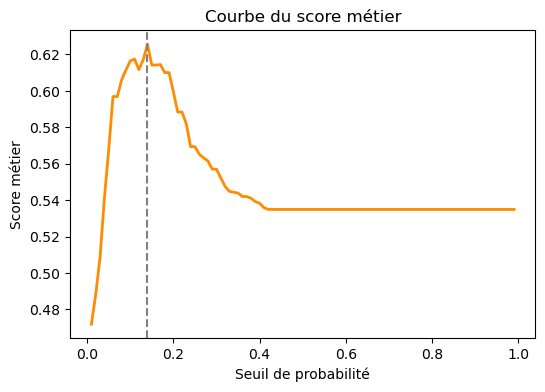

Seuil de probalité optimal : 0.14
Score métier optimal : 0.626


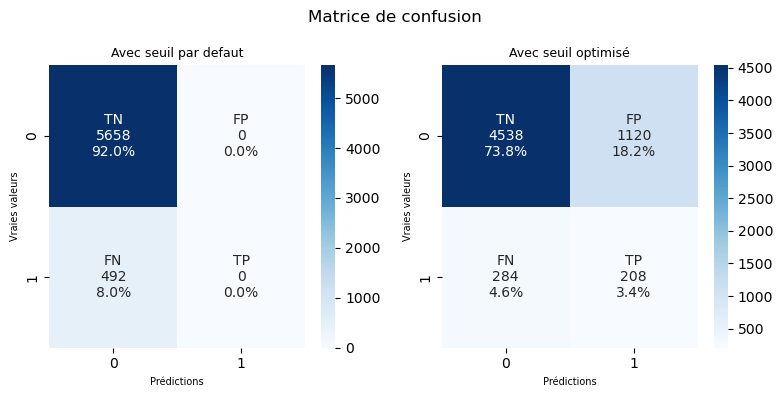

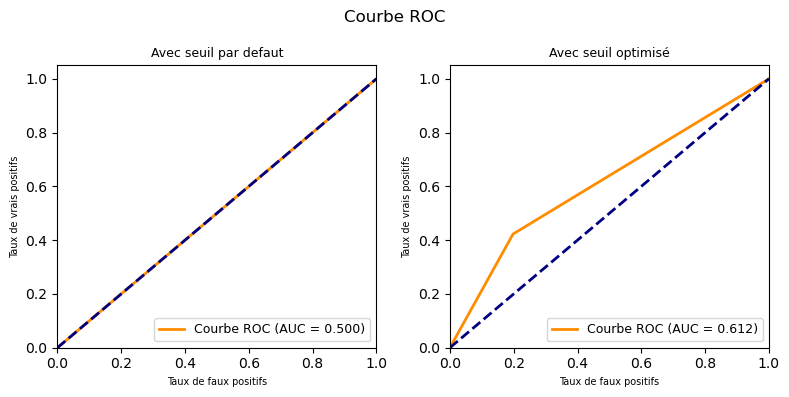

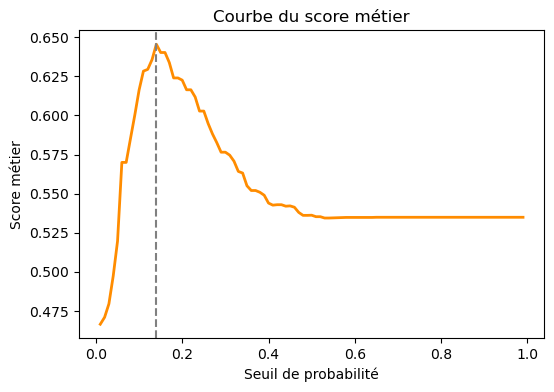

Seuil de probalité optimal : 0.14
Score métier optimal : 0.645


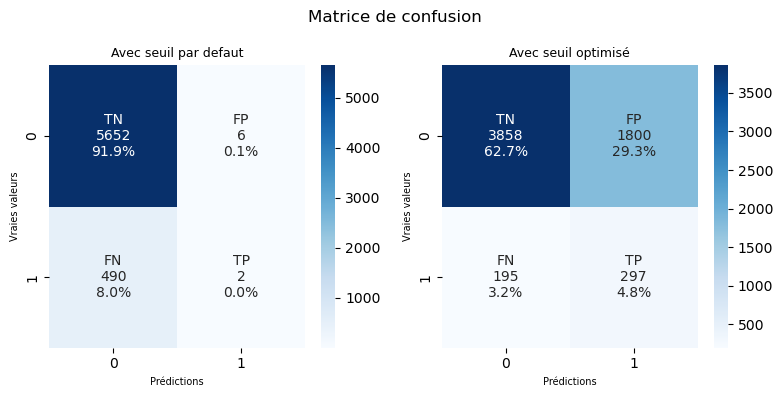

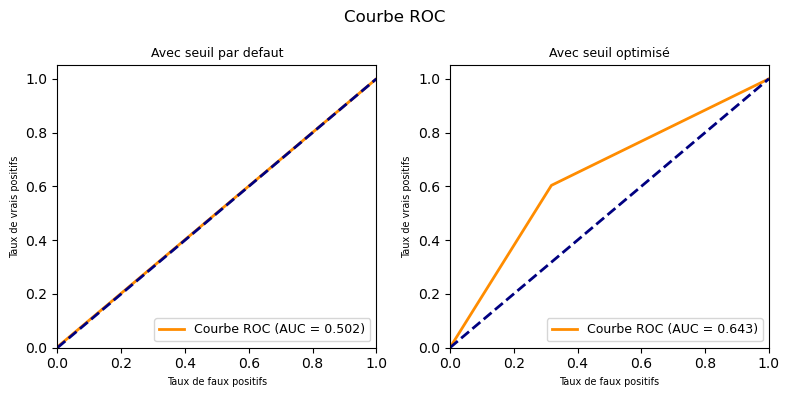

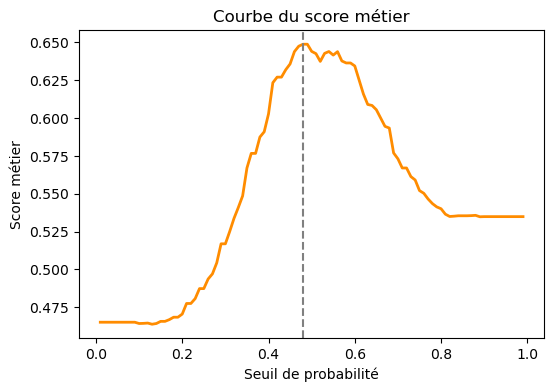

Seuil de probalité optimal : 0.48
Score métier optimal : 0.649


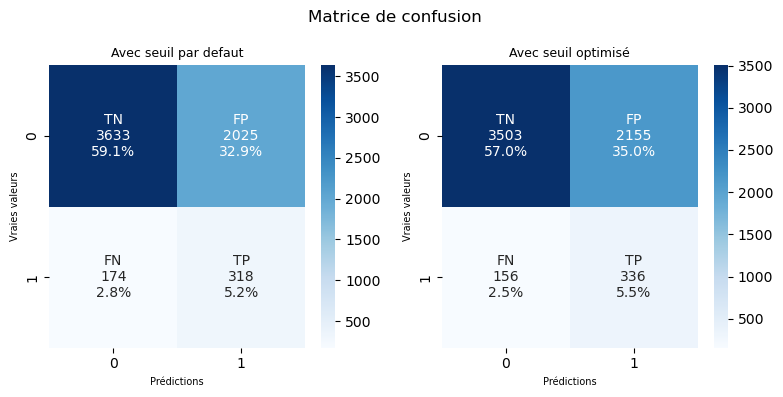

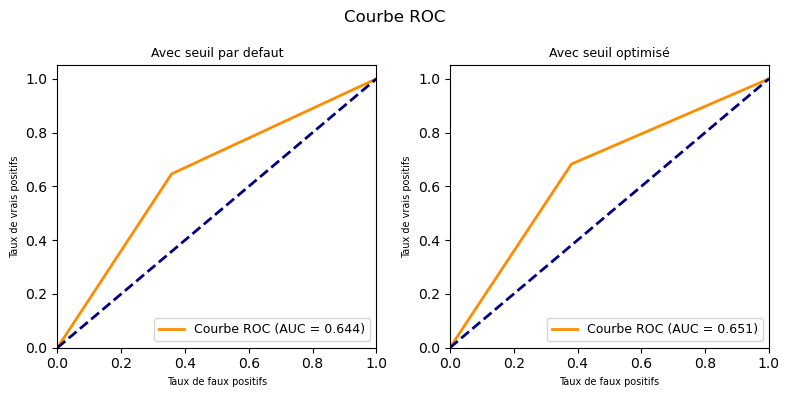

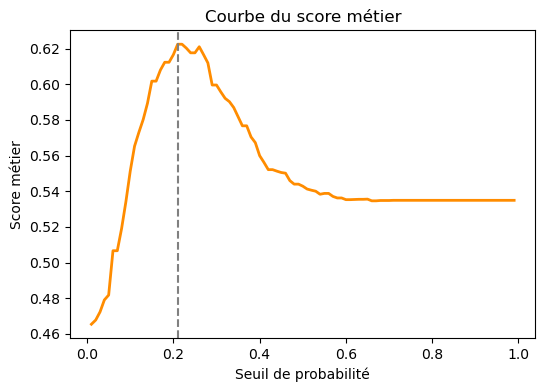

Seuil de probalité optimal : 0.21
Score métier optimal : 0.622


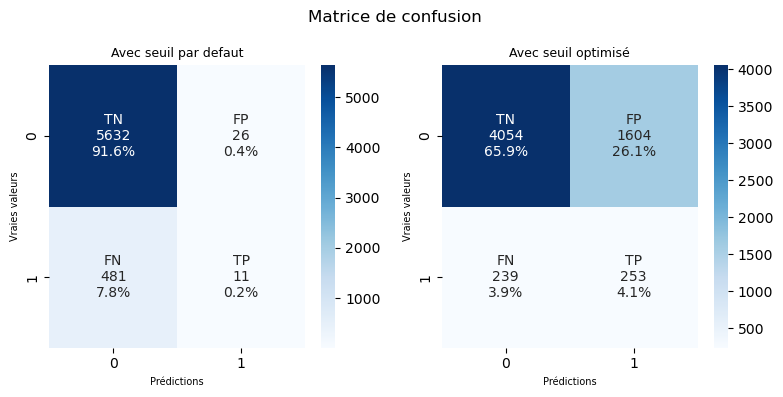

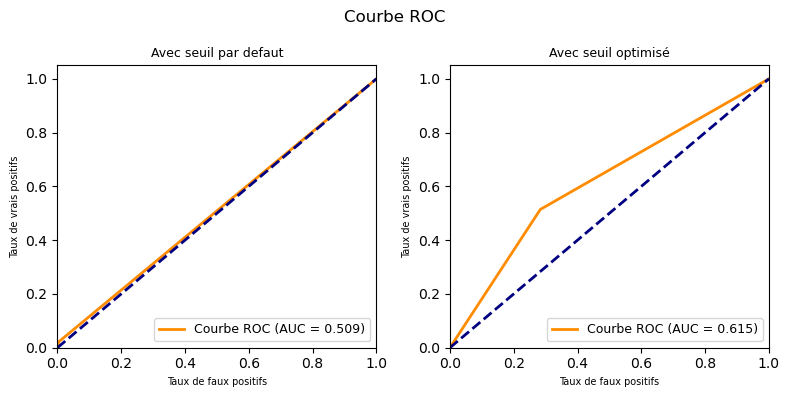

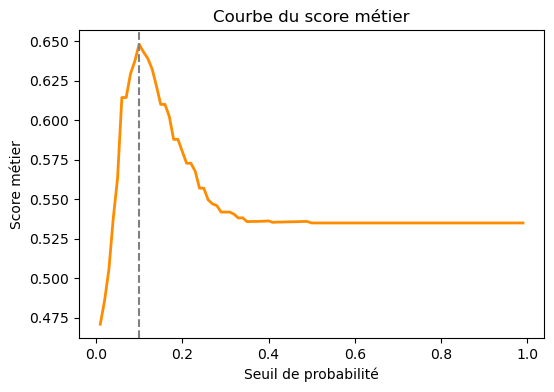

Seuil de probalité optimal : 0.1
Score métier optimal : 0.648


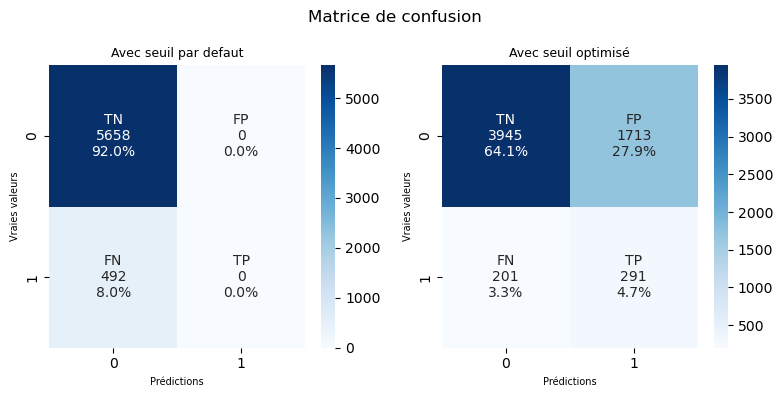

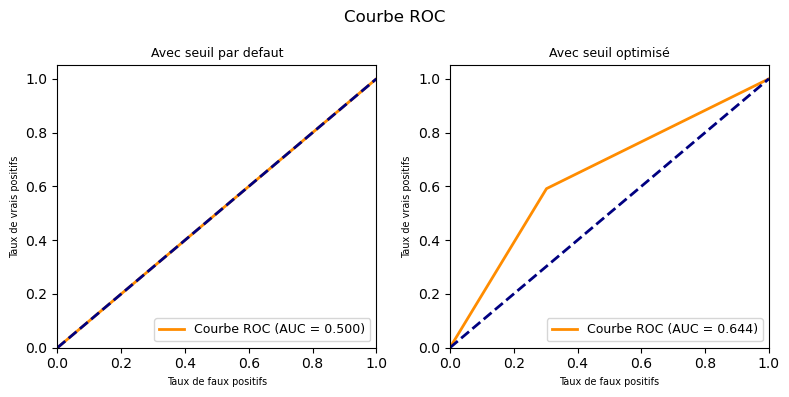

In [95]:
# Définition du pipeline pour enchainer les étapes de prétraiement et de classification
RFCls = Pipeline([
    ('scale', StandardScaler()),
    ('model', RandomForestClassifier())
])

# Définition du pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes
RFCls_oversampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', RandomForestClassifier())
])

RFCls_undersampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', RandomForestClassifier())
])

RFCls_smote = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', SMOTE(random_state=42)),
    ('model', RandomForestClassifier())
])

model_eval2(RFCls, 'RandomForestClassifier', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux)
model_eval2(RFCls_oversampler, 'RandomForestClassifier', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'oversampler')
model_eval2(RFCls_undersampler, 'RandomForestClassifier', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'undersampler')
model_eval2(RFCls_smote, 'RandomForestClassifier', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'smote')
#avec class_weight
RFCls_classweight = RandomForestClassifier()
model_eval2(RFCls_classweight, 'RandomForestClassifier', 'StandardScaler', X_train_scaled, y_train, X_test_scaled, y_test,  perf_tableaux,'class_weight')


In [96]:
perf_tableaux

,Model,Normalisation,Target Balanced,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
0,DummyClassifier,StandardScaler,None,None,None,0.01,0.530,0.501,0.850,0.082,0.085,0 days 00:00:00.352013
1,DummyClassifier,StandardScaler,oversampler,None,None,0.01,0.499,0.500,0.491,0.080,0.510,0 days 00:00:00.714163
2,DummyClassifier,StandardScaler,undersampler,None,None,0.01,0.495,0.495,0.495,0.078,0.494,0 days 00:00:00.484992
3,DummyClassifier,StandardScaler,smote,None,None,0.01,0.507,0.508,0.500,0.082,0.518,0 days 00:00:01.080622
4,DummyClassifier,StandardScaler,class_weight,None,None,0.01,0.494,0.494,0.498,0.078,0.490,0 days 00:00:00.017843
5,DecisionTreeClassifier,StandardScaler,None,None,None,0.01,0.554,0.527,0.847,0.121,0.146,0 days 00:00:12.274206
6,DecisionTreeClassifier,StandardScaler,oversampler,None,None,0.01,0.565,0.539,0.854,0.143,0.165,0 days 00:00:12.353797
7,DecisionTreeClassifier,StandardScaler,undersampler,None,None,0.01,0.572,0.572,0.568,0.104,0.577,0 days 00:00:01.165836
8,DecisionTreeClassifier,StandardScaler,smote,None,None,0.01,0.567,0.543,0.830,0.132,0.201,0 days 00:00:15.461661
9,DecisionTreeClassifier,StandardScaler,class_weight,None,None,0.01,0.561,0.535,0.845,0.131,0.167,0 days 00:00:06.321064


<u>5ème simulation </u> :
- modèle type GradientBoosting
- normalisation StandardScaler
- hyperparamétres par défaut
- sans equilibrage / oversampler / undersampler / smote / class_weight

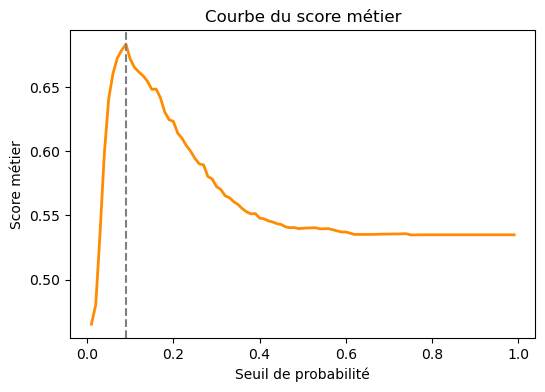

Seuil de probalité optimal : 0.09
Score métier optimal : 0.684


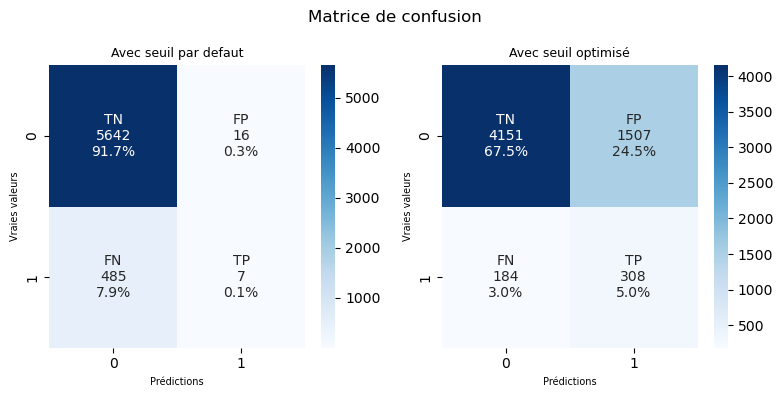

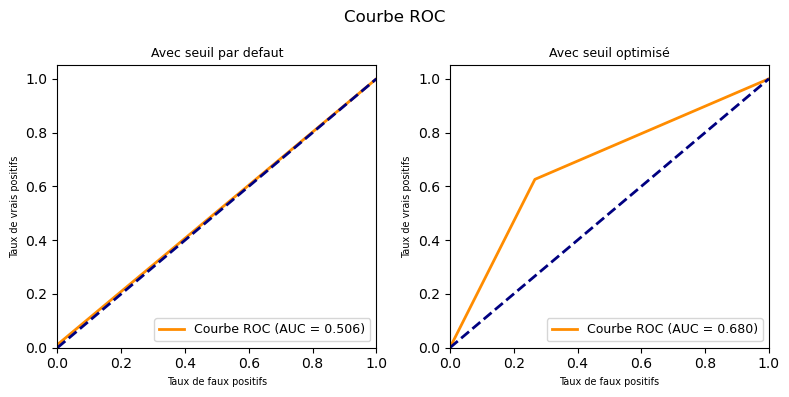

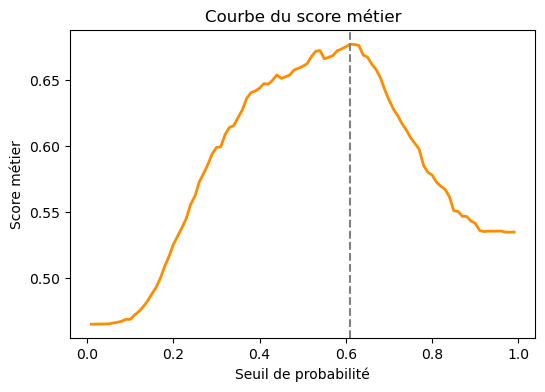

Seuil de probalité optimal : 0.61
Score métier optimal : 0.677


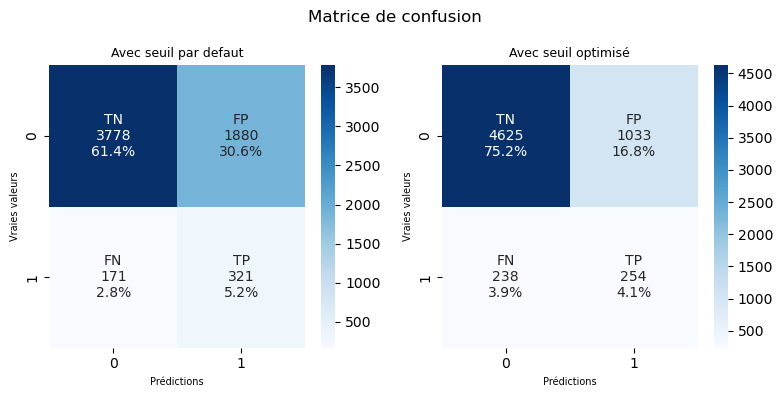

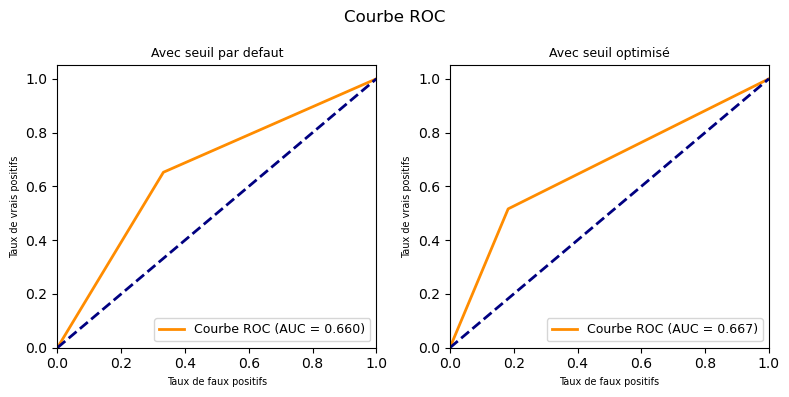

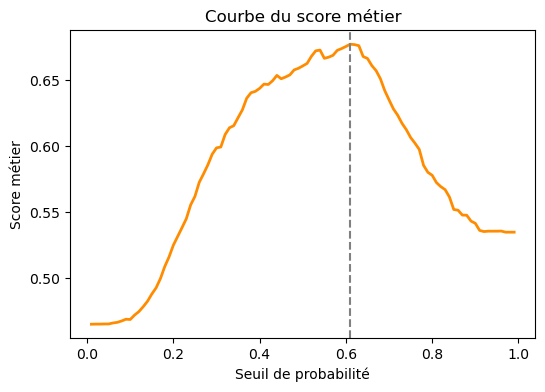

Seuil de probalité optimal : 0.61
Score métier optimal : 0.677


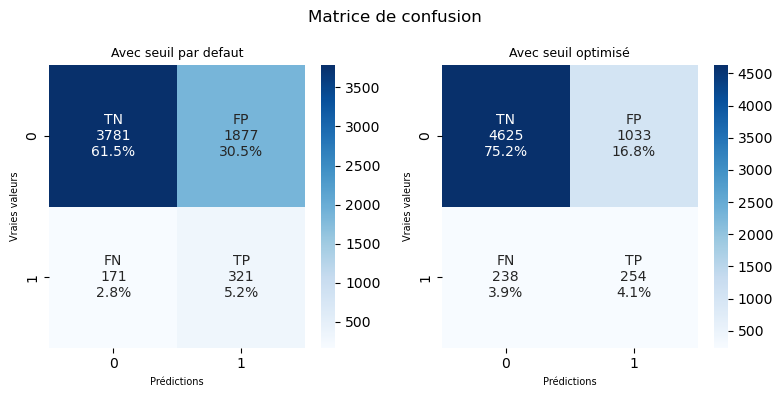

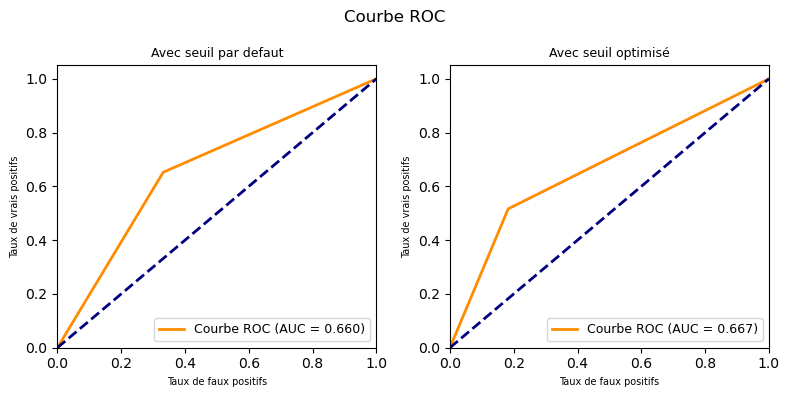

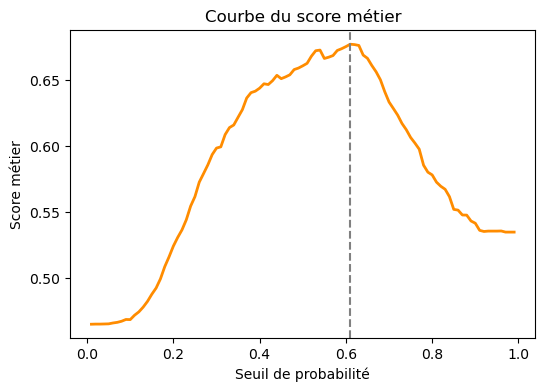

Seuil de probalité optimal : 0.61
Score métier optimal : 0.677


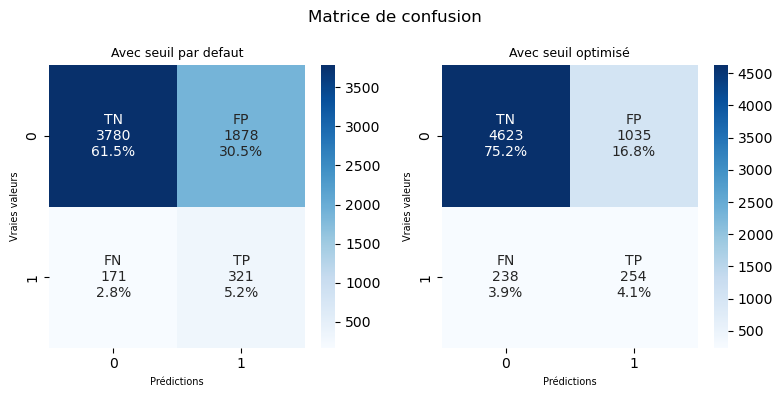

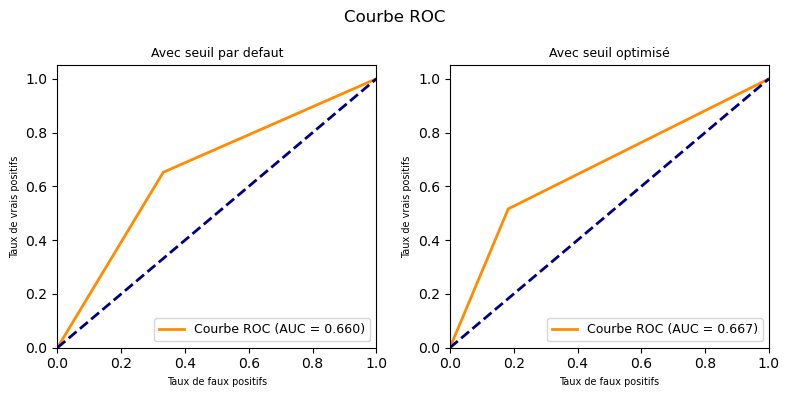

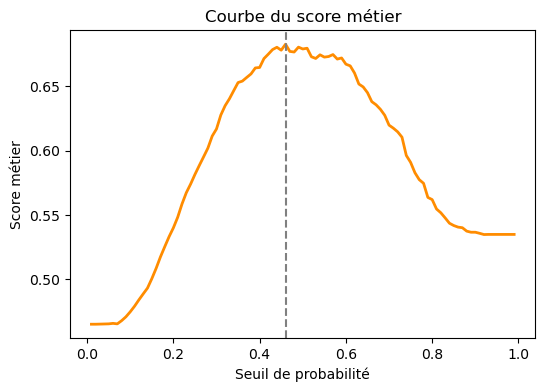

Seuil de probalité optimal : 0.46
Score métier optimal : 0.683


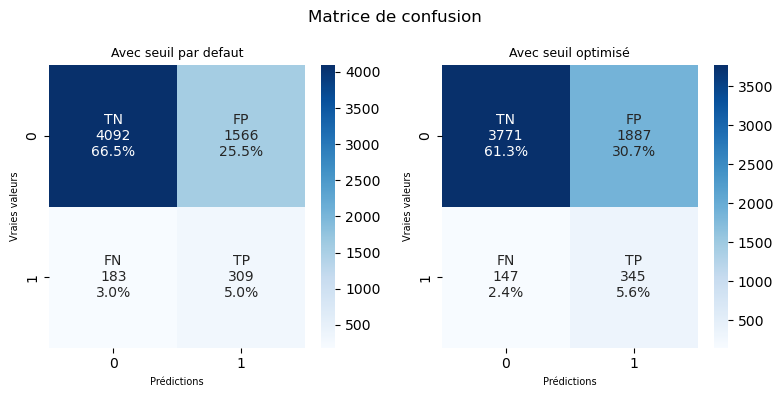

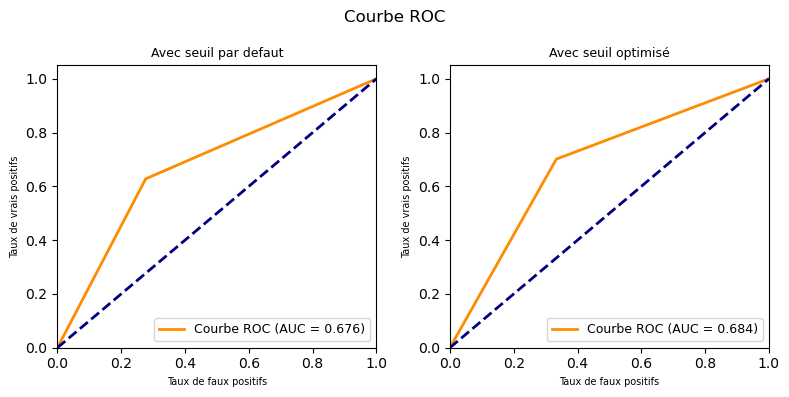

In [220]:
# Définition du pipeline pour enchainer les étapes de prétraiement et de classification 
GBCls = Pipeline([
    ('scale', StandardScaler()),
    ('model', GradientBoostingClassifier())
])

# Définition du pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes
GBCls_oversampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', GradientBoostingClassifier())
])

GBCls_undersampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', GradientBoostingClassifier())
])

GBCls_smote = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', SMOTE(random_state=42)),
    ('model', GradientBoostingClassifier())
])

model_eval2(GBCls, 'GradientBoostingClassifier', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux)
model_eval2(GBCls_oversampler, 'GradientBoostingClassifier', 'StandardScaler', X_undersample, y_undersample, X_test, y_test,  perf_tableaux, 'oversampler')
model_eval2(GBCls_undersampler, 'GradientBoostingClassifier', 'StandardScaler', X_undersample, y_undersample, X_test, y_test,  perf_tableaux,'undersampler')
model_eval2(GBCls_smote, 'GradientBoostingClassifier', 'StandardScaler', X_undersample, y_undersample, X_test, y_test,  perf_tableaux,'smote')
#avec class_weight
GBCls_classweight = GradientBoostingClassifier()
model_eval2(GBCls_classweight, 'GradientBoostingClassifier', 'StandardScaler', X_train_scaled, y_train, X_test_scaled, y_test,  perf_tableaux,'class_weight')


In [221]:
perf_tableaux

,Model,Normalisation,Target Balanced,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
0,DummyClassifier,StandardScaler,None,None,None,0.01,0.539,0.511,0.850,0.099,0.108,0 days 00:00:00.331145
1,DummyClassifier,StandardScaler,oversampler,None,None,0.01,0.487,0.487,0.482,0.076,0.494,0 days 00:00:00.683871
2,DummyClassifier,StandardScaler,undersampler,None,None,0.01,0.490,0.488,0.507,0.076,0.465,0 days 00:00:00.381938
3,DummyClassifier,StandardScaler,smote,None,None,0.01,0.489,0.488,0.503,0.076,0.470,0 days 00:00:00.801290
4,DummyClassifier,StandardScaler,class_weight,None,None,0.01,0.498,0.497,0.505,0.079,0.488,0 days 00:00:00.012053
5,LogisticRegression,StandardScaler,None,None,None,0.10,0.676,0.669,0.751,0.176,0.571,0 days 00:00:01.651064
6,LogisticRegression,StandardScaler,oversampler,None,None,0.50,0.667,0.663,0.706,0.157,0.612,0 days 00:00:03.726391
7,LogisticRegression,StandardScaler,undersampler,None,None,0.50,0.659,0.659,0.661,0.144,0.657,0 days 00:00:00.583995
8,LogisticRegression,StandardScaler,smote,None,None,0.46,0.640,0.636,0.682,0.140,0.581,0 days 00:00:03.561382
9,LogisticRegression,StandardScaler,class_weight,None,None,0.49,0.675,0.673,0.694,0.157,0.648,0 days 00:00:01.550618


<u>6ème simulation </u> :
- modèle type XGBoost
- normalisation StandardScaler
- hyperparamétres par défaut
- sans equilibrage / oversampler / undersampler / smote / class_weight

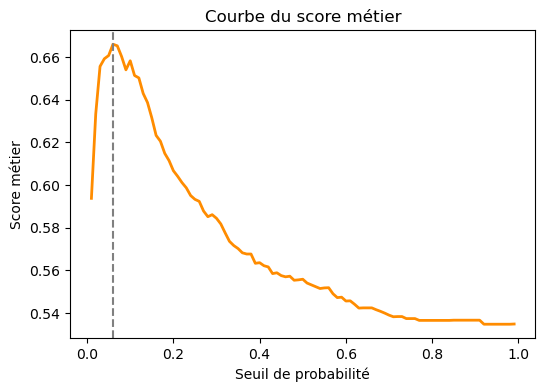

Seuil de probalité optimal : 0.06
Score métier optimal : 0.666


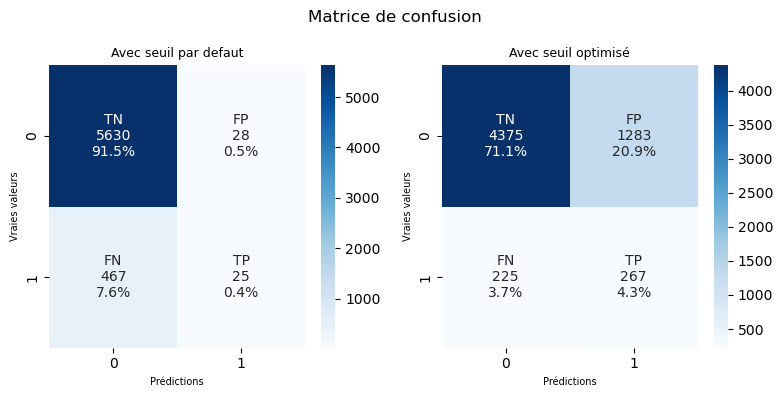

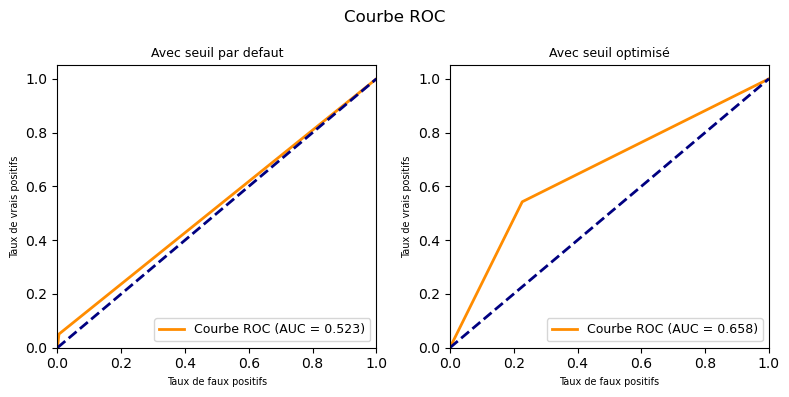

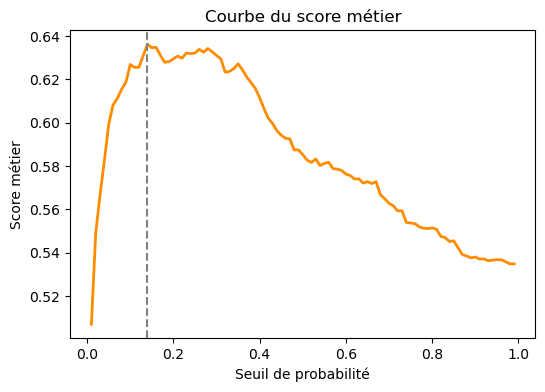

Seuil de probalité optimal : 0.14
Score métier optimal : 0.636


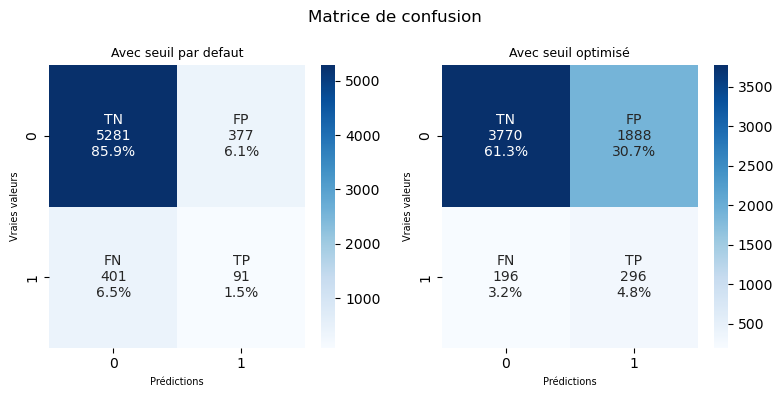

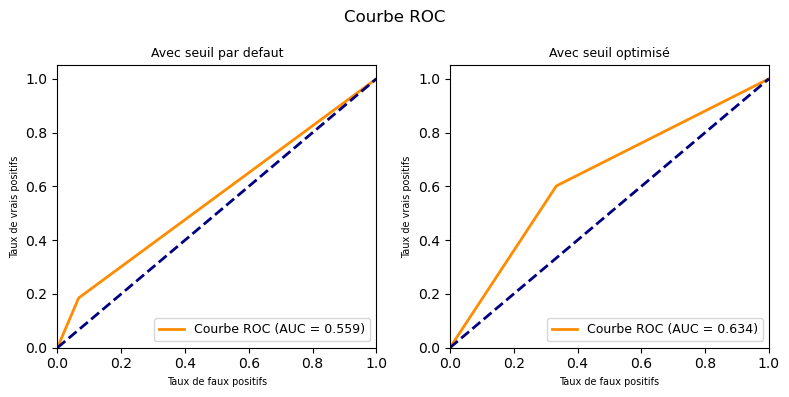

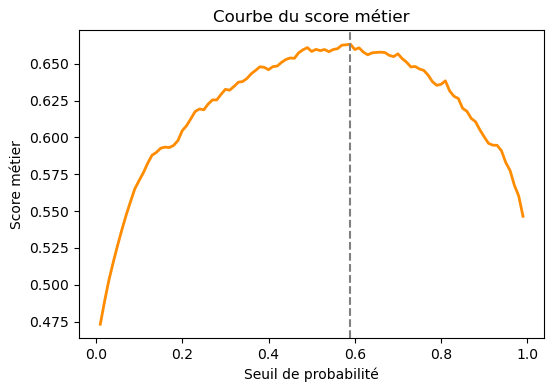

Seuil de probalité optimal : 0.59
Score métier optimal : 0.663


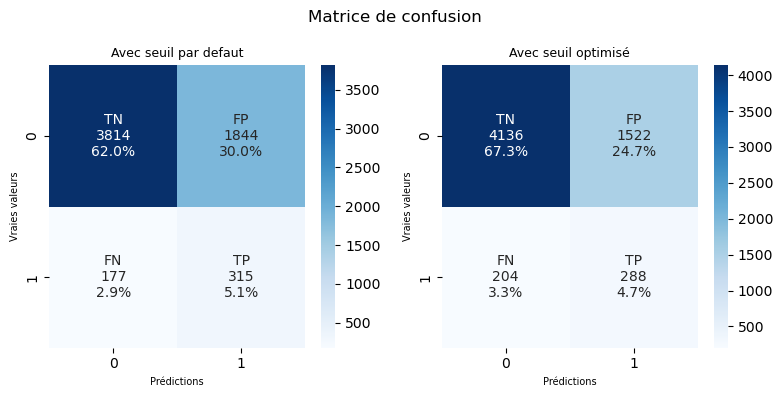

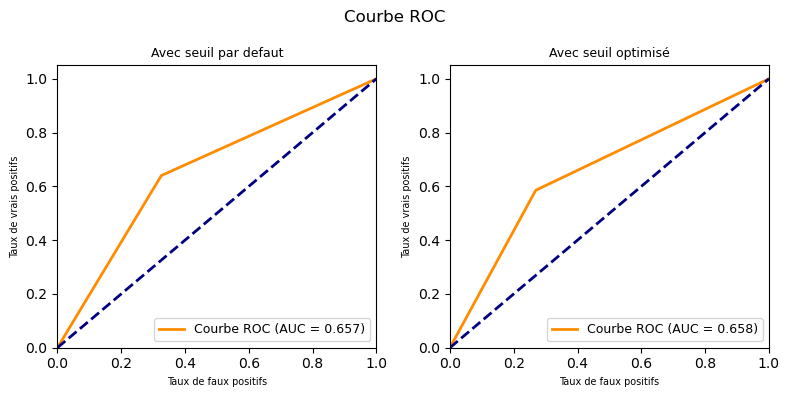

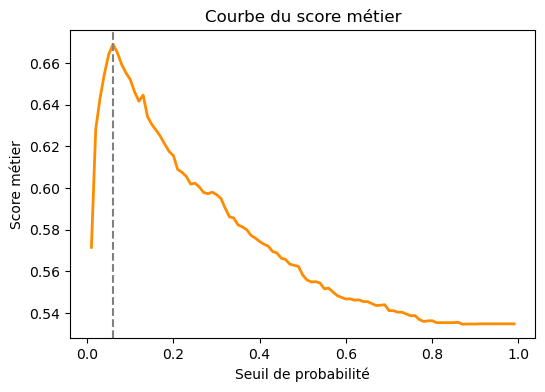

Seuil de probalité optimal : 0.06
Score métier optimal : 0.669


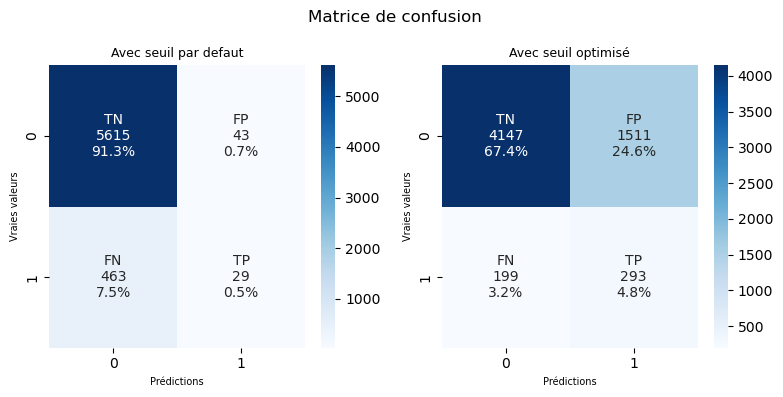

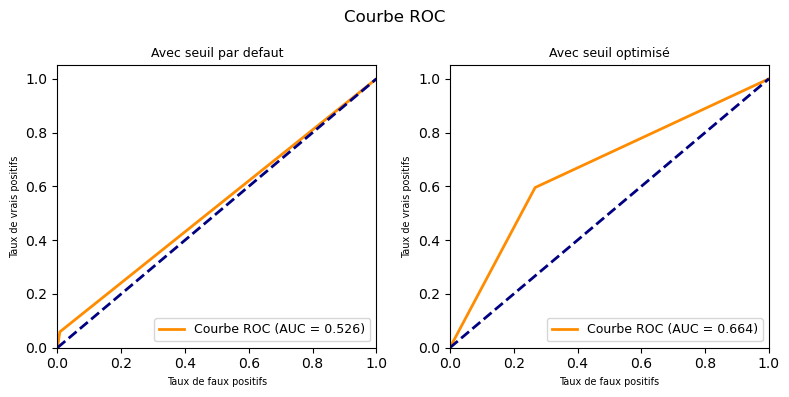

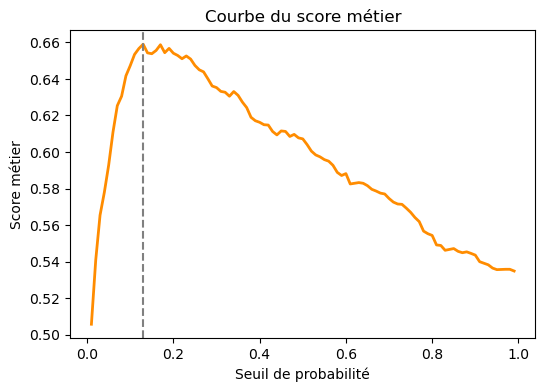

Seuil de probalité optimal : 0.13
Score métier optimal : 0.659


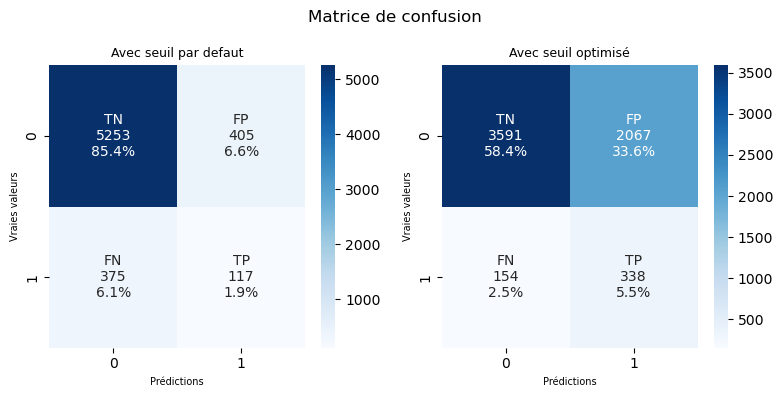

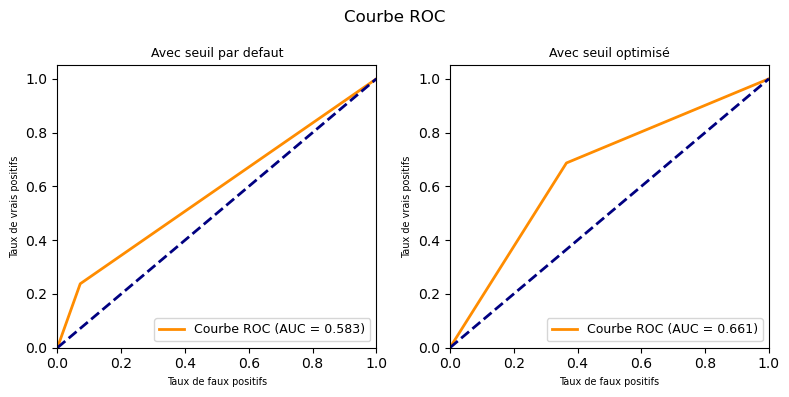

In [97]:
XGBCls = Pipeline([
    ('scale', StandardScaler()),
     ('model', XGBClassifier())
])

# Définition du pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes
XGBCls_oversampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', XGBClassifier())
])

XGBCls_undersampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', XGBClassifier())
])

XGBCls_smote = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', SMOTE(random_state=42)),
    ('model', XGBClassifier())
])

model_eval2(XGBCls, 'XGBClassifier', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux)
model_eval2(XGBCls_oversampler, 'XGBClassifier', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux,'oversampler')
model_eval2(XGBCls_undersampler, 'XGBClassifier', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux,'undersampler')
model_eval2(XGBCls_smote, 'XGBClassifier', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux,'smote')
#avec class_weight
XGBCls_classweight = XGBClassifier()
model_eval2(XGBCls_classweight, 'XGBClassifier', 'StandardScaler', X_train_scaled, y_train, X_test_scaled, y_test,  perf_tableaux,'class_weight')



In [98]:
perf_tableaux

,Model,Normalisation,Target Balanced,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
0,DummyClassifier,StandardScaler,None,None,None,0.01,0.530,0.501,0.850,0.082,0.085,0 days 00:00:00.352013
1,DummyClassifier,StandardScaler,oversampler,None,None,0.01,0.499,0.500,0.491,0.080,0.510,0 days 00:00:00.714163
2,DummyClassifier,StandardScaler,undersampler,None,None,0.01,0.495,0.495,0.495,0.078,0.494,0 days 00:00:00.484992
3,DummyClassifier,StandardScaler,smote,None,None,0.01,0.507,0.508,0.500,0.082,0.518,0 days 00:00:01.080622
4,DummyClassifier,StandardScaler,class_weight,None,None,0.01,0.494,0.494,0.498,0.078,0.490,0 days 00:00:00.017843
5,DecisionTreeClassifier,StandardScaler,None,None,None,0.01,0.554,0.527,0.847,0.121,0.146,0 days 00:00:12.274206
6,DecisionTreeClassifier,StandardScaler,oversampler,None,None,0.01,0.565,0.539,0.854,0.143,0.165,0 days 00:00:12.353797
7,DecisionTreeClassifier,StandardScaler,undersampler,None,None,0.01,0.572,0.572,0.568,0.104,0.577,0 days 00:00:01.165836
8,DecisionTreeClassifier,StandardScaler,smote,None,None,0.01,0.567,0.543,0.830,0.132,0.201,0 days 00:00:15.461661
9,DecisionTreeClassifier,StandardScaler,class_weight,None,None,0.01,0.561,0.535,0.845,0.131,0.167,0 days 00:00:06.321064


<u>7ème simulation </u> :
- modèle type LightGBM
- normalisation StandardScaler
- hyperparamétres par défaut
- sans equilibrage / oversampler / undersampler / smote / class_weight

[LightGBM] [Info] Number of positive: 2040, number of negative: 22560
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.035879 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 55115
[LightGBM] [Info] Number of data points in the train set: 24600, number of used features: 531
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.082927 -> initscore=-2.403229
[LightGBM] [Info] Start training from score -2.403229


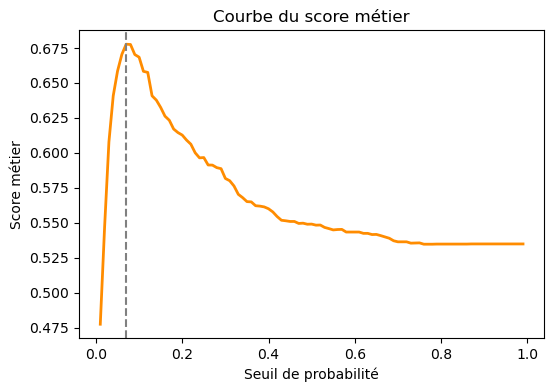

Seuil de probalité optimal : 0.07
Score métier optimal : 0.678


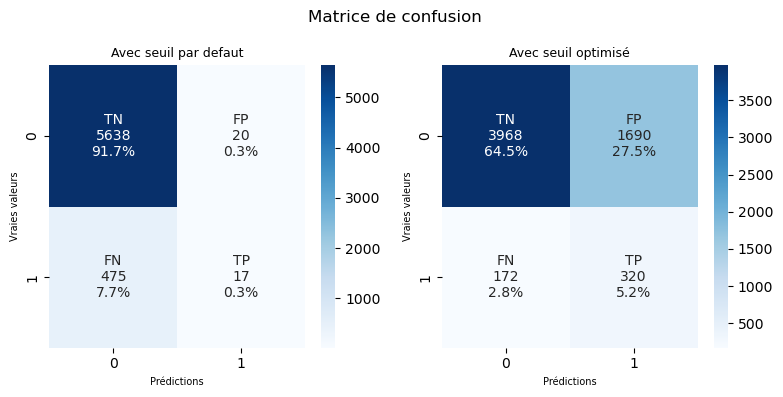

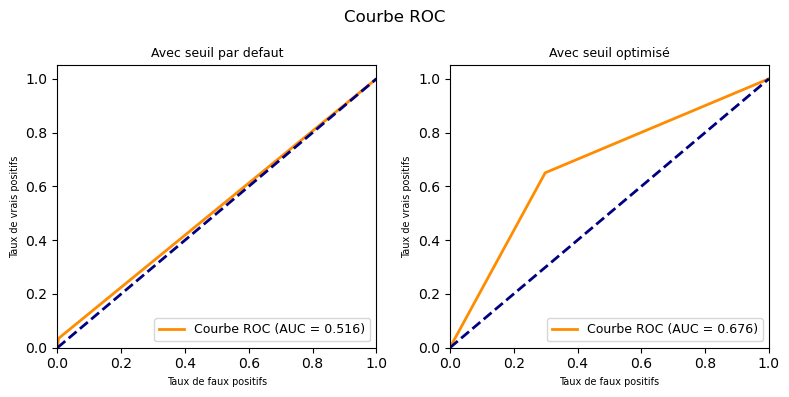

[LightGBM] [Info] Number of positive: 22560, number of negative: 22560
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.060756 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 56320
[LightGBM] [Info] Number of data points in the train set: 45120, number of used features: 542
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000


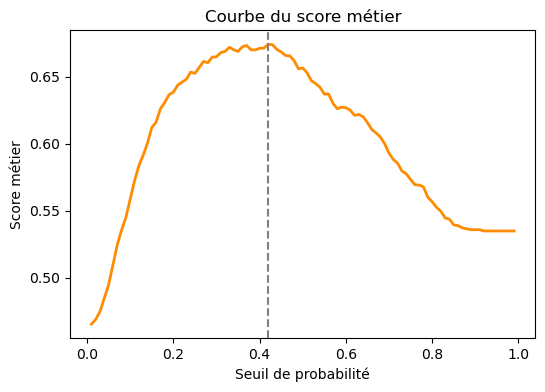

Seuil de probalité optimal : 0.42
Score métier optimal : 0.674


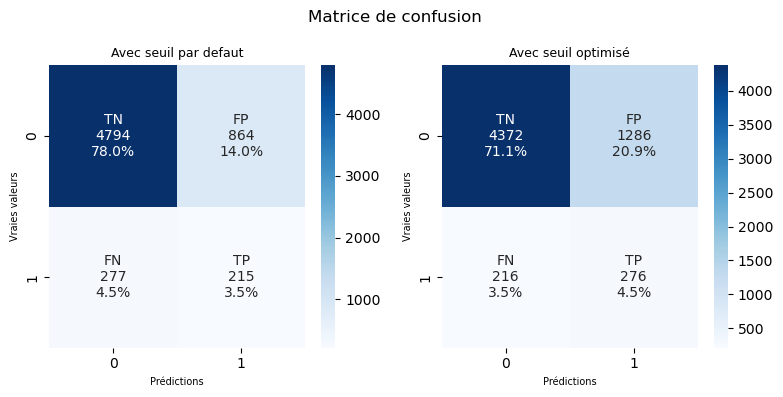

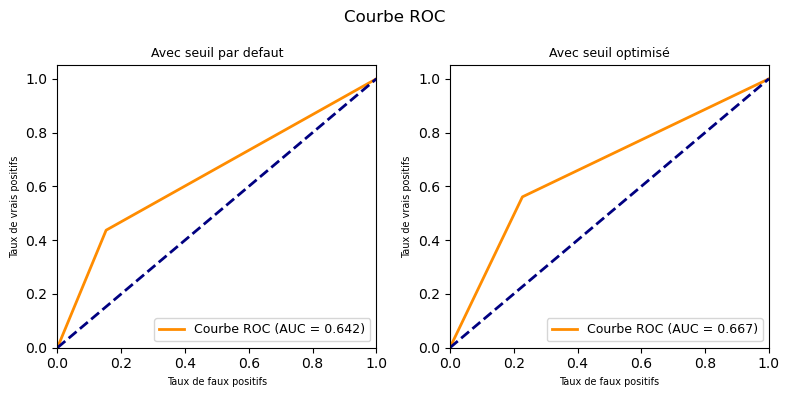

[LightGBM] [Info] Number of positive: 2040, number of negative: 2040
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.010892 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 44728
[LightGBM] [Info] Number of data points in the train set: 4080, number of used features: 466
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000


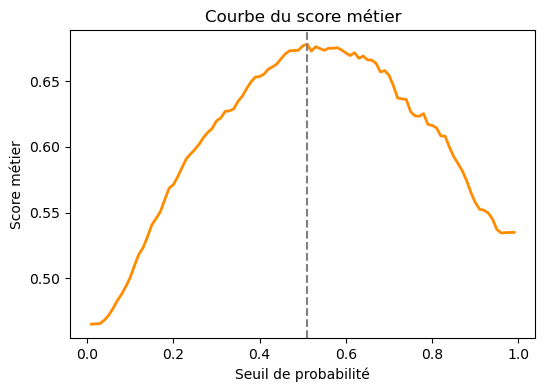

Seuil de probalité optimal : 0.51
Score métier optimal : 0.678


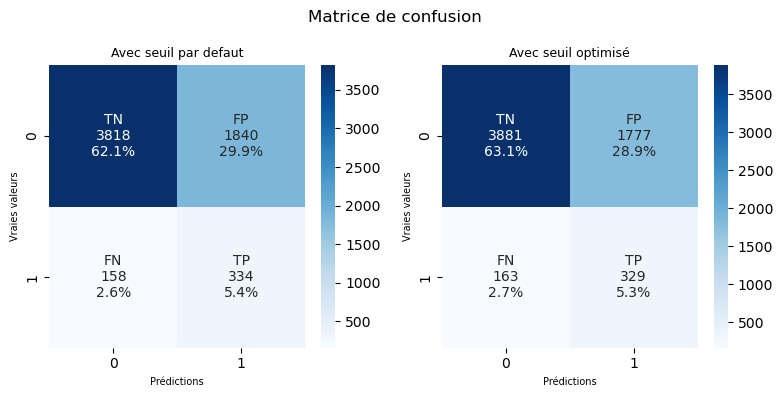

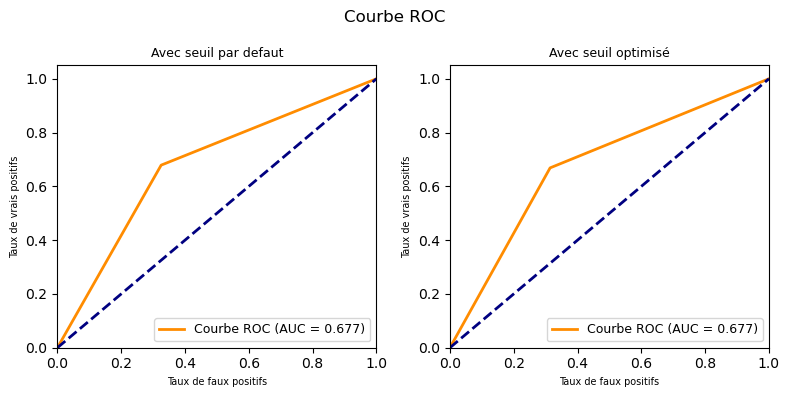

[LightGBM] [Info] Number of positive: 22560, number of negative: 22560
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.081642 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 109518
[LightGBM] [Info] Number of data points in the train set: 45120, number of used features: 541
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000


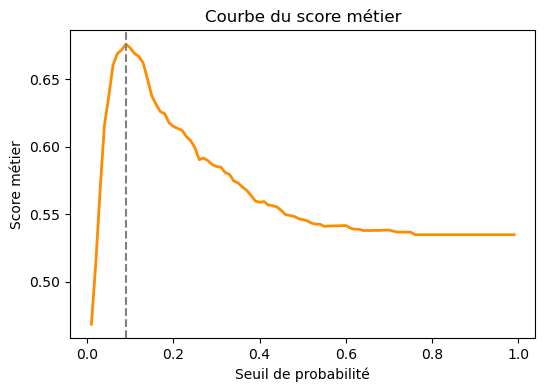

Seuil de probalité optimal : 0.09
Score métier optimal : 0.676


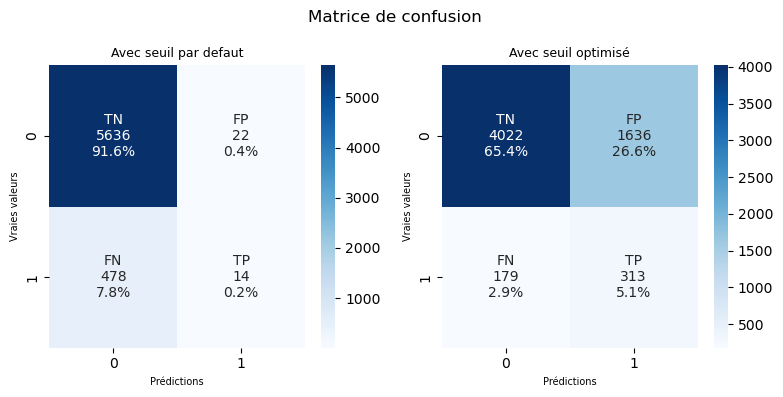

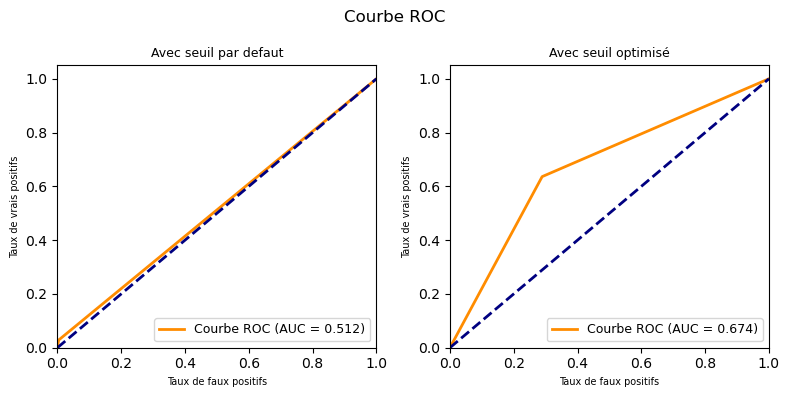

[LightGBM] [Info] Number of positive: 2040, number of negative: 22560
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.034939 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 55115
[LightGBM] [Info] Number of data points in the train set: 24600, number of used features: 531
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Start training from score 0.000000


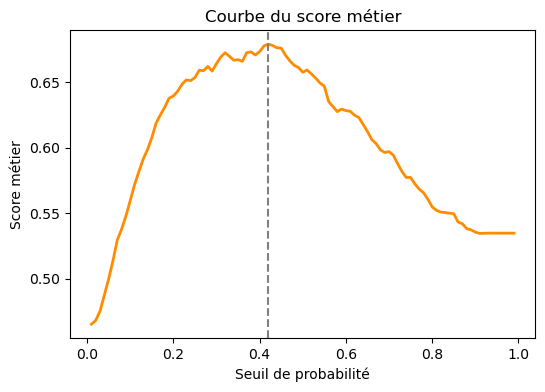

Seuil de probalité optimal : 0.42
Score métier optimal : 0.679


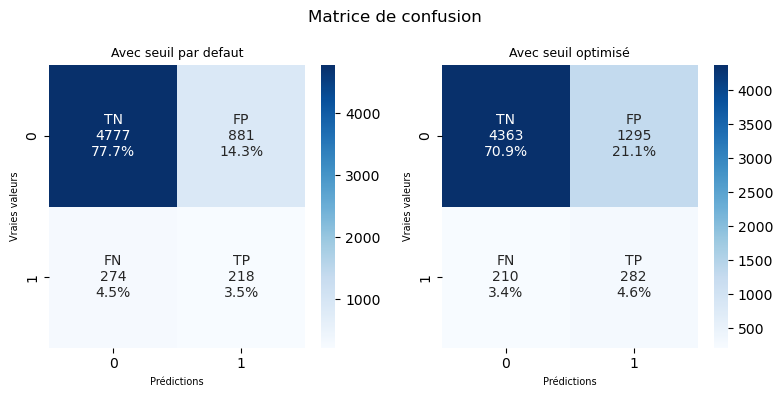

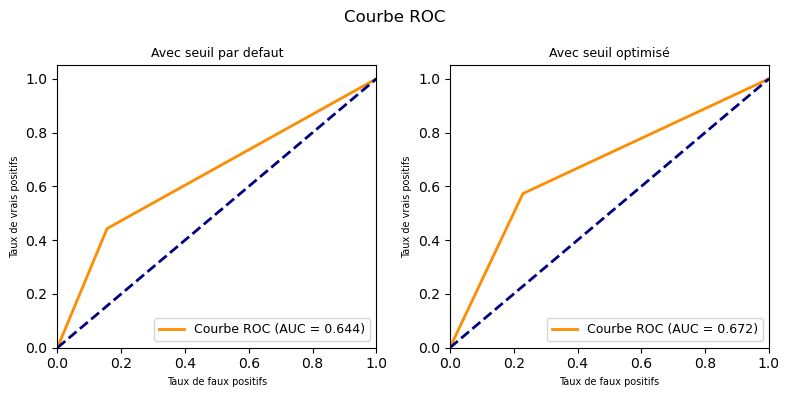

In [100]:
LGBMCls = Pipeline([
    ('scale', StandardScaler()),
     ('model', LGBMClassifier())
])

# Définition du pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes
LGBMCls_oversampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', LGBMClassifier())
])

LGBMCls_undersampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', LGBMClassifier())
])

LGBMCls_smote = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', SMOTE(random_state=42)),
    ('model', LGBMClassifier())
])


model_eval2(LGBMCls, 'LGBMClassifier', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux)
model_eval2(LGBMCls_oversampler, 'LGBMClassifier', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux,'oversampler')
model_eval2(LGBMCls_undersampler, 'LGBMClassifier', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux,'undersampler')
model_eval2(LGBMCls_smote, 'LGBMClassifier', 'StandardScaler', X_train, y_train, X_test, y_test,  perf_tableaux,'smote')
#avec class_weight
LGBMCls_classweight = LGBMClassifier()
model_eval2(LGBMCls_classweight, 'LGBMClassifier', 'StandardScaler', X_train_scaled, y_train, X_test_scaled, y_test,  perf_tableaux,'class_weight')


In [101]:
perf_tableaux.loc[perf_tableaux["Normalisation"]=="StandardScaler"]

,Model,Normalisation,Target Balanced,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
0,DummyClassifier,StandardScaler,None,None,None,0.01,0.530,0.501,0.850,0.082,0.085,0 days 00:00:00.352013
1,DummyClassifier,StandardScaler,oversampler,None,None,0.01,0.499,0.500,0.491,0.080,0.510,0 days 00:00:00.714163
2,DummyClassifier,StandardScaler,undersampler,None,None,0.01,0.495,0.495,0.495,0.078,0.494,0 days 00:00:00.484992
3,DummyClassifier,StandardScaler,smote,None,None,0.01,0.507,0.508,0.500,0.082,0.518,0 days 00:00:01.080622
4,DummyClassifier,StandardScaler,class_weight,None,None,0.01,0.494,0.494,0.498,0.078,0.490,0 days 00:00:00.017843
5,DecisionTreeClassifier,StandardScaler,None,None,None,0.01,0.554,0.527,0.847,0.121,0.146,0 days 00:00:12.274206
6,DecisionTreeClassifier,StandardScaler,oversampler,None,None,0.01,0.565,0.539,0.854,0.143,0.165,0 days 00:00:12.353797
7,DecisionTreeClassifier,StandardScaler,undersampler,None,None,0.01,0.572,0.572,0.568,0.104,0.577,0 days 00:00:01.165836
8,DecisionTreeClassifier,StandardScaler,smote,None,None,0.01,0.567,0.543,0.830,0.132,0.201,0 days 00:00:15.461661
9,DecisionTreeClassifier,StandardScaler,class_weight,None,None,0.01,0.561,0.535,0.845,0.131,0.167,0 days 00:00:06.321064


On refait tourner les tests avec la mise à l'echelle des données suivant MinMaxScaler :

In [129]:
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


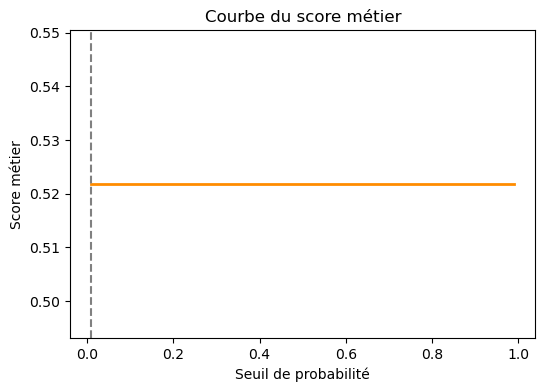

Seuil de probalité optimal : 0.01
Score métier optimal : 0.522


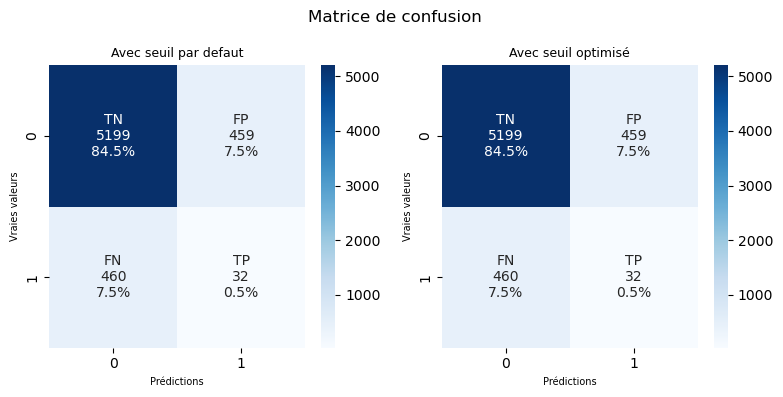

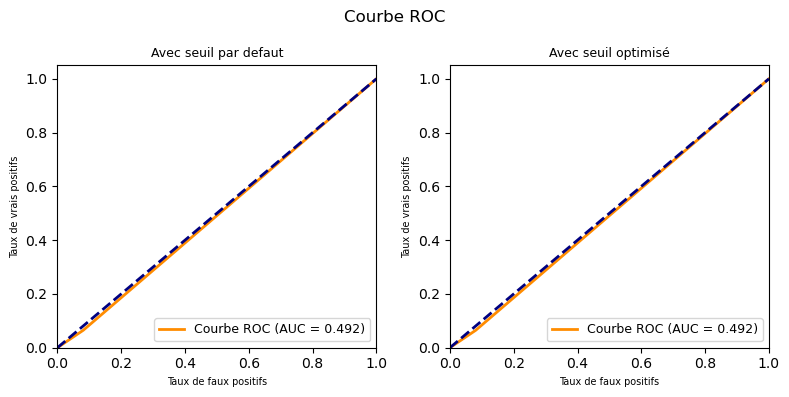

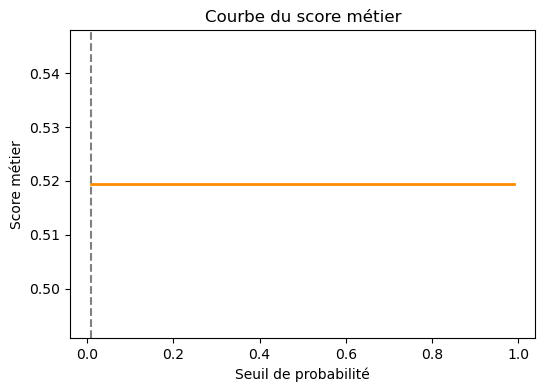

Seuil de probalité optimal : 0.01
Score métier optimal : 0.519


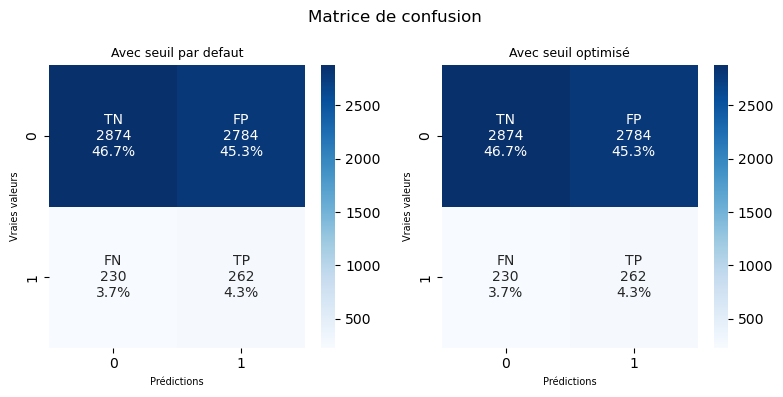

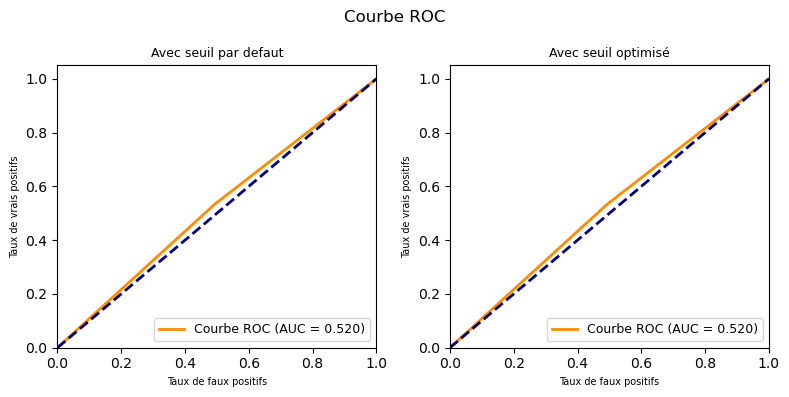

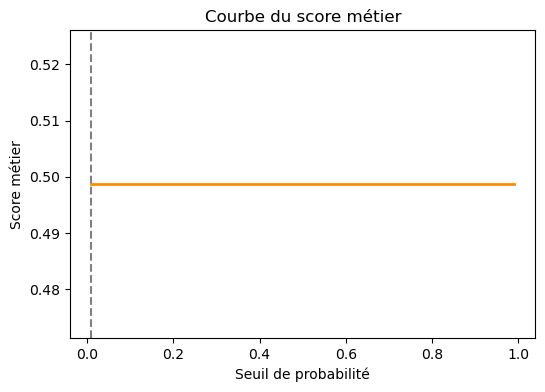

Seuil de probalité optimal : 0.01
Score métier optimal : 0.499


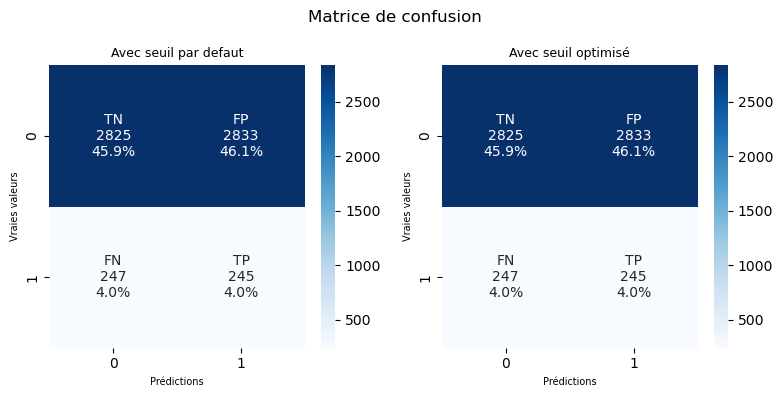

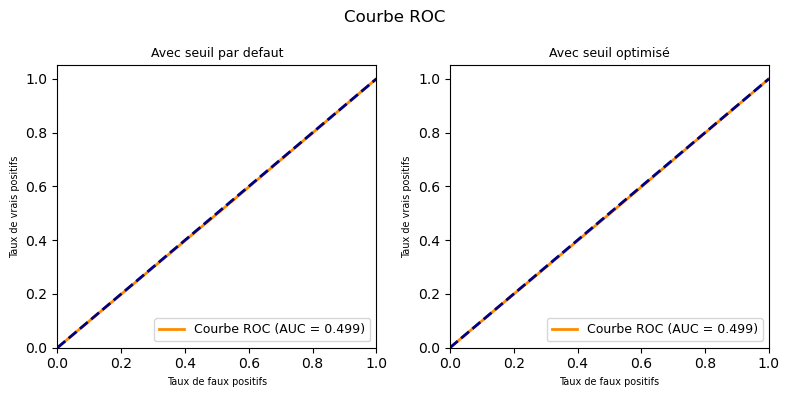

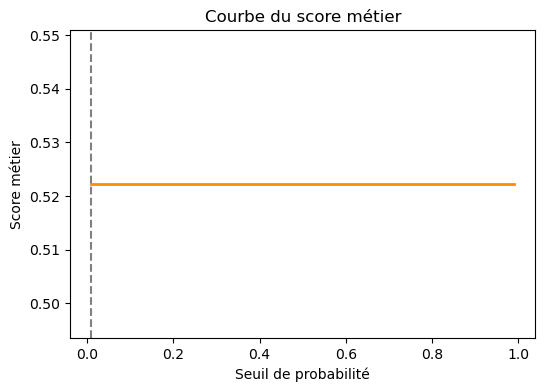

Seuil de probalité optimal : 0.01
Score métier optimal : 0.522


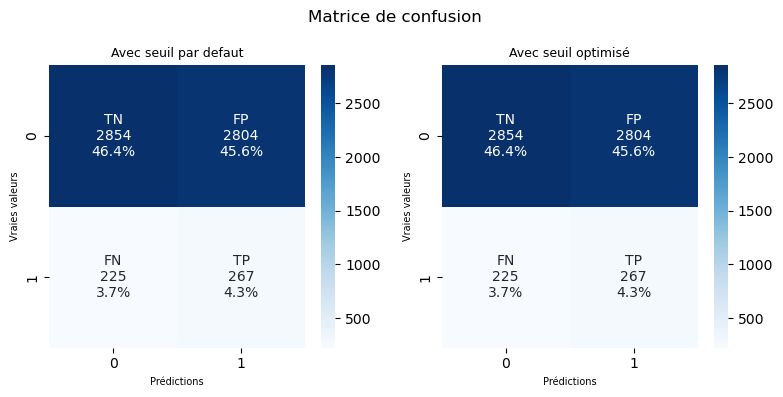

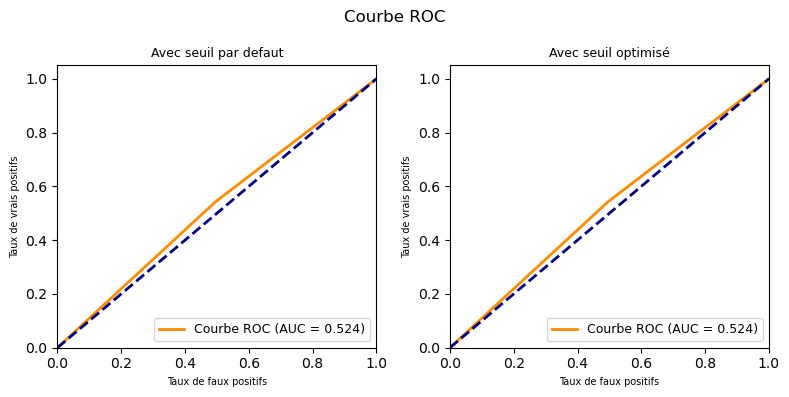

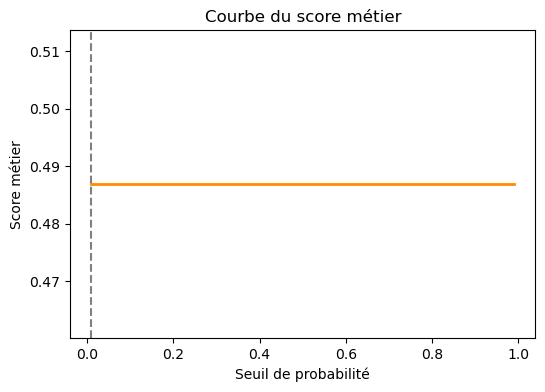

Seuil de probalité optimal : 0.01
Score métier optimal : 0.487


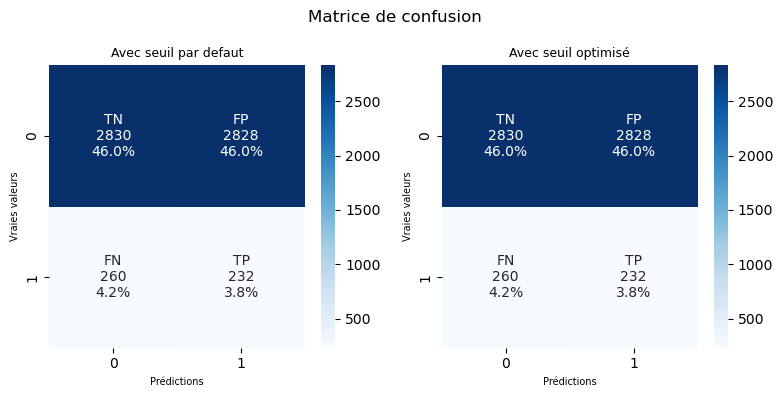

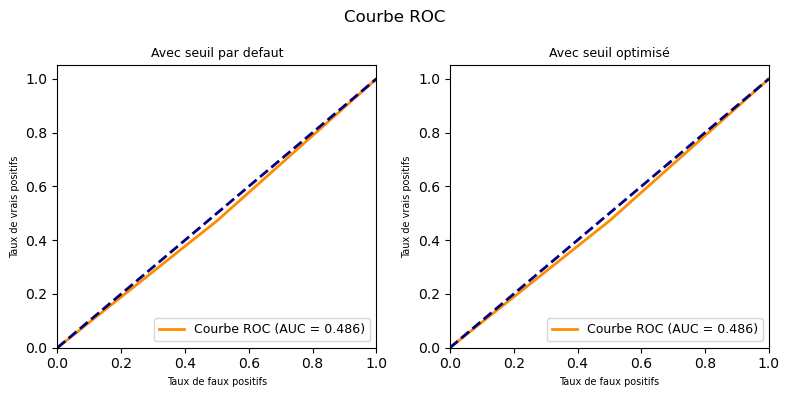

In [104]:
dummyClm = Pipeline([
    ('scale', MinMaxScaler()),
    ('model', DummyClassifier(strategy='stratified')) #generates predictions by respecting the training set’s class distribution.
])

# Définition du pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes
dummyClm_oversampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', DummyClassifier(strategy='stratified'))
])

dummyClm_undersampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', DummyClassifier(strategy='stratified'))
])

dummyClm_smote = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', SMOTE(random_state=42)),
    ('model', DummyClassifier(strategy='stratified'))
])

model_eval2(dummyClm, 'DummyClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux)
model_eval2(dummyClm_oversampler, 'DummyClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'oversampler')
model_eval2(dummyClm_undersampler, 'DummyClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'undersampler')
model_eval2(dummyClm_smote, 'DummyClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'smote')
#avec class_weight
dummyClm_classweight = DummyClassifier(strategy='stratified')
model_eval2(dummyClm_classweight, 'DummyClassifier', 'MinMaxScaler', X_train_scaled, y_train, X_test_scaled, y_test,  perf_tableaux,'class_weight')

In [105]:
perf_tableaux.loc[perf_tableaux["Normalisation"]=="MinMaxScaler"]

,Model,Normalisation,Target Balanced,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
25,DummyClassifier,MinMaxScaler,None,None,None,0.01,0.522,0.492,0.851,0.065,0.065,0 days 00:00:00.231298
26,DummyClassifier,MinMaxScaler,oversampler,None,None,0.01,0.519,0.520,0.510,0.086,0.533,0 days 00:00:00.520862
27,DummyClassifier,MinMaxScaler,undersampler,None,None,0.01,0.499,0.499,0.499,0.080,0.498,0 days 00:00:00.256759
28,DummyClassifier,MinMaxScaler,smote,None,None,0.01,0.522,0.524,0.507,0.087,0.543,0 days 00:00:00.744119
29,DummyClassifier,MinMaxScaler,class_weight,None,None,0.01,0.487,0.486,0.498,0.076,0.472,0 days 00:00:00.025464


C:\Users\MOI\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


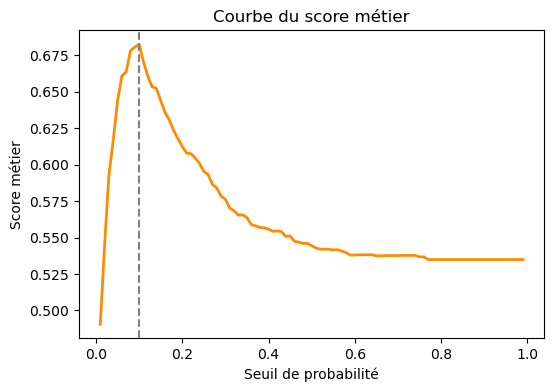

Seuil de probalité optimal : 0.1
Score métier optimal : 0.683


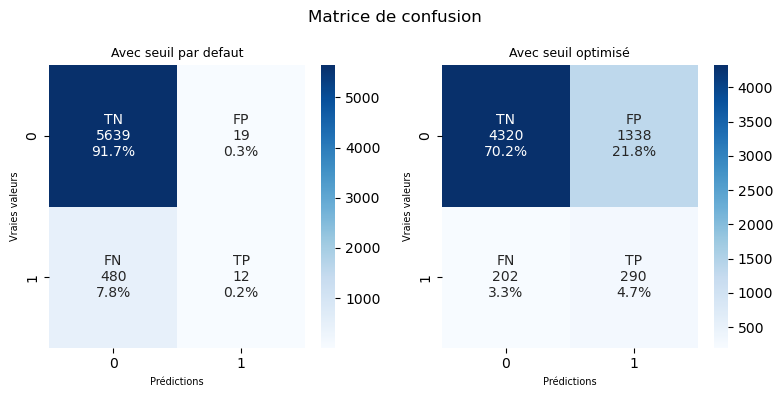

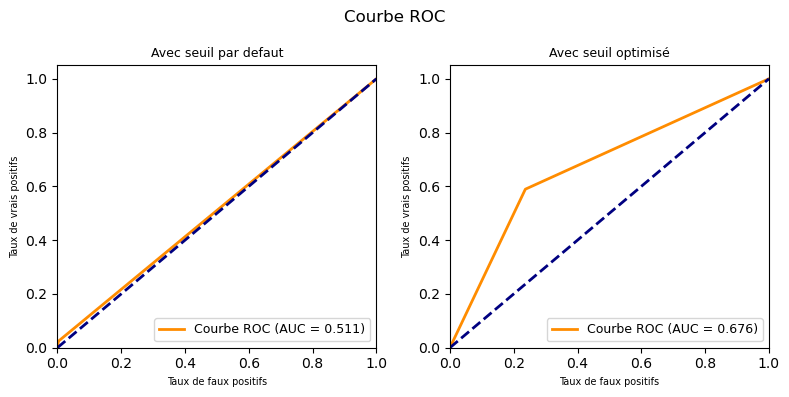

C:\Users\MOI\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


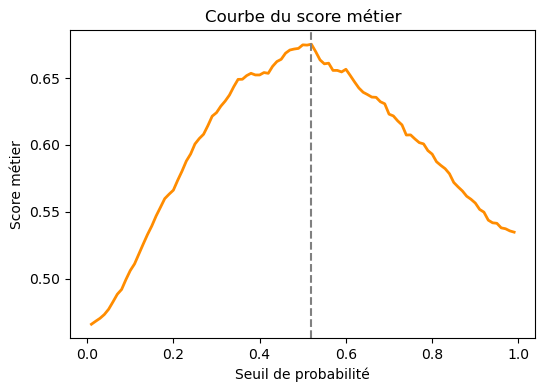

Seuil de probalité optimal : 0.52
Score métier optimal : 0.675


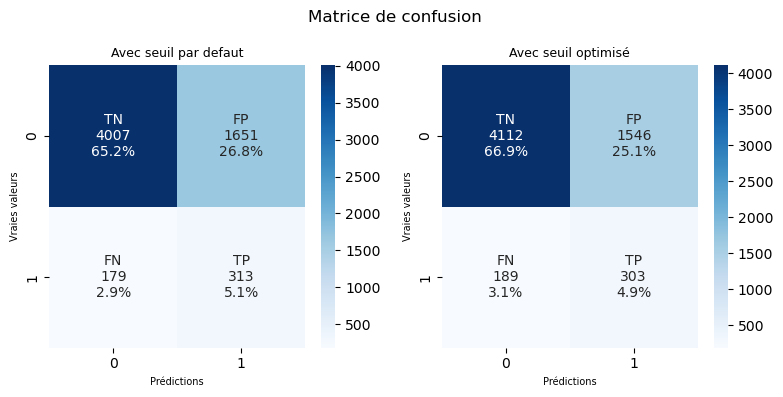

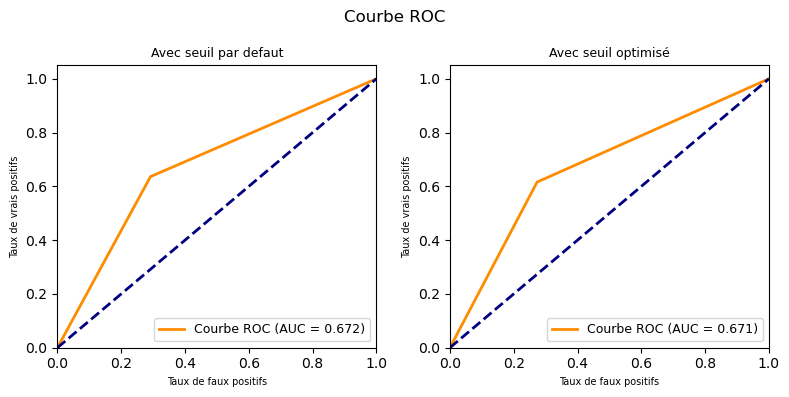

C:\Users\MOI\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


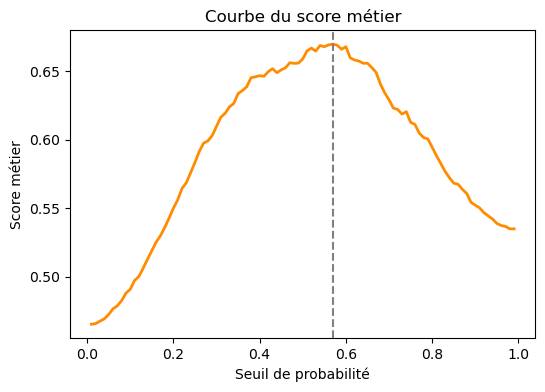

Seuil de probalité optimal : 0.57
Score métier optimal : 0.67


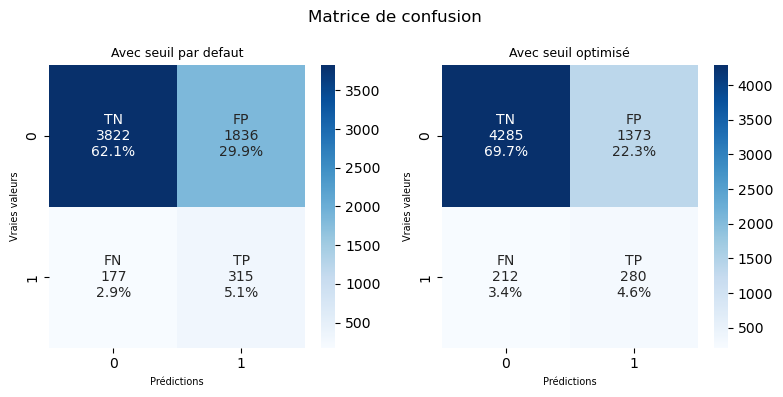

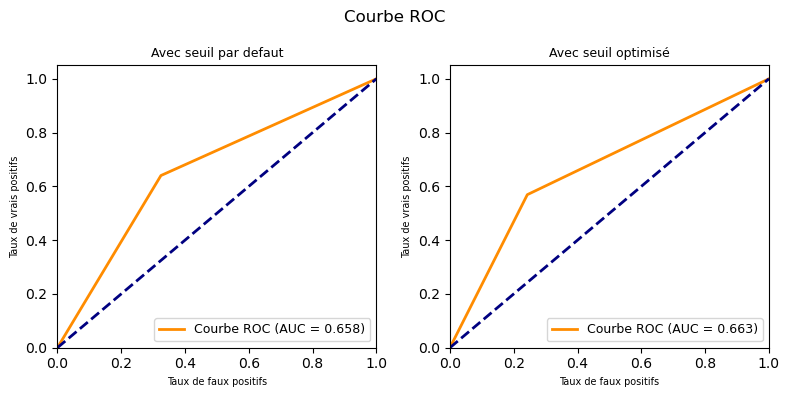

C:\Users\MOI\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


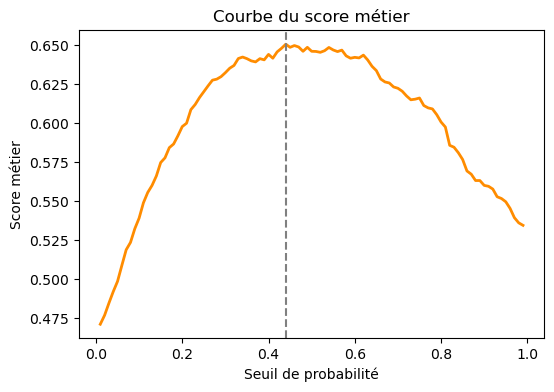

Seuil de probalité optimal : 0.44
Score métier optimal : 0.651


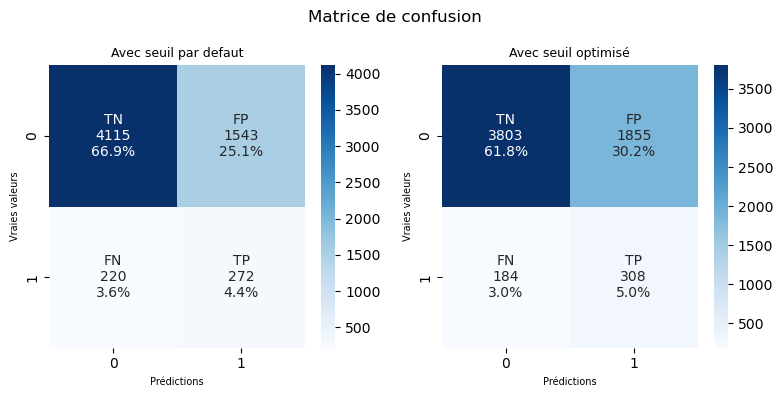

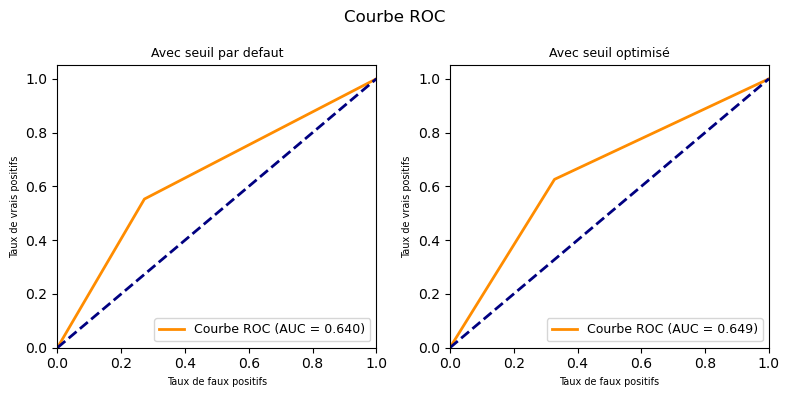

C:\Users\MOI\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


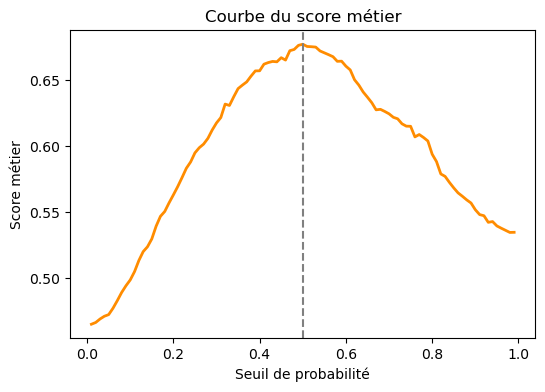

Seuil de probalité optimal : 0.5
Score métier optimal : 0.677


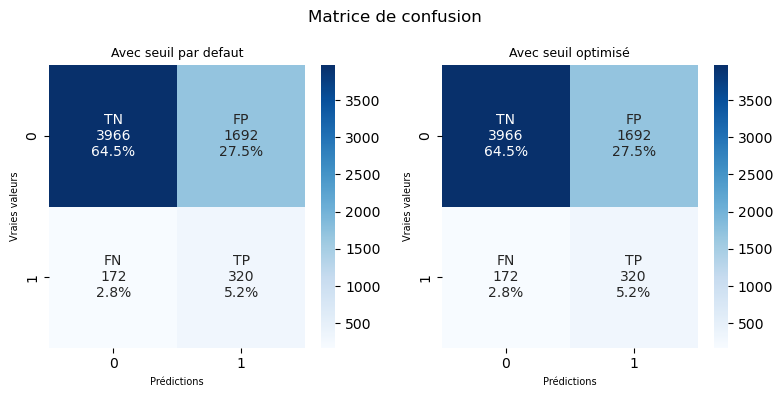

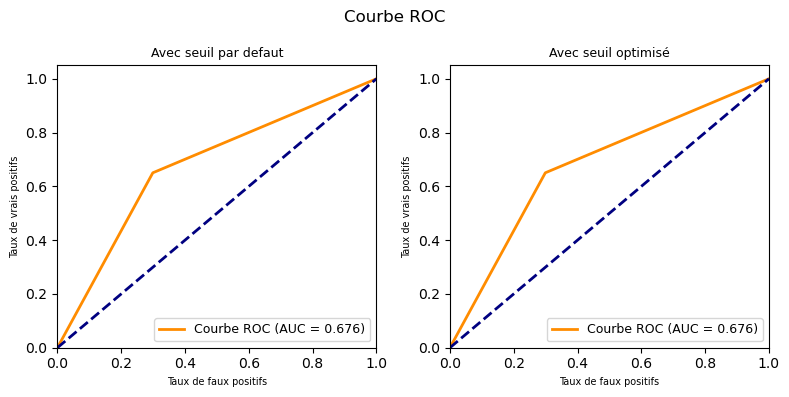

In [106]:
LRClm = Pipeline([
    ('scale', MinMaxScaler()),
    ('model', LogisticRegression()) #generates predictions by respecting the training set’s class distribution.
])

# Définition du pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes
LRClm_oversampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', LogisticRegression())
])

LRClm_undersampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', LogisticRegression())
])

LRClm_smote = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', SMOTE(random_state=42)),
    ('model', LogisticRegression())
])

model_eval2(LRClm, 'LogisticRegression', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux)
model_eval2(LRClm_oversampler, 'LogisticRegression', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'oversampler')
model_eval2(LRClm_undersampler, 'LogisticRegression', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'undersampler')
model_eval2(LRClm_smote, 'LogisticRegression', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'smote')
#avec class_weight
LRClm_classweight = LogisticRegression()
model_eval2(LRClm_classweight, 'LogisticRegression', 'MinMaxScaler', X_train_scaled, y_train, X_test_scaled, y_test,  perf_tableaux,'class_weight')

In [107]:
perf_tableaux.loc[perf_tableaux["Normalisation"]=="MinMaxScaler"]

,Model,Normalisation,Target Balanced,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
25,DummyClassifier,MinMaxScaler,None,None,None,0.01,0.522,0.492,0.851,0.065,0.065,0 days 00:00:00.231298
26,DummyClassifier,MinMaxScaler,oversampler,None,None,0.01,0.519,0.520,0.510,0.086,0.533,0 days 00:00:00.520862
27,DummyClassifier,MinMaxScaler,undersampler,None,None,0.01,0.499,0.499,0.499,0.080,0.498,0 days 00:00:00.256759
28,DummyClassifier,MinMaxScaler,smote,None,None,0.01,0.522,0.524,0.507,0.087,0.543,0 days 00:00:00.744119
29,DummyClassifier,MinMaxScaler,class_weight,None,None,0.01,0.487,0.486,0.498,0.076,0.472,0 days 00:00:00.025464
30,LogisticRegression,MinMaxScaler,None,None,None,0.10,0.683,0.676,0.750,0.178,0.589,0 days 00:00:01.956843
31,LogisticRegression,MinMaxScaler,oversampler,None,None,0.52,0.675,0.671,0.718,0.164,0.616,0 days 00:00:03.587753
32,LogisticRegression,MinMaxScaler,undersampler,None,None,0.57,0.670,0.663,0.742,0.169,0.569,0 days 00:00:00.457806
33,LogisticRegression,MinMaxScaler,smote,None,None,0.44,0.651,0.649,0.668,0.142,0.626,0 days 00:00:04.029276
34,LogisticRegression,MinMaxScaler,class_weight,None,None,0.50,0.677,0.676,0.697,0.159,0.650,0 days 00:00:01.801221


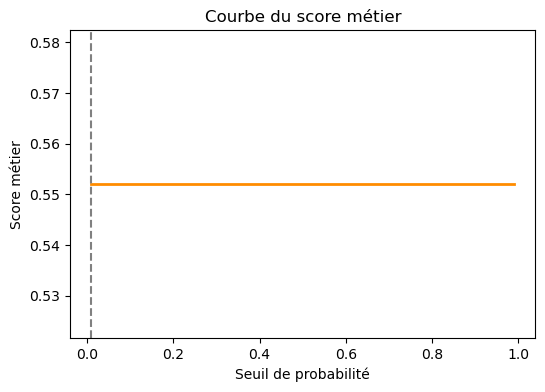

Seuil de probalité optimal : 0.01
Score métier optimal : 0.552


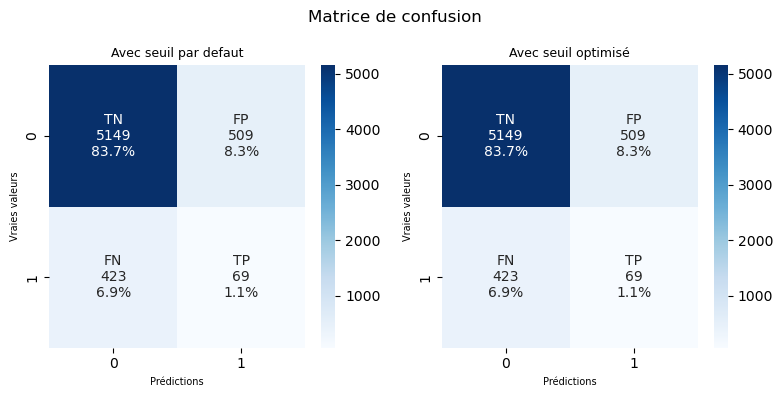

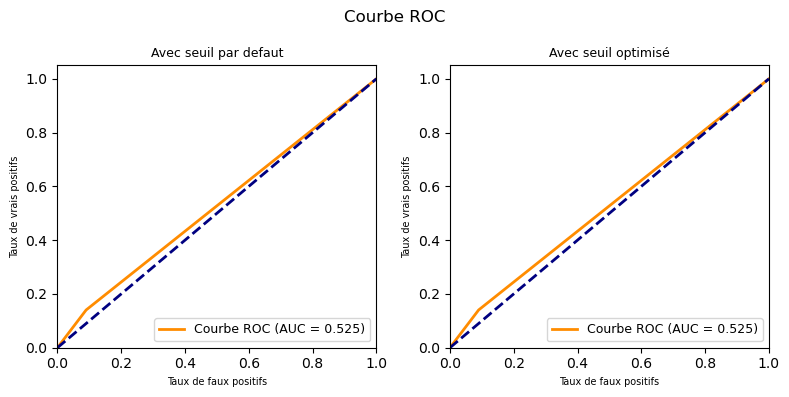

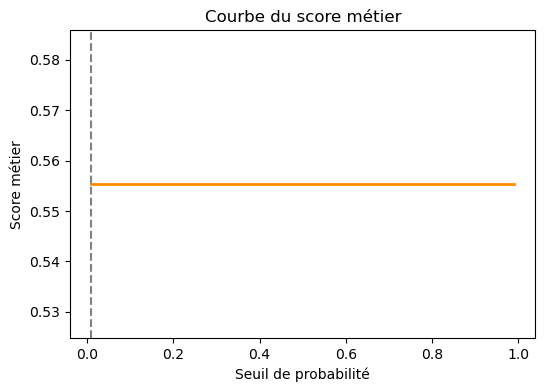

Seuil de probalité optimal : 0.01
Score métier optimal : 0.555


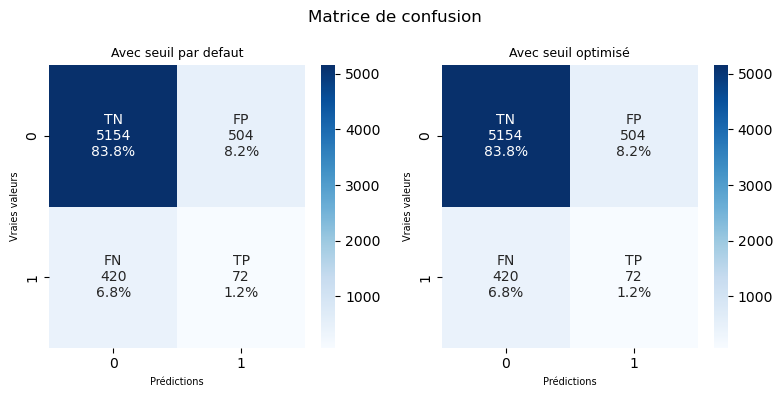

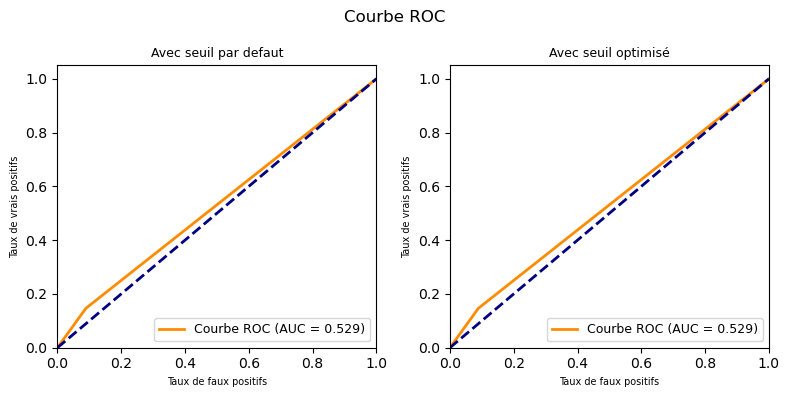

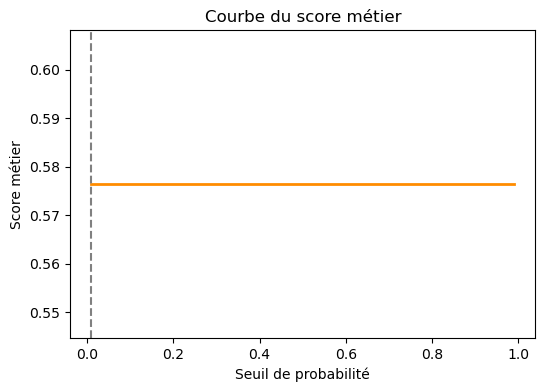

Seuil de probalité optimal : 0.01
Score métier optimal : 0.576


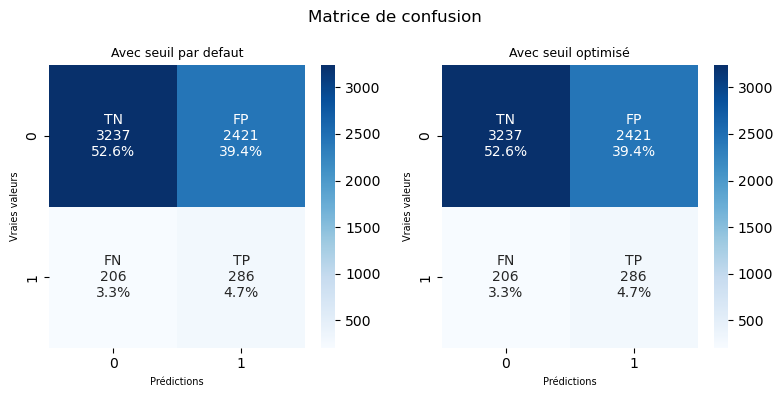

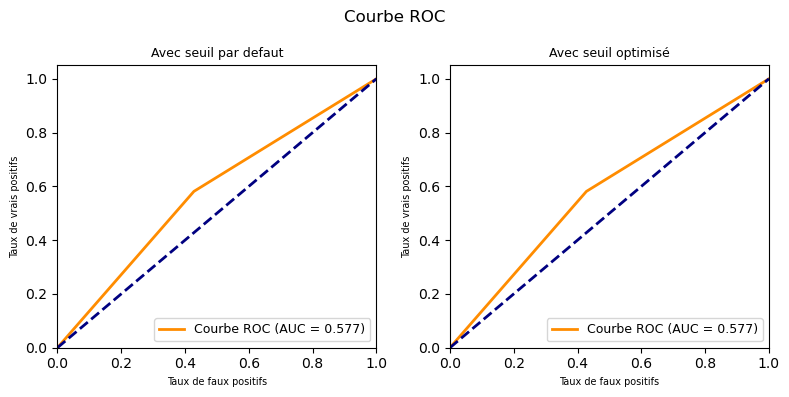

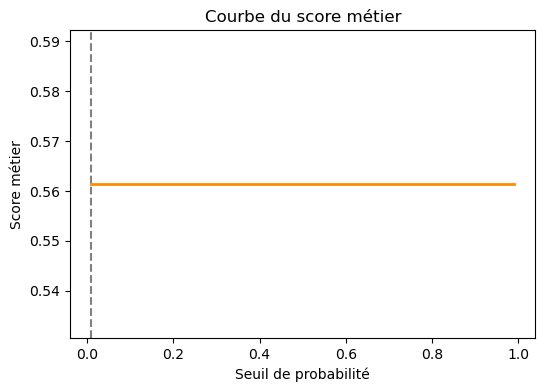

Seuil de probalité optimal : 0.01
Score métier optimal : 0.561


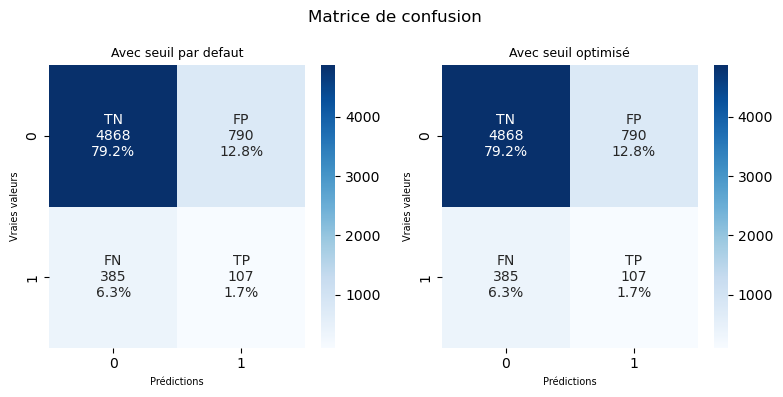

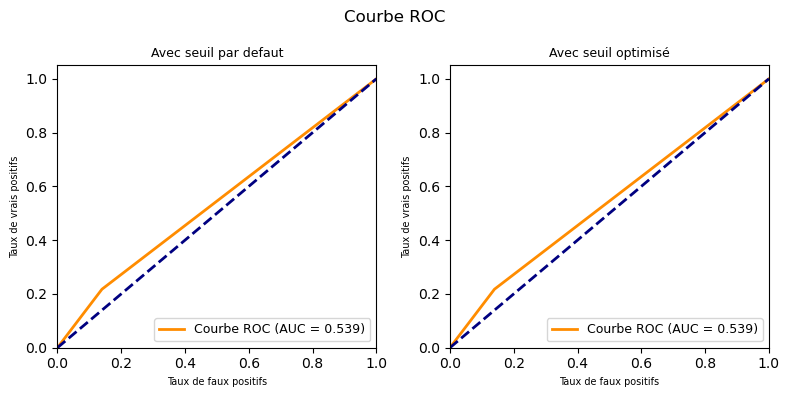

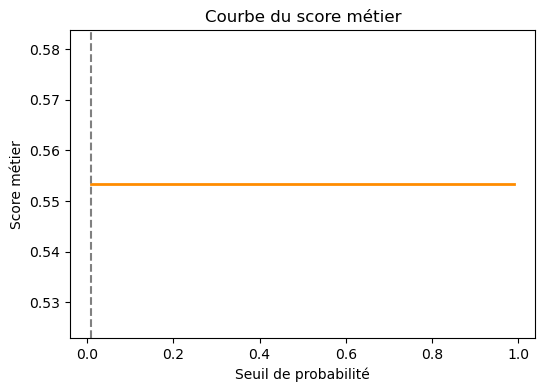

Seuil de probalité optimal : 0.01
Score métier optimal : 0.553


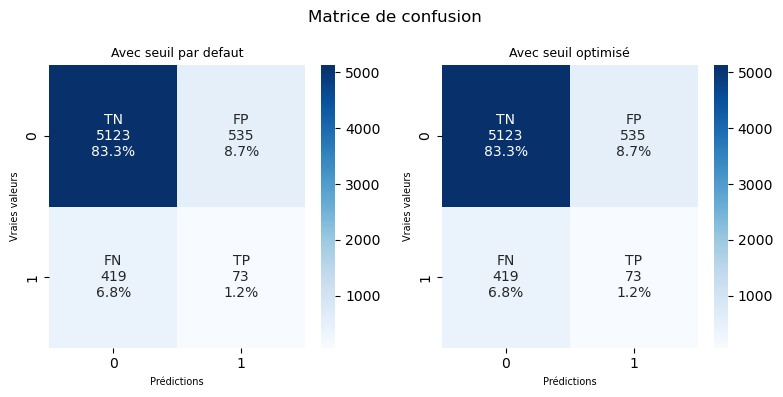

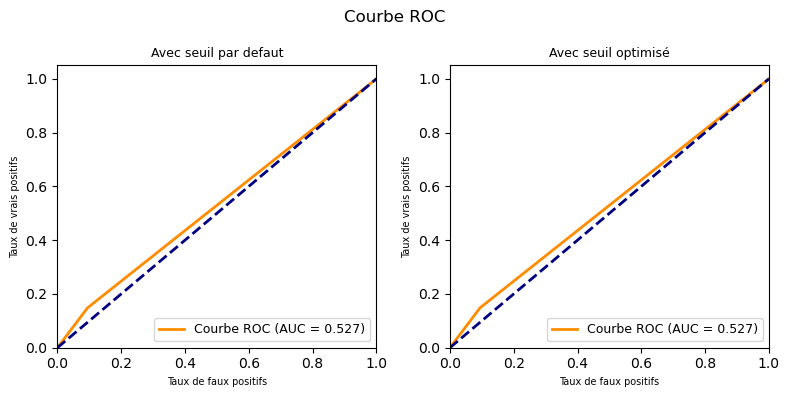

In [108]:
DTreeClm = Pipeline([
    ('scale', MinMaxScaler()),
    ('model', DecisionTreeClassifier())
])

# Définition du pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes
DTreeClm_oversampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', DecisionTreeClassifier())
])

DTreeClm_undersampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', DecisionTreeClassifier())
])

DTreeClm_smote = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', SMOTE(random_state=42)),
    ('model', DecisionTreeClassifier())
])

model_eval2(DTreeClm, 'DecisionTreeClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux)
model_eval2(DTreeClm_oversampler, 'DecisionTreeClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'oversampler')
model_eval2(DTreeClm_undersampler, 'DecisionTreeClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'undersampler')
model_eval2(DTreeClm_smote, 'DecisionTreeClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'smote')
#avec class_weight
DTreeClm_classweight = DecisionTreeClassifier()
model_eval2(DTreeClm_classweight, 'DecisionTreeClassifier', 'MinMaxScaler', X_train_scaled, y_train, X_test_scaled, y_test,  perf_tableaux,'class_weight')

In [109]:
perf_tableaux.loc[perf_tableaux["Normalisation"]=="MinMaxScaler"]

,Model,Normalisation,Target Balanced,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
25,DummyClassifier,MinMaxScaler,None,None,None,0.01,0.522,0.492,0.851,0.065,0.065,0 days 00:00:00.231298
26,DummyClassifier,MinMaxScaler,oversampler,None,None,0.01,0.519,0.520,0.510,0.086,0.533,0 days 00:00:00.520862
27,DummyClassifier,MinMaxScaler,undersampler,None,None,0.01,0.499,0.499,0.499,0.080,0.498,0 days 00:00:00.256759
28,DummyClassifier,MinMaxScaler,smote,None,None,0.01,0.522,0.524,0.507,0.087,0.543,0 days 00:00:00.744119
29,DummyClassifier,MinMaxScaler,class_weight,None,None,0.01,0.487,0.486,0.498,0.076,0.472,0 days 00:00:00.025464
30,LogisticRegression,MinMaxScaler,None,None,None,0.10,0.683,0.676,0.750,0.178,0.589,0 days 00:00:01.956843
31,LogisticRegression,MinMaxScaler,oversampler,None,None,0.52,0.675,0.671,0.718,0.164,0.616,0 days 00:00:03.587753
32,LogisticRegression,MinMaxScaler,undersampler,None,None,0.57,0.670,0.663,0.742,0.169,0.569,0 days 00:00:00.457806
33,LogisticRegression,MinMaxScaler,smote,None,None,0.44,0.651,0.649,0.668,0.142,0.626,0 days 00:00:04.029276
34,LogisticRegression,MinMaxScaler,class_weight,None,None,0.50,0.677,0.676,0.697,0.159,0.650,0 days 00:00:01.801221


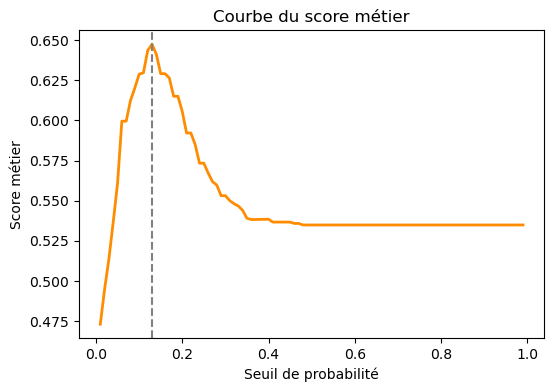

Seuil de probalité optimal : 0.13
Score métier optimal : 0.647


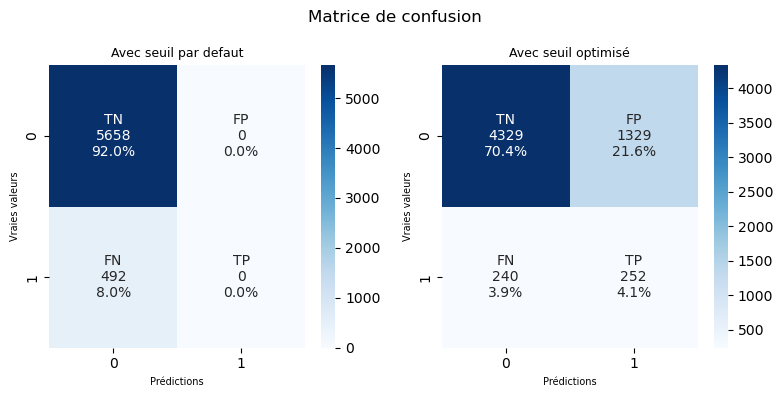

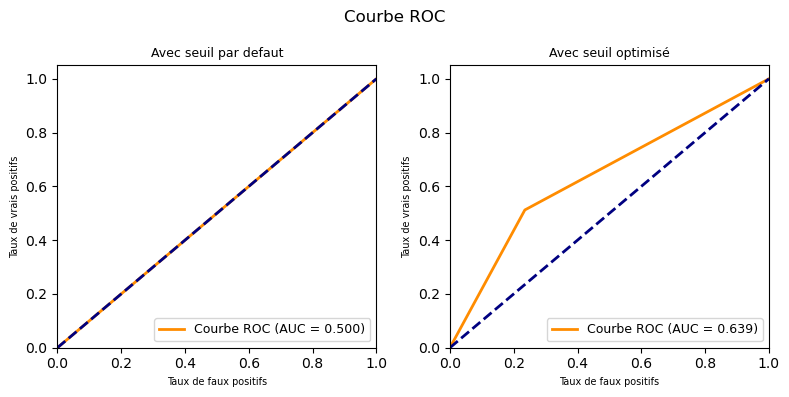

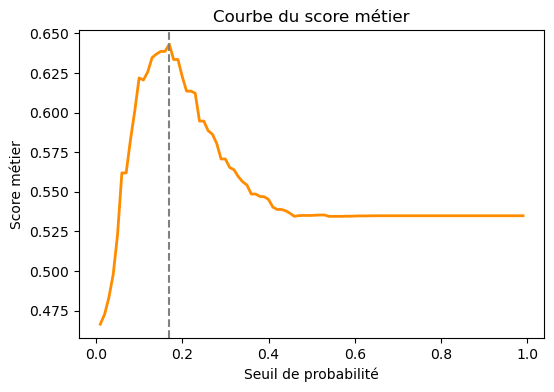

Seuil de probalité optimal : 0.17
Score métier optimal : 0.643


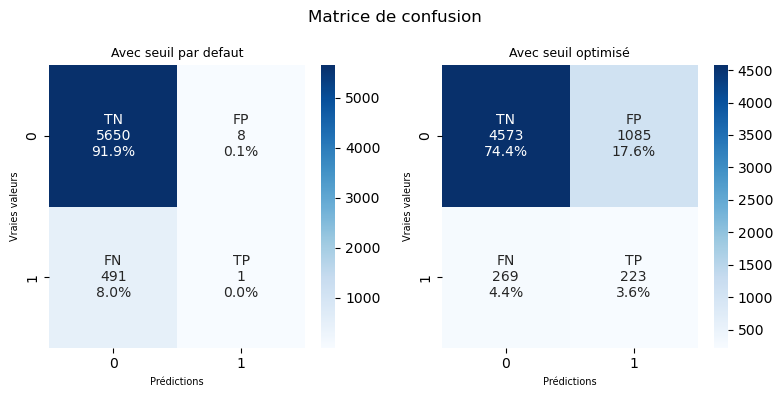

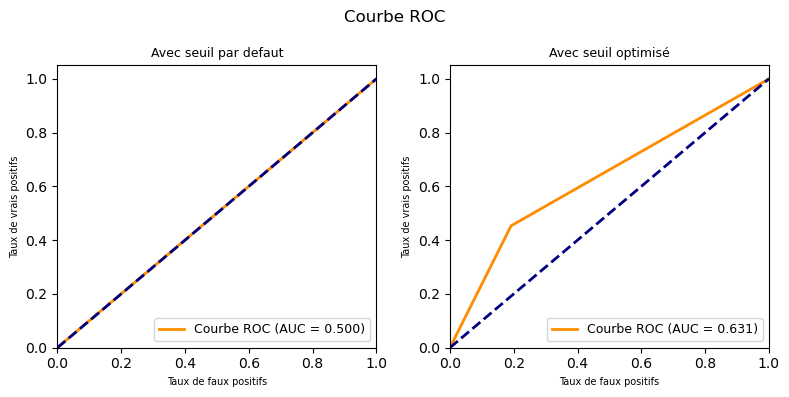

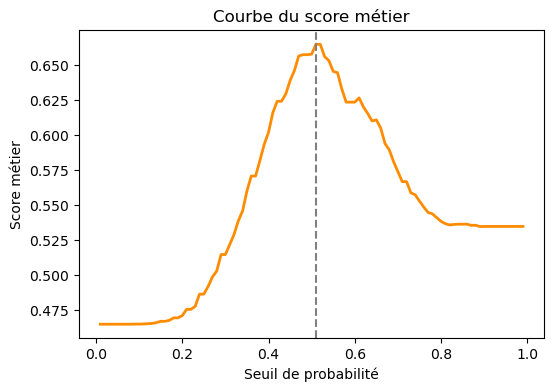

Seuil de probalité optimal : 0.51
Score métier optimal : 0.665


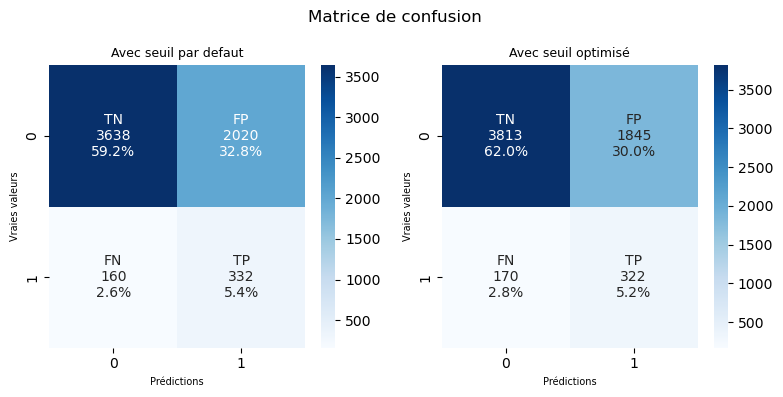

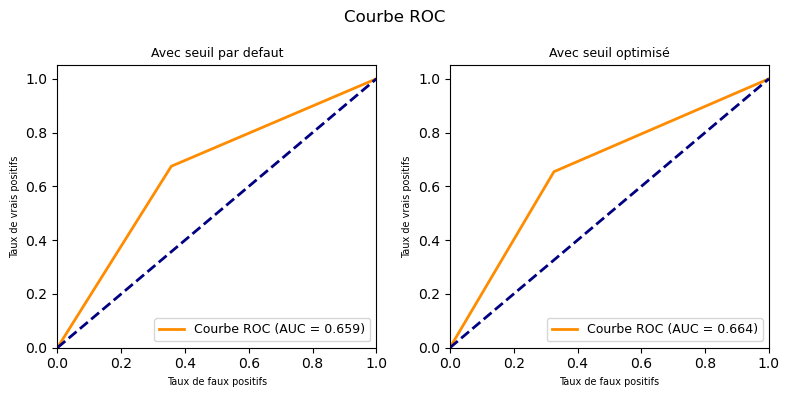

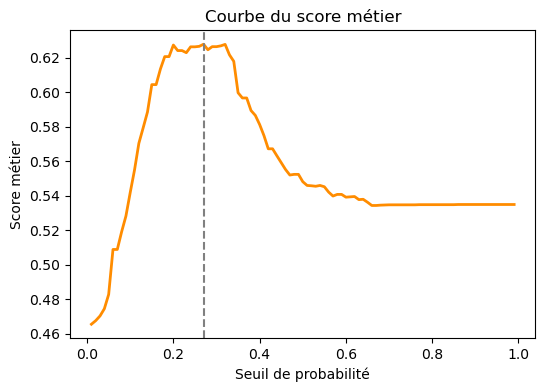

Seuil de probalité optimal : 0.27
Score métier optimal : 0.628


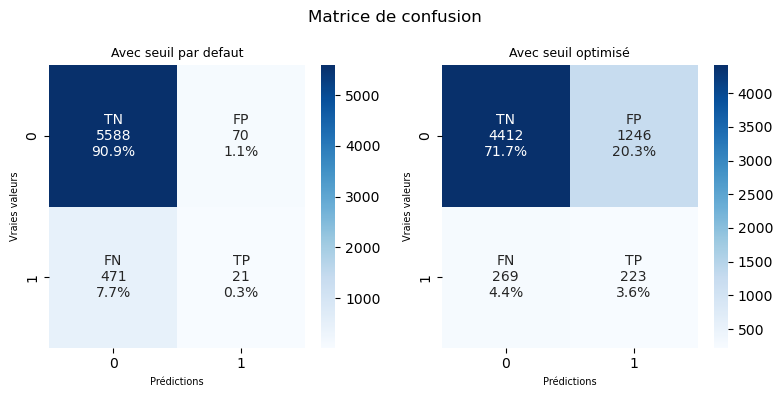

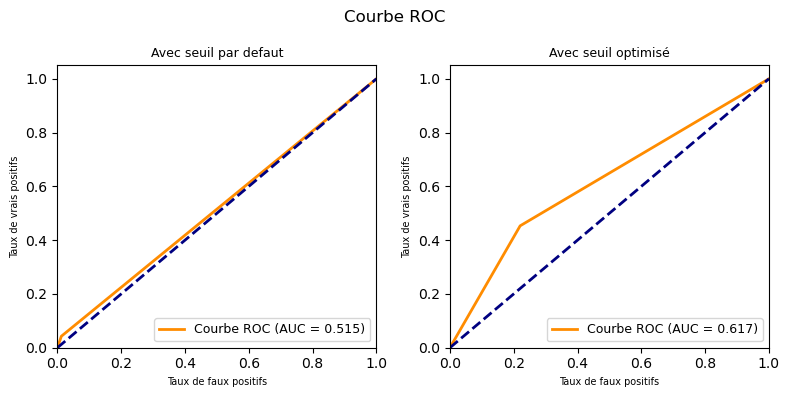

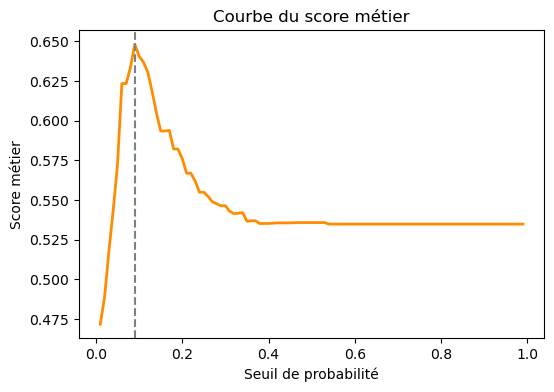

Seuil de probalité optimal : 0.09
Score métier optimal : 0.648


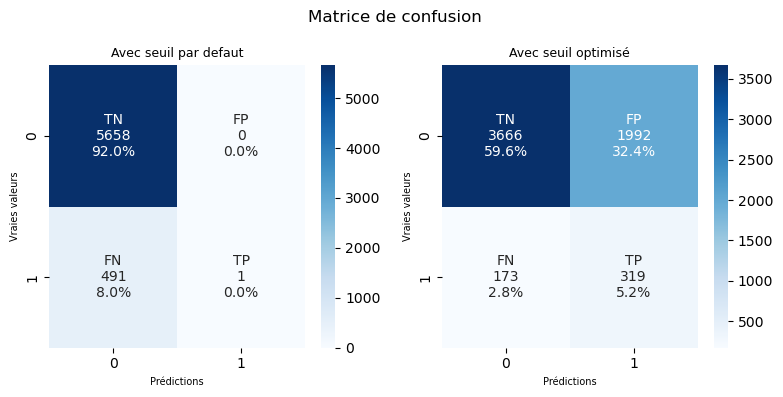

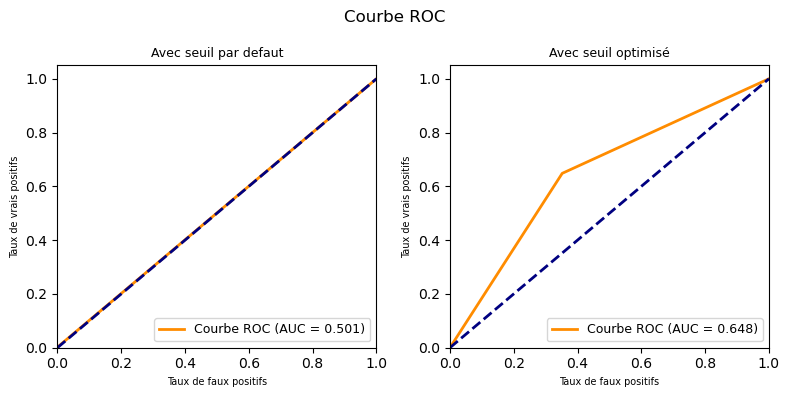

In [110]:
RFClm = Pipeline([
    ('scale', MinMaxScaler()),
    ('model', RandomForestClassifier())
])

# Définition du pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes
RFClm_oversampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', RandomForestClassifier())
])

RFClm_undersampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', RandomForestClassifier())
])

RFClm_smote = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', SMOTE(random_state=42)),
    ('model', RandomForestClassifier())
])

model_eval2(RFClm, 'RandomForestClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux)
model_eval2(RFClm_oversampler, 'RandomForestClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'oversampler')
model_eval2(RFClm_undersampler, 'RandomForestClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'undersample')
model_eval2(RFClm_smote, 'RandomForestClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux, 'smote')
#avec class_weight
RFClm_classweight = RandomForestClassifier()
model_eval2(RFClm_classweight, 'RandomForestClassifier', 'MinMaxScaler', X_train_scaled, y_train, X_test_scaled, y_test,  perf_tableaux,'class_weight')

In [111]:
perf_tableaux.loc[perf_tableaux["Normalisation"]=="MinMaxScaler"]

,Model,Normalisation,Target Balanced,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
25,DummyClassifier,MinMaxScaler,None,None,None,0.01,0.522,0.492,0.851,0.065,0.065,0 days 00:00:00.231298
26,DummyClassifier,MinMaxScaler,oversampler,None,None,0.01,0.519,0.520,0.510,0.086,0.533,0 days 00:00:00.520862
27,DummyClassifier,MinMaxScaler,undersampler,None,None,0.01,0.499,0.499,0.499,0.080,0.498,0 days 00:00:00.256759
28,DummyClassifier,MinMaxScaler,smote,None,None,0.01,0.522,0.524,0.507,0.087,0.543,0 days 00:00:00.744119
29,DummyClassifier,MinMaxScaler,class_weight,None,None,0.01,0.487,0.486,0.498,0.076,0.472,0 days 00:00:00.025464
30,LogisticRegression,MinMaxScaler,None,None,None,0.10,0.683,0.676,0.750,0.178,0.589,0 days 00:00:01.956843
31,LogisticRegression,MinMaxScaler,oversampler,None,None,0.52,0.675,0.671,0.718,0.164,0.616,0 days 00:00:03.587753
32,LogisticRegression,MinMaxScaler,undersampler,None,None,0.57,0.670,0.663,0.742,0.169,0.569,0 days 00:00:00.457806
33,LogisticRegression,MinMaxScaler,smote,None,None,0.44,0.651,0.649,0.668,0.142,0.626,0 days 00:00:04.029276
34,LogisticRegression,MinMaxScaler,class_weight,None,None,0.50,0.677,0.676,0.697,0.159,0.650,0 days 00:00:01.801221


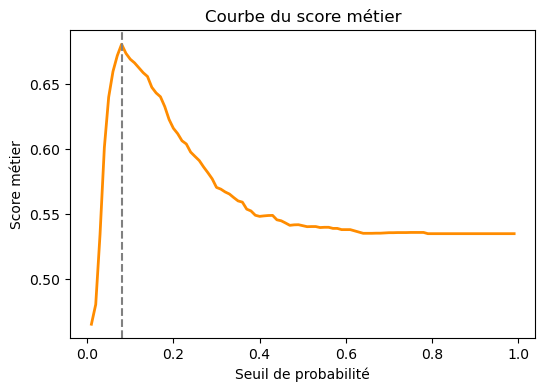

Seuil de probalité optimal : 0.08
Score métier optimal : 0.681


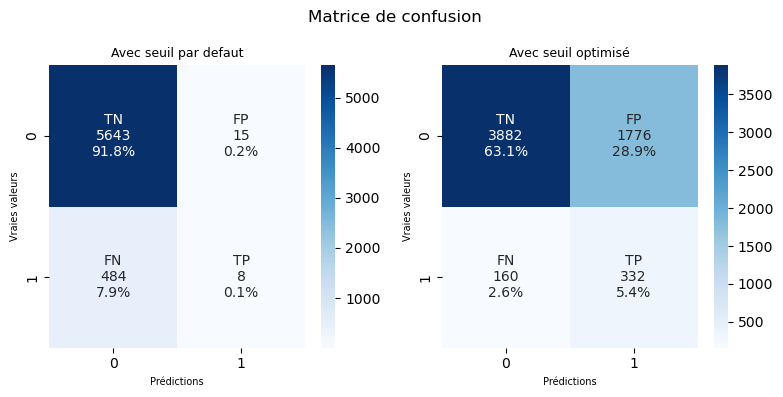

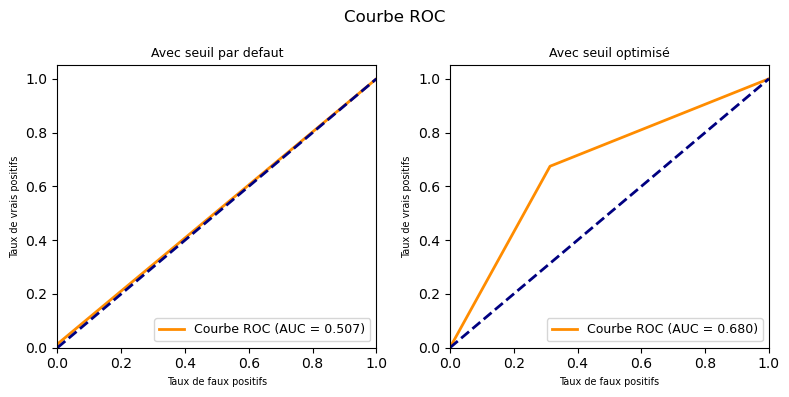

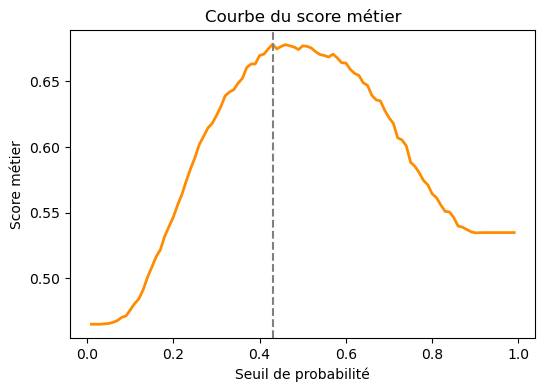

Seuil de probalité optimal : 0.43
Score métier optimal : 0.678


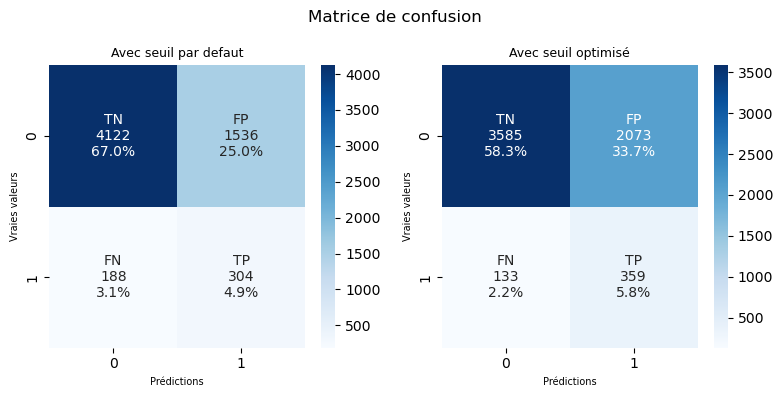

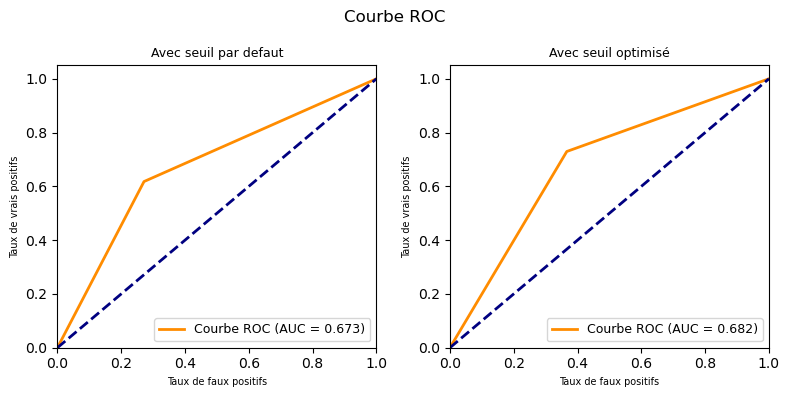

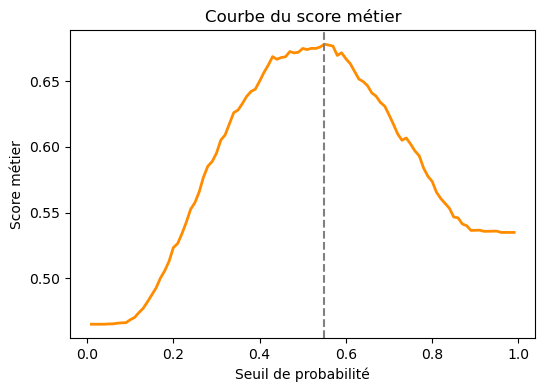

Seuil de probalité optimal : 0.55
Score métier optimal : 0.678


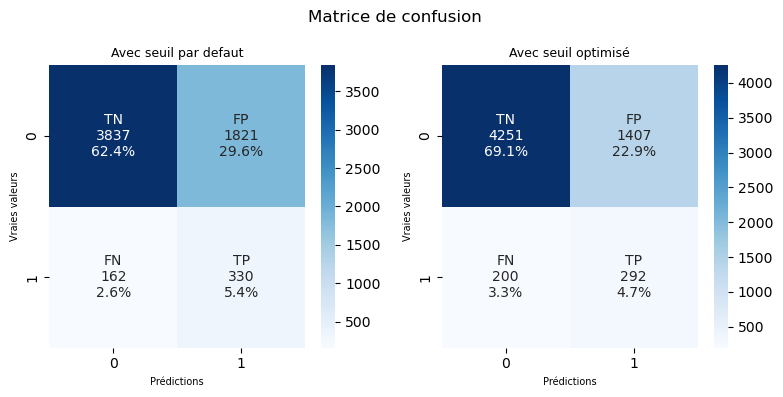

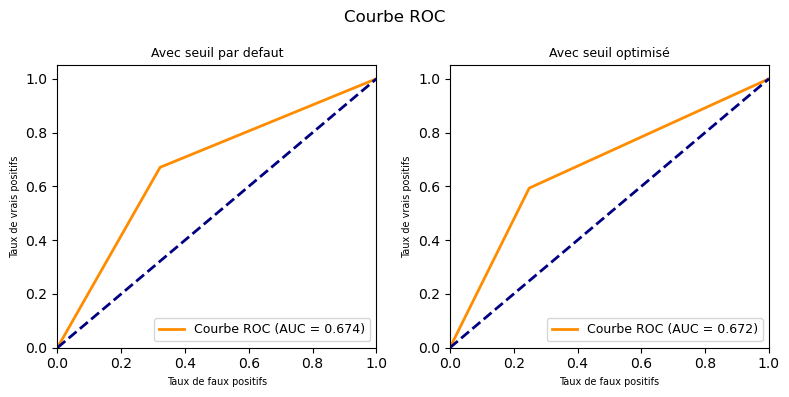

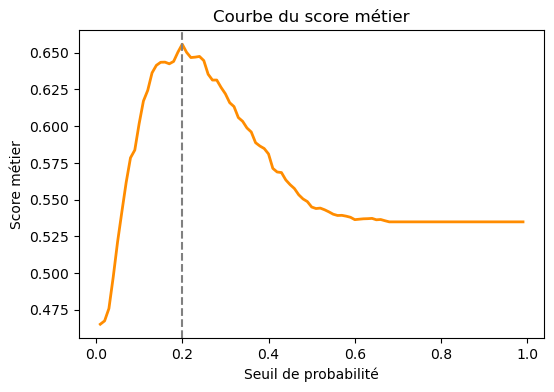

Seuil de probalité optimal : 0.2
Score métier optimal : 0.656


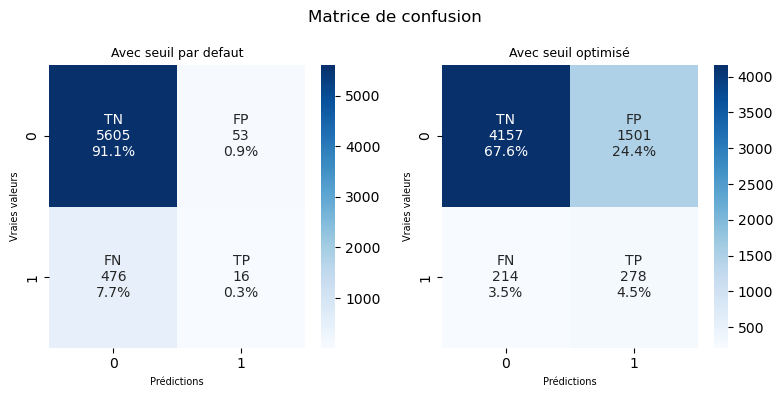

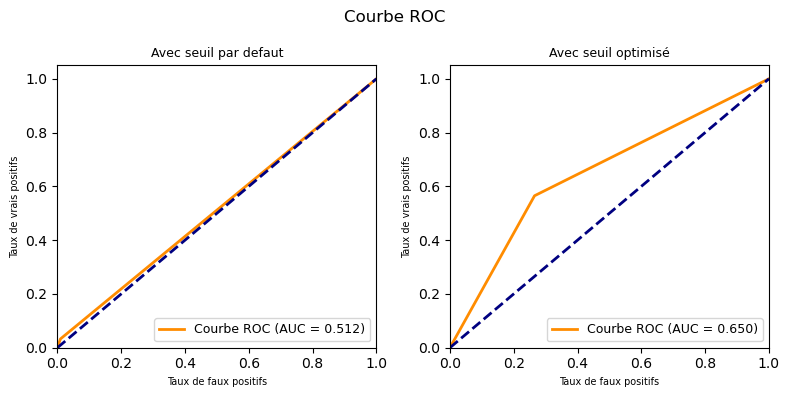

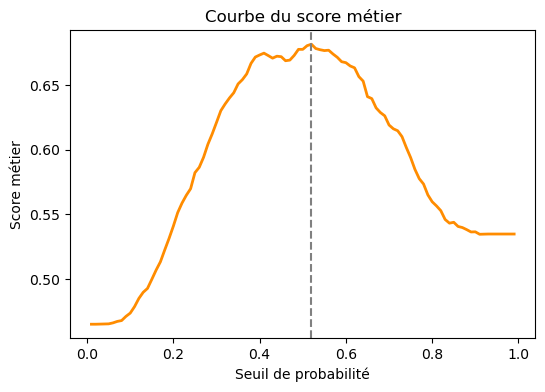

Seuil de probalité optimal : 0.52
Score métier optimal : 0.682


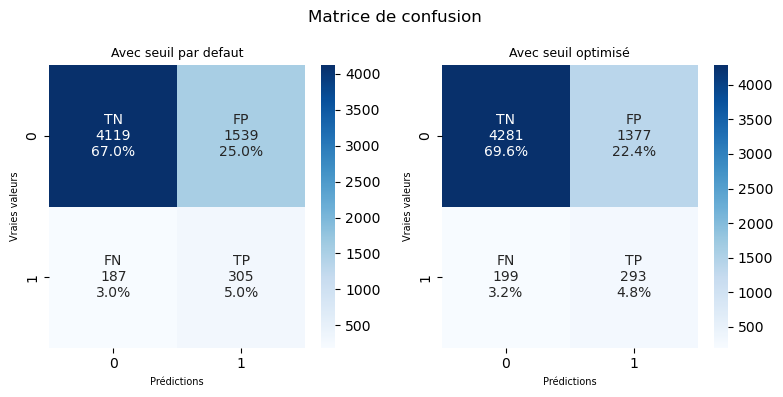

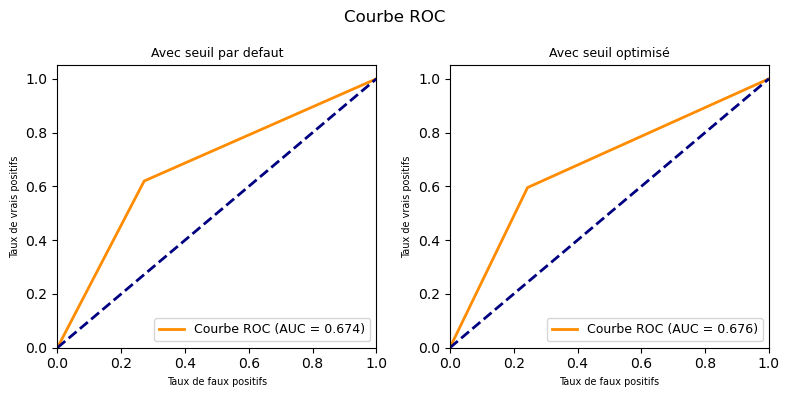

In [238]:
GBClm = Pipeline([
    ('scale', MinMaxScaler()),
    ('model', GradientBoostingClassifier())
])

# Définition du pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes
GBClm_oversampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', GradientBoostingClassifier())
])

GBClm_undersampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', GradientBoostingClassifier())
])

GBClm_smote = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', SMOTE(random_state=42)),
    ('model', GradientBoostingClassifier())
])

model_eval2(GBClm, 'GradientBoostingClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux)
model_eval2(GBClm_oversampler, 'GradientBoostingClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux,'oversampler')
model_eval2(GBClm_undersampler, 'GradientBoostingClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux,'undersampler')
model_eval2(GBClm_smote, 'GradientBoostingClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux,'smote')
#avec class_weight
GBClm_classweight = GradientBoostingClassifier()
model_eval2(GBClm_classweight, 'GradientBoostingClassifier', 'MinMaxScaler', X_train_scaled, y_train, X_test_scaled, y_test,  perf_tableaux,'class_weight')

In [239]:
perf_tableaux.loc[perf_tableaux["Normalisation"]=="MinMaxScaler"]

,Model,Normalisation,Target Balanced,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
35,DummyClassifier,MinMaxScaler,None,None,None,0.01,0.528,0.498,0.853,0.076,0.075,0 days 00:00:00.252086
36,DummyClassifier,MinMaxScaler,oversampler,None,None,0.01,0.500,0.500,0.505,0.080,0.494,0 days 00:00:00.587946
37,DummyClassifier,MinMaxScaler,undersampler,None,None,0.01,0.515,0.517,0.495,0.085,0.543,0 days 00:00:00.320129
38,DummyClassifier,MinMaxScaler,smote,None,None,0.01,0.495,0.495,0.498,0.079,0.492,0 days 00:00:00.710125
39,DummyClassifier,MinMaxScaler,class_weight,None,None,0.01,0.504,0.505,0.498,0.081,0.512,0 days 00:00:00.011280
40,LogisticRegression,MinMaxScaler,None,None,None,0.10,0.683,0.676,0.750,0.178,0.589,0 days 00:00:02.170956
41,LogisticRegression,MinMaxScaler,oversampler,None,None,0.52,0.675,0.671,0.718,0.164,0.616,0 days 00:00:03.708605
42,LogisticRegression,MinMaxScaler,undersampler,None,None,0.57,0.670,0.663,0.742,0.169,0.569,0 days 00:00:00.650780
43,LogisticRegression,MinMaxScaler,smote,None,None,0.44,0.651,0.649,0.668,0.142,0.626,0 days 00:00:03.804293
44,LogisticRegression,MinMaxScaler,class_weight,None,None,0.50,0.677,0.676,0.697,0.159,0.650,0 days 00:00:01.816494


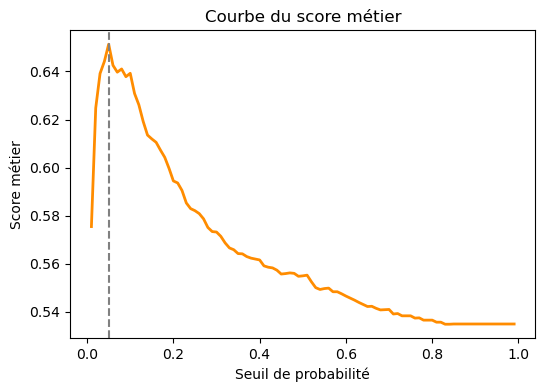

Seuil de probalité optimal : 0.05
Score métier optimal : 0.651


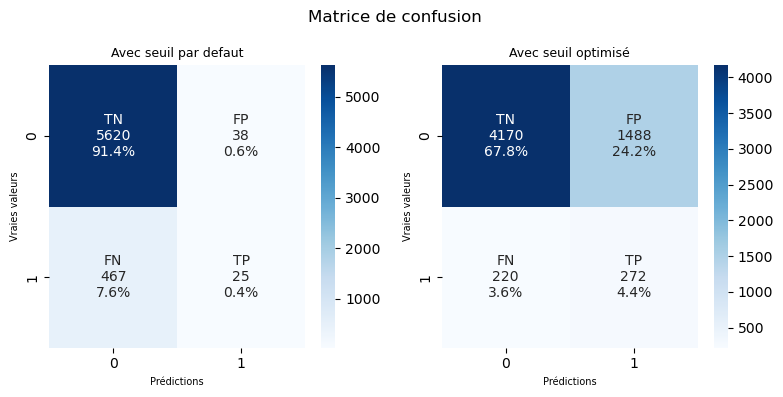

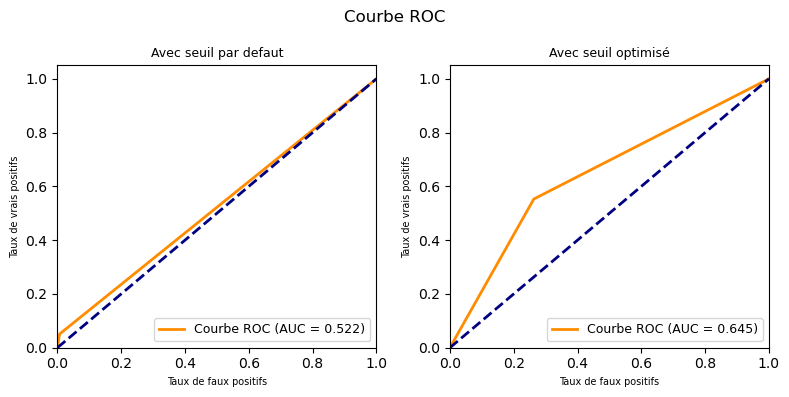

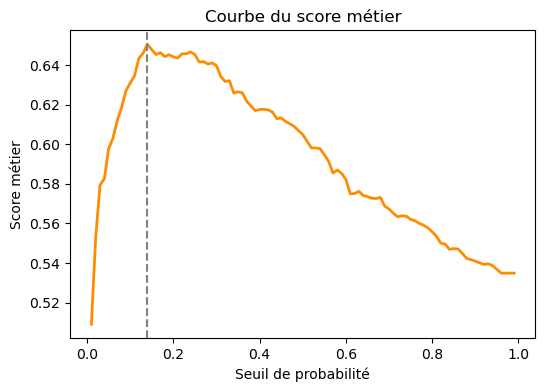

Seuil de probalité optimal : 0.14
Score métier optimal : 0.651


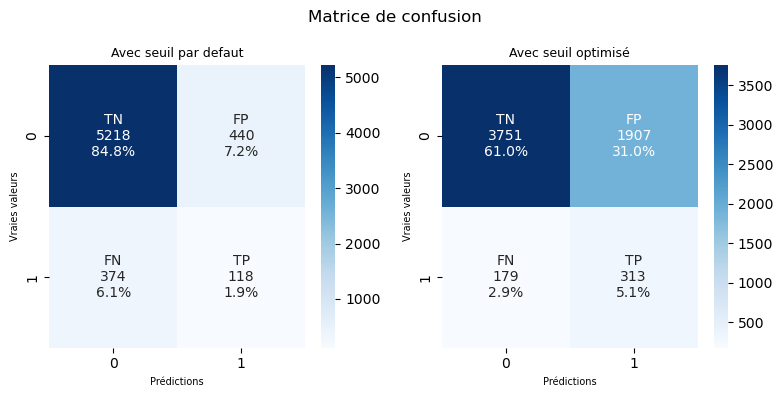

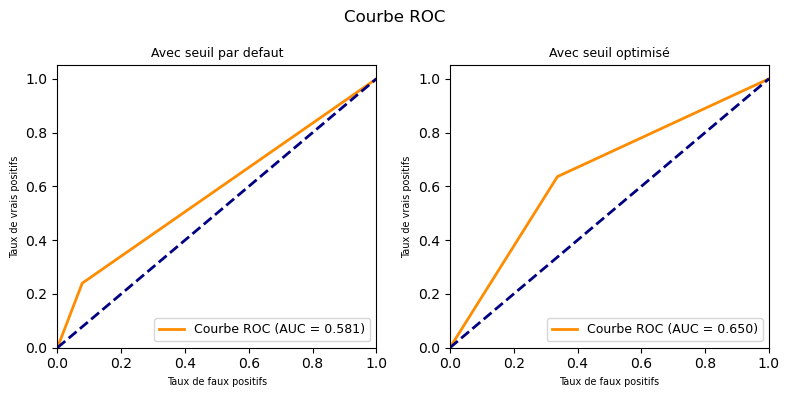

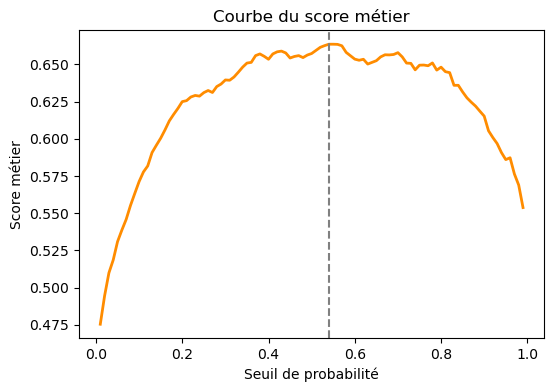

Seuil de probalité optimal : 0.54
Score métier optimal : 0.664


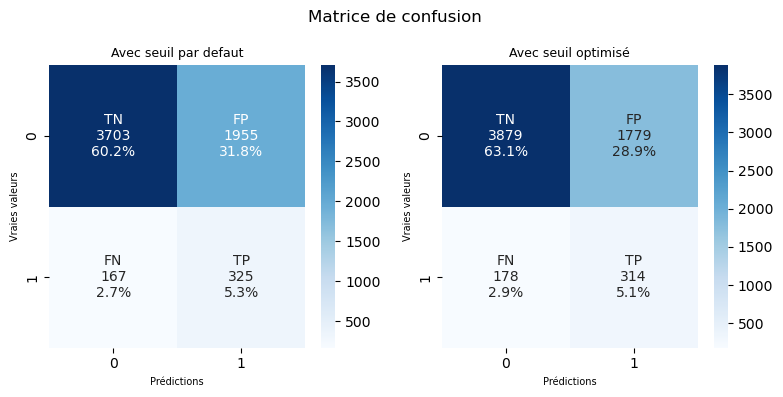

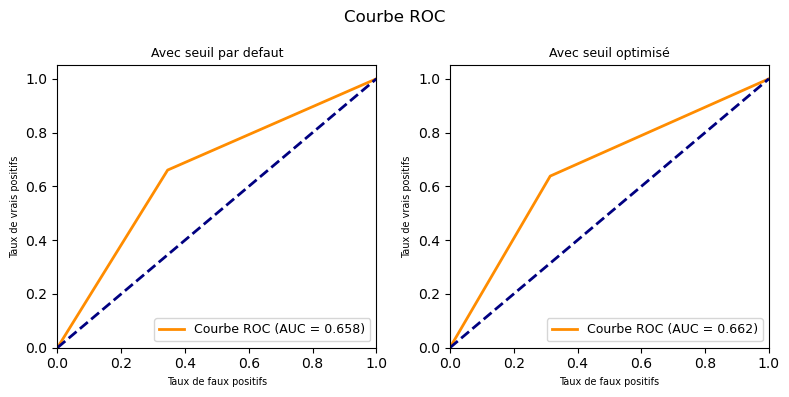

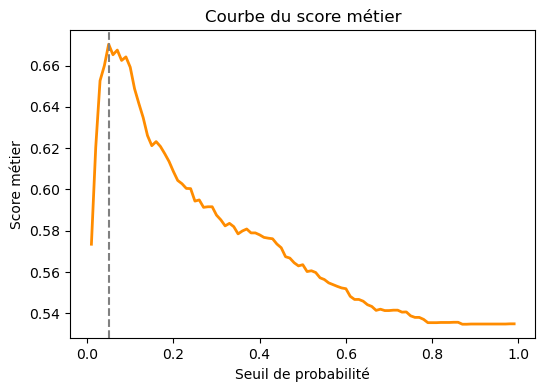

Seuil de probalité optimal : 0.05
Score métier optimal : 0.67


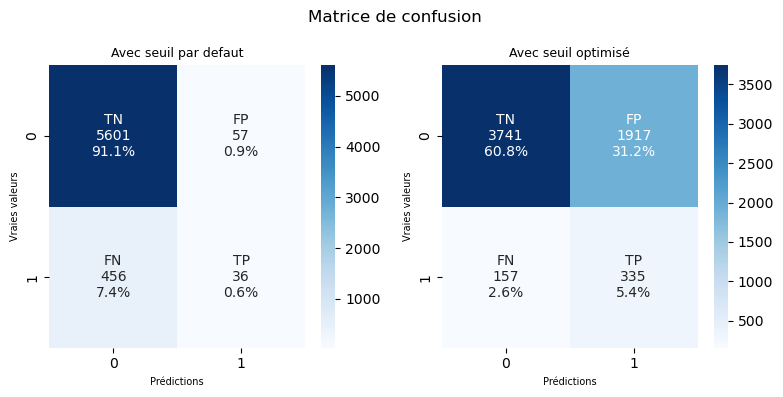

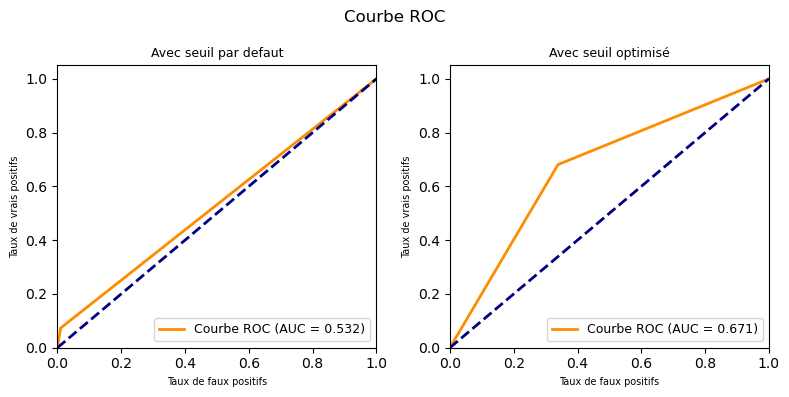

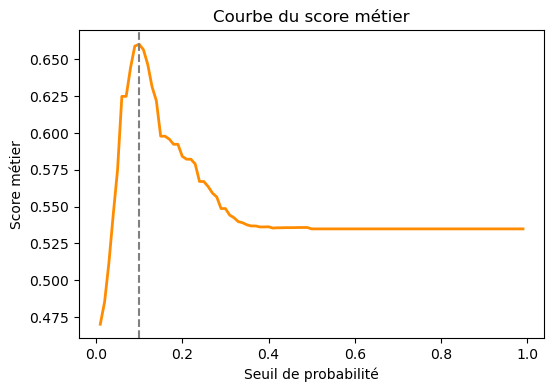

Seuil de probalité optimal : 0.1
Score métier optimal : 0.66


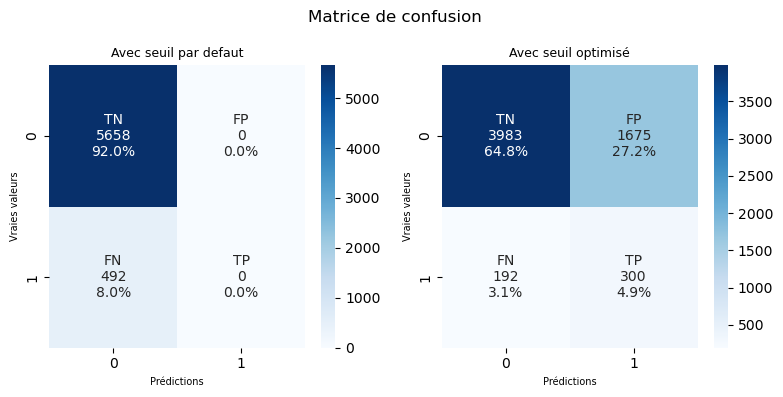

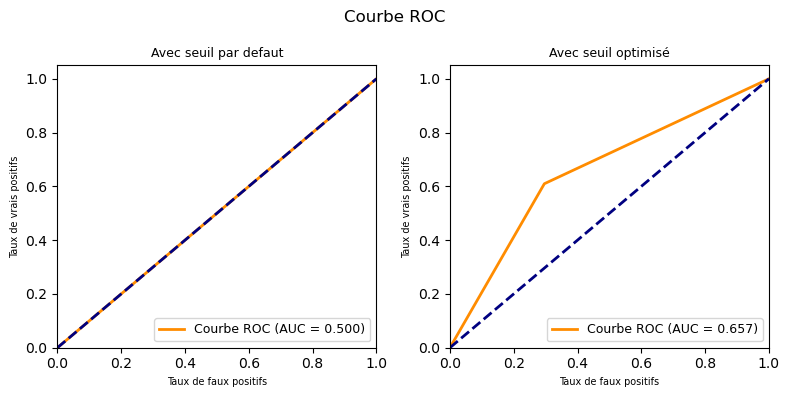

In [114]:
XGBClm = Pipeline([
    ('scale', MinMaxScaler()),
     ('model', XGBClassifier())
])

# Définition du pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes
XGBClm_oversampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', XGBClassifier())
])

XGBClm_undersampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', XGBClassifier())
])

XGBClm_smote = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', SMOTE(random_state=42)),
    ('model', XGBClassifier())
])

model_eval2(XGBClm, 'XGBClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux)
model_eval2(XGBClm_oversampler, 'XGBClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux,'oversampler')
model_eval2(XGBClm_undersampler, 'XGBClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux,'undersampler')
model_eval2(XGBClm_smote, 'XGBClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux,'smote')
#avec class_weight
XGBClm_classweight = XGBClassifier()
model_eval2(RFClm_classweight, 'XGBClassifier', 'MinMaxScaler', X_train_scaled, y_train, X_test_scaled, y_test,  perf_tableaux,'class_weight')

In [115]:
perf_tableaux.loc[perf_tableaux["Normalisation"]=="MinMaxScaler"]

,Model,Normalisation,Target Balanced,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
25,DummyClassifier,MinMaxScaler,None,None,None,0.01,0.522,0.492,0.851,0.065,0.065,0 days 00:00:00.231298
26,DummyClassifier,MinMaxScaler,oversampler,None,None,0.01,0.519,0.520,0.510,0.086,0.533,0 days 00:00:00.520862
27,DummyClassifier,MinMaxScaler,undersampler,None,None,0.01,0.499,0.499,0.499,0.080,0.498,0 days 00:00:00.256759
28,DummyClassifier,MinMaxScaler,smote,None,None,0.01,0.522,0.524,0.507,0.087,0.543,0 days 00:00:00.744119
29,DummyClassifier,MinMaxScaler,class_weight,None,None,0.01,0.487,0.486,0.498,0.076,0.472,0 days 00:00:00.025464
30,LogisticRegression,MinMaxScaler,None,None,None,0.10,0.683,0.676,0.750,0.178,0.589,0 days 00:00:01.956843
31,LogisticRegression,MinMaxScaler,oversampler,None,None,0.52,0.675,0.671,0.718,0.164,0.616,0 days 00:00:03.587753
32,LogisticRegression,MinMaxScaler,undersampler,None,None,0.57,0.670,0.663,0.742,0.169,0.569,0 days 00:00:00.457806
33,LogisticRegression,MinMaxScaler,smote,None,None,0.44,0.651,0.649,0.668,0.142,0.626,0 days 00:00:04.029276
34,LogisticRegression,MinMaxScaler,class_weight,None,None,0.50,0.677,0.676,0.697,0.159,0.650,0 days 00:00:01.801221


[LightGBM] [Info] Number of positive: 2040, number of negative: 22560
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.033514 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 55256
[LightGBM] [Info] Number of data points in the train set: 24600, number of used features: 531
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.082927 -> initscore=-2.403229
[LightGBM] [Info] Start training from score -2.403229


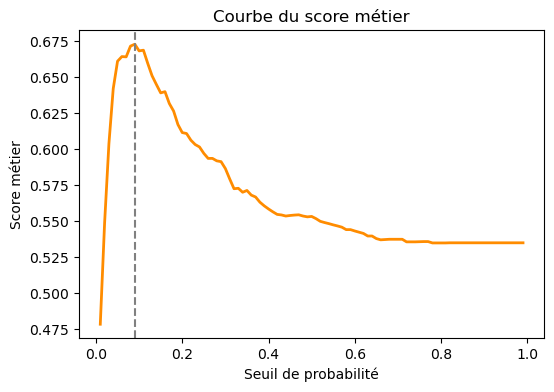

Seuil de probalité optimal : 0.09
Score métier optimal : 0.673


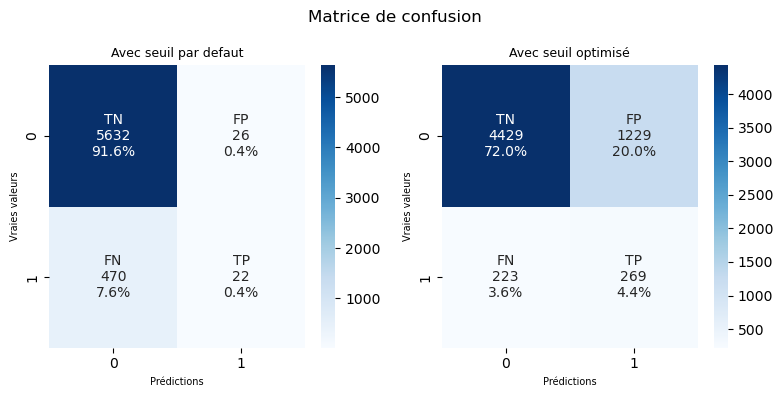

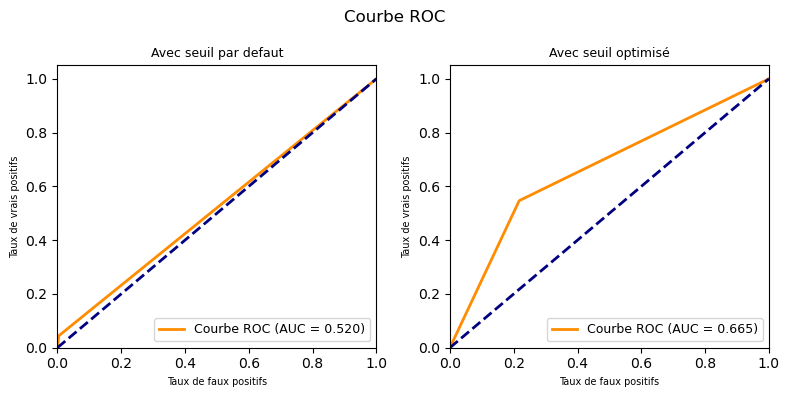

[LightGBM] [Info] Number of positive: 22560, number of negative: 22560
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.079005 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 56143
[LightGBM] [Info] Number of data points in the train set: 45120, number of used features: 542
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000


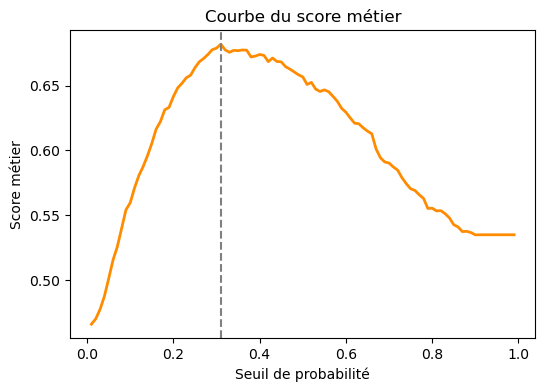

Seuil de probalité optimal : 0.31
Score métier optimal : 0.682


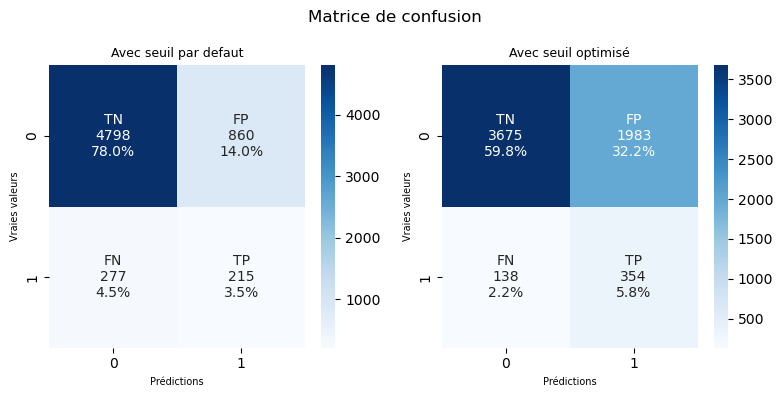

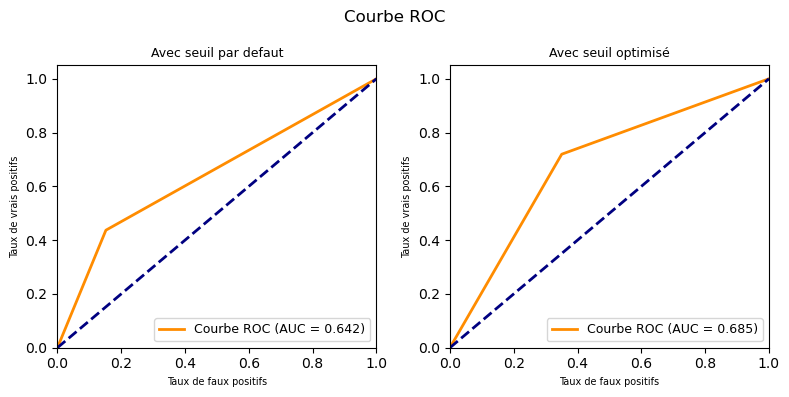

[LightGBM] [Info] Number of positive: 2040, number of negative: 2040
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007982 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 44518
[LightGBM] [Info] Number of data points in the train set: 4080, number of used features: 466
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000


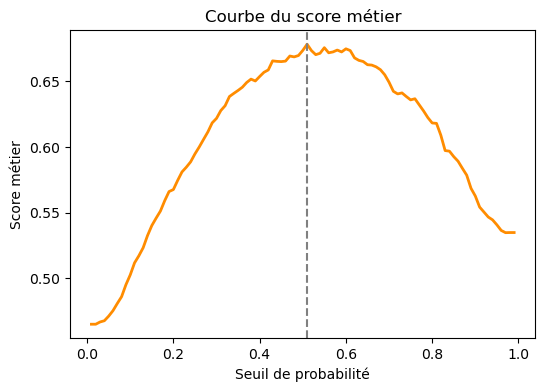

Seuil de probalité optimal : 0.51
Score métier optimal : 0.678


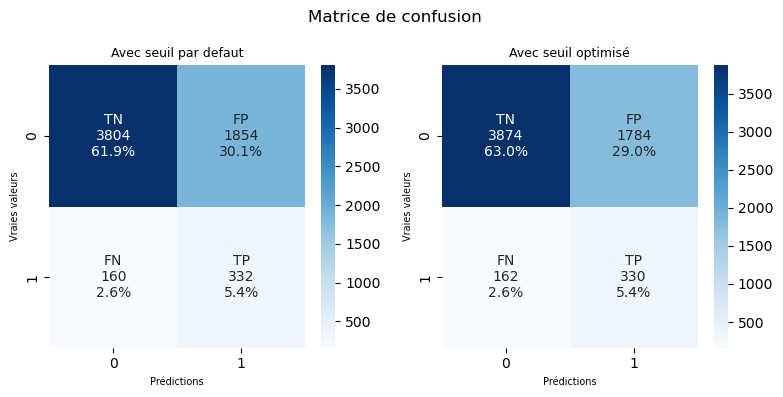

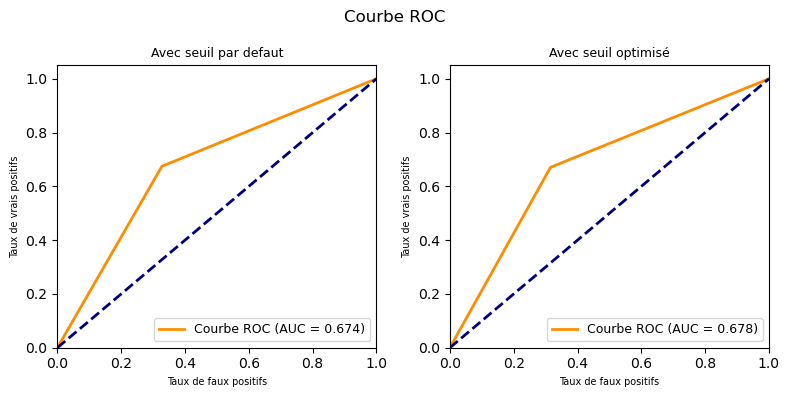

[LightGBM] [Info] Number of positive: 22560, number of negative: 22560
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.108132 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 114684
[LightGBM] [Info] Number of data points in the train set: 45120, number of used features: 542
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000


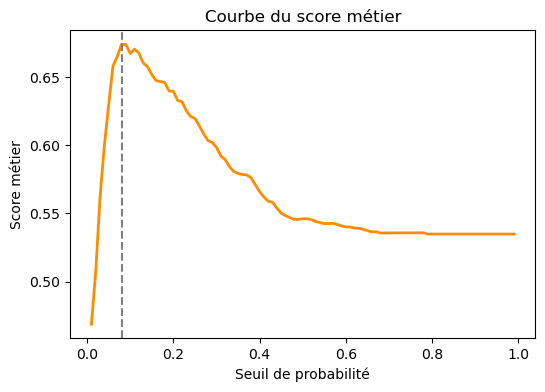

Seuil de probalité optimal : 0.08
Score métier optimal : 0.674


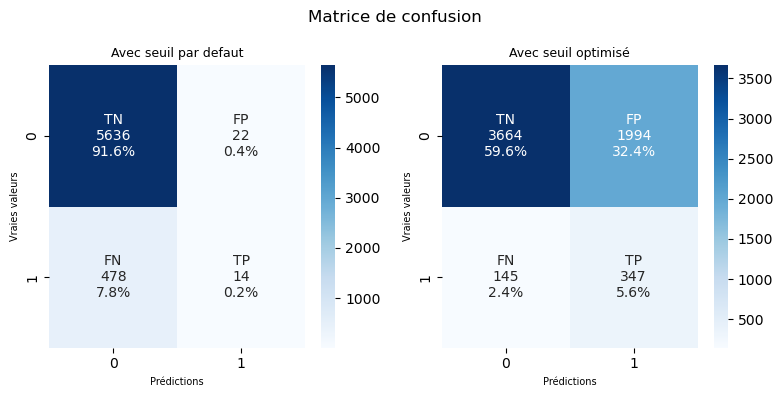

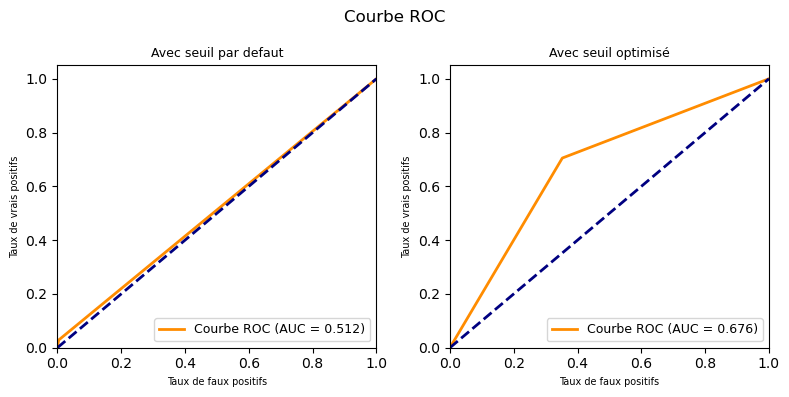

[LightGBM] [Info] Number of positive: 2040, number of negative: 22560
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.048506 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 55256
[LightGBM] [Info] Number of data points in the train set: 24600, number of used features: 531
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Start training from score 0.000000


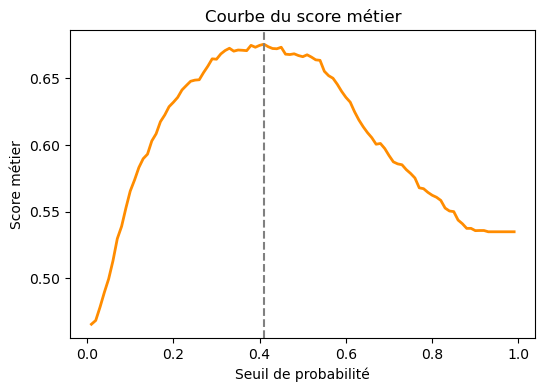

Seuil de probalité optimal : 0.41
Score métier optimal : 0.676


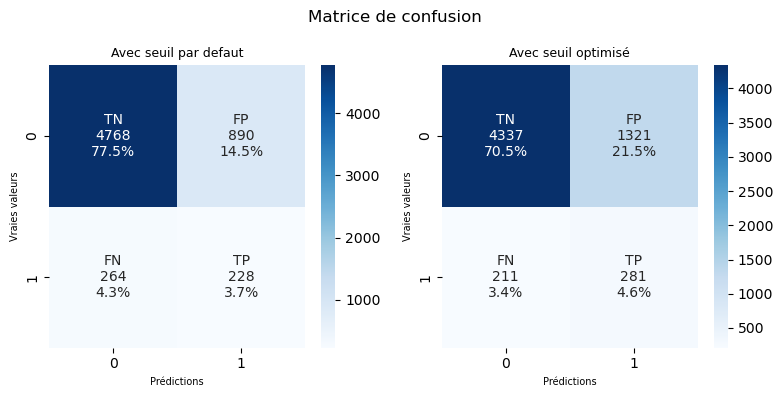

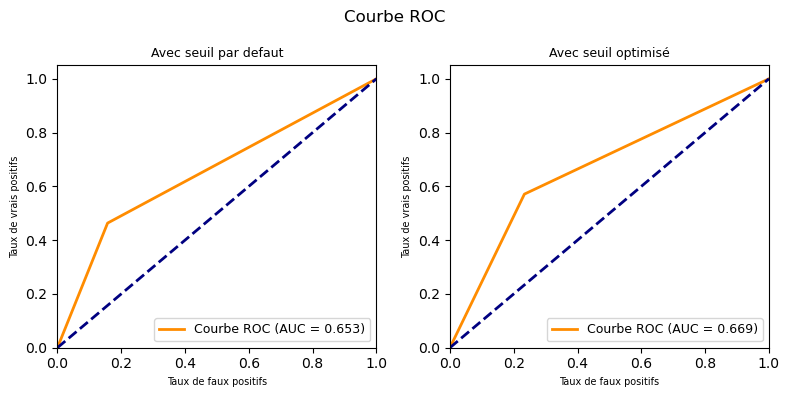

In [116]:
LGBMClm = Pipeline([
    ('scale', MinMaxScaler()),
     ('model', LGBMClassifier())
])

# Définition du pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes
LGBMClm_oversampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', LGBMClassifier())
])

LGBMClm_undersampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', LGBMClassifier())
])

LGBMClm_smote = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', SMOTE(random_state=42)),
    ('model', LGBMClassifier())
])

model_eval2(LGBMClm, 'LGBMClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux)
model_eval2(LGBMClm_oversampler, 'LGBMClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux,'oversampler')
model_eval2(LGBMClm_undersampler, 'LGBMClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux,'undersampler')
model_eval2(LGBMClm_smote, 'LGBMClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux,'smote')
#avec class_weight
LGBMClm_classweight = LGBMClassifier()
model_eval2(LGBMClm_classweight, 'LGBMClassifier', 'MinMaxScaler', X_train_scaled, y_train, X_test_scaled, y_test,  perf_tableaux,'class_weight')

In [144]:
perf_tab = perf_tableaux.loc[((perf_tableaux["Target Balanced"] == 'oversampler') | (perf_tableaux["Target Balanced"] == 'undersampler')  | (perf_tableaux["Target Balanced"] == 'smote') | (perf_tableaux["Target Balanced"] == 'class_weight')) & (perf_tableaux["Model"] != 'GradientBoostingClassifier')]
perf_tab.sort_values(by = 'Score Metier', ascending = False).head(40)

,Model,Normalisation,Target Balanced,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
51,LGBMClassifier,MinMaxScaler,oversampler,None,None,0.31,0.682,0.685,0.655,0.151,0.720,0 days 00:00:03.289847
24,LGBMClassifier,StandardScaler,class_weight,None,None,0.42,0.679,0.672,0.755,0.179,0.573,0 days 00:00:02.601965
22,LGBMClassifier,StandardScaler,undersampler,None,None,0.51,0.678,0.677,0.685,0.156,0.669,0 days 00:00:01.550743
52,LGBMClassifier,MinMaxScaler,undersampler,None,None,0.51,0.678,0.678,0.684,0.156,0.671,0 days 00:00:01.010059
34,LogisticRegression,MinMaxScaler,class_weight,None,None,0.50,0.677,0.676,0.697,0.159,0.650,0 days 00:00:01.801221
23,LGBMClassifier,StandardScaler,smote,None,None,0.09,0.676,0.674,0.705,0.161,0.636,0 days 00:00:05.801953
54,LGBMClassifier,MinMaxScaler,class_weight,None,None,0.41,0.676,0.669,0.751,0.175,0.571,0 days 00:00:03.325194
31,LogisticRegression,MinMaxScaler,oversampler,None,None,0.52,0.675,0.671,0.718,0.164,0.616,0 days 00:00:03.587753
21,LGBMClassifier,StandardScaler,oversampler,None,None,0.42,0.674,0.667,0.756,0.177,0.561,0 days 00:00:04.184982
53,LGBMClassifier,MinMaxScaler,smote,None,None,0.08,0.674,0.676,0.652,0.148,0.705,0 days 00:00:06.771882


Classement des modèles avec le meilleur score métier obtenu sur un echantillon de 10% :
1. LGBMClassifier + MinMaxScaler + oversampler (0.682)
2. LogisticRegression + MinMaxScaler + class_weight (0.677)
3. XGBClassifier + MinMaxScaler + smote (0.670)
4. RandomForestClassifier + StandardScaler + undersampler (0.649)
5. DecisionTreeClassifier + MinMaxScaler + undersampler (0.576)
6. DummyClassifier + MinMaxScaler + smote (0.522)

In [462]:
# Initialisation de MLflow
mlflow.set_tracking_uri(uri="http://127.0.0.1:5000")
mlflow.set_experiment("Simulations de modèles par defaut sur 10% données")
with mlflow.start_run(run_name="LGBMClassifier"):
     #Enregistrement de plusieurs paramètres sous forme d'un dictionnaire
    params = {}
    params['MODELE'] = 'LGBMClassifier'
    params['NORMALISATION'] = 'MinMaxScaler'
    params['EQUILIBRAGE'] = 'Oversampler'
    params['BEST_SEUIL'] = '0.31'
    params['ECHANTILLON'] = '10%'
    mlflow.log_params(params)

    #Enregistrement de plusieurs métriques sous forme d'un dictionnaire
    metrics = {}
    metrics['Score_Metier'] =  0.682
    metrics['ROC_AUC'] =0.685
    metrics['Accuracy'] = 0.655
    metrics['Time_Fit_sec'] = 3
    mlflow.log_metrics(metrics)

with mlflow.start_run(run_name="LogisticRegression"):
     #Enregistrement de plusieurs paramètres sous forme d'un dictionnaire
    params = {}
    params['MODELE'] = 'LogisticRegression'
    params['NORMALISATION'] = 'MinMaxScaler'
    params['EQUILIBRAGE'] = 'Class_weight'
    params['BEST_SEUIL'] = '0.50'
    params['ECHANTILLON'] = '10%'
    mlflow.log_params(params)

    #Enregistrement de plusieurs métriques sous forme d'un dictionnaire
    metrics = {}
    metrics['Score_Metier'] =  0.677
    metrics['ROC_AUC'] = 0.676
    metrics['Accuracy'] = 0.697	
    metrics['Time_Fit_sec'] = 2
    mlflow.log_metrics(metrics)

with mlflow.start_run(run_name="XGBClassifier"):
     #Enregistrement de plusieurs paramètres sous forme d'un dictionnaire
    params = {}
    params['MODELE'] = 'XGBClassifier'
    params['NORMALISATION'] = 'MinMaxScaler'
    params['EQUILIBRAGE'] = 'Smote'
    params['BEST_SEUIL'] = '0.05'
    params['ECHANTILLON'] = '10%'
    mlflow.log_params(params)

    #Enregistrement de plusieurs métriques sous forme d'un dictionnaire
    metrics = {}
    metrics['Score_Metier'] =  0.670
    metrics['ROC_AUC'] = 0.671
    metrics['Accuracy'] = 0.663
    metrics['Time_Fit_sec'] = 11
    mlflow.log_metrics(metrics)

with mlflow.start_run(run_name="RandomForestClassifier"):
    #Enregistrement de plusieurs paramètres sous forme d'un dictionnaire
    params = {}
    params['MODELE'] = 'RandomForestClassifier'
    params['NORMALISATION'] = 'StandardScaler'
    params['EQUILIBRAGE'] = 'Undersampler'
    params['BEST_SEUIL'] = '0.48'
    params['ECHANTILLON'] = '10%'
    mlflow.log_params(params)

    #Enregistrement de plusieurs métriques sous forme d'un dictionnaire
    metrics = {}
    metrics['Score_Metier'] =  0.649
    metrics['ROC_AUC'] = 0.651
    metrics['Accuracy'] = 0.624
    metrics['Time_Fit_sec'] = 3
    mlflow.log_metrics(metrics)
    
with mlflow.start_run(run_name="DecisionTreeClassifier"):
    #Enregistrement de plusieurs paramètres sous forme d'un dictionnaire
    params = {}
    params['MODELE'] = 'DecisionTreeClassifier'
    params['NORMALISATION'] = 'MinMaxScaler'
    params['EQUILIBRAGE'] = 'Undersampler'
    params['BEST_SEUIL'] = '0.01'
    params['ECHANTILLON'] = '10%'
    mlflow.log_params(params)

    #Enregistrement de plusieurs métriques sous forme d'un dictionnaire
    metrics = {}
    metrics['Score_Metier'] =  0.576
    metrics['ROC_AUC'] = 0.577
    metrics['Accuracy'] = 0.573
    metrics['Time_Fit_sec'] = 1
    mlflow.log_metrics(metrics)

with mlflow.start_run(run_name="DummyClassifier"):
    #Enregistrement de plusieurs paramètres sous forme d'un dictionnaire
    params = {}
    params['MODELE'] = 'DummyClassifier'
    params['NORMALISATION'] = 'MinMaxScaler'
    params['EQUILIBRAGE'] = 'Smote'
    params['BEST_SEUIL'] = '0.01'
    params['ECHANTILLON'] = '10%'
    mlflow.log_params(params)

    #Enregistrement de plusieurs métriques sous forme d'un dictionnaire
    metrics = {}
    metrics['Score_Metier'] =  0.522
    metrics['ROC_AUC'] = 0.524
    metrics['Accuracy'] = 0.507
    metrics['Time_Fit_sec'] = 1
    mlflow.log_metrics(metrics)

🏃 View run LGBMClassifier at: http://127.0.0.1:5000/#/experiments/758037175854948991/runs/516c3f7a6a73496888aaa2f681fc9438
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/758037175854948991
🏃 View run LogisticRegression at: http://127.0.0.1:5000/#/experiments/758037175854948991/runs/b393f807d27b4df98c329ce19017f85b
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/758037175854948991
🏃 View run XGBClassifier at: http://127.0.0.1:5000/#/experiments/758037175854948991/runs/f13e3085ec8c445daf8aa12007c455e3
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/758037175854948991
🏃 View run RandomForestClassifier at: http://127.0.0.1:5000/#/experiments/758037175854948991/runs/cd7ecd0284104a918e7143349a587600
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/758037175854948991
🏃 View run DecisionTreeClassifier at: http://127.0.0.1:5000/#/experiments/758037175854948991/runs/f56de07481e14ecbb5fa154a735bb8d0
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/

A partir des 3 meilleurs modèles, nous allons maintenant optimiser leurs hyperparametres sur 10% et 100% des données avec une Recherche aléatoire -> <b>RandomizedSearchCV</b> et valisation croisée (5 plis)<br>
La recherche aléatoire est que nous n’essayons pas toutes les combinaisons, mais nous sélectionnons au hasard une valeur dans la plage de possiblité des valeurs.<br><br>

Nous retiendrons le meilleur modèle pour réaliser une optimisation plus fine avec -> <b>GridSearchCV</b> avec validation croisée (5 plis)<br>
La recherche par grille est que nous essayons toutes les combinaisons dans la plage de possiblité des valeurs. Donc la recherche des hyperparametres peut etre plus longue qu'avec une recherche aléatoire.

In [85]:
##### Sépration en jeu d'entrainement / jeu de validation, 80% des données pour l'entraînement
#X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.8, random_state=42)
X_train, X_test, y_train, y_test = train_test_split(X_sample, y_sample, train_size=0.8, random_state=42)

# vérification de la taille des matrices :
print('taille X_train:', X_train.shape)
print('taille X_test:', X_test.shape)
print('taille y_train:', y_train.shape)
print('taille y_test:', y_test.shape)

taille X_train: (24600, 589)
taille X_test: (6150, 589)
taille y_train: (24600,)
taille y_test: (6150,)


In [87]:
y_train.value_counts()   

TARGET
0    22560
1     2040
Name: count, dtype: int64

#### <font color="green" size=4>6.2 Optimisation des modèles selectionnés </font><a href="#chapitre6" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_6_1"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

#### <font color="blue" size=3>6.2.1 Utilisation de RandomizedSearch </font>

<b><u>Avec 10%</u></b>

In [89]:
perf_tableaux = pd.DataFrame()
crossvalidation_tableaux = pd.DataFrame()

In [93]:
from tqdm import tqdm

def model_eval3(model, label_model, typ_norm, Xtrain, ytrain, Xval, yval, perf_tableaux, df_crossvalidation, f_echantillon, f_equilibre=None, method_opti=None):
    with mlflow.start_run(run_name=label_model):

        start_time = datetime.datetime.now()
        if (f_equilibre == 'class_weight'):
            class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(ytrain), y=ytrain)
            class_weight_dict = dict(zip(np.unique(ytrain), class_weights))
            sample_weights = np.array([class_weight_dict[i] for i in ytrain])
            #for i in tqdm(range(20), desc="Recherche des hyperparametres"):
            model.fit(Xtrain, ytrain, sample_weight=sample_weights)
        else:
            #for i in tqdm(range(20), desc="Recherche des hyperparametres"):
            model.fit(Xtrain, ytrain)
    
        end_time = datetime.datetime.now()
        time2train = end_time - start_time
        time2train_f = str(time2train).split(".")[0]
        
        # Get the best parameters
        best_params = model.best_params_
        
        # Affichage des meilleures hyperparamètres
        print("Meilleures hyperparamètres (Validation) :", best_params)
        print("Meilleur score métier (Validation) :", round(model.best_score_,3))
    
        # Affichage du socre métier dans chaque pli de la validation croisée
        for i, params in enumerate(model.cv_results_['params']):
            print(f"iteration N°{i}")
            print(f" - moyenne score métier (validation)={round(model.cv_results_['mean_test_score'][i],3)}, score métier (validation) dans chaque pli=[{round(model.cv_results_['split0_test_score'][i],3)} {round(model.cv_results_['split1_test_score'][i],3)} {round(model.cv_results_['split2_test_score'][i],3)} {round(model.cv_results_['split3_test_score'][i],3)} {round(model.cv_results_['split4_test_score'][i],3)}]")
            print(f" - moyenne écart-type (validation)={round(model.cv_results_['std_test_score'][i],3)}")
            print("______________")
            row_index = df_crossvalidation.shape[0]
            df_crossvalidation.loc[row_index, 'Model'] = label_model + " " + method_opti + " " + f_echantillon
            df_crossvalidation.loc[row_index, 'Iteration N°'] = i
            df_crossvalidation.loc[row_index, 'Mean_test_score'] = round(model.cv_results_['mean_test_score'][i],3)
            df_crossvalidation.loc[row_index, 'Pli_test_score'] = str(round(model.cv_results_['split0_test_score'][i],3)) + " " + str(round(model.cv_results_['split1_test_score'][i],3)) + " " + str(round(model.cv_results_['split2_test_score'][i],3)) + " " + str(round(model.cv_results_['split3_test_score'][i],3)) + " " + str(round(model.cv_results_['split4_test_score'][i],3))
            df_crossvalidation.loc[row_index, 'Std_test_score'] = round(model.cv_results_['std_test_score'][i],3)
            row_index+=1
            
        # Recherche du meilleur seuil de probabilité
        best_model = model.best_estimator_
        y_pred_proba = best_model.predict_proba(Xval)[:, 1]
        thresholds = np.linspace(0.01, 0.99, 99)
        scores = [score_metier(yval, y_pred_proba, threshold, 1, 10) for threshold in thresholds]
        best_threshold = thresholds[np.argmax(scores)]
        
        optimal_score_metier = max(scores)
        # Affichage de la courbe du score métier
        artefact_threshold_name = plot_courbe_metier(label_model, thresholds, scores, best_threshold)
        #Enregistrement de la courbe du score métier
        mlflow.log_artifact(artefact_threshold_name)
        
        print("Meilleur seuil de probabilité (Test) :", round(best_threshold,3))
        print("Score Metier (Test) :",round(optimal_score_metier,3))
        
        # Évaluation du modèle avec le meilleur seuil de probabilité
        y_pred_defaut = (y_pred_proba >= 0.5).astype(int)
        y_pred_opti = (y_pred_proba >= best_threshold).astype(int)
        
        # Affichage de la matrice de confusion par defaut et avec seuil optimisé
        accuracy_score_opti, precision_score_opti, recall_score_opti, artefact_cfm_name = plot_matrice_confusion(label_model, y_pred_defaut, y_pred_opti, yval)
        #Enregistrement de la matrice de confusion
        mlflow.log_artifact(artefact_cfm_name)
        
        # Affichage de la courbe ROC par defaut et avec seuil optimisé
        roc_auc_opti, artefact_roc_name = plot_courbe_roc(label_model, y_pred_defaut, y_pred_opti, yval)
        #Enregistrement de la courbe ROC
        mlflow.log_artifact(artefact_roc_name)
        
        row_index = perf_tableaux.shape[0]
        perf_tableaux.loc[row_index, 'Model'] = label_model
        perf_tableaux.loc[row_index, 'Normalisation'] = typ_norm
        perf_tableaux.loc[row_index, 'Target Balanced'] = f_equilibre
        perf_tableaux.loc[row_index, 'Echantillon'] = f_echantillon
        perf_tableaux.loc[row_index, 'Recherche Hyperparametres'] = method_opti
        perf_tableaux.loc[row_index, 'Best Hyperparametres'] = str(best_params)
        perf_tableaux.loc[row_index, 'Best Seuil'] =  best_threshold
        perf_tableaux.loc[row_index, 'Score Metier'] = round(optimal_score_metier,3)
        perf_tableaux.loc[row_index, 'ROC_AUC'] = round(roc_auc_opti,3)
        perf_tableaux.loc[row_index, 'Accuracy'] = round(accuracy_score_opti,3)
        perf_tableaux.loc[row_index, 'Precision'] = round(precision_score_opti,3)
        perf_tableaux.loc[row_index, 'Recall'] = round(recall_score_opti,3)
        perf_tableaux.loc[row_index, 'Time Fit (hh:mm:ss)'] = time2train_f
        row_index+=1
        
        #Enregistrement de plusieurs paramètres sous forme d'un dictionnaire
        paramss = {}
        paramss['MODELE'] = label_model
        paramss['NORMALISATION'] = typ_norm
        paramss['EQUILIBRAGE'] = f_equilibre
        paramss['SEARCH_HYPERPARAMETERS'] = method_opti
        paramss['BEST_HYPERPARAMETERS'] = str(best_params)
        paramss['BEST_SEUIL'] = round(best_threshold,2)
        paramss['TRAIN_SIZE'] = len(Xtrain)
        paramss['TEST_SIZE'] = len(Xval)
        paramss['ECHANTILLON'] = f_echantillon
        mlflow.log_params(paramss)

        #Enregistrement de plusieurs métriques sous forme d'un dictionnaire
        metrics = {}
        metrics['Score_Metier'] =  round(optimal_score_metier,3)
        metrics['ROC_AUC'] = round(roc_auc_opti,3)
        metrics['Accuracy'] = round(accuracy_score_opti,3)
        metrics['Time_Fit_sec'] = round(time2train.total_seconds(),0)
        mlflow.log_metrics(metrics)


In [95]:
from sklearn.model_selection import RandomizedSearchCV
# importing randint+uniform from random module
#from random import randint, uniform
from scipy.stats import randint, uniform
from sklearn.feature_selection import SelectFromModel
import mlflow

#LGBMClassifier + MinMaxScaler + oversampler
LGBMClm_oversampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', LGBMClassifier())
])

#GradientBoostingClassifier + StandardScaler + class_weight
#GBCls = Pipeline([
#    ('scale', StandardScaler()),
#    ('model', GradientBoostingClassifier())
#])

#XGBClassifier + MinMaxScaler + smote (0.670)
XGBClm_smote = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', SMOTE(random_state=42)),
    ('model', XGBClassifier())
])

#LogisticRegression + MinMaxScaler + class_weight
LRm = Pipeline([
    ('scale', MinMaxScaler()),
    ('model', LogisticRegression())
])

# Définition des hyperparamètres à tester
# utilisation de la fonction randint (créer un nombre entier aléatoire à l’intérieur d’une plage défini)
hyperparameter_LGBM = {
                  'model__n_estimators'    : randint(10, 200),   #nombre d'estimateur (=arbre)
                  'model__learning_rate'   : uniform(0.01, 0.5), #taux d'apprentissage pour chaque estimateur
                  'model__max_depth'       : randint(1,10),      #profondeur max de chaque estimateur
                  'model__num_leaves'       : randint(10,100),   #nombre de feuilles dans chaque arbre
                  'model__subsample'       : uniform(0.5,0.5),   #proportion d'echantillons à utiliser pour chaque arbre
                  'model__reg_alpha'       : uniform(0,1),       #parametre de regularisation L1/L2
                  'model__reg_lambda'       : uniform(0,1)
                 }

hyperparameter_XGB = {
                  'model__n_estimators'      : randint(10, 200),   #nombre min pour créer un nouveau noeud dans chaque arbre
                  'model__learning_rate'     : uniform(0.01, 0.1),  #taux d'apprentissage pour chaque estimateur
                  'model__max_depth'         : randint(1, 10),       #profondeur max de chaque estimateur
                  'model__subsample'         : uniform(0.1, 0.9),   # %observations aléatoires dans chaque arbre
                  'model__colsample_bytree'  : uniform(0.1, 0.9),
                  'model__reg_alpha'         : uniform(0.0, 1.0),
                  'model__reg_lambda'        : uniform(1, 1)
                 }

hyperparameter_LR = {
                  'C'       : np.logspace(0, 4,10),                     #inverse de la régularisation
                  'max_iter': randint(100,5000)             #nb max d'itération autorisé pour converger vers la solution
                 }

hyperparameter_GB= {
                  'n_estimators'      : randint(10, 200),   #nombre d'estimateur (=arbre)
                  'learning_rate'     : uniform(0.01, 0.5), #taux d'apprentissage pour chaque estimateur
                  'max_depth'         : randint(1,10),      #profondeur max de chaque estimateur
                  'min_samples_split' : randint(2,10)      #nbre min echantillons pour diviser un noeud
                  # 'min_samples_leaf'  : randint(1,10)      #nbre min echantillons pour etre dans un noeud de feuille
                 }


Nous utilisons un Randomized Search avec validation croisée (sur 5 plis) pour trouver les meilleures hyperparamètres pour chaque modèle, puis nous recherchons le meilleur seuil de probabilité pour maximiser le score métier.

- Nous définissons un score personnalisé `custom_scorer` qui utilise le score métier avec un seuil de probabilité par défaut.
- Nous lançons la recherche des meilleures hyperparamètres en utilisant la méthode `fit` de `RandomizedSearchCV`.
- Nous recherchons le meilleur seuil de probabilité en évaluant le score métier pour différents seuils de probabilité.
- Nous affichons les meilleures hyperparamètres, le meilleur score métier et le meilleur seuil de probabilité.

In [504]:
F_ECHANTILLON = "10%"
##### Sépration en jeu d'entrainement / jeu de validation, 80% des données pour l'entraînement
#X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.8, random_state=42)
X_train_sample, X_test_sample, y_train_sample, y_test_sample = train_test_split(X_sample, y_sample, train_size=0.8, random_state=42)

# vérification de la taille des matrices :
print('taille X_train:', X_train_sample.shape)
print('taille X_test:', X_test_sample.shape)
print('taille y_train:', y_train_sample.shape)
print('taille y_test:', y_test_sample.shape)

taille X_train: (24600, 589)
taille X_test: (6150, 589)
taille y_train: (24600,)
taille y_test: (6150,)


In [506]:
# Initialisation de MLflow
#mlflow.set_tracking_uri(uri="http://127.0.0.1:5000")
mlflow.set_experiment("Simulations de modèles avec RandomizedSearchCV sur 10% données")

<Experiment: artifact_location='mlflow-artifacts:/610637709898584675', creation_time=1749138097581, experiment_id='610637709898584675', last_update_time=1749138097581, lifecycle_stage='active', name='Simulations de modèles avec RandomizedSearchCV sur 10% données', tags={}>

<b>LGBMClassifier + MinMaxScaler + oversampler</b>

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[LightGBM] [Info] Number of positive: 22560, number of negative: 22560
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.035999 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 56143
[LightGBM] [Info] Number of data points in the train set: 45120, number of used features: 542
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, 

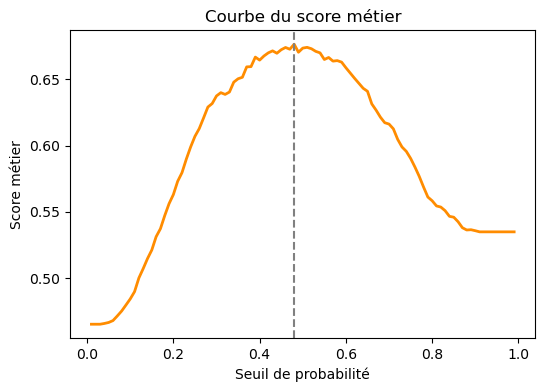

Meilleur seuil de probabilité (Test) : 0.48
Score Metier (Test) : 0.677


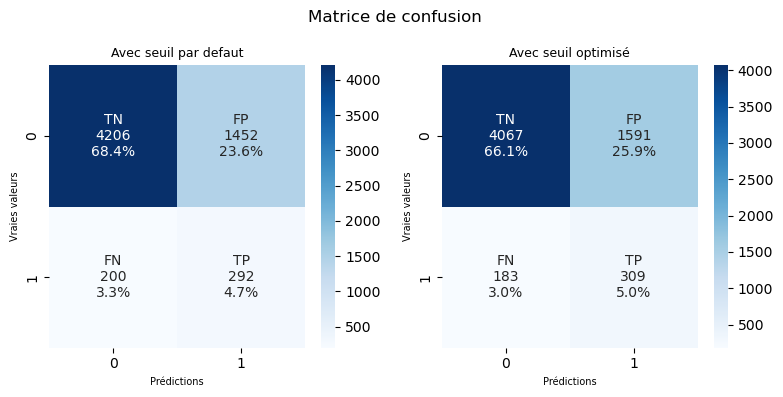

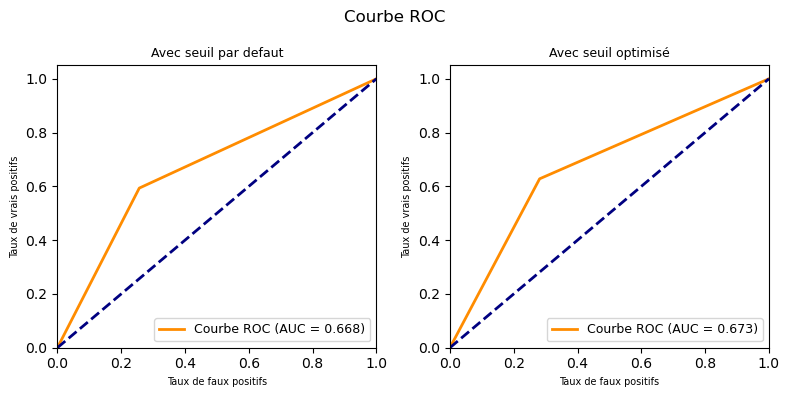

🏃 View run LGBMClassifier at: http://127.0.0.1:5000/#/experiments/610637709898584675/runs/181269785c39409daaec688ca803fe46
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/610637709898584675


In [509]:
# Initialisation d’une instance de StratifiedKFold où K=5 
kfold = KFold(n_splits=5, random_state=42, shuffle=True)

random_cv_LGBM  = RandomizedSearchCV(LGBMClm_oversampler, 
            hyperparameter_LGBM, 
            scoring=custom_scorer,
            cv=kfold, 
            n_iter=10, 
            n_jobs = 4,
            random_state=42,
            verbose=2)

model_eval3(random_cv_LGBM, 'LGBMClassifier', 'MinMaxScaler', X_train_sample, y_train_sample, X_test_sample, y_test_sample,  perf_tableaux, crossvalidation_tableaux, F_ECHANTILLON, 'oversampler', 'RandomizedSearch')


In [511]:
perf_tableaux.loc[(perf_tableaux["Recherche Hyperparametres"]=="RandomizedSearch") & (perf_tableaux["Model"]=="LGBMClassifier")]

,Model,Normalisation,Target Balanced,Echantillon,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
0,LGBMClassifier,MinMaxScaler,oversampler,10%,RandomizedSearch,"{'model__learning_rate': 0.11397083143409441, 'model__max_depth': 4, 'model__n_estimators': 63, 'model__num_leaves': 72, 'model__reg_alpha': 0.8422847745949985, 'model__reg_lambda': 0.44975413336976566, 'model__subsample': 0.6975751180009072}",0.48,0.677,0.673,0.712,0.163,0.628,0:03:20


In [513]:
#verification des écarts-type du score métier sur chaque itération du randomizedsearch
crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LGBMClassifier RandomizedSearch 10%"]

,Model,Iteration N°,Mean_test_score,Pli_test_score,Std_test_score
0,LGBMClassifier RandomizedSearch 10%,0.0,0.582,0.6 0.595 0.551 0.588 0.574,0.018
1,LGBMClassifier RandomizedSearch 10%,1.0,0.625,0.641 0.622 0.599 0.625 0.637,0.015
2,LGBMClassifier RandomizedSearch 10%,2.0,0.664,0.667 0.664 0.655 0.668 0.666,0.005
3,LGBMClassifier RandomizedSearch 10%,3.0,0.672,0.678 0.669 0.666 0.664 0.682,0.007
4,LGBMClassifier RandomizedSearch 10%,4.0,0.582,0.595 0.584 0.557 0.574 0.599,0.015
5,LGBMClassifier RandomizedSearch 10%,5.0,0.638,0.649 0.629 0.613 0.636 0.661,0.016
6,LGBMClassifier RandomizedSearch 10%,6.0,0.658,0.67 0.664 0.634 0.653 0.669,0.013
7,LGBMClassifier RandomizedSearch 10%,7.0,0.681,0.697 0.678 0.663 0.681 0.687,0.011
8,LGBMClassifier RandomizedSearch 10%,8.0,0.563,0.563 0.576 0.553 0.561 0.563,0.008
9,LGBMClassifier RandomizedSearch 10%,9.0,0.554,0.557 0.568 0.542 0.551 0.55,0.009


In [515]:
min_Std_test_score = crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LGBMClassifier RandomizedSearch 10%",'Std_test_score'].min()
max_Std_test_score = crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LGBMClassifier RandomizedSearch 10%",'Std_test_score'].max()
print("Std_test_score [ min - max ] = [", min_Std_test_score, "-", max_Std_test_score, "]")

Std_test_score [ min - max ] = [ 0.005 - 0.018 ]


<b>XGBClassifier + MinMaxScaler + smote</b>

Meilleures hyperparamètres (Validation) : {'model__colsample_bytree': 0.5920392514089517, 'model__learning_rate': 0.028485445552552703, 'model__max_depth': 2, 'model__n_estimators': 53, 'model__reg_alpha': 0.9394989415641891, 'model__reg_lambda': 1.894827350427649, 'model__subsample': 0.6381099809299766}
Meilleur score métier (Validation) : 0.605
iteration N°0
 - moyenne score métier (validation)=0.55, score métier (validation) dans chaque pli=[0.553 0.566 0.538 0.551 0.543]
 - moyenne écart-type (validation)=0.01
______________
iteration N°1
 - moyenne score métier (validation)=0.541, score métier (validation) dans chaque pli=[0.537 0.557 0.52 0.546 0.543]
 - moyenne écart-type (validation)=0.012
______________
iteration N°2
 - moyenne score métier (validation)=0.576, score métier (validation) dans chaque pli=[0.579 0.593 0.559 0.571 0.575]
 - moyenne écart-type (validation)=0.011
______________
iteration N°3
 - moyenne score métier (validation)=0.558, score métier (validation) dans c

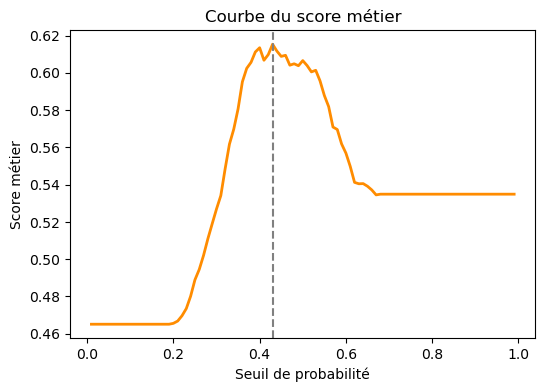

Meilleur seuil de probabilité (Test) : 0.43
Score Metier (Test) : 0.615


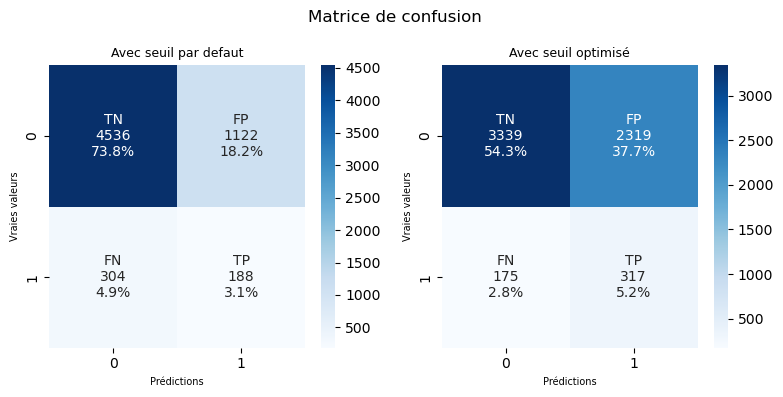

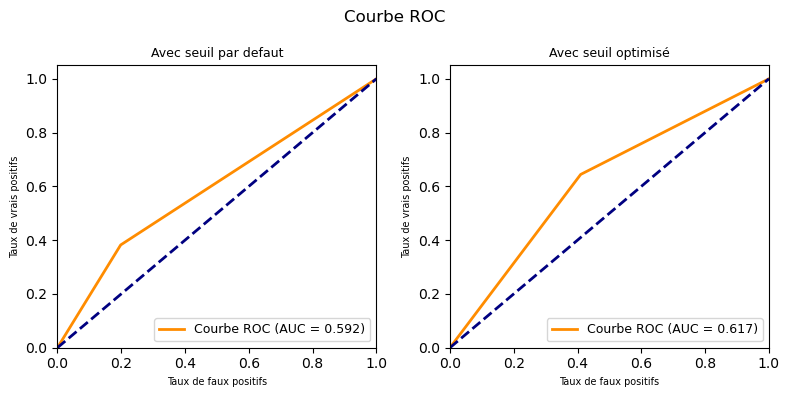

🏃 View run XGBClassifier at: http://127.0.0.1:5000/#/experiments/610637709898584675/runs/cef1ed993d3248b0ba5a125824429226
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/610637709898584675


In [517]:
# Initialisation d’une instance de StratifiedKFold où K=5 
kfold = KFold(n_splits=5, random_state=42, shuffle=True)

random_cv_XGB  = RandomizedSearchCV(XGBClm_smote, 
            hyperparameter_XGB, 
            scoring=custom_scorer,
            cv=kfold, 
            n_iter=10, 
            n_jobs = 4,
            random_state=42)

model_eval3(random_cv_XGB, 'XGBClassifier', 'MinMaxScaler', X_train_sample, y_train_sample, X_test_sample, y_test_sample,  perf_tableaux, crossvalidation_tableaux, F_ECHANTILLON, 'smote', 'RandomizedSearch')


In [518]:
perf_tableaux.loc[(perf_tableaux["Recherche Hyperparametres"]=="RandomizedSearch") & (perf_tableaux["Model"]=="XGBClassifier")]

,Model,Normalisation,Target Balanced,Echantillon,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
1,XGBClassifier,MinMaxScaler,smote,10%,RandomizedSearch,"{'model__colsample_bytree': 0.5920392514089517, 'model__learning_rate': 0.028485445552552703, 'model__max_depth': 2, 'model__n_estimators': 53, 'model__reg_alpha': 0.9394989415641891, 'model__reg_lambda': 1.894827350427649, 'model__subsample': 0.6381099809299766}",0.43,0.615,0.617,0.594,0.12,0.644,0:11:04


In [519]:
#verification des écarts-type du score métier sur chaque itération du randomizedsearch
crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="XGBClassifier RandomizedSearch 10%"]

,Model,Iteration N°,Mean_test_score,Pli_test_score,Std_test_score
10,XGBClassifier RandomizedSearch 10%,0.0,0.550,0.553 0.566 0.538 0.551 0.543,0.010
11,XGBClassifier RandomizedSearch 10%,1.0,0.541,0.537 0.557 0.52 0.546 0.543,0.012
12,XGBClassifier RandomizedSearch 10%,2.0,0.576,0.579 0.593 0.559 0.571 0.575,0.011
13,XGBClassifier RandomizedSearch 10%,3.0,0.558,0.555 0.571 0.543 0.562 0.558,0.009
14,XGBClassifier RandomizedSearch 10%,4.0,0.576,0.574 0.589 0.569 0.578 0.568,0.008
15,XGBClassifier RandomizedSearch 10%,5.0,0.582,0.592 0.592 0.568 0.579 0.579,0.009
16,XGBClassifier RandomizedSearch 10%,6.0,0.539,0.536 0.556 0.52 0.544 0.538,0.012
17,XGBClassifier RandomizedSearch 10%,7.0,0.605,0.606 0.609 0.614 0.596 0.598,0.007
18,XGBClassifier RandomizedSearch 10%,8.0,0.547,0.55 0.568 0.524 0.552 0.543,0.014
19,XGBClassifier RandomizedSearch 10%,9.0,0.539,0.54 0.55 0.522 0.544 0.539,0.009


In [520]:
min_Std_test_score = crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="XGBClassifier RandomizedSearch 10%",'Std_test_score'].min()
max_Std_test_score = crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="XGBClassifier RandomizedSearch 10%",'Std_test_score'].max()
print("Std_test_score [ min - max ] = [", min_Std_test_score, "-", max_Std_test_score, "]")

Std_test_score [ min - max ] = [ 0.007 - 0.014 ]


<b>LogisticRegression + MinMaxScaler + class_weight</b>

Meilleures hyperparamètres (Validation) : {'C': 21.544346900318832, 'max_iter': 3019}
Meilleur score métier (Validation) : 0.676
iteration N°0
 - moyenne score métier (validation)=0.673, score métier (validation) dans chaque pli=[0.676 0.673 0.662 0.673 0.682]
 - moyenne écart-type (validation)=0.007
______________
iteration N°1
 - moyenne score métier (validation)=0.673, score métier (validation) dans chaque pli=[0.678 0.673 0.662 0.672 0.68]
 - moyenne écart-type (validation)=0.006
______________
iteration N°2
 - moyenne score métier (validation)=0.675, score métier (validation) dans chaque pli=[0.682 0.67 0.665 0.672 0.687]
 - moyenne écart-type (validation)=0.008
______________
iteration N°3
 - moyenne score métier (validation)=0.673, score métier (validation) dans chaque pli=[0.676 0.673 0.66 0.674 0.682]
 - moyenne écart-type (validation)=0.007
______________
iteration N°4
 - moyenne score métier (validation)=0.673, score métier (validation) dans chaque pli=[0.678 0.673 0.662 0.6

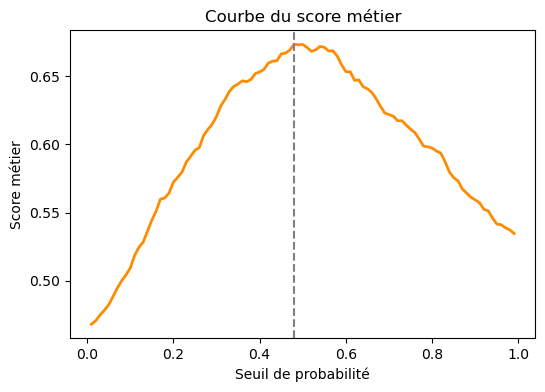

Meilleur seuil de probabilité (Test) : 0.48
Score Metier (Test) : 0.673


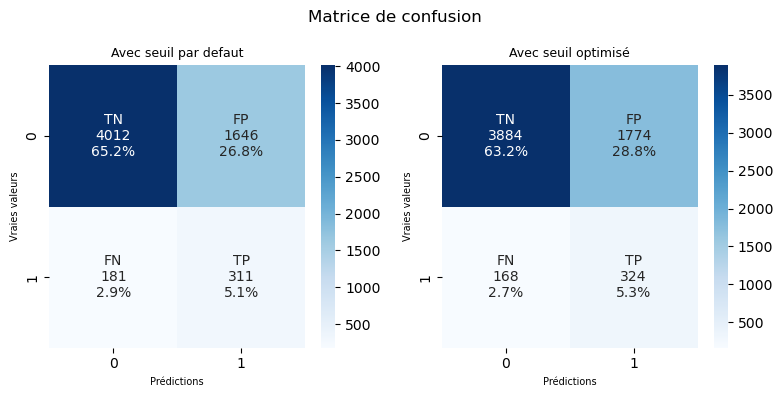

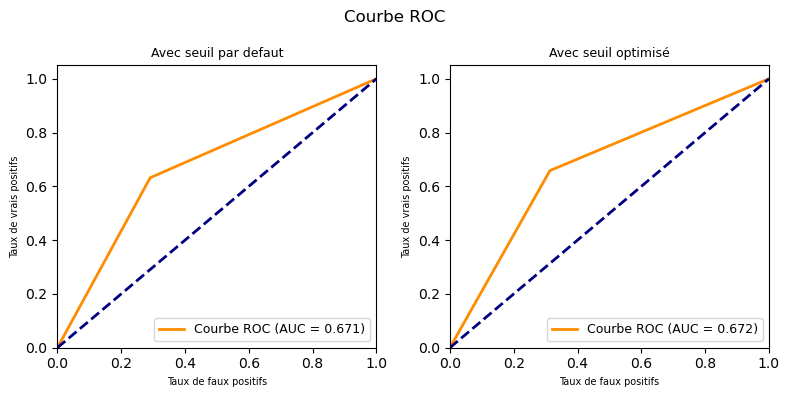

🏃 View run LogisticRegression at: http://127.0.0.1:5000/#/experiments/610637709898584675/runs/a3887df8d56840f694d49021526f64b7
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/610637709898584675


In [522]:
# Initialisation d’une instance de StratifiedKFold où K=5 
kfold = KFold(n_splits=5, random_state=42, shuffle=True)

scaler = MinMaxScaler()
X_train_sample_scaled = scaler.fit_transform(X_train_sample)
X_test_sample_scaled = scaler.transform(X_test_sample)

#avec class_weight
LR = LogisticRegression()
random_cv_LR  = RandomizedSearchCV(LR, 
            hyperparameter_LR, 
            scoring=custom_scorer,
            cv=kfold, 
            n_iter=10, 
            n_jobs = 4,
            random_state=42)

model_eval3(random_cv_LR, 'LogisticRegression', 'MinMaxScaler', X_train_sample_scaled, y_train_sample, X_test_sample_scaled, y_test_sample,  perf_tableaux, crossvalidation_tableaux, F_ECHANTILLON, 'class_weight', 'RandomizedSearch')


In [523]:
#selRows = perf_tableaux.loc[(perf_tableaux["Recherche Hyperparametres"]=="RandomizedSearch") & (perf_tableaux["Model"]=="LogisticRegression")].index
#perf_tableaux = perf_tableaux.drop(selRows, axis=0)
#selRows2 = crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LogisticRegression RandomizedSearch 10%"].index
#crossvalidation_tableaux = crossvalidation_tableaux.drop(selRows2, axis=0)

In [524]:
perf_tableaux.loc[(perf_tableaux["Recherche Hyperparametres"]=="RandomizedSearch") & (perf_tableaux["Model"]=="LogisticRegression")]

,Model,Normalisation,Target Balanced,Echantillon,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
2,LogisticRegression,MinMaxScaler,class_weight,10%,RandomizedSearch,"{'C': 21.544346900318832, 'max_iter': 3019}",0.48,0.673,0.672,0.684,0.154,0.659,0:11:27


In [525]:
#verification des écarts-type du score métier sur chaque itération du randomizedsearch
crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LogisticRegression RandomizedSearch 10%"]

,Model,Iteration N°,Mean_test_score,Pli_test_score,Std_test_score
20,LogisticRegression RandomizedSearch 10%,0.0,0.673,0.676 0.673 0.662 0.673 0.682,0.007
21,LogisticRegression RandomizedSearch 10%,1.0,0.673,0.678 0.673 0.662 0.672 0.68,0.006
22,LogisticRegression RandomizedSearch 10%,2.0,0.675,0.682 0.67 0.665 0.672 0.687,0.008
23,LogisticRegression RandomizedSearch 10%,3.0,0.673,0.676 0.673 0.66 0.674 0.682,0.007
24,LogisticRegression RandomizedSearch 10%,4.0,0.673,0.678 0.673 0.662 0.672 0.68,0.006
25,LogisticRegression RandomizedSearch 10%,5.0,0.676,0.685 0.675 0.662 0.674 0.687,0.009
26,LogisticRegression RandomizedSearch 10%,6.0,0.675,0.685 0.673 0.658 0.671 0.69,0.011
27,LogisticRegression RandomizedSearch 10%,7.0,0.673,0.678 0.675 0.661 0.67 0.682,0.007
28,LogisticRegression RandomizedSearch 10%,8.0,0.673,0.678 0.673 0.662 0.672 0.68,0.006
29,LogisticRegression RandomizedSearch 10%,9.0,0.675,0.679 0.675 0.664 0.67 0.686,0.008


In [526]:
min_Std_test_score = crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LogisticRegression RandomizedSearch 10%",'Std_test_score'].min()
max_Std_test_score = crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LogisticRegression RandomizedSearch 10%",'Std_test_score'].max()
print("Std_test_score [ min - max ] = [", min_Std_test_score, "-", max_Std_test_score, "]")

Std_test_score [ min - max ] = [ 0.006 - 0.011 ]


<b><u>Avec 100%</u></b>

In [536]:
# tracking new experience
mlflow.set_experiment("Simulations de modèles avec RandomizedSearchCV sur 100% données")

2025/06/05 18:49:04 INFO mlflow.tracking.fluent: Experiment with name 'Simulations de modèles avec RandomizedSearchCV sur 100% données' does not exist. Creating a new experiment.


<Experiment: artifact_location='mlflow-artifacts:/132852107788131092', creation_time=1749142144962, experiment_id='132852107788131092', last_update_time=1749142144962, lifecycle_stage='active', name='Simulations de modèles avec RandomizedSearchCV sur 100% données', tags={}>

In [108]:
F_ECHANTILLON = "100%"
##### Sépration en jeu d'entrainement / jeu de validation, 80% des données pour l'entraînement
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.8, random_state=42)

# vérification de la taille des matrices :
print('taille X_train:', X_train.shape)
print('taille X_test:', X_test.shape)
print('taille y_train:', y_train.shape)
print('taille y_test:', y_test.shape)

taille X_train: (246004, 589)
taille X_test: (61502, 589)
taille y_train: (246004,)
taille y_test: (61502,)


Fitting 5 folds for each of 10 candidates, totalling 50 fits
[LightGBM] [Info] Number of positive: 226164, number of negative: 226164
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.638303 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 65468
[LightGBM] [Info] Number of data points in the train set: 452328, number of used features: 574
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

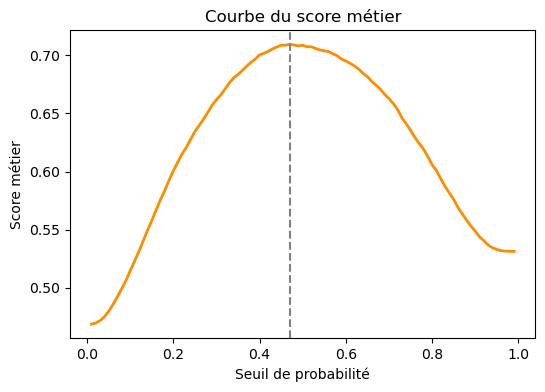

Meilleur seuil de probabilité (Test) : 0.47
Score Metier (Test) : 0.709


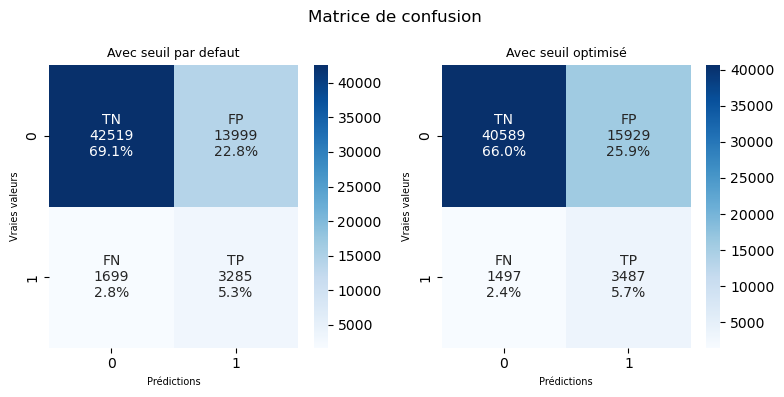

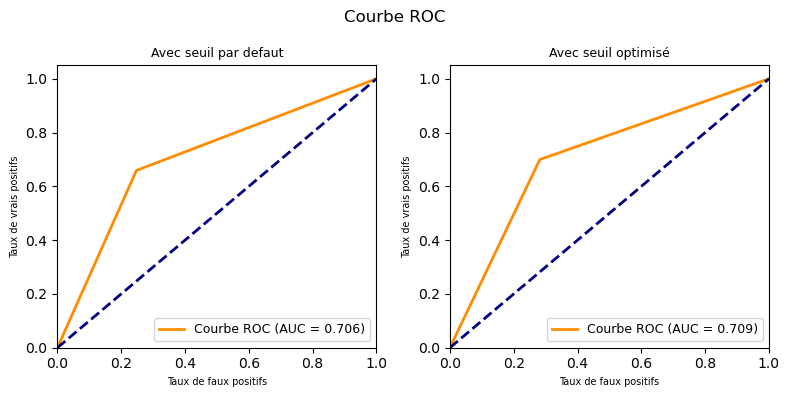

🏃 View run LGBMClassifier at: http://127.0.0.1:5000/#/experiments/132852107788131092/runs/d2494757fa704ec094dc285efaba2b01
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/132852107788131092


In [539]:
model_eval3(random_cv_LGBM, 'LGBMClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux, crossvalidation_tableaux, F_ECHANTILLON, 'oversampler', 'RandomizedSearch')


In [540]:
perf_tableaux.loc[(perf_tableaux["Recherche Hyperparametres"]=="RandomizedSearch") & (perf_tableaux["Model"]=="LGBMClassifier")]

,Model,Normalisation,Target Balanced,Echantillon,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
0,LGBMClassifier,MinMaxScaler,oversampler,10%,RandomizedSearch,"{'model__learning_rate': 0.11397083143409441, 'model__max_depth': 4, 'model__n_estimators': 63, 'model__num_leaves': 72, 'model__reg_alpha': 0.8422847745949985, 'model__reg_lambda': 0.44975413336976566, 'model__subsample': 0.6975751180009072}",0.48,0.677,0.673,0.712,0.163,0.628,0:03:20
3,LGBMClassifier,MinMaxScaler,oversampler,100%,RandomizedSearch,"{'model__learning_rate': 0.16230688458668535, 'model__max_depth': 5, 'model__n_estimators': 139, 'model__num_leaves': 93, 'model__reg_alpha': 0.24102546602601171, 'model__reg_lambda': 0.6832635188254582, 'model__subsample': 0.8049983288913105}",0.47,0.709,0.709,0.717,0.180,0.700,0:22:44


In [541]:
#verification des écarts-type du score métier sur chaque itération du randomizedsearch
crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LGBMClassifier RandomizedSearch 100%"]

,Model,Iteration N°,Mean_test_score,Pli_test_score,Std_test_score
30,LGBMClassifier RandomizedSearch 100%,0.0,0.704,0.704 0.696 0.707 0.708 0.705,0.004
31,LGBMClassifier RandomizedSearch 100%,1.0,0.703,0.7 0.698 0.702 0.71 0.704,0.004
32,LGBMClassifier RandomizedSearch 100%,2.0,0.708,0.71 0.703 0.71 0.711 0.709,0.003
33,LGBMClassifier RandomizedSearch 100%,3.0,0.678,0.679 0.672 0.675 0.686 0.676,0.005
34,LGBMClassifier RandomizedSearch 100%,4.0,0.688,0.692 0.686 0.69 0.689 0.684,0.003
35,LGBMClassifier RandomizedSearch 100%,5.0,0.710,0.713 0.702 0.711 0.716 0.708,0.005
36,LGBMClassifier RandomizedSearch 100%,6.0,0.707,0.711 0.702 0.705 0.71 0.706,0.003
37,LGBMClassifier RandomizedSearch 100%,7.0,0.703,0.705 0.698 0.701 0.711 0.702,0.004
38,LGBMClassifier RandomizedSearch 100%,8.0,0.650,0.648 0.648 0.65 0.652 0.652,0.002
39,LGBMClassifier RandomizedSearch 100%,9.0,0.671,0.674 0.67 0.669 0.671 0.672,0.002


In [542]:
min_Std_test_score = crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LGBMClassifier RandomizedSearch 100%",'Std_test_score'].min()
max_Std_test_score = crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LGBMClassifier RandomizedSearch 100%",'Std_test_score'].max()
print("Std_test_score [ min - max ] = [", min_Std_test_score, "-", max_Std_test_score, "]")

Std_test_score [ min - max ] = [ 0.002 - 0.005 ]


<b>XGBClassifier + MinMaxScaler + smote</b>

C:\Users\MOI\anaconda3\Lib\site-packages\joblib\externals\loky\process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Meilleures hyperparamètres (Validation) : {'model__colsample_bytree': 0.5920392514089517, 'model__learning_rate': 0.028485445552552703, 'model__max_depth': 2, 'model__n_estimators': 53, 'model__reg_alpha': 0.9394989415641891, 'model__reg_lambda': 1.894827350427649, 'model__subsample': 0.6381099809299766}
Meilleur score métier (Validation) : 0.628
iteration N°0
 - moyenne score métier (validation)=0.559, score métier (validation) dans chaque pli=[0.561 0.556 0.564 0.557 0.56]
 - moyenne écart-type (validation)=0.003
______________
iteration N°1
 - moyenne score métier (validation)=0.545, score métier (validation) dans chaque pli=[0.547 0.541 0.547 0.543 0.547]
 - moyenne écart-type (validation)=0.003
______________
iteration N°2
 - moyenne score métier (validation)=0.59, score métier (validation) dans chaque pli=[0.591 0.587 0.593 0.589 0.59]
 - moyenne écart-type (validation)=0.002
______________
iteration N°3
 - moyenne score métier (validation)=0.559, score métier (validation) dans c

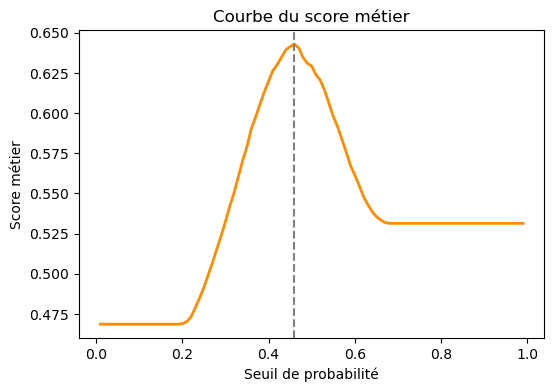

Meilleur seuil de probabilité (Test) : 0.46
Score Metier (Test) : 0.643


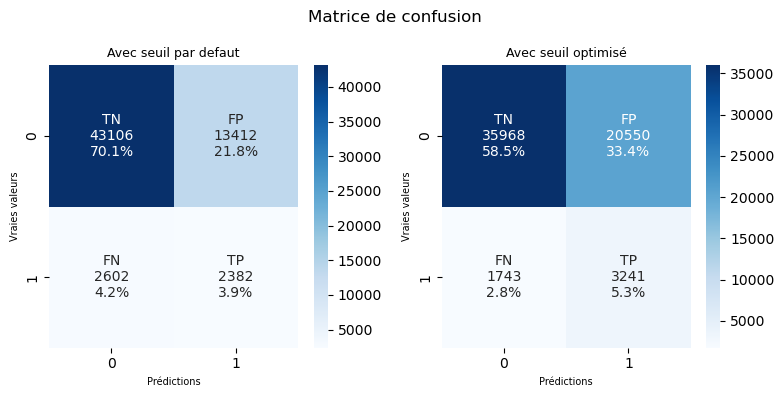

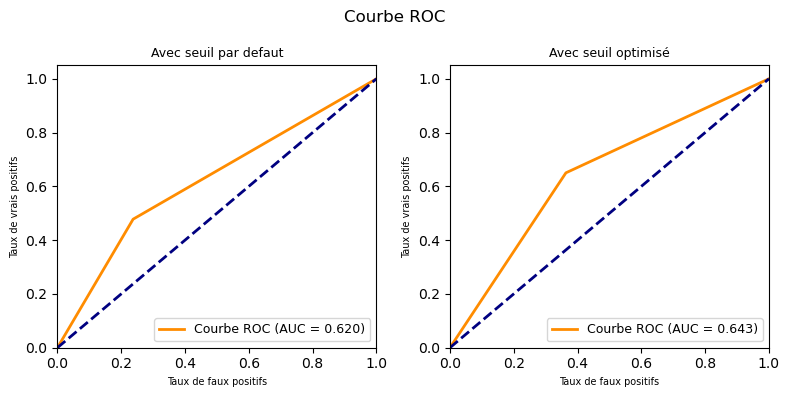

🏃 View run XGBClassifier at: http://127.0.0.1:5000/#/experiments/132852107788131092/runs/ac04b6fcbe6d4ed18ba7d14d956c3d07
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/132852107788131092


In [544]:
model_eval3(random_cv_XGB, 'XGBClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux, crossvalidation_tableaux, F_ECHANTILLON, 'smote', 'RandomizedSearch')


In [545]:
perf_tableaux.loc[(perf_tableaux["Recherche Hyperparametres"]=="RandomizedSearch") & (perf_tableaux["Model"]=="XGBClassifier")]

,Model,Normalisation,Target Balanced,Echantillon,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
1,XGBClassifier,MinMaxScaler,smote,10%,RandomizedSearch,"{'model__colsample_bytree': 0.5920392514089517, 'model__learning_rate': 0.028485445552552703, 'model__max_depth': 2, 'model__n_estimators': 53, 'model__reg_alpha': 0.9394989415641891, 'model__reg_lambda': 1.894827350427649, 'model__subsample': 0.6381099809299766}",0.43,0.615,0.617,0.594,0.120,0.644,0:11:04
4,XGBClassifier,MinMaxScaler,smote,100%,RandomizedSearch,"{'model__colsample_bytree': 0.5920392514089517, 'model__learning_rate': 0.028485445552552703, 'model__max_depth': 2, 'model__n_estimators': 53, 'model__reg_alpha': 0.9394989415641891, 'model__reg_lambda': 1.894827350427649, 'model__subsample': 0.6381099809299766}",0.46,0.643,0.643,0.638,0.136,0.650,1:24:55


In [546]:
#verification des écarts-type du score métier sur chaque itération du randomizedsearch
crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="XGBClassifier RandomizedSearch 100%"]

,Model,Iteration N°,Mean_test_score,Pli_test_score,Std_test_score
40,XGBClassifier RandomizedSearch 100%,0.0,0.559,0.561 0.556 0.564 0.557 0.56,0.003
41,XGBClassifier RandomizedSearch 100%,1.0,0.545,0.547 0.541 0.547 0.543 0.547,0.003
42,XGBClassifier RandomizedSearch 100%,2.0,0.590,0.591 0.587 0.593 0.589 0.59,0.002
43,XGBClassifier RandomizedSearch 100%,3.0,0.559,0.559 0.557 0.562 0.56 0.56,0.002
44,XGBClassifier RandomizedSearch 100%,4.0,0.589,0.584 0.587 0.592 0.589 0.592,0.003
45,XGBClassifier RandomizedSearch 100%,5.0,0.591,0.594 0.587 0.594 0.593 0.59,0.003
46,XGBClassifier RandomizedSearch 100%,6.0,0.547,0.546 0.541 0.55 0.549 0.549,0.003
47,XGBClassifier RandomizedSearch 100%,7.0,0.628,0.629 0.627 0.63 0.631 0.623,0.003
48,XGBClassifier RandomizedSearch 100%,8.0,0.552,0.551 0.55 0.555 0.549 0.553,0.002
49,XGBClassifier RandomizedSearch 100%,9.0,0.546,0.547 0.542 0.548 0.544 0.548,0.002


In [547]:
min_Std_test_score = crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="XGBClassifier RandomizedSearch 100%",'Std_test_score'].min()
max_Std_test_score = crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="XGBClassifier RandomizedSearch 100%",'Std_test_score'].max()
print("Std_test_score [ min - max ] = [", min_Std_test_score, "-", max_Std_test_score, "]")

Std_test_score [ min - max ] = [ 0.002 - 0.003 ]


<b>LogisticRegression + MinMaxScaler + class_weight</b>

Meilleures hyperparamètres (Validation) : {'C': 1291.5496650148827, 'max_iter': 3872}
Meilleur score métier (Validation) : 0.698
iteration N°0
 - moyenne score métier (validation)=0.698, score métier (validation) dans chaque pli=[0.693 0.695 0.699 0.704 0.698]
 - moyenne écart-type (validation)=0.004
______________
iteration N°1
 - moyenne score métier (validation)=0.698, score métier (validation) dans chaque pli=[0.693 0.693 0.699 0.705 0.699]
 - moyenne écart-type (validation)=0.004
______________
iteration N°2
 - moyenne score métier (validation)=0.697, score métier (validation) dans chaque pli=[0.692 0.693 0.699 0.704 0.696]
 - moyenne écart-type (validation)=0.004
______________
iteration N°3
 - moyenne score métier (validation)=0.698, score métier (validation) dans chaque pli=[0.693 0.695 0.699 0.704 0.698]
 - moyenne écart-type (validation)=0.004
______________
iteration N°4
 - moyenne score métier (validation)=0.698, score métier (validation) dans chaque pli=[0.693 0.693 0.699 

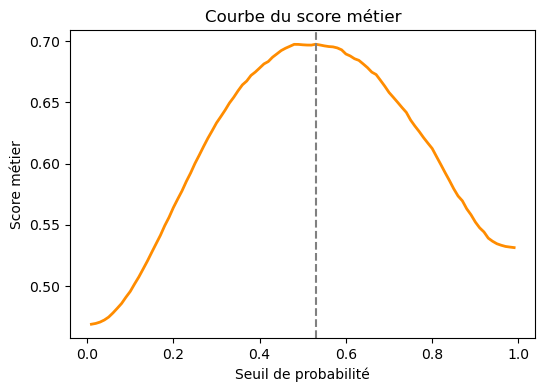

Meilleur seuil de probabilité (Test) : 0.53
Score Metier (Test) : 0.698


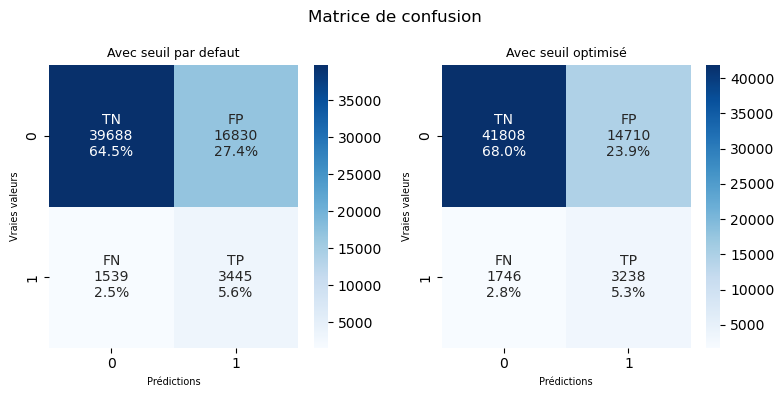

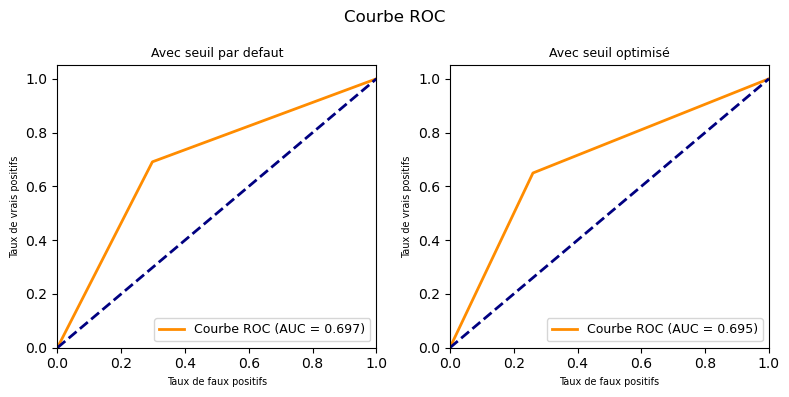

🏃 View run LogisticRegression at: http://127.0.0.1:5000/#/experiments/132852107788131092/runs/34c806ff13ac45df937947bccb08e67e
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/132852107788131092


In [549]:
model_eval3(random_cv_LR, 'LogisticRegression', 'MinMaxScaler', X_train_scaled, y_train, X_test_scaled, y_test,  perf_tableaux, crossvalidation_tableaux, F_ECHANTILLON, 'class_weight', 'RandomizedSearch')


In [550]:
perf_tableaux.loc[(perf_tableaux["Recherche Hyperparametres"]=="RandomizedSearch") & (perf_tableaux["Model"]=="LogisticRegression")]

,Model,Normalisation,Target Balanced,Echantillon,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
2,LogisticRegression,MinMaxScaler,class_weight,10%,RandomizedSearch,"{'C': 21.544346900318832, 'max_iter': 3019}",0.48,0.673,0.672,0.684,0.154,0.659,0:11:27
5,LogisticRegression,MinMaxScaler,class_weight,100%,RandomizedSearch,"{'C': 1291.5496650148827, 'max_iter': 3872}",0.53,0.698,0.695,0.732,0.180,0.650,1:36:31


In [551]:
#verification des écarts-type du score métier sur chaque itération du randomizedsearch
crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LogisticRegression RandomizedSearch 100%"]

,Model,Iteration N°,Mean_test_score,Pli_test_score,Std_test_score
50,LogisticRegression RandomizedSearch 100%,0.0,0.698,0.693 0.695 0.699 0.704 0.698,0.004
51,LogisticRegression RandomizedSearch 100%,1.0,0.698,0.693 0.693 0.699 0.705 0.699,0.004
52,LogisticRegression RandomizedSearch 100%,2.0,0.697,0.692 0.693 0.699 0.704 0.696,0.004
53,LogisticRegression RandomizedSearch 100%,3.0,0.698,0.693 0.695 0.699 0.704 0.698,0.004
54,LogisticRegression RandomizedSearch 100%,4.0,0.698,0.693 0.693 0.699 0.705 0.699,0.004
55,LogisticRegression RandomizedSearch 100%,5.0,0.697,0.693 0.694 0.699 0.703 0.698,0.004
56,LogisticRegression RandomizedSearch 100%,6.0,0.695,0.691 0.691 0.698 0.702 0.695,0.004
57,LogisticRegression RandomizedSearch 100%,7.0,0.697,0.694 0.693 0.699 0.703 0.698,0.004
58,LogisticRegression RandomizedSearch 100%,8.0,0.698,0.693 0.693 0.699 0.705 0.699,0.004
59,LogisticRegression RandomizedSearch 100%,9.0,0.697,0.693 0.694 0.699 0.705 0.696,0.004


In [552]:
min_Std_test_score = crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LogisticRegression RandomizedSearch 100%",'Std_test_score'].min()
max_Std_test_score = crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LogisticRegression RandomizedSearch 100%",'Std_test_score'].max()
print("Std_test_score [ min - max ] = [", min_Std_test_score, "-", max_Std_test_score, "]")

Std_test_score [ min - max ] = [ 0.004 - 0.004 ]


In [313]:
#CLassement des modèles avec 10% données du meilleur score métier au moins bon
perf_tableaux.loc[perf_tableaux["Echantillon"]=="10%"].sort_values(by = 'Score Metier', ascending = False)

,Model,Normalisation,Target Balanced,Echantillon,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
0,LGBMClassifier,MinMaxScaler,oversampler,10%,RandomizedSearch,"{'model__learning_rate': 0.1108596011676981, 'model__max_depth': 7, 'model__n_estimators': 61, 'model__num_leaves': 13, 'model__reg_alpha': 0.907566473926093, 'model__reg_lambda': 0.24929222914887494, 'model__subsample': 0.7051914615178149}",0.45,0.678,0.679,0.670,0.153,0.689,0 days 00:04:22.045113
2,LogisticRegression,MinMaxScaler,class_weight,10%,RandomizedSearch,"{'C': 7.742636826811269, 'max_iter': 1999}",0.54,0.675,0.670,0.737,0.170,0.589,0 days 00:19:17.895275
1,XGBClassifier,MinMaxScaler,smote,10%,RandomizedSearch,"{'model__colsample_bytree': 0.5920392514089517, 'model__learning_rate': 0.028485445552552703, 'model__max_depth': 2, 'model__n_estimators': 53, 'model__reg_alpha': 0.9394989415641891, 'model__reg_lambda': 1.894827350427649, 'model__subsample': 0.6381099809299766}",0.43,0.615,0.617,0.594,0.120,0.644,0 days 00:13:06.402163


In [566]:
#CLassement des modèles avec 100% données du meilleur score métier au moins bon
perf_tableaux.loc[perf_tableaux["Echantillon"]=="100%"].sort_values(by = 'Score Metier', ascending = False)

,Model,Normalisation,Target Balanced,Echantillon,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
3,LGBMClassifier,MinMaxScaler,oversampler,100%,RandomizedSearch,"{'model__learning_rate': 0.16230688458668535, 'model__max_depth': 5, 'model__n_estimators': 139, 'model__num_leaves': 93, 'model__reg_alpha': 0.24102546602601171, 'model__reg_lambda': 0.6832635188254582, 'model__subsample': 0.8049983288913105}",0.47,0.709,0.709,0.717,0.180,0.70,0:22:44
5,LogisticRegression,MinMaxScaler,class_weight,100%,RandomizedSearch,"{'C': 1291.5496650148827, 'max_iter': 3872}",0.53,0.698,0.695,0.732,0.180,0.65,1:36:31
4,XGBClassifier,MinMaxScaler,smote,100%,RandomizedSearch,"{'model__colsample_bytree': 0.5920392514089517, 'model__learning_rate': 0.028485445552552703, 'model__max_depth': 2, 'model__n_estimators': 53, 'model__reg_alpha': 0.9394989415641891, 'model__reg_lambda': 1.894827350427649, 'model__subsample': 0.6381099809299766}",0.46,0.643,0.643,0.638,0.136,0.65,1:24:55


<b>C'est donc le modèle LGBMClassifier qui arrive en 1er sur 100% données (également vrai sur l'échantillon de 10%) avec :</b>
- un score métier optimal = 0.709
- un score ROC AUC = 0.709
- un seuil optimal = 0.47
- un temps d'entrainnement + rapide = 22min
- meilleurs hyperparametres : {'model__learning_rate': 0.16230688458668535, 'model__max_depth': 5, 'model__n_estimators': 139, 'model__num_leaves': 93, 'model__reg_alpha': 0.24102546602601171, 'model__reg_lambda': 0.6832635188254582, 'model__subsample': 0.8049983288913105}	


Nous allons maintenant finetuner ses hyperparametres avec GridSearchCV

#### <font color="blue" size=3>6.2.2 Utilisation de GridSearchCV </font>

In [570]:
# tracking new experience
mlflow.set_experiment("Simulations du meilleur modèle avec GridSearchCV sur 100% données")

2025/06/05 22:27:18 INFO mlflow.tracking.fluent: Experiment with name 'Simulations du meilleur modèle avec GridSearchCV sur 100% données' does not exist. Creating a new experiment.


<Experiment: artifact_location='mlflow-artifacts:/665183764233945561', creation_time=1749155238677, experiment_id='665183764233945561', last_update_time=1749155238677, lifecycle_stage='active', name='Simulations du meilleur modèle avec GridSearchCV sur 100% données', tags={}>

In [576]:
# Définition des hyperparamètres à tester
# utilisation de la fonction randint (créer un nombre entier aléatoire à l’intérieur d’une plage défini)
hyperparameter_LGBM_tuning = {
                  'model__n_estimators'    : [138, 139, 140],   #nombre d'estimateur (=arbre)
                  'model__learning_rate'   : [0.15, 0.16, 0.17], #taux d'apprentissage pour chaque estimateur
                  'model__max_depth'       : [4, 5, 6]      #profondeur max de chaque estimateur
                 # 'model__num_leaves'       : [92, 93, 94],   #nombre de feuilles dans chaque arbre
                 # 'model__subsample'       : [0.7, 0.8, 0.9]   #proportion d'echantillons à utiliser pour chaque arbre
                 #'model__reg_alpha'       : [0.23, 0.24, 0.25],       #parametre de regularisation L1/L2
                 # 'model__reg_lambda'       : [0.67, 0.68, 0.69]
                 }

grid_cv_LGBM  = GridSearchCV(LGBMClm_oversampler, 
            hyperparameter_LGBM_tuning, 
            scoring=custom_scorer,
            cv=kfold, 
            n_jobs = 4,
            verbose=2)

Fitting 5 folds for each of 27 candidates, totalling 135 fits
[LightGBM] [Info] Number of positive: 226164, number of negative: 226164
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.614252 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 65468
[LightGBM] [Info] Number of data points in the train set: 452328, number of used features: 574
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with 

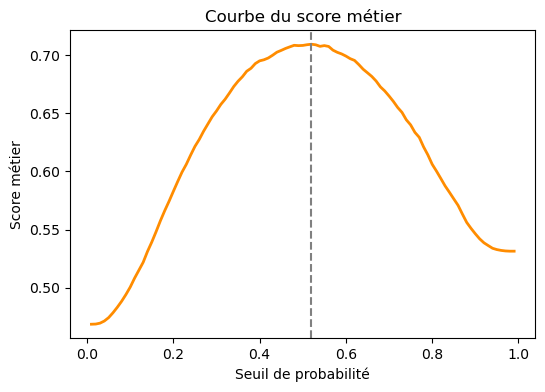

Meilleur seuil de probabilité (Test) : 0.52
Score Metier (Test) : 0.709


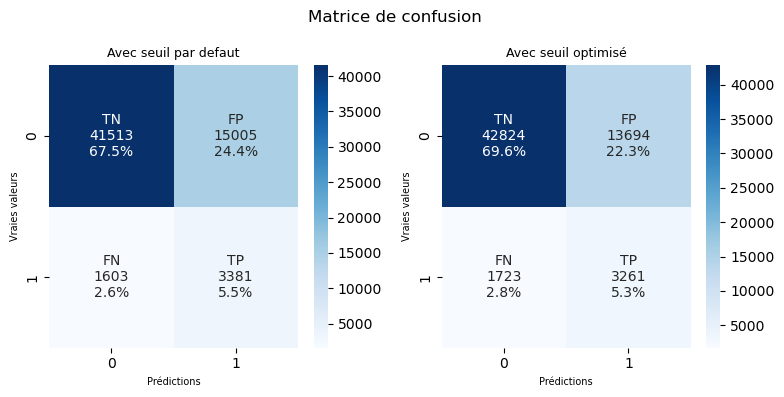

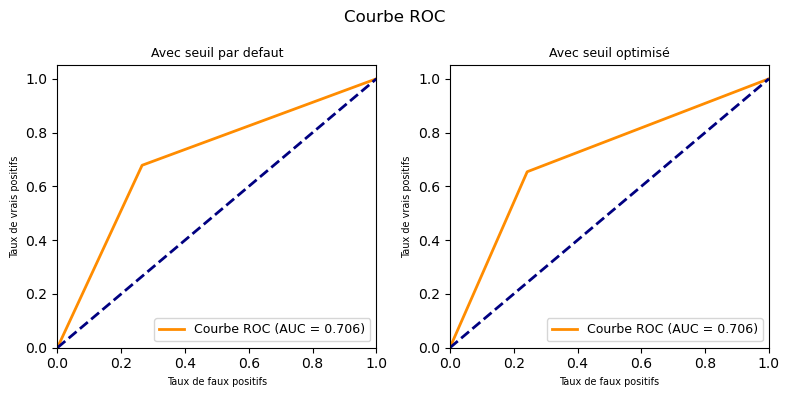

🏃 View run LGBMClassifier at: http://127.0.0.1:5000/#/experiments/665183764233945561/runs/dd9cc6b096604349945f309821e5a8d9
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/665183764233945561


In [578]:
#pour limiter le temps machine, on va faire le finetuning sur 3 hyperparametres et 3 modalités/hyperparametres = 27 combinaisons exploratoires
model_eval3(grid_cv_LGBM, 'LGBMClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux, crossvalidation_tableaux, F_ECHANTILLON, 'oversampler', 'GridSearch')

In [580]:
perf_tableaux.loc[(perf_tableaux["Recherche Hyperparametres"]=="GridSearch")]

,Model,Normalisation,Target Balanced,Echantillon,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
6,LGBMClassifier,MinMaxScaler,oversampler,100%,GridSearch,"{'model__learning_rate': 0.16, 'model__max_depth': 4, 'model__n_estimators': 140}",0.52,0.709,0.706,0.749,0.192,0.654,0:48:53


In [582]:
#verification des écarts-type du score métier sur chaque itération du randomizedsearch
crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LGBMClassifier GridSearch 100%"]

,Model,Iteration N°,Mean_test_score,Pli_test_score,Std_test_score
60,LGBMClassifier GridSearch 100%,0.0,0.711,0.711 0.706 0.71 0.717 0.711,0.003
61,LGBMClassifier GridSearch 100%,1.0,0.711,0.711 0.706 0.71 0.717 0.711,0.003
62,LGBMClassifier GridSearch 100%,2.0,0.711,0.712 0.706 0.71 0.717 0.711,0.004
63,LGBMClassifier GridSearch 100%,3.0,0.711,0.715 0.703 0.71 0.714 0.713,0.005
64,LGBMClassifier GridSearch 100%,4.0,0.711,0.715 0.703 0.711 0.715 0.712,0.004
65,LGBMClassifier GridSearch 100%,5.0,0.711,0.715 0.703 0.71 0.713 0.713,0.004
66,LGBMClassifier GridSearch 100%,6.0,0.711,0.712 0.707 0.709 0.715 0.712,0.003
67,LGBMClassifier GridSearch 100%,7.0,0.711,0.711 0.707 0.709 0.716 0.712,0.003
68,LGBMClassifier GridSearch 100%,8.0,0.711,0.712 0.707 0.709 0.715 0.712,0.003
69,LGBMClassifier GridSearch 100%,9.0,0.712,0.714 0.703 0.713 0.716 0.712,0.004


In [584]:
#CLassement des modèles avec 100% données du meilleur score métier au moins bon
perf_tableaux.loc[perf_tableaux["Echantillon"]=="100%"].sort_values(by = 'Score Metier', ascending = False)

,Model,Normalisation,Target Balanced,Echantillon,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
3,LGBMClassifier,MinMaxScaler,oversampler,100%,RandomizedSearch,"{'model__learning_rate': 0.16230688458668535, 'model__max_depth': 5, 'model__n_estimators': 139, 'model__num_leaves': 93, 'model__reg_alpha': 0.24102546602601171, 'model__reg_lambda': 0.6832635188254582, 'model__subsample': 0.8049983288913105}",0.47,0.709,0.709,0.717,0.180,0.700,0:22:44
6,LGBMClassifier,MinMaxScaler,oversampler,100%,GridSearch,"{'model__learning_rate': 0.16, 'model__max_depth': 4, 'model__n_estimators': 140}",0.52,0.709,0.706,0.749,0.192,0.654,0:48:53
5,LogisticRegression,MinMaxScaler,class_weight,100%,RandomizedSearch,"{'C': 1291.5496650148827, 'max_iter': 3872}",0.53,0.698,0.695,0.732,0.180,0.650,1:36:31
4,XGBClassifier,MinMaxScaler,smote,100%,RandomizedSearch,"{'model__colsample_bytree': 0.5920392514089517, 'model__learning_rate': 0.028485445552552703, 'model__max_depth': 2, 'model__n_estimators': 53, 'model__reg_alpha': 0.9394989415641891, 'model__reg_lambda': 1.894827350427649, 'model__subsample': 0.6381099809299766}",0.46,0.643,0.643,0.638,0.136,0.650,1:24:55


In [588]:
# Définition des hyperparamètres à tester
# utilisation de la fonction randint (créer un nombre entier aléatoire à l’intérieur d’une plage défini)
hyperparameter_LGBM_tuning = {
                  'model__n_estimators'    : [138, 139, 140],   #nombre d'estimateur (=arbre)
                  'model__learning_rate'   : [0.15, 0.16, 0.17], #taux d'apprentissage pour chaque estimateur
                  'model__max_depth'       : [4, 5, 6],      #profondeur max de chaque estimateur
                  'model__num_leaves'       : [92, 93, 94],   #nombre de feuilles dans chaque arbre
                 # 'model__subsample'       : [0.7, 0.8, 0.9]   #proportion d'echantillons à utiliser pour chaque arbre
                 'model__reg_alpha'       : [0.23, 0.24, 0.25]       #parametre de regularisation L1/L2
                 # 'model__reg_lambda'       : [0.67, 0.68, 0.69]
                 }

grid_cv_LGBM  = GridSearchCV(LGBMClm_oversampler, 
            hyperparameter_LGBM_tuning, 
            scoring=custom_scorer,
            cv=kfold, 
            n_jobs = 4,
            verbose=2)

Fitting 5 folds for each of 243 candidates, totalling 1215 fits
[LightGBM] [Info] Number of positive: 226164, number of negative: 226164
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.292693 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 65468
[LightGBM] [Info] Number of data points in the train set: 452328, number of used features: 574
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

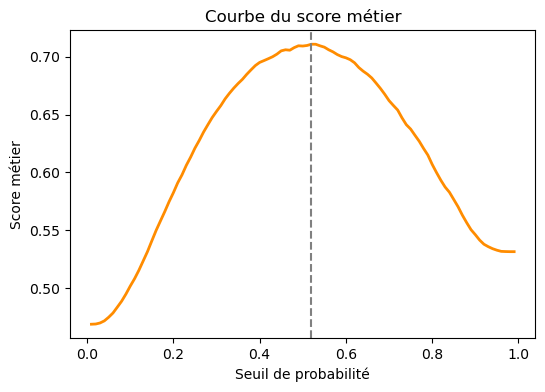

Meilleur seuil de probabilité (Test) : 0.52
Score Metier (Test) : 0.711


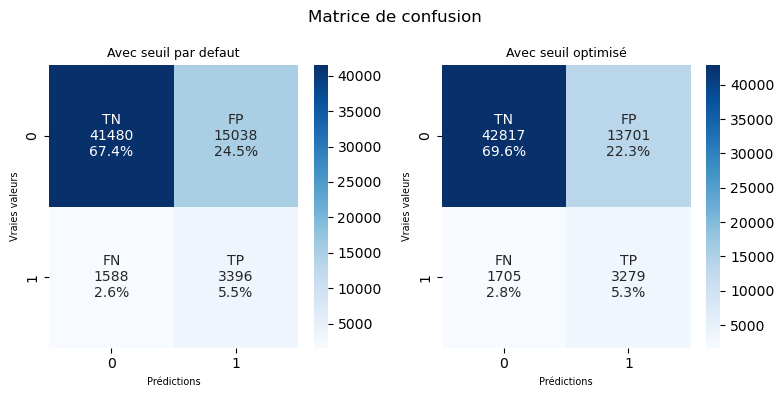

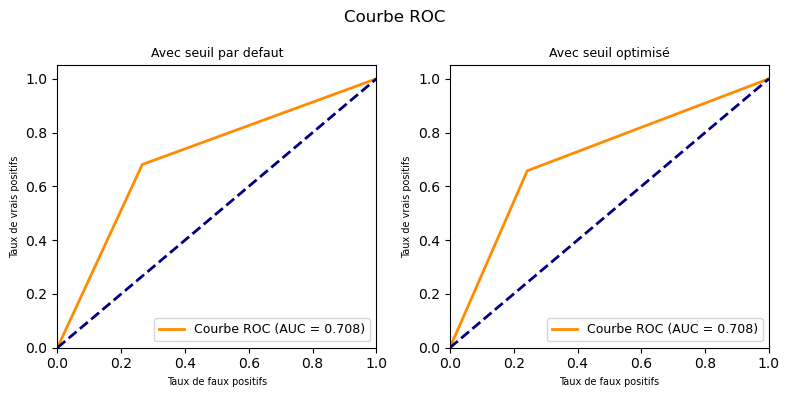

🏃 View run LGBMClassifier at: http://127.0.0.1:5000/#/experiments/665183764233945561/runs/2b59f409b0c04ac1bf76cacf8ef2dac0
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/665183764233945561


In [590]:
#pour limiter le temps machine, on va faire le finetuning sur 5 hyperparametres et 3 modalités/hyperparametres = 243 combinaisons exploratoires
model_eval3(grid_cv_LGBM, 'LGBMClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux, crossvalidation_tableaux, F_ECHANTILLON, 'oversampler', 'GridSearch')

In [592]:
perf_tableaux.loc[(perf_tableaux["Recherche Hyperparametres"]=="GridSearch")]

,Model,Normalisation,Target Balanced,Echantillon,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
6,LGBMClassifier,MinMaxScaler,oversampler,100%,GridSearch,"{'model__learning_rate': 0.16, 'model__max_depth': 4, 'model__n_estimators': 140}",0.52,0.709,0.706,0.749,0.192,0.654,0:48:53
7,LGBMClassifier,MinMaxScaler,oversampler,100%,GridSearch,"{'model__learning_rate': 0.16, 'model__max_depth': 4, 'model__n_estimators': 140, 'model__num_leaves': 92, 'model__reg_alpha': 0.25}",0.52,0.711,0.708,0.750,0.193,0.658,7:18:12


In [594]:
#verification des écarts-type du score métier sur chaque itération du randomizedsearch
crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LGBMClassifier GridSearch 100%"]

,Model,Iteration N°,Mean_test_score,Pli_test_score,Std_test_score
60,LGBMClassifier GridSearch 100%,0.0,0.711,0.711 0.706 0.71 0.717 0.711,0.003
61,LGBMClassifier GridSearch 100%,1.0,0.711,0.711 0.706 0.71 0.717 0.711,0.003
62,LGBMClassifier GridSearch 100%,2.0,0.711,0.712 0.706 0.71 0.717 0.711,0.004
63,LGBMClassifier GridSearch 100%,3.0,0.711,0.715 0.703 0.71 0.714 0.713,0.005
64,LGBMClassifier GridSearch 100%,4.0,0.711,0.715 0.703 0.711 0.715 0.712,0.004
...,...,...,...,...,...
325,LGBMClassifier GridSearch 100%,238.0,0.705,0.706 0.698 0.705 0.707 0.707,0.003
326,LGBMClassifier GridSearch 100%,239.0,0.704,0.707 0.701 0.703 0.706 0.706,0.002
327,LGBMClassifier GridSearch 100%,240.0,0.705,0.703 0.7 0.708 0.706 0.706,0.003
328,LGBMClassifier GridSearch 100%,241.0,0.705,0.706 0.698 0.705 0.707 0.707,0.003


In [596]:
#CLassement des modèles avec 100% données du meilleur score métier au moins bon
perf_tableaux.loc[perf_tableaux["Echantillon"]=="100%"].sort_values(by = 'Score Metier', ascending = False)

,Model,Normalisation,Target Balanced,Echantillon,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
7,LGBMClassifier,MinMaxScaler,oversampler,100%,GridSearch,"{'model__learning_rate': 0.16, 'model__max_depth': 4, 'model__n_estimators': 140, 'model__num_leaves': 92, 'model__reg_alpha': 0.25}",0.52,0.711,0.708,0.750,0.193,0.658,7:18:12
3,LGBMClassifier,MinMaxScaler,oversampler,100%,RandomizedSearch,"{'model__learning_rate': 0.16230688458668535, 'model__max_depth': 5, 'model__n_estimators': 139, 'model__num_leaves': 93, 'model__reg_alpha': 0.24102546602601171, 'model__reg_lambda': 0.6832635188254582, 'model__subsample': 0.8049983288913105}",0.47,0.709,0.709,0.717,0.180,0.700,0:22:44
6,LGBMClassifier,MinMaxScaler,oversampler,100%,GridSearch,"{'model__learning_rate': 0.16, 'model__max_depth': 4, 'model__n_estimators': 140}",0.52,0.709,0.706,0.749,0.192,0.654,0:48:53
5,LogisticRegression,MinMaxScaler,class_weight,100%,RandomizedSearch,"{'C': 1291.5496650148827, 'max_iter': 3872}",0.53,0.698,0.695,0.732,0.180,0.650,1:36:31
4,XGBClassifier,MinMaxScaler,smote,100%,RandomizedSearch,"{'model__colsample_bytree': 0.5920392514089517, 'model__learning_rate': 0.028485445552552703, 'model__max_depth': 2, 'model__n_estimators': 53, 'model__reg_alpha': 0.9394989415641891, 'model__reg_lambda': 1.894827350427649, 'model__subsample': 0.6381099809299766}",0.46,0.643,0.643,0.638,0.136,0.650,1:24:55


#### <font color="blue" size=3>6.2.3 Features Importance  </font>

Analysons l'impact des variables avec la features importance.

Feature Importance Computed with SHAP Values :
- Features importance global = 100% du dataset<br>
- Features importance local  = sur 1 client<br>

In [110]:
import shap

#LGBMClassifier + MinMaxScaler + oversampler
LGBMClm_oversampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', LGBMClassifier())
])

# Initialisation d’une instance de StratifiedKFold où K=5 
kfold = KFold(n_splits=5, random_state=42, shuffle=True)

#definition des meilleurs hyperparametres calculés précedemment
hyperparameter_LGBM_tuning_vf = {
                  'model__n_estimators'    : [140],   #nombre d'estimateur (=arbre)
                  'model__learning_rate'   : [0.16], #taux d'apprentissage pour chaque estimateur
                  'model__max_depth'       : [4],      #profondeur max de chaque estimateur
                  'model__num_leaves'       : [92],   #nombre de feuilles dans chaque arbre
                 # 'model__subsample'       : [0.7, 0.8, 0.9]   #proportion d'echantillons à utiliser pour chaque arbre
                 'model__reg_alpha'       : [0.25]       #parametre de regularisation L1/L2
                 # 'model__reg_lambda'       : [0.67, 0.68, 0.69]
                 }


grid_cv_LGBM  = GridSearchCV(LGBMClm_oversampler, 
            hyperparameter_LGBM_tuning_vf, 
            scoring=custom_scorer,
            cv=kfold, 
            n_jobs = 4)

grid_cv_LGBM.fit(X_train, y_train)

[LightGBM] [Info] Number of positive: 226164, number of negative: 226164
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.865883 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 65468
[LightGBM] [Info] Number of data points in the train set: 452328, number of used features: 574
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further

GridSearchCV(cv=KFold(n_splits=5, random_state=42, shuffle=True),
             estimator=Pipeline(steps=[('scaler', MinMaxScaler()),
                                       ('balance',
                                        RandomOverSampler(random_state=42)),
                                       ('model', LGBMClassifier())]),
             n_jobs=4,
             param_grid={'model__learning_rate': [0.16],
                         'model__max_depth': [4], 'model__n_estimators': [140],
                         'model__num_leaves': [92],
                         'model__reg_alpha': [0.25]},
             scoring=<function custom_scorer at 0x0000018897DC5620>)

<u>Features importance global</u>

In [118]:
# Entraînement du pipeline avec les hyperparamètres optimaux
best_pipeline = grid_cv_LGBM.best_estimator_

# Calcul de la feature importance avec TreeExplainer
X_resampled, y_resampled = best_pipeline.named_steps['balance'].fit_resample(best_pipeline.named_steps['scaler'].fit_transform(X_train), y_train)
explainer = shap.TreeExplainer(best_pipeline.named_steps['model'])
shap_values = explainer.shap_values(X_resampled)
all_features = X_train.columns

C:\Users\MOI\anaconda3\Lib\site-packages\shap\explainers\_tree.py:448: UserWarning: LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray
  warnings.warn('LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray')


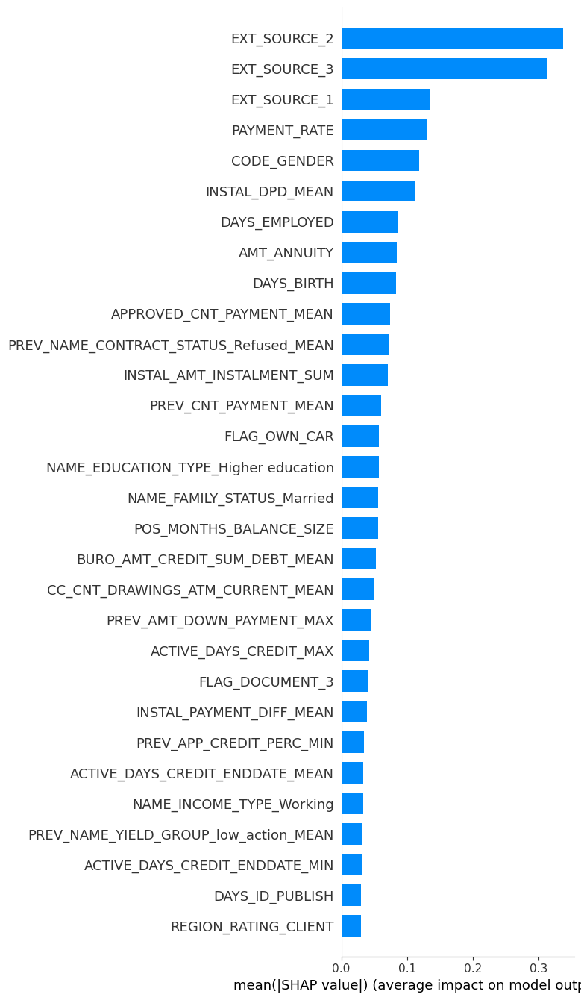

In [120]:
shap.initjs() 

# Affichage de la feature importance
#shap.summary_plot(shap_values, X_resampled, plot_type="bar")
shap.summary_plot(shap_values, features=X_resampled, feature_names=all_features, plot_type='bar', max_display=30)

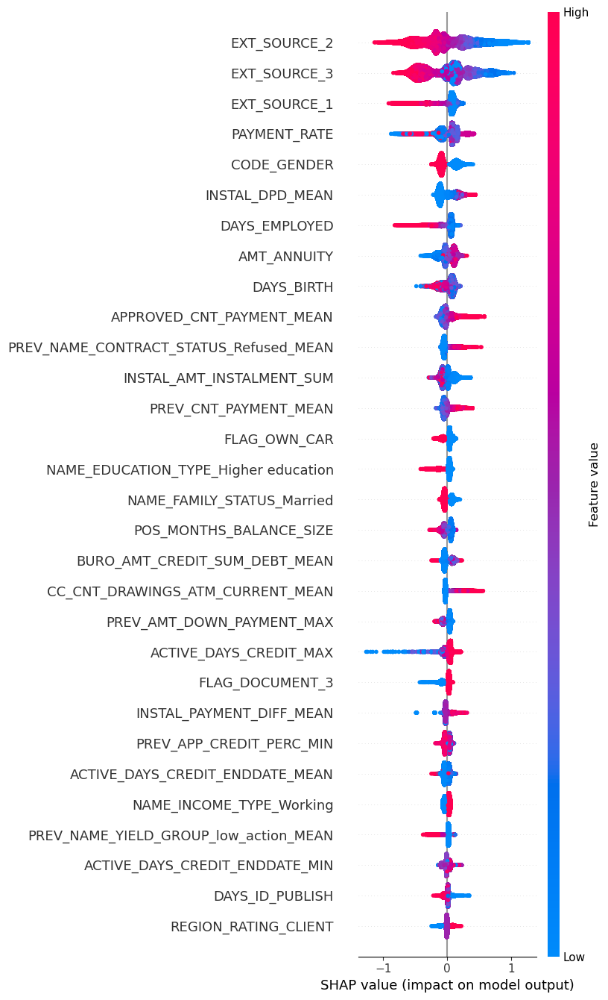

In [246]:
shap.initjs() 
#affichage des 30 variables les plus importantes
shap.summary_plot(shap_values, features=X_resampled, feature_names=all_features, max_display=30)

Dans les 2 graphiques ci-dessus, nous pouvons conclure les informations suivantes :

- EXT_SOURCE_2 et EXT_SOURCE_3 sont les 2 features les plus importante au niveau du dataset global<br>
  Une valeur elevée de EXT_SOURCE_2 et EXT_SOURCE_3 entraine une baisse des chances d'etre défaillant / à contrario une valeur faible de EXT_SOURCE_2 et EXT_SOURCE_3 entraine une augmentation des chances d'etre défaillant

- EXT_SOURCE_1 est la 3ème features la plus importante : une valeur elevée entraine une baisse des chances d'etre défaillant / à contrario une valeur faible entraine une augmentation des chances d'etre défaillant
- PAYMENT_RATE est la 4ème feature la plus importante, c'est aussi une feature issue de l'étape de features engeenering (taux de paiement annuel = montant remboursé par an du crédit / montant total) : une valeur elevée donne une tendance à baisser la défaillance de remboursement des prets = équivaut à une  durée du crédit courte / une valeur faible a tendance à augmenter la défaillance de remboursement des prets = équivaut à une durée du crédit longue. 
- CODE_GENDER est la 5ème feature la plus importante, le sexe du client est donc une caractéristique importante (la valeur 0 indique un homme / la valeur 1 indique une femme) : les hommes ont tendance à augmenter la défaillance de remboursement des prets / les femmes ont tendance à diminuer la défaillance de remboursement des prets
- INSTALL_DPD_MEAN est la 6ème features la plus importante, c'est aussi une feature issue de l'étape de features engeenering (c'est la moyenne des jours entre la date réelle de paiement du crédit précédent et la date prévisionnelle de paiement du crédit précédent). Une valeur elevée donne une  tendance à augmenter la défaillance de remboursement des prets car le client accumule des retards de paiements de ses échéances / une valeur faible voir nulle donne une tendance à baisser la défaillance de remboursements car le client paie son crédit comme prévu dans son échéancier.

In [124]:
#recupération de la feature importance
feature_importances = np.abs(shap_values).mean(axis=0)

features_importances_df = pd.DataFrame()
row_index = features_importances_df.shape[0]
for i, feature in enumerate(all_features):
    #print(f"{feature} : {feature_importances[i]}")
    features_importances_df.loc[row_index, 'Features'] = feature
    features_importances_df.loc[row_index, 'Features_importances_value'] = feature_importances[i]
    row_index+=1

In [126]:
features_importances_df.sort_values(by = 'Features_importances_value', ascending = False).head(30)

,Features,Features_importances_value
29,EXT_SOURCE_2,0.337052
30,EXT_SOURCE_3,0.312267
28,EXT_SOURCE_1,0.134804
205,PAYMENT_RATE,0.131128
0,CODE_GENDER,0.117952
501,INSTAL_DPD_MEAN,0.112814
9,DAYS_EMPLOYED,0.085180
6,AMT_ANNUITY,0.084524
8,DAYS_BIRTH,0.082813
468,APPROVED_CNT_PAYMENT_MEAN,0.073885


In [128]:
#calcul des features avec une valeur importance à zero 
zero_importance_columns = X_train.columns[feature_importances == 0].tolist()
print("Nb features avec une importance nulle : ",len(zero_importance_columns))

Nb features avec une importance nulle :  258


In [130]:
#liste des features avec une valeur importance à zero 
zero_importance_columns

['FLAG_OWN_REALTY',
 'CNT_CHILDREN',
 'FLAG_MOBIL',
 'FLAG_EMP_PHONE',
 'FLAG_CONT_MOBILE',
 'FLAG_EMAIL',
 'CNT_FAM_MEMBERS',
 'REG_REGION_NOT_LIVE_REGION',
 'REG_REGION_NOT_WORK_REGION',
 'LIVE_REGION_NOT_WORK_REGION',
 'LIVE_CITY_NOT_WORK_CITY',
 'FLAG_DOCUMENT_2',
 'FLAG_DOCUMENT_4',
 'FLAG_DOCUMENT_5',
 'FLAG_DOCUMENT_6',
 'FLAG_DOCUMENT_7',
 'FLAG_DOCUMENT_8',
 'FLAG_DOCUMENT_9',
 'FLAG_DOCUMENT_10',
 'FLAG_DOCUMENT_11',
 'FLAG_DOCUMENT_12',
 'FLAG_DOCUMENT_14',
 'FLAG_DOCUMENT_15',
 'FLAG_DOCUMENT_17',
 'FLAG_DOCUMENT_19',
 'FLAG_DOCUMENT_20',
 'FLAG_DOCUMENT_21',
 'AMT_REQ_CREDIT_BUREAU_HOUR',
 'AMT_REQ_CREDIT_BUREAU_DAY',
 'AMT_REQ_CREDIT_BUREAU_YEAR',
 'NAME_TYPE_SUITE_Children',
 'NAME_TYPE_SUITE_Group of people',
 'NAME_TYPE_SUITE_Other_A',
 'NAME_TYPE_SUITE_Other_B',
 'NAME_TYPE_SUITE_Spouse, partner',
 'NAME_INCOME_TYPE_Businessman',
 'NAME_INCOME_TYPE_Commercial associate',
 'NAME_INCOME_TYPE_Maternity leave',
 'NAME_INCOME_TYPE_Student',
 'NAME_INCOME_TYPE_Unemployed',


In [132]:
#calcul des features avec une valeur importance différente de zero 
importance_columns_notnul = X_train.columns[feature_importances > 0].tolist()
print("Nb features avec une importance non nulle : ",len(importance_columns_notnul))

Nb features avec une importance non nulle :  331


In [134]:
importance_columns_notnul

['CODE_GENDER',
 'FLAG_OWN_CAR',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'OWN_CAR_AGE',
 'FLAG_WORK_PHONE',
 'FLAG_PHONE',
 'REGION_RATING_CLIENT',
 'HOUR_APPR_PROCESS_START',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'EXT_SOURCE_1',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'APARTMENTS_AVG',
 'BASEMENTAREA_AVG',
 'YEARS_BEGINEXPLUATATION_AVG',
 'YEARS_BUILD_AVG',
 'COMMONAREA_AVG',
 'ELEVATORS_AVG',
 'ENTRANCES_AVG',
 'FLOORSMAX_AVG',
 'FLOORSMIN_AVG',
 'LANDAREA_AVG',
 'LIVINGAPARTMENTS_AVG',
 'NONLIVINGAPARTMENTS_AVG',
 'NONLIVINGAREA_AVG',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'DAYS_LAST_PHONE_CHANGE',
 'FLAG_DOCUMENT_3',
 'FLAG_DOCUMENT_13',
 'FLAG_DOCUMENT_16',
 'FLAG_DOCUMENT_18',
 'AMT_REQ_CREDIT_BUREAU_WEEK',
 'AMT_REQ_CREDIT_BUREAU_MON',
 'AMT_REQ_CREDIT_BUREAU_QRT',
 'NAME_CONTRACT_TYPE_Cash loans',
 'N

In [139]:
#visualisation d'une colonne avec 1 modalité
print('Nb valeurs distincts pour CODE_GENDER :',len(DataFeatureEngennering.groupby('CODE_GENDER')))
resultat = DataFeatureEngennering.groupby(['CODE_GENDER'], dropna=True).size().reset_index()
resultat.columns = ['CODE_GENDER','nb']
resultat['Percentage'] = 100 * resultat['nb']  / resultat['nb'].sum()
resultat.sort_values('Percentage',ascending=False,inplace=True)
resultat.head(10)

Nb valeurs distincts pour CODE_GENDER : 2


,CODE_GENDER,nb,Percentage
1,1,202447,65.835138
0,0,105059,34.164862


<u>Features importance local</u> : explications du modèle pour un client en particulier

- Le <u>force plot</u> est pour voir où se place la prédiction par rapport à la “base value” (c’est la valeur qui serait prédite si nous ne connaissions aucune caractéristiques pour le client  = moyenne des prédictions de défaillance sur le jeu d'entrainement). Nous observons également quelles variables ont un impact positif (rouge) ou négatif (bleu) sur la prédiction et l’amplitude de cet impact. 
- Le <u>Decision plot</u> permet d’observer l’amplitude de chaque changement, “une trajectoire” prise par une instance pour les valeurs des variables affichées.

In [151]:
shap.initjs() 

#exemple d'un client avec une prédiction de non défaillance
i = 1
shap.force_plot(explainer.expected_value, shap_values[i], 
                features=X_resampled[i], feature_names=all_features)

- La prédiction de défaillance  pour ce client = <b>-1,36</b>
- La valeur de base = <b>-0,0125</b>
- Les chiffres sur les flèches sont la valeur de la caractéristique pour ce client
- Les fleches Rouges representent les variables qui poussent le modèle à prédire une défaillance de remboursement, et les fleches Bleues représentent les variables qui poussent à prédire une non défaillance
- Plus l'amplitude de la fleche est grande, plus fort est l'impact de cette variable sur la prédiction.
- Pour cet exemple de client, ce sont 2 variables "EXT_SOURCE_3=0,8959" et  "EXT_SOURCE_2=0,7978" qui poussent fortement le modèle à prédire une <u>non défaillance</u> du client.

In [244]:
shap.initjs() 
#exemple d'un client avec une prédiction de défaillance
i = 101
shap.force_plot(explainer.expected_value, shap_values[i], 
                features=X_resampled[i], feature_names=all_features)

- La prédiction de défaillance  pour ce client = <b>+1,77</b>
- La valeur de base = <b>-0,0125</b>
- Les chiffres sur les flèches sont la valeur de la caractéristique pour ce client
- Les fleches Rouges representent les variables qui poussent le modèle à prédire une défaillance de remboursement, et les fleches Bleues représentent les variables qui poussent à prédire une non défaillance
- Plus l'amplitude de la fleche est grande, plus fort est l'impact de cette variable sur la prédiction.
- Pour cet exemple de client, ce sont 2 variables "EXT_SOURCE_3=0,1061" et  "INSTAL_DPD_MEAN=0,008967" qui poussent fortement le modèle à prédire une <u>défaillance</u> du client.

#### <font color="blue" size=3>6.2.4 Calcul des metrics avec les Features Importance  </font>

<b><u>a) Avec l'ensemble des features importances non nulles</u></b>

On va recalculer le score métier uniquement avec les features importances non nulles 

In [292]:
X_features_importance = X.drop(columns=zero_importance_columns, axis=1)

In [297]:
# tracking new experience
mlflow.set_experiment("Simulations du meilleur modèle avec RandomizedSearchCV sur 100% données et avec features importance non nulles")


2025/06/11 12:44:38 INFO mlflow.tracking.fluent: Experiment with name 'Simulations du meilleur modèle avec RandomizedSearchCV sur 100% données et avec features importance non nulles' does not exist. Creating a new experiment.


<Experiment: artifact_location='file:///C:/Users/MOI/PROJET_7/mlruns/461903428084806168', creation_time=1749638678901, experiment_id='461903428084806168', last_update_time=1749638678901, lifecycle_stage='active', name=('Simulations du meilleur modèle avec RandomizedSearchCV sur 100% données et '
 'avec features importance non nulles'), tags={}>

In [303]:
# Définition des hyperparamètres à tester
# utilisation de la fonction randint (créer un nombre entier aléatoire à l’intérieur d’une plage défini)
hyperparameter_LGBM = {
                  'model__n_estimators'    : randint(10, 200),   #nombre d'estimateur (=arbre)
                  'model__learning_rate'   : uniform(0.01, 0.5), #taux d'apprentissage pour chaque estimateur
                  'model__max_depth'       : randint(1,10),      #profondeur max de chaque estimateur
                  'model__num_leaves'       : randint(10,100),   #nombre de feuilles dans chaque arbre
                  'model__subsample'       : uniform(0.5,0.5),   #proportion d'echantillons à utiliser pour chaque arbre
                  'model__reg_alpha'       : uniform(0,1),       #parametre de regularisation L1/L2
                  'model__reg_lambda'       : uniform(0,1)
                 }

random_cv_LGBM  = RandomizedSearchCV(LGBMClm_oversampler, 
            hyperparameter_LGBM, 
            scoring=custom_scorer,
            cv=kfold, 
            n_iter=10, 
            n_jobs = 4,
            random_state=42,
            verbose=2)

In [305]:
F_ECHANTILLON = "100%"
##### Sépration en jeu d'entrainement / jeu de validation, 80% des données pour l'entraînement
X_train, X_test, y_train, y_test = train_test_split(X_features_importance, y, train_size=0.8, random_state=42)

# vérification de la taille des matrices :
print('taille X_train:', X_train.shape)
print('taille X_test:', X_test.shape)
print('taille y_train:', y_train.shape)
print('taille y_test:', y_test.shape)



taille X_train: (246004, 331)
taille X_test: (61502, 331)
taille y_train: (246004,)
taille y_test: (61502,)


Fitting 5 folds for each of 10 candidates, totalling 50 fits
[LightGBM] [Info] Number of positive: 226164, number of negative: 226164
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.562002 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 53079
[LightGBM] [Info] Number of data points in the train set: 452328, number of used features: 331
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

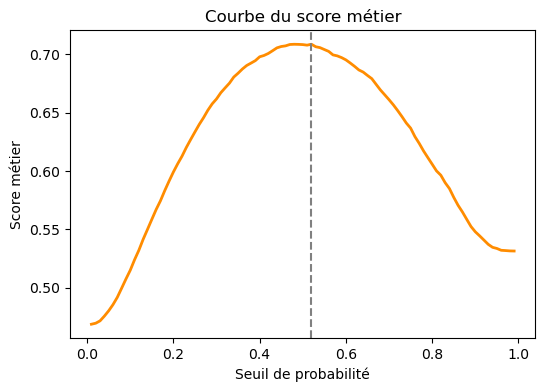

Meilleur seuil de probabilité (Test) : 0.52
Score Metier (Test) : 0.709


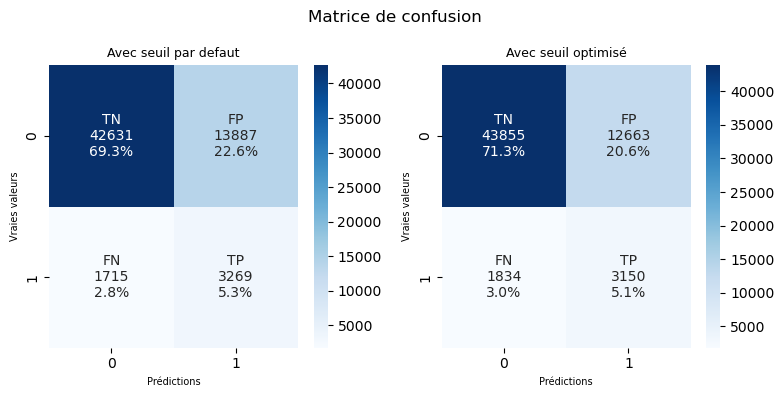

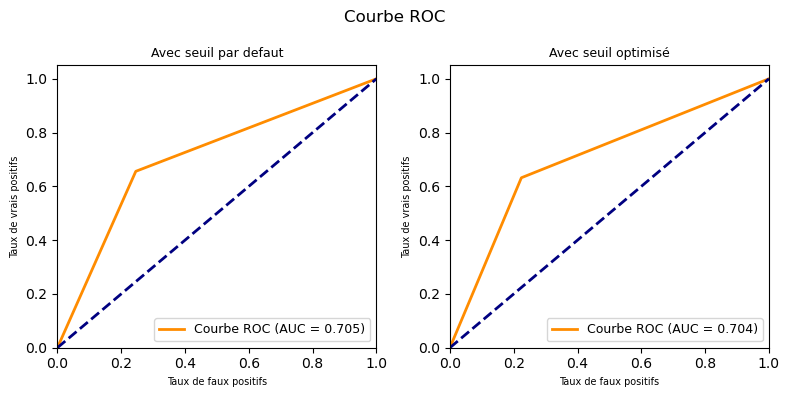

In [313]:
model_eval3(random_cv_LGBM, 'LGBMClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux, crossvalidation_tableaux, F_ECHANTILLON, 'oversampler', 'RandomizedSearch')

In [316]:
perf_tableaux.loc[(perf_tableaux["Recherche Hyperparametres"]=="RandomizedSearch") & (perf_tableaux["Model"]=="LGBMClassifier")]

,Model,Normalisation,Target Balanced,Echantillon,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
0,LGBMClassifier,MinMaxScaler,oversampler,100%,RandomizedSearch,"{'model__learning_rate': 0.16230688458668535, 'model__max_depth': 5, 'model__n_estimators': 139, 'model__num_leaves': 93, 'model__reg_alpha': 0.24102546602601171, 'model__reg_lambda': 0.6832635188254582, 'model__subsample': 0.8049983288913105}",0.52,0.709,0.704,0.764,0.199,0.632,0:12:28


In [318]:
#verification des écarts-type du score métier sur chaque itération du randomizedsearch
crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LGBMClassifier RandomizedSearch 100%"]

,Model,Iteration N°,Mean_test_score,Pli_test_score,Std_test_score
0,LGBMClassifier RandomizedSearch 100%,0.0,0.702,0.697 0.697 0.702 0.707 0.705,0.004
1,LGBMClassifier RandomizedSearch 100%,1.0,0.701,0.705 0.694 0.694 0.711 0.702,0.007
2,LGBMClassifier RandomizedSearch 100%,2.0,0.709,0.711 0.702 0.71 0.712 0.711,0.004
3,LGBMClassifier RandomizedSearch 100%,3.0,0.678,0.68 0.672 0.675 0.686 0.677,0.005
4,LGBMClassifier RandomizedSearch 100%,4.0,0.689,0.69 0.688 0.686 0.692 0.689,0.002
5,LGBMClassifier RandomizedSearch 100%,5.0,0.710,0.71 0.704 0.709 0.713 0.713,0.003
6,LGBMClassifier RandomizedSearch 100%,6.0,0.708,0.708 0.704 0.709 0.713 0.708,0.003
7,LGBMClassifier RandomizedSearch 100%,7.0,0.703,0.705 0.696 0.7 0.71 0.702,0.005
8,LGBMClassifier RandomizedSearch 100%,8.0,0.650,0.651 0.648 0.642 0.652 0.656,0.005
9,LGBMClassifier RandomizedSearch 100%,9.0,0.670,0.669 0.669 0.668 0.673 0.673,0.002


In [320]:
min_Std_test_score = crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LGBMClassifier RandomizedSearch 100%",'Std_test_score'].min()
max_Std_test_score = crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LGBMClassifier RandomizedSearch 100%",'Std_test_score'].max()
print("Std_test_score [ min - max ] = [", min_Std_test_score, "-", max_Std_test_score, "]")

Std_test_score [ min - max ] = [ 0.002 - 0.007 ]


In [322]:
# tracking new experience# tracking new experience
mlflow.set_experiment("Simulations du meilleur modèle avec GridSearchCV sur 100% données et avec features importance non nulles")

2025/06/11 13:48:28 INFO mlflow.tracking.fluent: Experiment with name 'Simulations du meilleur modèle avec GridSearchCV sur 100% données et avec features importance non nulles' does not exist. Creating a new experiment.


<Experiment: artifact_location='file:///C:/Users/MOI/PROJET_7/mlruns/265440270554837669', creation_time=1749642508234, experiment_id='265440270554837669', last_update_time=1749642508234, lifecycle_stage='active', name=('Simulations du meilleur modèle avec GridSearchCV sur 100% données et avec '
 'features importance non nulles'), tags={}>

In [330]:
# Définition des hyperparamètres à tester
# utilisation de la fonction randint (créer un nombre entier aléatoire à l’intérieur d’une plage défini)
hyperparameter_LGBM_tuning = {
                  'model__n_estimators'    : [138, 139, 140],   #nombre d'estimateur (=arbre)
                  'model__learning_rate'   : [0.15, 0.16, 0.17], #taux d'apprentissage pour chaque estimateur
                  'model__max_depth'       : [4, 5, 6],      #profondeur max de chaque estimateur
                  'model__num_leaves'       : [92, 93, 94],   #nombre de feuilles dans chaque arbre
                  'model__subsample'       : [0.79, 0.8, 0.81],   #proportion d'echantillons à utiliser pour chaque arbre
                  'model__reg_alpha'       : [0.24],       #parametre de regularisation L1/L2
                  'model__reg_lambda'       : [0.68]
                 }

grid_cv_LGBM  = GridSearchCV(LGBMClm_oversampler, 
            hyperparameter_LGBM_tuning, 
            scoring=custom_scorer,
            cv=kfold,
            n_jobs = 4,
            verbose=2)


Fitting 5 folds for each of 243 candidates, totalling 1215 fits
[LightGBM] [Info] Number of positive: 226164, number of negative: 226164
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.516097 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 53079
[LightGBM] [Info] Number of data points in the train set: 452328, number of used features: 331
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits wit

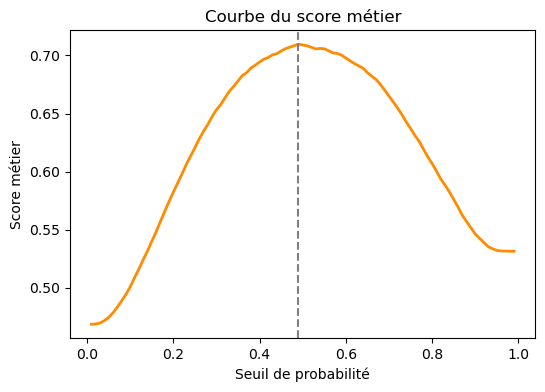

Meilleur seuil de probabilité (Test) : 0.49
Score Metier (Test) : 0.71


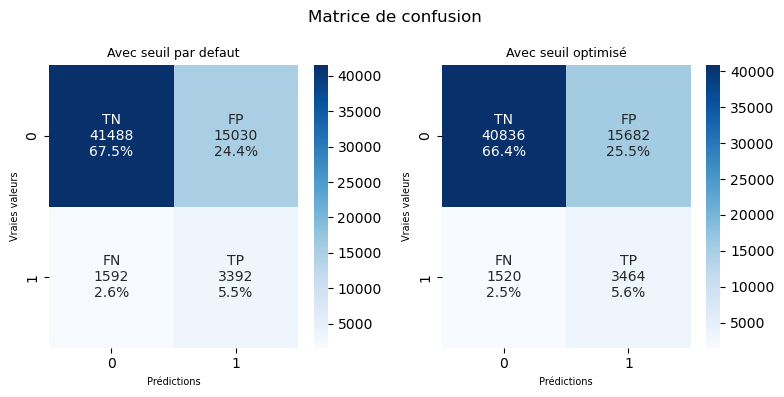

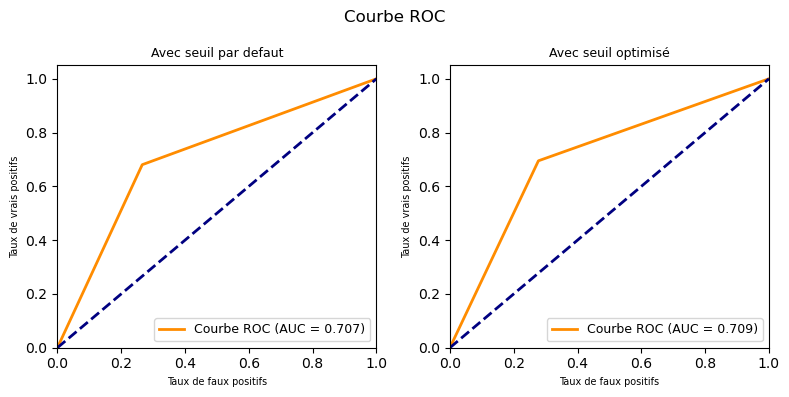

In [332]:
model_eval3(grid_cv_LGBM, 'LGBMClassifier', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux, crossvalidation_tableaux, F_ECHANTILLON, 'oversampler', 'GridSearch')

In [334]:
perf_tableaux.loc[(perf_tableaux["Recherche Hyperparametres"]=="GridSearch") & (perf_tableaux["Model"]=="LGBMClassifier")]

,Model,Normalisation,Target Balanced,Echantillon,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
1,LGBMClassifier,MinMaxScaler,oversampler,100%,GridSearch,"{'model__learning_rate': 0.16, 'model__max_depth': 4, 'model__n_estimators': 138, 'model__num_leaves': 92, 'model__reg_alpha': 0.24, 'model__reg_lambda': 0.68, 'model__subsample': 0.79}",0.49,0.71,0.709,0.72,0.181,0.695,4:36:29


In [336]:
#verification des écarts-type du score métier sur chaque itération du randomizedsearch
crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LGBMClassifier GridSearch 100%"]

,Model,Iteration N°,Mean_test_score,Pli_test_score,Std_test_score
10,LGBMClassifier GridSearch 100%,0.0,0.710,0.713 0.704 0.709 0.714 0.71,0.004
11,LGBMClassifier GridSearch 100%,1.0,0.710,0.713 0.704 0.709 0.714 0.71,0.004
12,LGBMClassifier GridSearch 100%,2.0,0.710,0.713 0.704 0.709 0.714 0.71,0.004
13,LGBMClassifier GridSearch 100%,3.0,0.710,0.713 0.704 0.709 0.714 0.71,0.004
14,LGBMClassifier GridSearch 100%,4.0,0.710,0.713 0.704 0.709 0.714 0.71,0.004
...,...,...,...,...,...
248,LGBMClassifier GridSearch 100%,238.0,0.704,0.706 0.702 0.699 0.709 0.705,0.003
249,LGBMClassifier GridSearch 100%,239.0,0.704,0.706 0.702 0.699 0.709 0.705,0.003
250,LGBMClassifier GridSearch 100%,240.0,0.704,0.706 0.702 0.699 0.709 0.705,0.003
251,LGBMClassifier GridSearch 100%,241.0,0.704,0.706 0.702 0.699 0.709 0.705,0.003


In [338]:
min_Std_test_score = crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LGBMClassifier GridSearch 100%",'Std_test_score'].min()
max_Std_test_score = crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LGBMClassifier GridSearch 100%",'Std_test_score'].max()
print("Std_test_score [ min - max ] = [", min_Std_test_score, "-", max_Std_test_score, "]")

Std_test_score [ min - max ] = [ 0.003 - 0.004 ]


<div class="alert alert-block alert-info">
Le modèle LGBMClassifier + GridSearch + 100% données + Features Importance non nulles est :
    
- d'une grande stabilité (écart-type variant de 0,003 à 0,004)
- score métier 0,710 (quasi identique avec l'ensemble des features 0,711) : écart de 0,1 pts
- score ROC AUC 0,709 (quasi identique avec l'ensemble des features 0,708) : écart de 0,1 pts
- un seuil optimal à 49% Vs 52% avec l'ensemble des features
- temps d'entrainement réduit passant de 7h18min12sec à 4h36min29sec (soit un gain de 2h42min)

<b>C'est donc surtout sur le temps machine que les gains sont significatif en selectionnant l'ensemble des Features Importance non nulles </b></div>

<b><u>b) Avec les 10 meilleurs features importances non nulles</u></b>

In [168]:
#calcul des features avec une valeur importance à zero 
importance_columns_notTOP10 = X_train.columns[feature_importances <= 0.073014].tolist()
print("Nb features n'appartenant pas au top10 des features importance : ",len(importance_columns_notTOP10))

Nb features n'appartenant pas au top10 des features importance :  579


In [170]:
X_features_importance_top10 = X.drop(columns=importance_columns_notTOP10, axis=1)

In [172]:
X_features_importance_top10

,CODE_GENDER,AMT_ANNUITY,DAYS_BIRTH,DAYS_EMPLOYED,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,PAYMENT_RATE,APPROVED_CNT_PAYMENT_MEAN,INSTAL_DPD_MEAN
0,0,24700.5,9461,637.0,0.083037,0.262949,0.139376,0.060749,24.000000,0.000000
1,1,35698.5,16765,1188.0,0.311267,0.622246,0.000000,0.027598,10.000000,0.000000
2,0,6750.0,19046,225.0,0.000000,0.555912,0.729567,0.050000,4.000000,0.000000
3,1,29686.5,19005,3039.0,0.000000,0.650442,0.000000,0.094941,18.000000,0.000000
4,0,21865.5,19932,3038.0,0.000000,0.322738,0.000000,0.042623,20.666667,0.954545
...,...,...,...,...,...,...,...,...,...,...
307501,0,27558.0,9327,236.0,0.145570,0.681632,0.000000,0.108198,8.000000,0.000000
307502,1,12001.5,20775,0.0,0.000000,0.115992,0.000000,0.044524,6.000000,0.500000
307503,1,29979.0,14966,7921.0,0.744026,0.535722,0.218859,0.044239,5.000000,0.642857
307504,1,20205.0,11961,4786.0,0.000000,0.514163,0.661024,0.054592,15.000000,0.000000


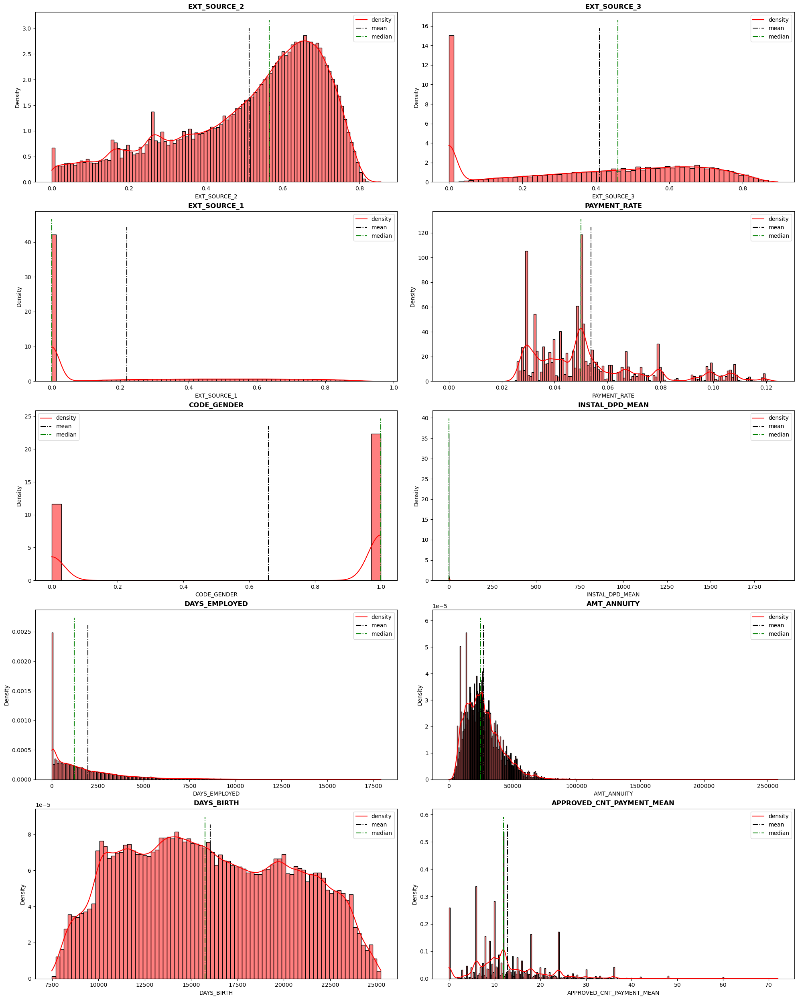

In [178]:
#visualisation de la répartition des données sur les 10 meilleurs features de la features importance
fig = plt.figure(figsize=(20,25))
list_Colonnes_Top10_featuresImportance = [
'EXT_SOURCE_2',
'EXT_SOURCE_3',
'EXT_SOURCE_1',
'PAYMENT_RATE',
'CODE_GENDER',
'INSTAL_DPD_MEAN',
'DAYS_EMPLOYED',
'AMT_ANNUITY',
'DAYS_BIRTH',
'APPROVED_CNT_PAYMENT_MEAN'
]

for i, c in enumerate(list_Colonnes_Top10_featuresImportance,1):
    ax = fig.add_subplot(5,2,i)
    #ax.hist(Data[c],  bins=30, color='grey')
    sns.histplot(X_features_importance_top10[c], color="red", label="100% Equities", kde=True, stat="density", linewidth=1)
    ax.set_title(c)
    ax.vlines(X_features_importance_top10[c].mean(), *ax.get_ylim(), color='black', ls='-.', lw=1.5)
    ax.vlines(X_features_importance_top10[c].median(), *ax.get_ylim(), color='green', ls='-.', lw=1.5)
     #ax.vlines(df[c].mode(), *ax.get_ylim(), color='blue', ls='-.', lw=1.5)
    ax.legend(['density', 'mean','median'])
    ax.title.set_fontweight('bold')
    
plt.tight_layout(w_pad=2, h_pad=0.65)

plt.show()

In [192]:
print("moyenne INSTAL_DPD_MEAN :", round(X_features_importance_top10['INSTAL_DPD_MEAN'].mean(),2))
print("mediane INSTAL_DPD_MEAN :", round(X_features_importance_top10['INSTAL_DPD_MEAN'].median(),2))
print("min INSTAL_DPD_MEAN :", round(X_features_importance_top10['INSTAL_DPD_MEAN'].min(),2))
print("max INSTAL_DPD_MEAN :", round(X_features_importance_top10['INSTAL_DPD_MEAN'].max(),2))

moyenne INSTAL_DPD_MEAN : 1.01
mediane INSTAL_DPD_MEAN : 0.01
min INSTAL_DPD_MEAN : 0.0
max INSTAL_DPD_MEAN : 1885.39


In [200]:
# tracking new experience
mlflow.set_experiment("Simulations du meilleur modèle avec RandomizedSearchCV sur 100% données et avec top10 des features importance non nulles")


2025/06/12 10:35:55 INFO mlflow.tracking.fluent: Experiment with name 'Simulations du meilleur modèle avec RandomizedSearchCV sur 100% données et avec top10 des features importance non nulles' does not exist. Creating a new experiment.


<Experiment: artifact_location='file:///C:/Users/MOI/PROJET_7/mlruns/594572066117230131', creation_time=1749717355259, experiment_id='594572066117230131', last_update_time=1749717355259, lifecycle_stage='active', name=('Simulations du meilleur modèle avec RandomizedSearchCV sur 100% données et '
 'avec top10 des features importance non nulles'), tags={}>

In [202]:
# Définition des hyperparamètres à tester
# utilisation de la fonction randint (créer un nombre entier aléatoire à l’intérieur d’une plage défini)
hyperparameter_LGBM = {
                  'model__n_estimators'    : randint(10, 200),   #nombre d'estimateur (=arbre)
                  'model__learning_rate'   : uniform(0.01, 0.5), #taux d'apprentissage pour chaque estimateur
                  'model__max_depth'       : randint(1,10),      #profondeur max de chaque estimateur
                  'model__num_leaves'       : randint(10,100),   #nombre de feuilles dans chaque arbre
                  'model__subsample'       : uniform(0.5,0.5),   #proportion d'echantillons à utiliser pour chaque arbre
                  'model__reg_alpha'       : uniform(0,1),       #parametre de regularisation L1/L2
                  'model__reg_lambda'       : uniform(0,1)
                 }

random_cv_LGBM  = RandomizedSearchCV(LGBMClm_oversampler, 
            hyperparameter_LGBM, 
            scoring=custom_scorer,
            cv=kfold, 
            n_iter=10, 
            n_jobs = 4,
            random_state=42,
            verbose=2)

In [204]:
F_ECHANTILLON = "100%"
##### Sépration en jeu d'entrainement / jeu de validation, 80% des données pour l'entraînement
X_train, X_test, y_train, y_test = train_test_split(X_features_importance_top10, y, train_size=0.8, random_state=42)

# vérification de la taille des matrices :
print('taille X_train:', X_train.shape)
print('taille X_test:', X_test.shape)
print('taille y_train:', y_train.shape)
print('taille y_test:', y_test.shape)

taille X_train: (246004, 10)
taille X_test: (61502, 10)
taille y_train: (246004,)
taille y_test: (61502,)


Fitting 5 folds for each of 10 candidates, totalling 50 fits
[LightGBM] [Info] Number of positive: 226164, number of negative: 226164
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005246 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2257
[LightGBM] [Info] Number of data points in the train set: 452328, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

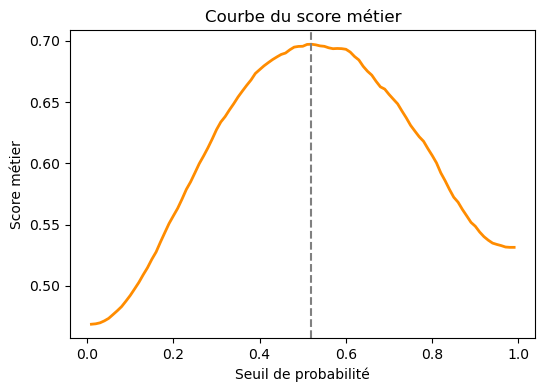

Meilleur seuil de probabilité (Test) : 0.52
Score Metier (Test) : 0.697


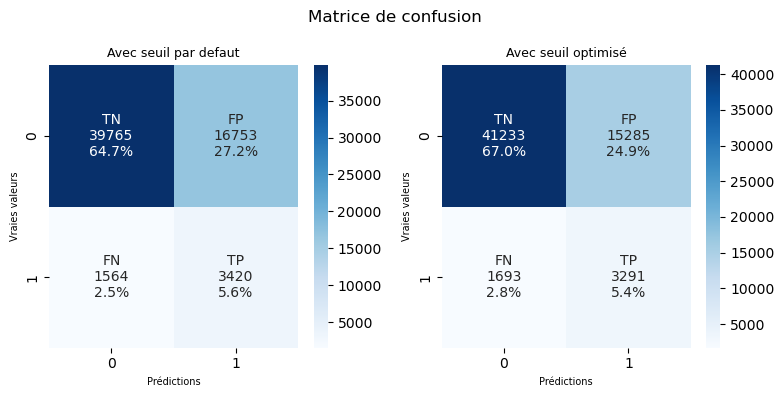

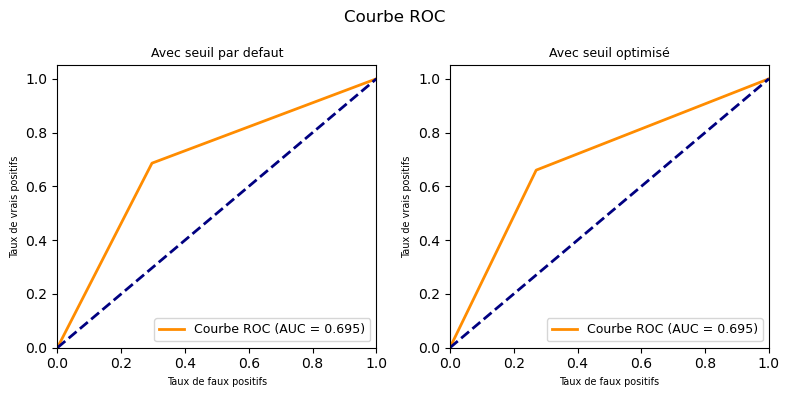

In [212]:
model_eval3(random_cv_LGBM, 'LGBMClassifier with top10 features importance', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux, crossvalidation_tableaux, F_ECHANTILLON, 'oversampler', 'RandomizedSearch')

In [214]:
perf_tableaux.loc[(perf_tableaux["Recherche Hyperparametres"]=="RandomizedSearch") & (perf_tableaux["Model"]=="LGBMClassifier with top10 features importance")]

,Model,Normalisation,Target Balanced,Echantillon,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
0,LGBMClassifier with top10 features importance,MinMaxScaler,oversampler,100%,RandomizedSearch,"{'model__learning_rate': 0.4792763545078751, 'model__max_depth': 2, 'model__n_estimators': 197, 'model__num_leaves': 30, 'model__reg_alpha': 0.6174815096277165, 'model__reg_lambda': 0.6116531604882809, 'model__subsample': 0.5035331526098588}",0.52,0.697,0.695,0.724,0.177,0.66,0:01:20


In [216]:
#verification des écarts-type du score métier sur chaque itération du randomizedsearch
crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LGBMClassifier with top10 features importance RandomizedSearch 100%"]


,Model,Iteration N°,Mean_test_score,Pli_test_score,Std_test_score
0,LGBMClassifier with top10 features importance RandomizedSearch 100%,0.0,0.689,0.69 0.685 0.691 0.691 0.685,0.003
1,LGBMClassifier with top10 features importance RandomizedSearch 100%,1.0,0.689,0.69 0.688 0.688 0.691 0.689,0.001
2,LGBMClassifier with top10 features importance RandomizedSearch 100%,2.0,0.693,0.696 0.69 0.69 0.698 0.694,0.003
3,LGBMClassifier with top10 features importance RandomizedSearch 100%,3.0,0.671,0.673 0.664 0.67 0.677 0.672,0.004
4,LGBMClassifier with top10 features importance RandomizedSearch 100%,4.0,0.683,0.682 0.679 0.679 0.69 0.682,0.004
5,LGBMClassifier with top10 features importance RandomizedSearch 100%,5.0,0.693,0.696 0.69 0.69 0.698 0.691,0.003
6,LGBMClassifier with top10 features importance RandomizedSearch 100%,6.0,0.692,0.693 0.689 0.69 0.697 0.693,0.003
7,LGBMClassifier with top10 features importance RandomizedSearch 100%,7.0,0.687,0.69 0.683 0.684 0.692 0.687,0.003
8,LGBMClassifier with top10 features importance RandomizedSearch 100%,8.0,0.662,0.662 0.664 0.66 0.664 0.66,0.002
9,LGBMClassifier with top10 features importance RandomizedSearch 100%,9.0,0.673,0.671 0.672 0.67 0.679 0.673,0.003


In [220]:
min_Std_test_score = crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LGBMClassifier with top10 features importance RandomizedSearch 100%",'Std_test_score'].min()
max_Std_test_score = crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LGBMClassifier with top10 features importance RandomizedSearch 100%",'Std_test_score'].max()
print("Std_test_score [ min - max ] = [", min_Std_test_score, "-", max_Std_test_score, "]")


Std_test_score [ min - max ] = [ 0.001 - 0.004 ]


In [222]:
# tracking new experience# tracking new experience
mlflow.set_experiment("Simulations du meilleur modèle avec GridSearchCV sur 100% données et avec top10 des features importance non nulles")


2025/06/12 10:41:16 INFO mlflow.tracking.fluent: Experiment with name 'Simulations du meilleur modèle avec GridSearchCV sur 100% données et avec top10 des features importance non nulles' does not exist. Creating a new experiment.


<Experiment: artifact_location='file:///C:/Users/MOI/PROJET_7/mlruns/113242119617881177', creation_time=1749717676261, experiment_id='113242119617881177', last_update_time=1749717676261, lifecycle_stage='active', name=('Simulations du meilleur modèle avec GridSearchCV sur 100% données et avec '
 'top10 des features importance non nulles'), tags={}>

In [232]:
# Définition des hyperparamètres à tester
# utilisation de la fonction randint (créer un nombre entier aléatoire à l’intérieur d’une plage défini)
hyperparameter_LGBM_tuning = {
                  'model__n_estimators'    : [196, 197, 198],   #nombre d'estimateur (=arbre)
                  'model__learning_rate'   : [0.46, 0.47, 0.48], #taux d'apprentissage pour chaque estimateur
                  'model__max_depth'       : [1, 2, 3],      #profondeur max de chaque estimateur
                  'model__num_leaves'       : [29, 30, 31],   #nombre de feuilles dans chaque arbre
                  'model__subsample'       : [0.49, 0.50, 0.51],   #proportion d'echantillons à utiliser pour chaque arbre
                  'model__reg_alpha'       : [0.617],       #parametre de regularisation L1/L2
                  'model__reg_lambda'       : [0.611]
                 }

grid_cv_LGBM  = GridSearchCV(LGBMClm_oversampler, 
            hyperparameter_LGBM_tuning, 
            scoring=custom_scorer,
            cv=kfold,
            n_jobs = 4,
            verbose=2)


Fitting 5 folds for each of 243 candidates, totalling 1215 fits
[LightGBM] [Info] Number of positive: 226164, number of negative: 226164
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005604 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2257
[LightGBM] [Info] Number of data points in the train set: 452328, number of used features: 10
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive ga

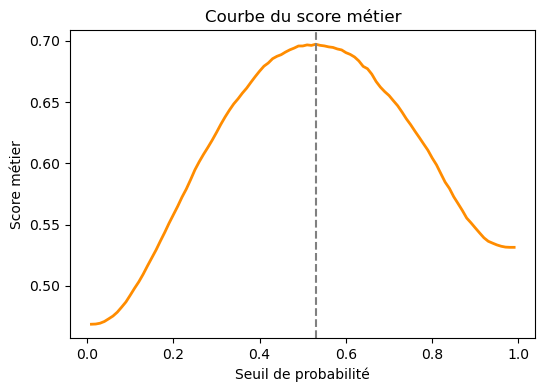

Meilleur seuil de probabilité (Test) : 0.53
Score Metier (Test) : 0.697


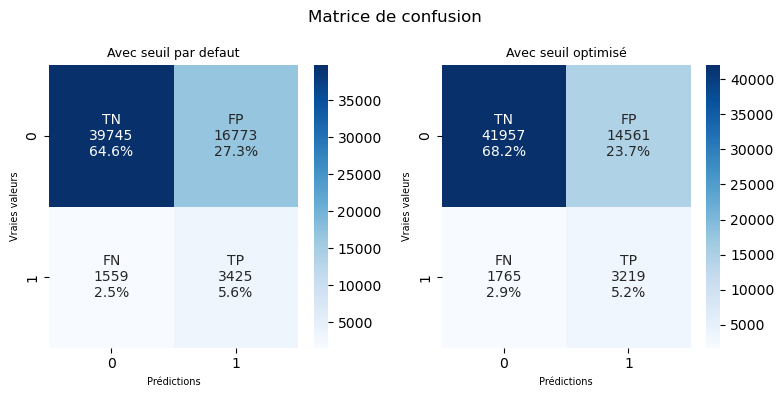

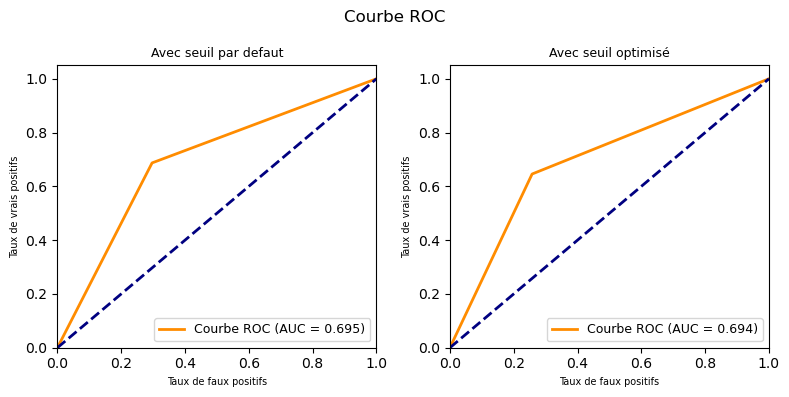

In [234]:
model_eval3(grid_cv_LGBM, 'LGBMClassifier with top10 features importance', 'MinMaxScaler', X_train, y_train, X_test, y_test,  perf_tableaux, crossvalidation_tableaux, F_ECHANTILLON, 'oversampler', 'GridSearch')

In [236]:
perf_tableaux.loc[(perf_tableaux["Recherche Hyperparametres"]=="GridSearch") & (perf_tableaux["Model"]=="LGBMClassifier with top10 features importance")]


,Model,Normalisation,Target Balanced,Echantillon,Recherche Hyperparametres,Best Hyperparametres,Best Seuil,Score Metier,ROC_AUC,Accuracy,Precision,Recall,Time Fit (hh:mm:ss)
1,LGBMClassifier with top10 features importance,MinMaxScaler,oversampler,100%,GridSearch,"{'model__learning_rate': 0.47, 'model__max_depth': 2, 'model__n_estimators': 198, 'model__num_leaves': 29, 'model__reg_alpha': 0.617, 'model__reg_lambda': 0.611, 'model__subsample': 0.49}",0.53,0.697,0.694,0.735,0.181,0.646,0:23:40


In [238]:
#verification des écarts-type du score métier sur chaque itération du randomizedsearch
crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LGBMClassifier with top10 features importance GridSearch 100%"]


,Model,Iteration N°,Mean_test_score,Pli_test_score,Std_test_score
10,LGBMClassifier with top10 features importance GridSearch 100%,0.0,0.685,0.687 0.68 0.681 0.688 0.687,0.003
11,LGBMClassifier with top10 features importance GridSearch 100%,1.0,0.685,0.687 0.68 0.681 0.688 0.687,0.003
12,LGBMClassifier with top10 features importance GridSearch 100%,2.0,0.685,0.687 0.68 0.681 0.688 0.687,0.003
13,LGBMClassifier with top10 features importance GridSearch 100%,3.0,0.685,0.687 0.68 0.681 0.688 0.687,0.003
14,LGBMClassifier with top10 features importance GridSearch 100%,4.0,0.685,0.687 0.68 0.681 0.688 0.687,0.003
...,...,...,...,...,...
248,LGBMClassifier with top10 features importance GridSearch 100%,238.0,0.691,0.691 0.687 0.689 0.697 0.69,0.003
249,LGBMClassifier with top10 features importance GridSearch 100%,239.0,0.691,0.691 0.687 0.689 0.697 0.69,0.003
250,LGBMClassifier with top10 features importance GridSearch 100%,240.0,0.691,0.691 0.687 0.689 0.697 0.69,0.003
251,LGBMClassifier with top10 features importance GridSearch 100%,241.0,0.691,0.691 0.687 0.689 0.697 0.69,0.003


In [240]:
min_Std_test_score = crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LGBMClassifier with top10 features importance GridSearch 100%",'Std_test_score'].min()
max_Std_test_score = crossvalidation_tableaux.loc[crossvalidation_tableaux["Model"]=="LGBMClassifier with top10 features importance GridSearch 100%",'Std_test_score'].max()
print("Std_test_score [ min - max ] = [", min_Std_test_score, "-", max_Std_test_score, "]")


Std_test_score [ min - max ] = [ 0.002 - 0.004 ]


<div class="alert alert-block alert-info">
Le modèle LGBMClassifier + GridSearch + 100% données + top10 Features Importance non nulles est :
    
- d'une grande stabilité (écart-type variant de 0,002 à 0,004)
- score métier 0,697 (très légèrement < avec l'ensemble des features 0,711) : écart de 1,4 pts
- score ROC AUC 0,694 (très légèrement < avec l'ensemble des features 0,708) : écart de 1,4 pts
- un seuil optimal à 53% Vs 52% avec l'ensemble des features
- temps d'entrainement réduit passant de 7h18min12sec à 0h23min40sec (soit un gain de 6h55min)

<b>C'est donc surtout sur le temps machine que les gains sont significatif en selectionnant l'ensemble des Features Importance non nulles </b></div>

###  <font color="blue" size=5>Chapitre 7 - API </font><a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a><a id="chapitre7"></a><a name="chapitre7"></a>

#### <font color="green" size=4>7.1 Construction du modèle final avec joblib </font><a href="#chapitre7" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_7_1"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

Construisez un pipeline de prédiction intégrant l'étape de pré-traitement et la classification LGBMClassifier avec les meilleurs hyperparamètres trouvés à l'étape précédente.

In [97]:
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.8, random_state=42)

# vérification de la taille des matrices :
print('taille X_train:', X_train.shape)
print('taille X_test:', X_test.shape)
print('taille y_train:', y_train.shape)
print('taille y_test:', y_test.shape)

taille X_train: (246004, 589)
taille X_test: (61502, 589)
taille y_train: (246004,)
taille y_test: (61502,)


In [98]:
#pipeline de prédiction LGBMClassifier + MinMaxScaler + oversampler
LGBMClm_oversampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', LGBMClassifier(
                n_estimators=140,
                learning_rate=0.16,
                max_depth=4,
                num_leaves=92,
                reg_alpha=0.25,
                random_state=42
                            )
    )
])

#Apprentissage du pipeline sur les données d'apprentissage
LGBMClm_oversampler.fit(X_train, y_train)

[LightGBM] [Info] Number of positive: 226164, number of negative: 226164
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.787316 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 65475
[LightGBM] [Info] Number of data points in the train set: 452328, number of used features: 573
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further

Pipeline(steps=[('scaler', MinMaxScaler()),
                ('balance', RandomOverSampler(random_state=42)),
                ('model',
                 LGBMClassifier(learning_rate=0.16, max_depth=4,
                                n_estimators=140, num_leaves=92,
                                random_state=42, reg_alpha=0.25))])

In [100]:
y_pred_proba = LGBMClm_oversampler.predict_proba(X_test)[:, 1]
thresholds = np.linspace(0.01, 0.99, 99)
scores = [score_metier(y_test, y_pred_proba, threshold, 1, 10) for threshold in thresholds]
best_threshold = thresholds[np.argmax(scores)]
worst_threshold = thresholds[np.argmin(scores)]
        
optimal_score_metier = max(scores)
worst_score_metier = min(scores)
print("Meilleur seuil de probabilité (Test) :", round(best_threshold,3))
print("Score Metier optimal (Test) :",round(optimal_score_metier,3))
print("Seuil de probabilité le plus mauvais (Test) :", round(worst_threshold,3))
print("Score Metier le plus mauvais (Test) :",round(worst_score_metier,3))
        
# Évaluation du modèle avec le meilleur seuil de probabilité
y_pred_opti = (y_pred_proba >= best_threshold).astype(int)

Meilleur seuil de probabilité (Test) : 0.51
Score Metier optimal (Test) : 0.71
Seuil de probabilité le plus mauvais (Test) : 0.01
Score Metier le plus mauvais (Test) : 0.469


Pour déployer notre modèle en production, on va sérialiser le pipeline à l'aide de joblib, sous le nom de fichier pipeline_housing.joblib.

In [102]:
import joblib
joblib.dump(LGBMClm_oversampler, 'LGBMClm_scoring.joblib')

['LGBMClm_scoring.joblib']

#### <font color="green" size=4>7.2 Déploiement du modèle avec MLflow Models </font><a href="#chapitre7" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_7_2"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

In [104]:
from mlflow.models.signature import infer_signature

In [105]:
#Signature du modèle
signature = infer_signature(X_train, y_train)

C:\Users\MOI\anaconda3\Lib\site-packages\mlflow\types\utils.py:452: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.
  warnings.warn(


In [106]:
#Sauvegarde du modèle sklearn
import mlflow.sklearn

In [109]:
#Sauvegarder LGBMClm_oversampler à l'aide de la fonction save_model en n'oubliant pas de préciser la signature.
mlflow.sklearn.save_model(LGBMClm_oversampler, 'mlflow_model', signature=signature)

In [270]:
y_pred_opti

array([0, 0, 0, ..., 1, 0, 0])

In [288]:
y_test

205098    0
263697    0
36463     0
296300    0
169139    0
         ..
177060    0
228620    0
201557    0
247452    0
10118     0
Name: TARGET, Length: 61502, dtype: int64

In [290]:
df2 = pd.DataFrame(y_test)
df2

,TARGET
205098,0
263697,0
36463,0
296300,0
169139,0
...,...
177060,0
228620,0
201557,0
247452,0


In [284]:
df = pd.DataFrame(y_pred_opti)
df1 = df.rename(columns={0: 'Prediction'})
df1

,Prediction
0,0
1,0
2,0
3,0
4,0
...,...
61497,0
61498,1
61499,1
61500,0


In [292]:
#visualisation d'une colonne avec 1 modalité
print('Nb valeurs distincts pour Prediction :',len(df1.groupby('Prediction')))
resultat = df1.groupby(['Prediction'], dropna=True).size().reset_index()
resultat.columns = ['Prediction','nb']
resultat['Percentage'] = 100 * resultat['nb']  / resultat['nb'].sum()
resultat.sort_values('Percentage',ascending=False,inplace=True)
resultat.head(10)

Nb valeurs distincts pour Prediction : 2


,Prediction,nb,Percentage
0,0,43782,71.187929
1,1,17720,28.812071


In [294]:
#visualisation d'une colonne avec 1 modalité
print('Nb valeurs distincts pour TARGET :',len(df2.groupby('TARGET')))
resultat = df2.groupby(['TARGET'], dropna=True).size().reset_index()
resultat.columns = ['TARGET','nb']
resultat['Percentage'] = 100 * resultat['nb']  / resultat['nb'].sum()
resultat.sort_values('Percentage',ascending=False,inplace=True)
resultat.head(10)

Nb valeurs distincts pour TARGET : 2


,TARGET,nb,Percentage
0,0,56518,91.896198
1,1,4984,8.103802
